In [539]:
#Import packages
#---------------------------------------
import sys
import os
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
import matplotlib
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)
import glob
import admin_functions as adfn
import trace_analyse as tfn
from tqdm import tqdm

In [22]:
fdata = "/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE"
dff_l  = np.sort(glob.glob(f"{fdata}/*regdeltaff*"))
bind_l  = np.sort(glob.glob(f"{fdata}/*regbin*"))


30

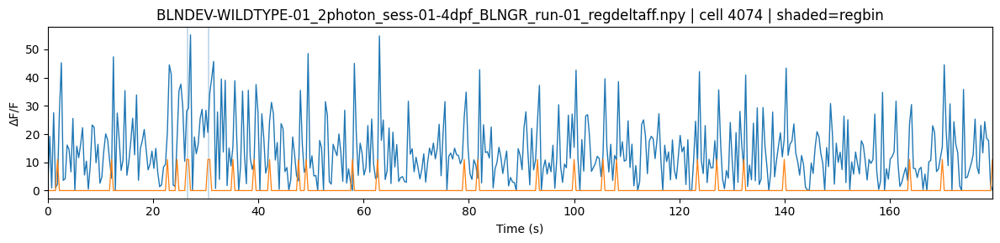

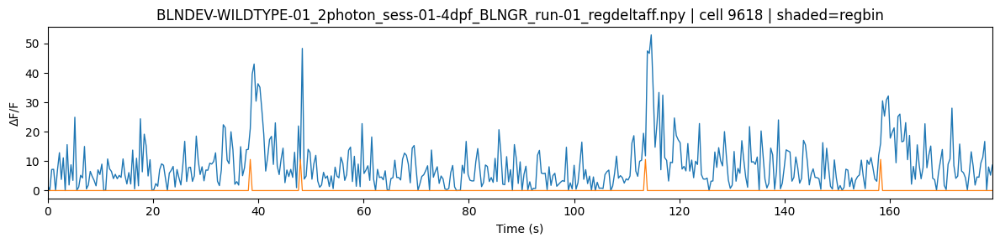

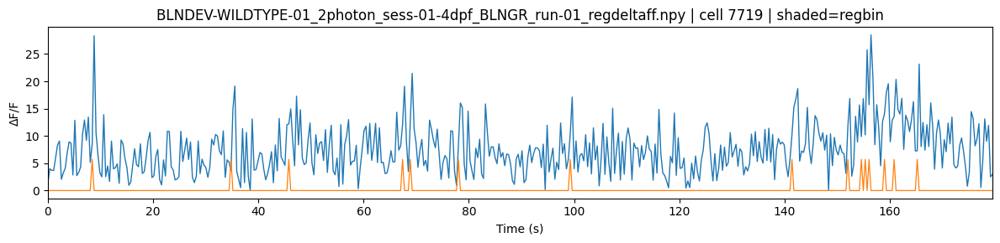

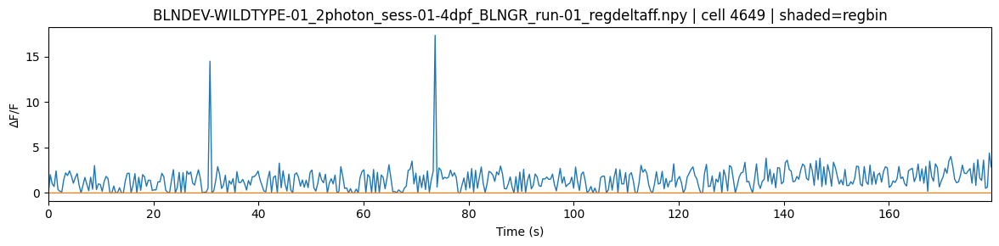

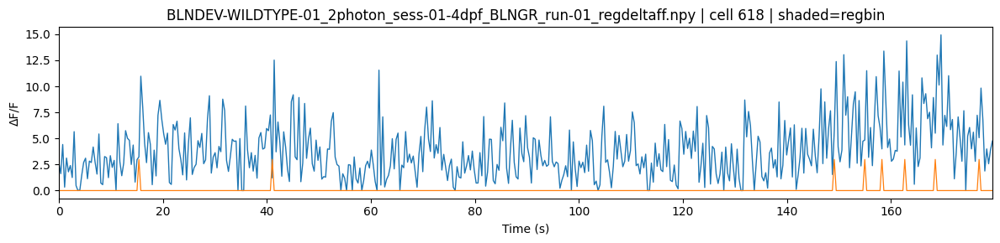

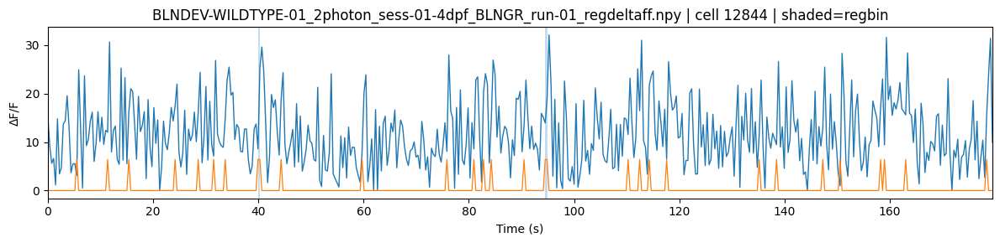

In [24]:
import os, glob
import numpy as np
import matplotlib.pyplot as plt

def sanity_check_bin_vs_dff(
    dff_path: str,
    bin_path: str,
    fs: float = 2.73,
    cells=None,
    n_cells: int = 6,
    t0_s: float = 0.0,
    t1_s: float  = 180.0,
    shade_alpha: float = 0.25,
    show_bin_trace: bool = True,
    bin_trace_scale: float = 0.2,
    seed: int = 0,
):
    """
    Sanity check: overlay pre-binarised periods onto raw dF/F traces.

    Inputs are .npy with shape (cells, time), and bin is 0/1 (or any nonzero=on).

    Plots one figure per cell:
      - raw dF/F trace
      - shaded regions where bin==1
      - optional thin binary trace overlaid (scaled to trace range)

    Parameters
    ----------
    dff_path, bin_path : str
        Paths to matching regdeltaff.npy and regbin.npy files.
    fs : float
        Sampling rate in Hz.
    cells : list[int] | None
        Specific cell indices to plot. If None, randomly sample n_cells.
    n_cells : int
        Number of random cells if cells is None.
    t0_s, t1_s : float | None
        Time window in seconds. If t1_s is None, plot to end.
    shade_alpha : float
        Transparency for shaded ON epochs.
    show_bin_trace : bool
        If True, overlay a scaled binary trace on top of raw.
    bin_trace_scale : float
        Relative height (fraction of dF/F range) for binary overlay.
    seed : int
        RNG seed for random cell selection.

    Returns
    -------
    info : dict
        Metadata including selected cells and shapes.
    """
    dff = np.load(dff_path)
    b   = np.load(bin_path)

    if dff.ndim != 2 or b.ndim != 2:
        raise ValueError(f"Expected 2D arrays. Got dff {dff.shape}, bin {b.shape}")
    if dff.shape != b.shape:
        raise ValueError(f"Shape mismatch: dff {dff.shape} vs bin {b.shape}")

    n_cells_total, T = dff.shape
    if t1_s is None:
        t1_s = (T - 1) / fs

    i0 = max(0, int(round(t0_s * fs)))
    i1 = min(T, int(round(t1_s * fs)))
    if i1 <= i0 + 2:
        raise ValueError("Time window too small; adjust t0_s/t1_s.")

    # coerce bin to 0/1
    b01 = (b != 0).astype(np.uint8)

    # choose cells
    if cells is None:
        rng = np.random.default_rng(seed)
        k = min(int(n_cells), n_cells_total)
        cells = rng.choice(n_cells_total, size=k, replace=False).tolist()
    else:
        cells = [int(c) for c in cells]
        for c in cells:
            if c < 0 or c >= n_cells_total:
                raise IndexError(f"Cell index {c} out of range [0, {n_cells_total-1}]")

    # helper: find contiguous ON epochs
    def _events_from_binary(x):
        x = np.asarray(x).astype(bool)
        if x.size == 0:
            return []
        starts = np.where(~x[:-1] & x[1:])[0] + 1
        ends   = np.where(x[:-1] & ~x[1:])[0]
        if x[0]:
            starts = np.r_[0, starts]
        if x[-1]:
            ends = np.r_[ends, x.size - 1]
        return list(zip(starts.tolist(), ends.tolist()))

    # plot
    base = os.path.basename(dff_path)
    t = np.arange(i0, i1) / fs

    for c in cells:
        y = dff[c, i0:i1]
        x = b01[c, i0:i1]

        fig, ax = plt.subplots(figsize=(12, 3))
        ax.plot(t, y, lw=1.0)

        # shaded epochs
        for s, e in _events_from_binary(x):
            ax.axvspan(t[s], t[e], alpha=shade_alpha)

        # optional binary overlay as a thin line
        if show_bin_trace:
            y0 = np.nanmin(y)
            y1 = np.nanmax(y)
            rngy = y1 - y0 if np.isfinite(y0) and np.isfinite(y1) and y1 > y0 else 1.0
            amp = bin_trace_scale * rngy
            ax.plot(t, y0 + amp * x, lw=0.9)

        ax.set_xlabel("Time (s)")
        ax.set_ylabel("ΔF/F")
        ax.set_title(f"{base} | cell {c} | shaded=regbin")
        ax.margins(x=0)
        plt.tight_layout()
        plt.show()

    return {
        "dff_path": dff_path,
        "bin_path": bin_path,
        "shape": dff.shape,
        "fs": fs,
        "t0_s": t0_s,
        "t1_s": t1_s,
        "cells": cells,
        "window_idx": (i0, i1),
    }


def sanity_check_batch_bin_vs_dff(
    dff_l,
    bind_l,
    fs: float = 2.73,
    n_files: int = 1,
    file_inds=None,
    **plot_kwargs
):
    """
    Batch wrapper: pick files (by index) and run sanity_check_bin_vs_dff on each.

    dff_l and bind_l must be same length and aligned.
    """
    dff_l = list(dff_l)
    bind_l = list(bind_l)
    if len(dff_l) != len(bind_l):
        raise ValueError(f"Length mismatch: len(dff_l)={len(dff_l)} vs len(bind_l)={len(bind_l)}")

    if file_inds is None:
        file_inds = list(range(min(int(n_files), len(dff_l))))
    else:
        file_inds = [int(i) for i in file_inds]

    infos = []
    for i in file_inds:
        infos.append(
            sanity_check_bin_vs_dff(
                dff_path=dff_l[i],
                bin_path=bind_l[i],
                fs=fs,
                **plot_kwargs
            )
        )
    return infos


# -------------------------
# example usage
# -------------------------
fdata = "/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE"
dff_l  = np.sort(glob.glob(f"{fdata}/*regdeltaff*"))
bind_l = np.sort(glob.glob(f"{fdata}/*regbin*"))

# check first file, random 6 cells, first 3 minutes
_ = sanity_check_bin_vs_dff(dff_l[0], bind_l[0], fs=2.73, n_cells=6, t0_s=0, t1_s=180)

# check a couple files
# _ = sanity_check_batch_bin_vs_dff(dff_l, bind_l, fs=2.73, file_inds=[0, 5], n_cells=4, t0_s=60, t1_s=240)


# Single cell firing stats


In [8]:
#This function extracts each data type
def load_comb(data_list, name_list):

    obj = { i:[[]]*len(data_list) for i in name_list  }

    for i in range(len(data_list)):
        for e in range(len(data_list[i])):
            data = np.load(data_list[i][e], allow_pickle=True).item()
            for name in name_list:
                curr = data[name]
                obj[name][i] = np.append(obj[name][i], curr)

        print(i)
        
    len_list = []
    for i in range(len(data_list)):
        count = 0
        for e in range(len(data_list[i])):
            count+=1

        len_list = np.append(len_list, count)
        
    return(obj, len_list)

#This function sorts all data by condition
def sort_comb(curr_name, obj, reg_list):

    input_data = adfn.comb_list(obj[curr_name])
    reg_data = np.ravel(adfn.repeat_list(reg_list, 30))

    cond = np.arange(3, 9)
    cond_l = []
    for i in range(len(len_list)):
        for e in range(int(len_list[i])):
            cond_l = np.append(cond_l, cond[i])

    df = pd.DataFrame({curr_name:input_data , "condition": cond_l, "region": reg_data})

    return(df)

In [2]:
Fdata = '/Users/k2585057/Library/CloudStorage/Dropbox/PhD/analysis/Project/'

d3 = adfn.return_files(Fdata, 'BLNDEV-WILDTYPE/', '*3dpf*n_fir*')
d4 = adfn.return_files(Fdata, 'BLNDEV-WILDTYPE/', '*4dpf*n_fir*')
d5 = adfn.return_files(Fdata, 'BLNDEV-WILDTYPE/', '*5dpf*n_fir*')
d6 = adfn.return_files(Fdata, 'BLNDEV-WILDTYPE/', '*6dpf*n_fir*')
d7 = adfn.return_files(Fdata, 'BLNDEV-WILDTYPE/', '*7dpf*n_fir*')
d8 = adfn.return_files(Fdata, 'BLNDEV-WILDTYPE/', '*8dpf*n_fir*')
data_ll = d3, d4, d5, d6, d7, d8 


In [9]:
name_list = ['fr', 'fa', 'fd', 's_corr', 'l_corr', 'dim']
reg_list = ['Diencephalon', 'Hindbrain', 'Midbrain', 'Telencephalon']
obj, len_list = load_comb(data_ll, name_list)
fr_df = sort_comb('fr', obj, reg_list)
fa_df = sort_comb('fa', obj, reg_list)
fd_df = sort_comb('fd', obj, reg_list)
sc_df = sort_comb('s_corr', obj, reg_list)
lc_df = sort_comb('l_corr', obj, reg_list)
dim_df = sort_comb('dim', obj,reg_list)

0
1
2
3
4
5


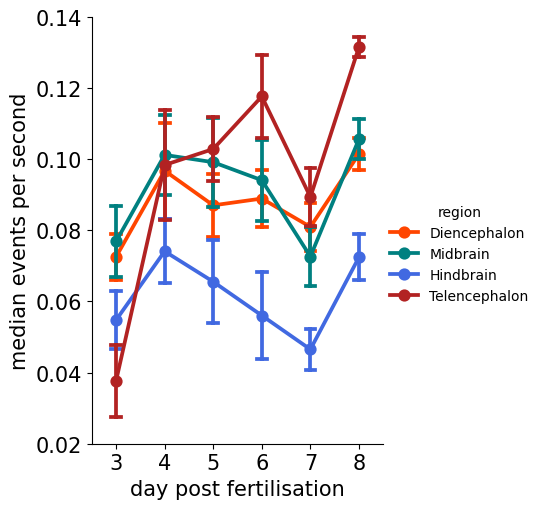

In [13]:
import seaborn as sns
fr_df ['frps'] = ((fr_df['fr']*30).values / 4914)*2.73
fr_df['condition'] = fr_df['condition'].astype(int)

data_name = 'frps'
dic = fr_df

# Your existing catplot code
cat_plot = sns.catplot(data=dic, x='condition', y=data_name, hue='region', errorbar='se', capsize=0.2, kind='point', height=5, aspect=.8, 
            hue_order=['Diencephalon', 'Midbrain', 'Hindbrain', 'Telencephalon'], palette=['orangered', 'teal', 'royalblue', 'firebrick'])

# Set x and y tick labels
cat_plot.set_yticklabels(fontsize=15)  # Set y-axis tick labels
cat_plot.set_xticklabels(fontsize=15)  # Set x-axis tick labels
cat_plot.set_axis_labels('day post fertilisation', 'median events per second')
cat_plot.set_xlabels(fontsize=15)
cat_plot.set_ylabels(fontsize=15)
#plt.savefig(Fcode + 'prac1.svg', transparent=True)
# Show the plot
plt.show()

In [14]:
print(np.mean(dic["frps"][(dic["region"] == "Telencephalon") & (dic["condition"] == 3)]), 1.96*(np.std(dic["frps"][(dic["region"] == "Telencephalon") & (dic["condition"] == 3)])/np.sqrt(len(dic["frps"][(dic["region"] == "Telencephalon") & (dic["condition"] == 3)]))))
print(np.mean(dic["frps"][(dic["region"] == "Telencephalon") & (dic["condition"] == 8)]), 1.96*(np.std(dic["frps"][(dic["region"] == "Telencephalon") & (dic["condition"] == 8)])/np.sqrt(len(dic["frps"][(dic["region"] == "Telencephalon") & (dic["condition"] == 8)]))))


0.03766666666666667 0.017864150624389178
0.13155555555555554 0.004861373681797568


In [15]:
from scipy import stats
print(f'Telencephalon {stats.spearmanr(dic["frps"][dic["region"] == "Telencephalon"], dic["condition"][dic["region"] == "Telencephalon"])}') 
print(f'Diencephalon {stats.spearmanr(dic["frps"][dic["region"] == "Diencephalon"], dic["condition"][dic["region"] == "Diencephalon"])}')
print(f'Midbrain {stats.spearmanr(dic["frps"][dic["region"] == "Midbrain"], dic["condition"][dic["region"] == "Midbrain"])}')
print(f'Hindbrain {stats.spearmanr(dic["frps"][dic["region"] == "Hindbrain"], dic["condition"][dic["region"] == "Hindbrain"])}')

Telencephalon SignificanceResult(statistic=np.float64(0.6127183770103806), pvalue=np.float64(0.0003190526577887385))
Diencephalon SignificanceResult(statistic=np.float64(0.31411015907371365), pvalue=np.float64(0.0909442465187946))
Midbrain SignificanceResult(statistic=np.float64(0.09946694289103558), pvalue=np.float64(0.6010067628049046))
Hindbrain SignificanceResult(statistic=np.float64(0.002820673123865963), pvalue=np.float64(0.98819733559976))


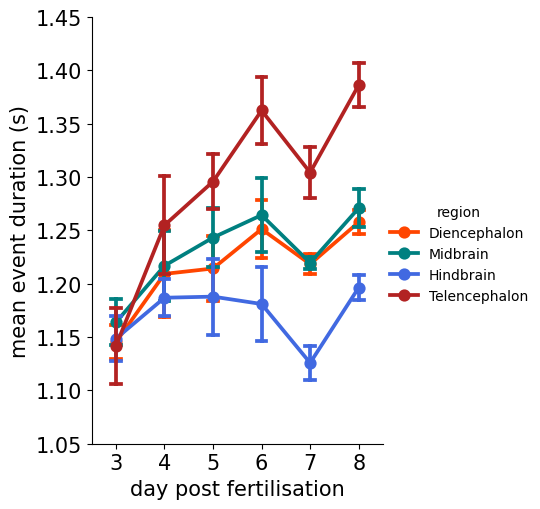

In [17]:
data_name = 'fd'
dic = fd_df
#fd_df['fd'] = fd_df['fd']/2.73

fd_df['condition'] = fd_df['condition'].astype(int)

# Your existing catplot code
cat_plot = sns.catplot(data=dic, x='condition', y=data_name, hue='region', errorbar='se', capsize=0.2, kind='point', height=5, aspect=.8, 
            hue_order=['Diencephalon', 'Midbrain', 'Hindbrain', 'Telencephalon'], palette=['orangered', 'teal', 'royalblue', 'firebrick'])

# Set x and y tick labels
cat_plot.set_yticklabels(fontsize=15)  # Set y-axis tick labels
cat_plot.set_xticklabels(fontsize=15)  # Set x-axis tick labels
cat_plot.set_axis_labels('day post fertilisation', 'mean event duration (s)')
cat_plot.set_xlabels(fontsize=15)
cat_plot.set_ylabels(fontsize=15)
#plt.savefig(Fcode + 'prac3.svg', transparent=True)
# Show the plot
plt.show()

In [18]:
from scipy import stats
print(f'Telencephalon {stats.spearmanr(dic["fd"][dic["region"] == "Telencephalon"], dic["condition"][dic["region"] == "Telencephalon"])}') 
print(f'Diencephalon {stats.spearmanr(dic["fd"][dic["region"] == "Diencephalon"], dic["condition"][dic["region"] == "Diencephalon"])}')
print(f'Midbrain {stats.spearmanr(dic["fd"][dic["region"] == "Midbrain"], dic["condition"][dic["region"] == "Midbrain"])}')
print(f'Hindbrain {stats.spearmanr(dic["fd"][dic["region"] == "Hindbrain"], dic["condition"][dic["region"] == "Hindbrain"])}')

Telencephalon SignificanceResult(statistic=np.float64(0.6850088788479042), pvalue=np.float64(2.9665915740928448e-05))
Diencephalon SignificanceResult(statistic=np.float64(0.5236843240467672), pvalue=np.float64(0.0029783810377988084))
Midbrain SignificanceResult(statistic=np.float64(0.4422323460282912), pvalue=np.float64(0.014407390933646872))
Hindbrain SignificanceResult(statistic=np.float64(0.05888910322111428), pvalue=np.float64(0.7572366031126652))


In [19]:
print(np.mean(dic["fd"][(dic["region"] == "Telencephalon") & (dic["condition"] == 3)]), 1.96*np.std(dic["fd"][(dic["region"] == "Telencephalon") & (dic["condition"] == 3)])/np.sqrt(len(dic["fd"][(dic["region"] == "Telencephalon") & (dic["condition"] == 3)])))
print(np.mean(dic["fd"][(dic["region"] == "Telencephalon") & (dic["condition"] == 8)]), 1.96*np.std(dic["fd"][(dic["region"] == "Telencephalon") & (dic["condition"] == 8)])/np.sqrt(len(dic["fd"][(dic["region"] == "Telencephalon") & (dic["condition"] == 8)])))

1.1416351086428445 0.06244843903301787
1.3861628776419364 0.03635250623289299


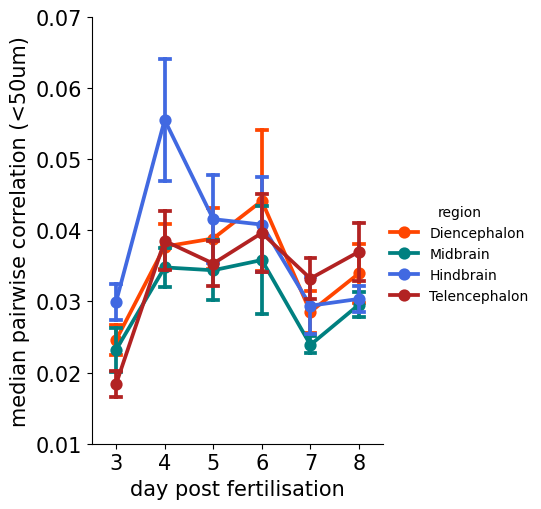

In [21]:
data_name = 's_corr'
dic = sc_df
sc_df['condition'] = sc_df['condition'].astype(int)

# Your existing catplot code
cat_plot = sns.catplot(data=dic, x='condition', y=data_name, hue='region', errorbar='se', capsize=0.2, kind='point', height=5, aspect=.8, 
            hue_order=['Diencephalon', 'Midbrain', 'Hindbrain', 'Telencephalon'], palette=['orangered', 'teal', 'royalblue', 'firebrick'])

# Set x and y tick labels
cat_plot.set_yticklabels(fontsize=15)  # Set y-axis tick labels
cat_plot.set_xticklabels(fontsize=15)  # Set x-axis tick labels
cat_plot.set_axis_labels('day post fertilisation', 'median pairwise correlation (<50um)')
cat_plot.set_xlabels(fontsize=15)
cat_plot.set_ylabels(fontsize=15)
#plt.savefig(Fcode + 'prac4.svg', transparent=True)
# Show the plot
plt.show()

In [22]:
print(np.mean(dic["s_corr"][(dic["region"] == "Telencephalon") & (dic["condition"] == 3)]), 1.96*np.std(dic["s_corr"][(dic["region"] == "Telencephalon") & (dic["condition"] == 3)])/np.sqrt(len(dic["s_corr"][(dic["region"] == "Telencephalon") & (dic["condition"] == 3)])))
print(np.mean(dic["s_corr"][(dic["region"] == "Telencephalon") & (dic["condition"] == 8)]), 1.96*np.std(dic["s_corr"][(dic["region"] == "Telencephalon") & (dic["condition"] == 8)])/np.sqrt(len(dic["s_corr"][(dic["region"] == "Telencephalon") & (dic["condition"] == 8)])))


0.018385442220574776 0.003276895097956432
0.036998214296254085 0.007164928168546956


In [23]:
from scipy import stats
print(f'Telencephalon {stats.spearmanr(dic["s_corr"][dic["region"] == "Telencephalon"], dic["condition"][dic["region"] == "Telencephalon"])}') 
print(f'Diencephalon {stats.spearmanr(dic["s_corr"][dic["region"] == "Diencephalon"], dic["condition"][dic["region"] == "Diencephalon"])}')
print(f'Midbrain {stats.spearmanr(dic["s_corr"][dic["region"] == "Midbrain"], dic["condition"][dic["region"] == "Midbrain"])}')
print(f'Hindbrain {stats.spearmanr(dic["s_corr"][dic["region"] == "Hindbrain"], dic["condition"][dic["region"] == "Hindbrain"])}')

Telencephalon SignificanceResult(statistic=np.float64(0.3373149782205588), pvalue=np.float64(0.06832014564706664))
Diencephalon SignificanceResult(statistic=np.float64(0.12296766764562178), pvalue=np.float64(0.5173946580983264))
Midbrain SignificanceResult(statistic=np.float64(0.05550467200151001), pvalue=np.float64(0.7708079348784171))
Hindbrain SignificanceResult(statistic=np.float64(-0.1902050345417599), pvalue=np.float64(0.3140513694321098))


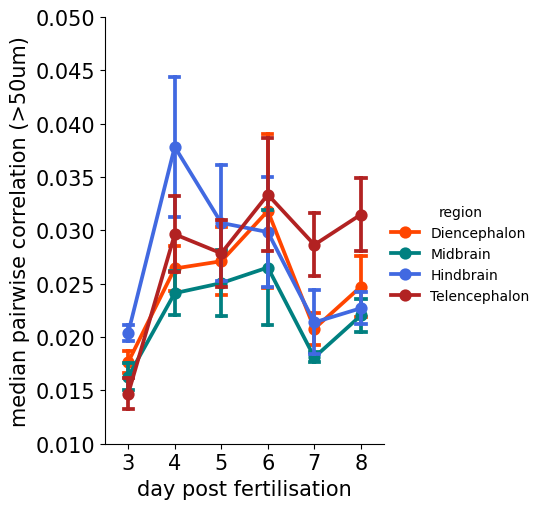

In [24]:
data_name = 'l_corr'
dic = lc_df

lc_df['condition'] = lc_df['condition'].astype(int)

# Your existing catplot code
cat_plot = sns.catplot(data=dic, x='condition', y=data_name, hue='region', errorbar='se', capsize=0.2, kind='point', height=5, aspect=.8, 
            hue_order=['Diencephalon', 'Midbrain', 'Hindbrain', 'Telencephalon'], palette=['orangered', 'teal', 'royalblue', 'firebrick'])

# Set x and y tick labels
cat_plot.set_yticklabels(fontsize=15)  # Set y-axis tick labels
cat_plot.set_xticklabels(fontsize=15)  # Set x-axis tick labels
cat_plot.set_axis_labels('day post fertilisation', 'median pairwise correlation (>50um)')
cat_plot.set_xlabels(fontsize=15)
cat_plot.set_ylabels(fontsize=15)
#plt.savefig(Fcode + 'prac5.svg', transparent=True)
# Show the plot
plt.show()

In [25]:
from scipy import stats
print(f'Telencephalon {stats.spearmanr(dic["l_corr"][dic["region"] == "Telencephalon"], dic["condition"][dic["region"] == "Telencephalon"])}') 
print(f'Diencephalon {stats.spearmanr(dic["l_corr"][dic["region"] == "Diencephalon"], dic["condition"][dic["region"] == "Diencephalon"])}')
print(f'Midbrain {stats.spearmanr(dic["l_corr"][dic["region"] == "Midbrain"], dic["condition"][dic["region"] == "Midbrain"])}')
print(f'Hindbrain {stats.spearmanr(dic["l_corr"][dic["region"] == "Hindbrain"], dic["condition"][dic["region"] == "Hindbrain"])}')

Telencephalon SignificanceResult(statistic=np.float64(0.4729178557527033), pvalue=np.float64(0.008309448933351076))
Diencephalon SignificanceResult(statistic=np.float64(0.16651401600453006), pvalue=np.float64(0.3791607608123756))
Midbrain SignificanceResult(statistic=np.float64(0.19223569327352252), pvalue=np.float64(0.30881573694542513))
Hindbrain SignificanceResult(statistic=np.float64(-0.08303137925429141), pvalue=np.float64(0.6626830564560007))


In [26]:
print(np.mean(dic["l_corr"][(dic["region"] == "Telencephalon") & (dic["condition"] == 3)]), 1.96*np.std(dic["l_corr"][(dic["region"] == "Telencephalon") & (dic["condition"] == 3)])/np.sqrt(len(dic["l_corr"][(dic["region"] == "Telencephalon") & (dic["condition"] == 3)])))
print(np.mean(dic["l_corr"][(dic["region"] == "Telencephalon") & (dic["condition"] == 4)]), 1.96*np.std(dic["l_corr"][(dic["region"] == "Telencephalon") & (dic["condition"] == 4)])/np.sqrt(len(dic["l_corr"][(dic["region"] == "Telencephalon") & (dic["condition"] == 4)])))


0.01468024139131693 0.002542128813552426
0.029634529655205383 0.0062760767840589655


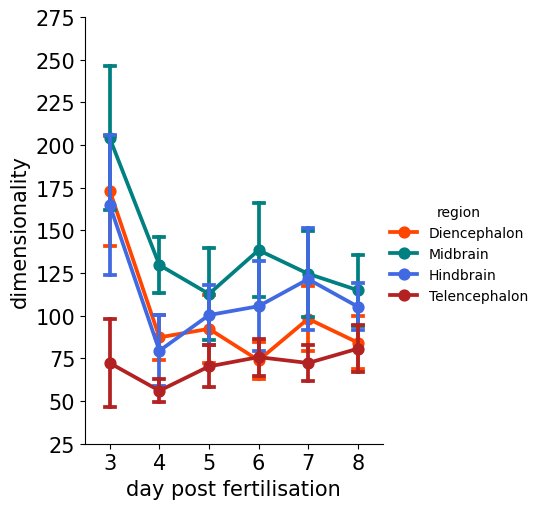

In [27]:
data_name = 'dim'
dic = dim_df

dim_df['condition'] = dim_df['condition'].astype(int)

# Your existing catplot code
cat_plot = sns.catplot(data=dic, x='condition', y=data_name, hue='region', errorbar='se', capsize=0.2, kind='point', height=5, aspect=.8, 
            hue_order=['Diencephalon', 'Midbrain', 'Hindbrain', 'Telencephalon'], palette=['orangered', 'teal', 'royalblue', 'firebrick'])

# Set x and y tick labels
cat_plot.set_yticklabels(fontsize=15)  # Set y-axis tick labels
cat_plot.set_xticklabels(fontsize=15)  # Set x-axis tick labels
cat_plot.set_axis_labels('day post fertilisation', 'dimensionality')
cat_plot.set_xlabels(fontsize=15)
cat_plot.set_ylabels(fontsize=15)
#plt.savefig(Fcode + 'prac6.svg', transparent=True)
# Show the plot
plt.show()

In [28]:
from scipy import stats
print(f'Telencephalon {stats.spearmanr(dic["dim"][dic["region"] == "Telencephalon"], dic["condition"][dic["region"] == "Telencephalon"])}') 
print(f'Diencephalon {stats.spearmanr(dic["dim"][dic["region"] == "Diencephalon"], dic["condition"][dic["region"] == "Diencephalon"])}')
print(f'Midbrain {stats.spearmanr(dic["dim"][dic["region"] == "Midbrain"], dic["condition"][dic["region"] == "Midbrain"])}')
print(f'Hindbrain {stats.spearmanr(dic["dim"][dic["region"] == "Hindbrain"], dic["condition"][dic["region"] == "Hindbrain"])}')

Telencephalon SignificanceResult(statistic=np.float64(0.31114204345561913), pvalue=np.float64(0.09420616707386505))
Diencephalon SignificanceResult(statistic=np.float64(-0.3156546184150915), pvalue=np.float64(0.08928122711998594))
Midbrain SignificanceResult(statistic=np.float64(-0.24796599402300612), pvalue=np.float64(0.18643454745499588))
Hindbrain SignificanceResult(statistic=np.float64(0.0027075449756834152), pvalue=np.float64(0.9886706718947579))


# Regional connectivity

In [3]:
fdata = "/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE"
dff_l  = np.sort(glob.glob(f"{fdata}/*regdeltaff*"))
bind_l  = np.sort(glob.glob(f"{fdata}/*regbin*"))
trace_l  = np.sort(glob.glob(f"{fdata}/*regtrace*"))
coord_l  = np.sort(glob.glob(f"{fdata}/*labcoord*"))
len(dff_l), len(bind_l), len(trace_l), len(coord_l)


(30, 30, 30, 30)

In [4]:
import os, re, glob
import numpy as np
import pandas as pd
from tqdm import tqdm

# -----------------------
# helpers
# -----------------------
def parse_age_dpf(path):
    base = os.path.basename(path)
    m = re.search(r"(\d+)\s*dpf|(\d+)dpf", base)
    if not m:
        return np.nan
    for g in m.groups():
        if g is not None:
            return int(g)
    return np.nan

def zscore_rows_fillnan(X, eps=1e-12):
    X = np.asarray(X, dtype=float)
    X[~np.isfinite(X)] = np.nan

    row_mean = np.nanmean(X, axis=1, keepdims=True)
    row_mean = np.where(np.isfinite(row_mean), row_mean, 0.0)

    X_filled = np.where(np.isnan(X), row_mean, X)
    row_std = np.std(X_filled, axis=1, ddof=1, keepdims=True)

    keep = (row_std[:, 0] > eps) & np.isfinite(row_std[:, 0])
    Z = (X_filled[keep] - row_mean[keep]) / row_std[keep]
    return Z, keep

def mean_within_corr_exact(Z):
    n, T = Z.shape
    if n < 2:
        return np.nan
    denom = T - 1
    S = Z.sum(axis=0)
    sum_all = np.sum(S * S)
    sum_self = np.sum(Z * Z)
    sum_offdiag = sum_all - sum_self
    return float((sum_offdiag / denom) / (n * (n - 1)))

def mean_across_corr_exact(Za, Zb):
    na, Ta = Za.shape
    nb, Tb = Zb.shape
    if na == 0 or nb == 0:
        return np.nan
    if Ta != Tb:
        raise ValueError(f"Time mismatch: {Ta} vs {Tb}")
    denom = Ta - 1
    Sa = Za.sum(axis=0)
    Sb = Zb.sum(axis=0)
    sum_dot = np.sum(Sa * Sb)
    return float((sum_dot / denom) / (na * nb))

def fisher_z_mean(vals, eps=1e-6):
    vals = vals[np.isfinite(vals)]
    if vals.size == 0:
        return np.nan
    vals = np.clip(vals, -1 + eps, 1 - eps)
    return float(np.tanh(np.mean(np.arctanh(vals))))

def summarize_from_vals(vals, thr=0.10, q=0.95):
    vals = vals[np.isfinite(vals)]
    if vals.size == 0:
        return dict(zmean_corr=np.nan, q95_corr=np.nan, frac_gt_thr=np.nan,
                    mean_pos_corr=np.nan, mean_abs_corr=np.nan)
    return dict(
        zmean_corr=fisher_z_mean(vals),
        q95_corr=float(np.quantile(vals, q)),
        frac_gt_thr=float(np.mean(vals > thr)),
        mean_pos_corr=float(np.mean(vals[vals > 0])) if np.any(vals > 0) else np.nan,
        mean_abs_corr=float(np.mean(np.abs(vals))),
    )

def subsample_Z(Z, m=400, seed=0):
    """Subsample up to m neurons (rows) from Z for fast distribution summaries."""
    n = Z.shape[0]
    if n <= m:
        return Z
    rng = np.random.default_rng(seed)
    idx = rng.choice(n, size=m, replace=False)
    return Z[idx]

def corr_vals_within_subsample(Zsub):
    """Return off-diagonal correlation values from a subsampled region Zsub."""
    n, T = Zsub.shape
    if n < 2:
        return np.array([], dtype=float)
    denom = T - 1
    C = (Zsub @ Zsub.T) / denom
    iu = np.triu_indices(n, k=1)
    return C[iu]

def corr_vals_across_subsample(Za_sub, Zb_sub):
    """Return all cross correlation values from subsampled regions."""
    na, T = Za_sub.shape
    nb, Tb = Zb_sub.shape
    if na == 0 or nb == 0:
        return np.array([], dtype=float)
    if T != Tb:
        raise ValueError(f"Time mismatch: {T} vs {Tb}")
    denom = T - 1
    C = (Za_sub @ Zb_sub.T) / denom
    return C.ravel()

# -----------------------
# main
# -----------------------
fdata   = "/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE"
dff_l   = np.sort(glob.glob(f"{fdata}/*regdeltaff*"))
bind_l  = np.sort(glob.glob(f"{fdata}/*regbin*"))
trace_l = np.sort(glob.glob(f"{fdata}/*regtrace*"))
coord_l = np.sort(glob.glob(f"{fdata}/*labcoord*"))

reg_l = ['Telencephalon', 'Diencephalon', 'Midbrain', 'Hindbrain']

# speed/robustness knobs
M_SUB = 400     # neurons per region used to approximate distributional metrics (try 200 if still heavy)
THR   = 0.10
Q     = 0.95
SEED0 = 0

rows = []

for i in tqdm(range(len(dff_l))):
    trace = np.load(trace_l[i])
    dff   = np.load(dff_l[i])
    coord = np.load(coord_l[i])
    bind  = np.load(bind_l[i])

    fish = adfn.save_name(dff_l[i])
    age  = parse_age_dpf(dff_l[i])

    Z_by_reg = {}
    Zsub_by_reg = {}
    n_by_reg = {}

    # ---- per region ----
    for r in reg_l:
        _, sub_dff, _, _ = tfn.select_region(trace, dff, bind, coord, r)
        Zr, keep = zscore_rows_fillnan(sub_dff)

        Z_by_reg[r] = Zr
        n_by_reg[r] = Zr.shape[0]

        # exact mean corr (your current measure)
        mean_corr = mean_within_corr_exact(Zr)

        # fast distribution summaries from subsampled correlation matrix
        Zr_sub = subsample_Z(Zr, m=M_SUB, seed=SEED0 + 1000*i + hash(r) % 10_000)
        vals = corr_vals_within_subsample(Zr_sub)
        summ = summarize_from_vals(vals, thr=THR, q=Q)

        rows.append(dict(
            age=age, fish=fish, region_i=r, region_j=r,
            n_i=n_by_reg[r], n_j=n_by_reg[r],
            mean_corr=mean_corr,
            m_sub=int(Zr_sub.shape[0]),
            **summ
        ))

        Zsub_by_reg[r] = Zr_sub

    # ---- across regions ----
    for a in range(len(reg_l)):
        for b in range(a + 1, len(reg_l)):
            ra, rb = reg_l[a], reg_l[b]
            Za, Zb = Z_by_reg[ra], Z_by_reg[rb]

            mean_corr = mean_across_corr_exact(Za, Zb)

            # fast distribution summaries from subsampled cross-correlation matrix
            Za_sub = Zsub_by_reg[ra]
            Zb_sub = Zsub_by_reg[rb]
            vals = corr_vals_across_subsample(Za_sub, Zb_sub)
            summ = summarize_from_vals(vals, thr=THR, q=Q)

            rows.append(dict(
                age=age, fish=fish, region_i=ra, region_j=rb,
                n_i=n_by_reg[ra], n_j=n_by_reg[rb],
                mean_corr=mean_corr,
                m_sub_i=int(Za_sub.shape[0]), m_sub_j=int(Zb_sub.shape[0]),
                **summ
            ))

df_conn = (
    pd.DataFrame(rows)
      .sort_values(["age", "fish", "region_i", "region_j"])
      .reset_index(drop=True)
)

# if you want backwards compatibility with your plotting code:
df_conn["mean_connectivity"] = df_conn["mean_corr"]
df_conn

100%|█████████████████████████████████████| 30/30 [00:36<00:00,  1.21s/it]


,age,fish,region_i,region_j,n_i,n_j,mean_corr,m_sub,zmean_corr,q95_corr,frac_gt_thr,mean_pos_corr,mean_abs_corr,m_sub_i,m_sub_j,mean_connectivity
0,3,/Users/k2585057/Library/CloudStorage/Dropbox/P...,Diencephalon,Diencephalon,2409,2409,0.004183,400.0,0.004162,0.082887,0.035050,0.034794,0.031818,NaN,NaN,0.004183
1,3,/Users/k2585057/Library/CloudStorage/Dropbox/P...,Diencephalon,Hindbrain,2409,2327,0.005509,NaN,0.004777,0.074582,0.027594,0.031199,0.028088,400.0,400.0,0.005509
2,3,/Users/k2585057/Library/CloudStorage/Dropbox/P...,Diencephalon,Midbrain,2409,3643,0.004714,NaN,0.005229,0.083425,0.034931,0.034643,0.031333,400.0,400.0,0.004714
3,3,/Users/k2585057/Library/CloudStorage/Dropbox/P...,Hindbrain,Hindbrain,2327,2327,0.013144,400.0,0.011082,0.088808,0.039962,0.035188,0.029329,NaN,NaN,0.013144
4,3,/Users/k2585057/Library/CloudStorage/Dropbox/P...,Midbrain,Hindbrain,3643,2327,0.007108,NaN,0.007086,0.081268,0.033081,0.033099,0.028700,400.0,400.0,0.007108
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,8,/Users/k2585057/Library/CloudStorage/Dropbox/P...,Midbrain,Midbrain,4794,4794,0.008367,400.0,0.006552,0.109324,0.059762,0.043719,0.040535,NaN,NaN,0.008367
296,8,/Users/k2585057/Library/CloudStorage/Dropbox/P...,Telencephalon,Diencephalon,1512,1536,0.005819,NaN,0.005589,0.153381,0.096150,0.060445,0.056410,400.0,400.0,0.005819
297,8,/Users/k2585057/Library/CloudStorage/Dropbox/P...,Telencephalon,Hindbrain,1512,2649,0.003625,NaN,0.003097,0.107354,0.057469,0.045802,0.043158,400.0,400.0,0.003625
298,8,/Users/k2585057/Library/CloudStorage/Dropbox/P...,Telencephalon,Midbrain,1512,4794,0.004673,NaN,0.003889,0.112612,0.062694,0.046455,0.043648,400.0,400.0,0.004673


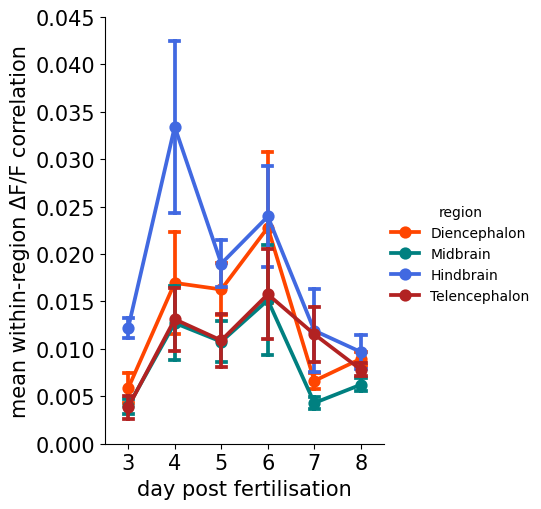

In [5]:
#within group connectivity
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# --- take only self (within-region) correlations ---
self_df = df_conn.copy()
self_df["age"] = pd.to_numeric(self_df["age"], errors="coerce")
self_df["mean_connectivity"] = pd.to_numeric(self_df["mean_connectivity"], errors="coerce")

self_df = self_df[
    (self_df["region_i"] == self_df["region_j"]) &
    np.isfinite(self_df["age"]) &
    np.isfinite(self_df["mean_connectivity"])
].copy()

# match your naming pattern
data_name = "mean_connectivity"
dic = self_df.rename(columns={"age": "condition", "region_i": "region"})

dic["condition"] = dic["condition"].astype(int)

# --- seaborn point/cat plot (like your dimensionality plot) ---
cat_plot = sns.catplot(
    data=dic, x="condition", y=data_name, hue="region",
    kind="point", errorbar="se", capsize=0.2,
    height=5, aspect=.8,
    hue_order=['Diencephalon', 'Midbrain', 'Hindbrain', 'Telencephalon'],
    palette=['orangered', 'teal', 'royalblue', 'firebrick']
)

cat_plot.set_yticklabels(fontsize=15)
cat_plot.set_xticklabels(fontsize=15)
cat_plot.set_axis_labels('day post fertilisation', 'mean within-region ΔF/F correlation')
cat_plot.set_xlabels(fontsize=15)
cat_plot.set_ylabels(fontsize=15)

# optional cosmetics
# plt.axhline(0, color="k", lw=1, alpha=0.5)  # if you want a zero line
plt.show()


In [35]:
import numpy as np
import pandas as pd
from scipy.stats import spearmanr

# dic is the dataframe used for plotting:
# columns: condition (int age), region, mean_connectivity
# (from the previous snippet)

def spearman_by_region(dic, x_col="condition", y_col="mean_connectivity", region_col="region"):
    rows = []
    for r, sub in dic.groupby(region_col):
        x = pd.to_numeric(sub[x_col], errors="coerce").to_numpy()
        y = pd.to_numeric(sub[y_col], errors="coerce").to_numpy()
        m = np.isfinite(x) & np.isfinite(y)
        x, y = x[m], y[m]

        # require at least 3 points, and non-constant x/y
        if len(x) < 3 or np.all(x == x[0]) or np.all(y == y[0]):
            rows.append(dict(region=r, n=len(x), rho=np.nan, p=np.nan))
            continue

        rho, p = spearmanr(x, y)
        rows.append(dict(region=r, n=len(x), rho=float(rho), p=float(p)))

    out = pd.DataFrame(rows).sort_values("region").reset_index(drop=True)
    return out

spearman_tbl = spearman_by_region(dic, x_col="condition", y_col="mean_connectivity", region_col="region")
spearman_tbl


,region,n,rho,p
0,Diencephalon,30,0.035875,0.850715
1,Hindbrain,30,-0.291964,0.117458
2,Midbrain,30,0.014891,0.937747
3,Telencephalon,30,0.285420,0.126292


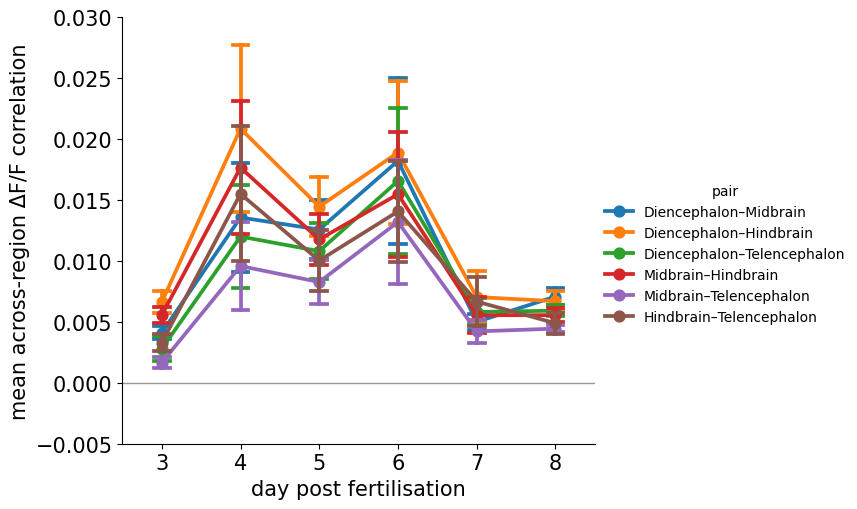

,pair,n,rho,p
0,Diencephalon–Midbrain,30,0.135377,0.475673
1,Diencephalon–Hindbrain,30,-0.203743,0.280185
2,Diencephalon–Telencephalon,30,0.149141,0.431527
3,Midbrain–Hindbrain,30,-0.208481,0.268908
4,Midbrain–Telencephalon,30,0.207578,0.271033
5,Hindbrain–Telencephalon,30,0.095667,0.615050


In [6]:
# ============================================================
# Across-region connectivity (all unique pairs) in SAME style
# + Spearman trend test per pair at the end
# ============================================================

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import spearmanr
from itertools import combinations

# -----------------------
# prep: keep only across-region entries + make pair labels
# -----------------------
across_df = df_conn.copy()
across_df["age"] = pd.to_numeric(across_df["age"], errors="coerce")
across_df["mean_connectivity"] = pd.to_numeric(across_df["mean_connectivity"], errors="coerce")

across_df = across_df[
    (across_df["region_i"] != across_df["region_j"]) &
    np.isfinite(across_df["age"]) &
    np.isfinite(across_df["mean_connectivity"])
].copy()

reg_order = ['Diencephalon', 'Midbrain', 'Hindbrain', 'Telencephalon']
pair_order = [f"{a}–{b}" for a, b in combinations(reg_order, 2)]

# robust: collapse (i,j) and (j,i) into the same undirected pair label
across_df["pair"] = across_df[["region_i", "region_j"]].apply(
    lambda r: "–".join(sorted(r.values, key=lambda x: reg_order.index(x) if x in reg_order else 999)),
    axis=1
)
across_df["pair"] = pd.Categorical(across_df["pair"], categories=pair_order, ordered=True)

# match your naming pattern
data_name = "mean_connectivity"
dic_pair = across_df.rename(columns={"age": "condition"}).copy()
dic_pair["condition"] = dic_pair["condition"].astype(int)

# -----------------------
# plot: catplot point (mean ± SE), like your within-region plot
# -----------------------
cat_plot = sns.catplot(
    data=dic_pair,
    x="condition", y=data_name, hue="pair",
    kind="point", errorbar="se", capsize=0.2,
    height=5, aspect=1.2
)

cat_plot.set_yticklabels(fontsize=15)
cat_plot.set_xticklabels(fontsize=15)
cat_plot.set_axis_labels('day post fertilisation', 'mean across-region ΔF/F correlation')
cat_plot.set_xlabels(fontsize=15)
cat_plot.set_ylabels(fontsize=15)

# optional: zero line (note: catplot returns a FacetGrid; draw on each axis)
for ax in cat_plot.axes.flat:
    ax.axhline(0, color="k", lw=1, alpha=0.4)

plt.show()

# -----------------------
# Spearman trend test per pair (fish-level points)
# -----------------------
rows = []
for p in pair_order:
    sub = dic_pair[dic_pair["pair"] == p].copy()
    x = pd.to_numeric(sub["condition"], errors="coerce").to_numpy()
    y = pd.to_numeric(sub[data_name], errors="coerce").to_numpy()
    m = np.isfinite(x) & np.isfinite(y)
    x, y = x[m], y[m]

    if len(x) < 3 or np.all(x == x[0]) or np.all(y == y[0]):
        rows.append(dict(pair=p, n=len(x), rho=np.nan, p=np.nan))
    else:
        rho, pval = spearmanr(x, y)
        rows.append(dict(pair=p, n=len(x), rho=float(rho), p=float(pval)))

spearman_pairs = pd.DataFrame(rows)

# (optional) FDR over the 6 tests
try:
    from statsmodels.stats.multitest import multipletests
    pvals = spearman_pairs["p"].to_numpy(dtype=float)
    mask = np.isfinite(pvals)
    p_fdr = np.full_like(pvals, np.nan, dtype=float)
    p_fdr[mask] = multipletests(pvals[mask], method="fdr_bh")[1]
    spearman_pairs["p_fdr_bh"] = p_fdr
except Exception:
    pass

spearman_pairs


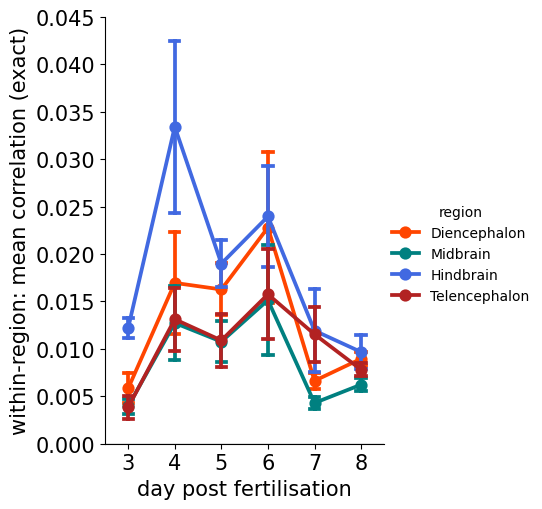

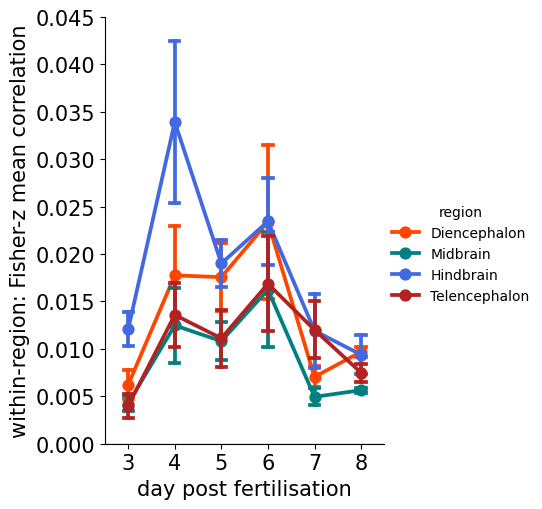

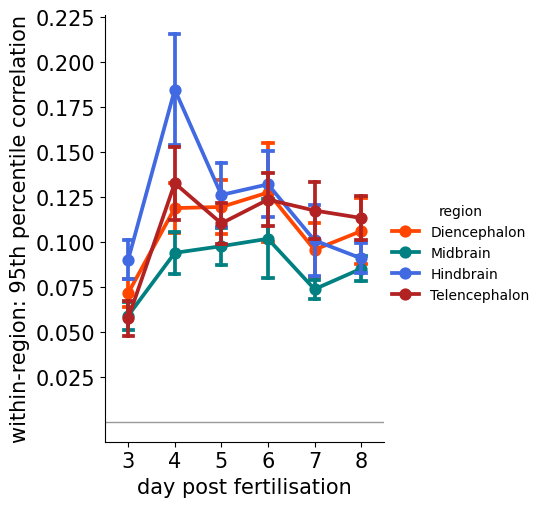

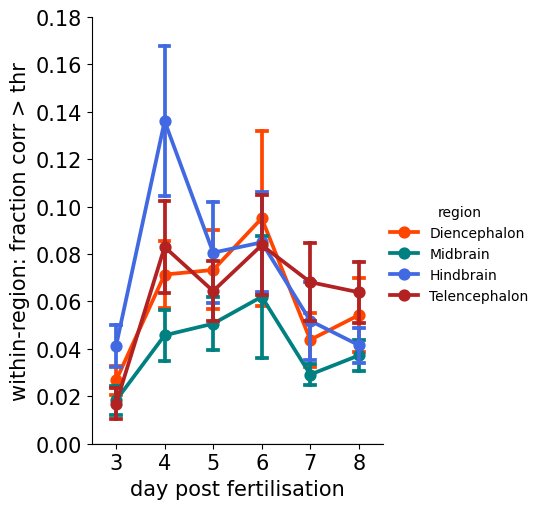

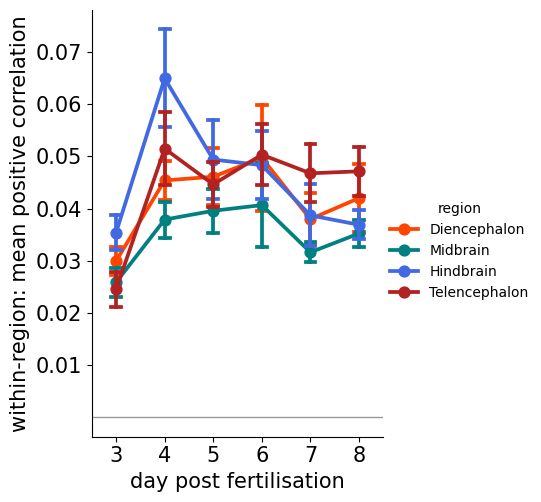

...

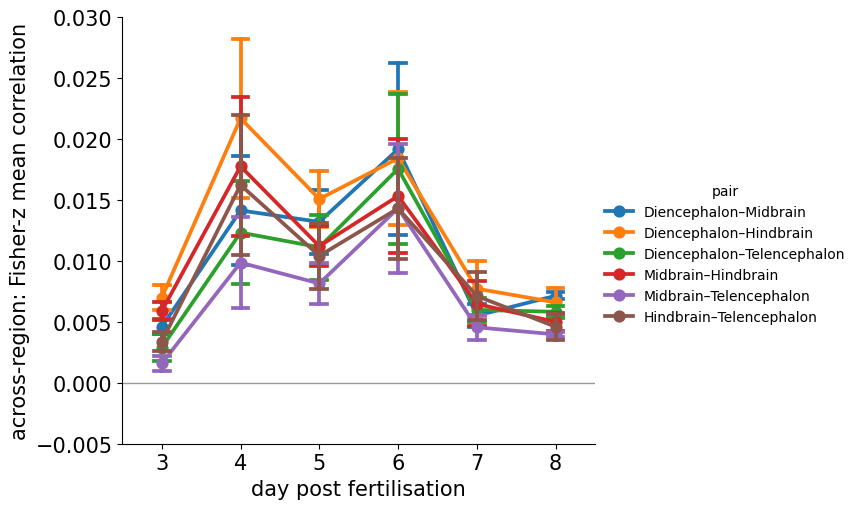

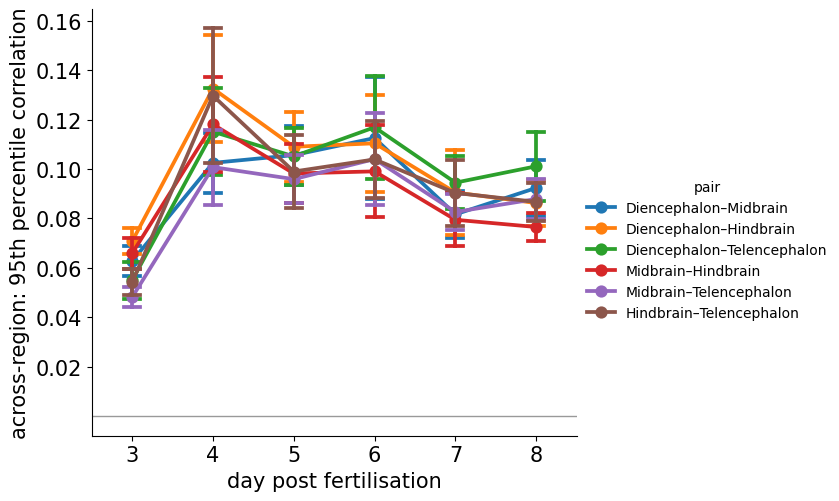

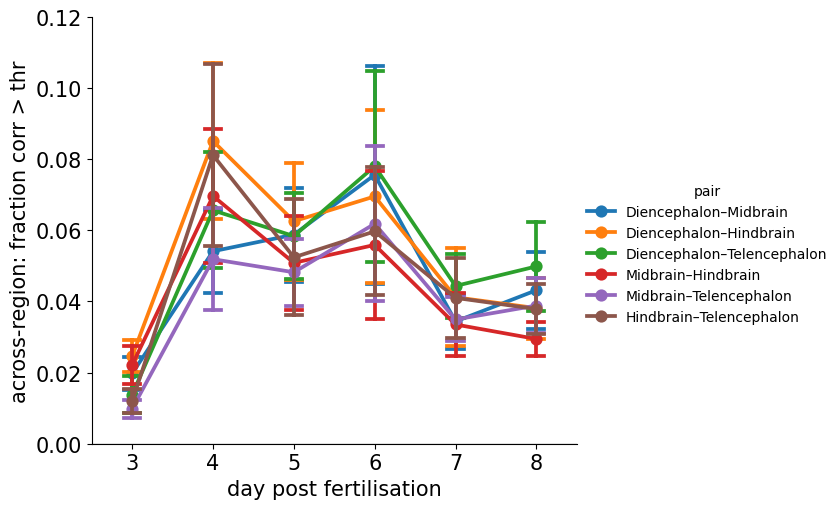

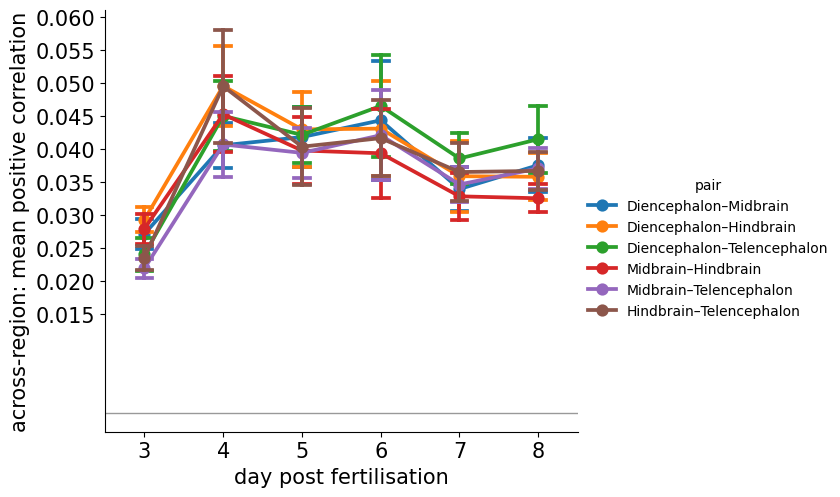

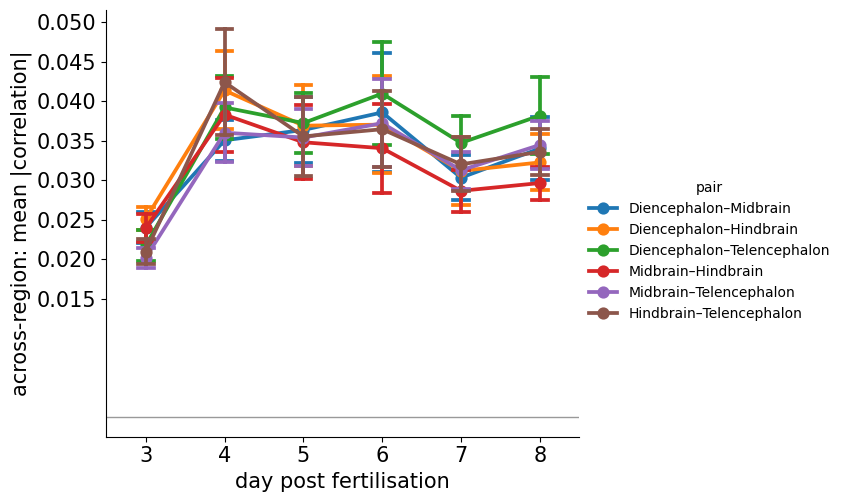

,pair,n,rho,p,metric,metric_label
0,Diencephalon–Midbrain,30,0.135377,0.475673,mean_corr,mean correlation (exact)
1,Diencephalon–Hindbrain,30,-0.203743,0.280185,mean_corr,mean correlation (exact)
2,Diencephalon–Telencephalon,30,0.149141,0.431527,mean_corr,mean correlation (exact)
3,Midbrain–Hindbrain,30,-0.208481,0.268908,mean_corr,mean correlation (exact)
4,Midbrain–Telencephalon,30,0.207578,0.271033,mean_corr,mean correlation (exact)
5,Hindbrain–Telencephalon,30,0.095667,0.615050,mean_corr,mean correlation (exact)
6,Diencephalon–Midbrain,30,0.110332,0.561635,zmean_corr,Fisher-z mean correlation
7,Diencephalon–Hindbrain,30,-0.224501,0.232991,zmean_corr,Fisher-z mean correlation
8,Diencephalon–Telencephalon,30,0.167417,0.376546,zmean_corr,Fisher-z mean correlation
9,Midbrain–Hindbrain,30,-0.261278,0.163126,zmean_corr,Fisher-z mean correlation


In [7]:
# ============================================================
# Plot ALL connectivity metrics in your exact catplot style:
#   (1) within-region (self): hue=region
#   (2) across-region (pairs): hue=pair
# plus Spearman tests for each region/pair for each metric
# ============================================================

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import spearmanr
from itertools import combinations

# -----------------------
# settings
# -----------------------
reg_order = ['Diencephalon', 'Midbrain', 'Hindbrain', 'Telencephalon']
palette_reg = ['orangered', 'teal', 'royalblue', 'firebrick']

metrics = [
    ("mean_corr",      "mean correlation (exact)"),
    ("zmean_corr",     "Fisher-z mean correlation"),
    ("q95_corr",       "95th percentile correlation"),
    ("frac_gt_thr",    "fraction corr > thr"),
    ("mean_pos_corr",  "mean positive correlation"),
    ("mean_abs_corr",  "mean |correlation|"),
]

# if you kept backwards compat:
# df_conn["mean_connectivity"] = df_conn["mean_corr"]

def prep_common(df):
    df = df.copy()
    df["age"] = pd.to_numeric(df["age"], errors="coerce")
    df = df[np.isfinite(df["age"])].copy()
    df["condition"] = df["age"].astype(int)
    return df

def make_pair_label(df):
    df = df.copy()
    pair_order = [f"{a}–{b}" for a, b in combinations(reg_order, 2)]
    df["pair"] = df[["region_i", "region_j"]].apply(
        lambda r: "–".join(sorted(r.values, key=lambda x: reg_order.index(x) if x in reg_order else 999)),
        axis=1
    )
    df["pair"] = pd.Categorical(df["pair"], categories=pair_order, ordered=True)
    return df, pair_order

def spearman_table(df, group_col, x_col="condition", y_col="value", group_order=None):
    rows = []
    groups = group_order if group_order is not None else list(df[group_col].dropna().unique())
    for g in groups:
        sub = df[df[group_col] == g]
        x = pd.to_numeric(sub[x_col], errors="coerce").to_numpy()
        y = pd.to_numeric(sub[y_col], errors="coerce").to_numpy()
        m = np.isfinite(x) & np.isfinite(y)
        x, y = x[m], y[m]
        if len(x) < 3 or np.all(x == x[0]) or np.all(y == y[0]):
            rows.append({group_col: g, "n": len(x), "rho": np.nan, "p": np.nan})
        else:
            rho, p = spearmanr(x, y)
            rows.append({group_col: g, "n": len(x), "rho": float(rho), "p": float(p)})
    return pd.DataFrame(rows)

# ============================================================
# 1) WITHIN-REGION: one plot per metric (hue=region)
# ============================================================
dfp = prep_common(df_conn)

self_base = dfp[(dfp["region_i"] == dfp["region_j"])].copy()
self_base = self_base[np.isfinite(self_base.get("mean_corr", np.nan)) | np.isfinite(self_base.get("mean_connectivity", np.nan))].copy()
self_base = self_base.rename(columns={"region_i": "region"})

spearman_within_all = []

for mcol, mlabel in metrics:
    if mcol not in self_base.columns:
        print(f"[skip within] missing column: {mcol}")
        continue

    dic = self_base[["condition", "fish", "region", mcol]].rename(columns={mcol: "value"}).copy()
    dic["value"] = pd.to_numeric(dic["value"], errors="coerce")
    dic = dic[np.isfinite(dic["value"])].copy()

    # plot
    cat_plot = sns.catplot(
        data=dic, x="condition", y="value", hue="region",
        kind="point", errorbar="se", capsize=0.2,
        height=5, aspect=.8,
        hue_order=reg_order, palette=palette_reg
    )
    cat_plot.set_yticklabels(fontsize=15)
    cat_plot.set_xticklabels(fontsize=15)
    cat_plot.set_axis_labels('day post fertilisation', f'within-region: {mlabel}')
    cat_plot.set_xlabels(fontsize=15)
    cat_plot.set_ylabels(fontsize=15)

    for ax in cat_plot.axes.flat:
        ax.axhline(0, color="k", lw=1, alpha=0.4)

    plt.show()

    # spearman per region for this metric
    sp = spearman_table(dic, group_col="region", group_order=reg_order)
    sp["metric"] = mcol
    sp["metric_label"] = mlabel
    spearman_within_all.append(sp)

spearman_within = pd.concat(spearman_within_all, ignore_index=True) if len(spearman_within_all) else pd.DataFrame()
spearman_within


# ============================================================
# 2) ACROSS-REGION: one plot per metric (hue=pair)
# ============================================================
across_base = dfp[(dfp["region_i"] != dfp["region_j"])].copy()
across_base, pair_order = make_pair_label(across_base)

spearman_across_all = []

for mcol, mlabel in metrics:
    if mcol not in across_base.columns:
        print(f"[skip across] missing column: {mcol}")
        continue

    dic_pair = across_base[["condition", "fish", "pair", mcol]].rename(columns={mcol: "value"}).copy()
    dic_pair["value"] = pd.to_numeric(dic_pair["value"], errors="coerce")
    dic_pair = dic_pair[np.isfinite(dic_pair["value"])].copy()

    cat_plot = sns.catplot(
        data=dic_pair,
        x="condition", y="value", hue="pair",
        kind="point", errorbar="se", capsize=0.2,
        height=5, aspect=1.2
    )
    cat_plot.set_yticklabels(fontsize=15)
    cat_plot.set_xticklabels(fontsize=15)
    cat_plot.set_axis_labels('day post fertilisation', f'across-region: {mlabel}')
    cat_plot.set_xlabels(fontsize=15)
    cat_plot.set_ylabels(fontsize=15)

    for ax in cat_plot.axes.flat:
        ax.axhline(0, color="k", lw=1, alpha=0.4)

    plt.show()

    # spearman per pair for this metric
    sp = spearman_table(dic_pair, group_col="pair", group_order=pair_order)
    sp["metric"] = mcol
    sp["metric_label"] = mlabel
    spearman_across_all.append(sp)

spearman_across = pd.concat(spearman_across_all, ignore_index=True) if len(spearman_across_all) else pd.DataFrame()
spearman_across


In [8]:
spearman_within

,region,n,rho,p,metric,metric_label
0,Diencephalon,30,0.035875,0.850715,mean_corr,mean correlation (exact)
1,Midbrain,30,0.014891,0.937747,mean_corr,mean correlation (exact)
2,Hindbrain,30,-0.291964,0.117458,mean_corr,mean correlation (exact)
3,Telencephalon,30,0.285420,0.126292,mean_corr,mean correlation (exact)
4,Diencephalon,30,0.099728,0.600047,zmean_corr,Fisher-z mean correlation
5,Midbrain,30,-0.029332,0.877718,zmean_corr,Fisher-z mean correlation
6,Hindbrain,30,-0.305501,0.100649,zmean_corr,Fisher-z mean correlation
7,Telencephalon,30,0.217506,0.248256,zmean_corr,Fisher-z mean correlation
8,Diencephalon,30,0.155233,0.412730,q95_corr,95th percentile correlation
9,Midbrain,30,0.175314,0.354116,q95_corr,95th percentile correlation


# Granular labels

In [77]:
#collapse down into mesoscale labels
import numpy as np
import re

# -----------------------------
# 1) Canonicalization helpers
# -----------------------------
def _canon(s: str) -> str:
    """Normalize region strings so minor naming differences map together."""
    if s is None:
        return "Unknown"
    s = str(s).strip()

    # unify spacing/case
    s = re.sub(r"\s+", " ", s)

    # unify a few known variants
    s = s.replace("PosteriorTuberculum", "Posterior tuberculum")
    s = s.replace("TorusSemicircularis", "Torus semicircularis")
    s = s.replace("VentralThalamus", "Ventral thalamus")

    # unify hyphen spacing
    s = s.replace(" - ", " - ")
    return s

# -----------------------------
# 2) Collapsing rule-set
# -----------------------------
def collapse_region(region: str) -> str:
    r = _canon(region)

    # ---- drop/low-interest / meta ----
    if r in {
        "Neuroanatomical identity",
        "Neuropil adjacent to IPN",
        "Anterior commissure",
        "Postoptic commissure",
        "Optic tract - AF2", "Optic tract - AF4", "Optic tract - AF9",
        "Olfactory epithelium",
        "Anterior lateral line ganglion",
        "Trigeminal ganglion",
        "Statoacoustic ganglion",
    }:
        return "Other/Drop"

    # ---- Hypothalamus / Preoptic ----
    if r.startswith("Hypothalamus"):
        return "Hypothalamus"
    if r.startswith("Preoptic area"):
        return "Preoptic area"

    # ---- Thalamus ----
    if r in {"Thalamus", "Ventral thalamus"} or r.startswith("Ventral thalamus"):
        return "Thalamus"

    # ---- Pallium / Subpallium ----
    if r == "Pallium":
        return "Pallium"
    if r == "Subpallium":
        return "Subpallium"

    # ---- Habenula ----
    if r == "Habenula":
        return "Habenula"

    # ---- Tectum / Pretectum / Midbrain ----
    if r.startswith("Optic tectum"):
        # keep neuropil vs SPV separate if you want
        if "neuropil" in r:
            return "Optic tectum - neuropil"
        if "stratum periventriculare" in r:
            return "Optic tectum - SPV"
        return "Optic tectum"
    if r == "Pretectum" or r.startswith("Migrated pretectal"):
        return "Pretectum"
    if r in {"Tegmentum", "Mesencephalon"}:
        return "Midbrain (other)"
    if r in {"Medial tectal band", "Griseum tectale"}:
        return "Tectal band/Griseum"

    # ---- Torus (auditory) ----
    if r == "Torus semicircularis":
        return "Torus semicircularis"
    if r == "Torus longitudinalis":
        return "Torus longitudinalis"

    # ---- Cerebellum (collapse) ----
    if r in {
        "Corpus cerebelli",
        "Cerebellar neuropil",
        "Valvula cerebelli",
        "Eminentia granularis",
    }:
        return "Cerebellum"

    # ---- Brainstem named nuclei worth keeping ----
    if r in {"Locus coeruleus"}:
        return "Locus coeruleus"
    if r in {"Inferior raphe", "Superior raphe"}:
        return "Raphe"
    if r in {"NucMLF"}:
        return "NucMLF"
    if r in {"Mauthner neuron"}:
        return "Mauthner"
    if r.startswith("Medulla oblongata"):
        return "Medulla"

    # ---- Vestibular / spinal motor ----
    if r in {"Medial vestibular nucleus", "Tangential vestibular nucleus",
             "Vestibulospinal neurons"}:
        return "Vestibular/spinal"

    # ---- Olfactory bulb is brain (keep) ----
    if r == "Olfactory bulb":
        return "Olfactory bulb"

    # ---- Rhombomeres: collapse hard ----
    if r.startswith("Rhombomere") or r == "Rhombomere1":
        return "Hindbrain (rhombomeres)"

    # ---- default: keep as-is or bucket ----
    return "Other"

# -----------------------------
# 3) Apply to your labels array
# -----------------------------
labels = np.load(coord_l[0])[:, 3].astype(str)
new_labels = np.array([collapse_region(x) for x in labels], dtype=object)

# new_labels is your "new column"
print(np.unique(new_labels, return_counts=True))

(array(['Cerebellum', 'Habenula', 'Hindbrain (rhombomeres)',
       'Hypothalamus', 'Locus coeruleus', 'Mauthner', 'Medulla',
       'Midbrain (other)', 'NucMLF', 'Olfactory bulb',
       'Optic tectum - SPV', 'Optic tectum - neuropil', 'Other',
       'Other/Drop', 'Pallium', 'Preoptic area', 'Pretectum', 'Raphe',
       'Subpallium', 'Tectal band/Griseum', 'Thalamus',
       'Torus semicircularis', 'Vestibular/spinal'], dtype=object), array([ 717,   46, 1935,  303,  140,   48,  124, 1631,   27,  119, 1165,
        434,  741, 3147,  714,  488,  554,  188,  372,  498,  546,  955,
        213]))


In [98]:
#save onto all files
for c in coord_l:
    curr = np.load(c)
    labels = curr[:, 3].astype(str)
    new_labels = np.array([collapse_region(x) for x in labels], dtype=object)
    curr = np.column_stack([curr, new_labels.astype(str)])
    np.save()

In [120]:
import os
import numpy as np
for cpath in coord_l:
    curr = np.load(cpath, allow_pickle=True)  # allow_pickle safe if mixed dtype
    labels = curr[:, 3].astype(str)

    new_labels = np.array([collapse_region(x) for x in labels], dtype=str)

    # append as new column (will become dtype=object if curr is numeric+strings)
    curr_out = np.column_stack([curr, new_labels])

    # build output path
    root, ext = os.path.splitext(cpath)
    outpath = root + "_newreg.npy"

    np.save(outpath, curr_out, allow_pickle=True)
    print(f"Saved: {outpath}  shape={curr_out.shape}  dtype={curr_out.dtype}")


Saved: /Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/BLNDEV-WILDTYPE-01_2photon_sess-01-4dpf_BLNGR_run-01_labcoord_newreg.npy  shape=(15105, 6)  dtype=<U43
Saved: /Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/BLNDEV-WILDTYPE-01_2photon_sess-01-5dpf_BLNGR_run-01_labcoord_newreg.npy  shape=(14559, 6)  dtype=<U43
Saved: /Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/BLNDEV-WILDTYPE-01_2photon_sess-01-6dpf_BLNGR_run-01_labcoord_newreg.npy  shape=(16735, 6)  dtype=<U40
Saved: /Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/BLNDEV-WILDTYPE-01_2photon_sess-01-7dpf_BLNGR_run-01_labcoord_newreg.npy  shape=(14654, 6)  dtype=<U43
Saved: /Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/BLNDEV-WILDTYPE-01_2photon_sess-01-8dpf_BLNGR_run-01_labcoord_newreg.npy  shape=(15350, 6)  dtype=<U43
Saved: /Users/k2585057/Library/CloudStor

In [123]:
coord_l  = np.sort(glob.glob(f"{fdata}/*labcoord_new*"))


/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/3795387676.py:47: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap("tab20", K) if K <= 20 else plt.cm.get_cmap("nipy_spectral", K)


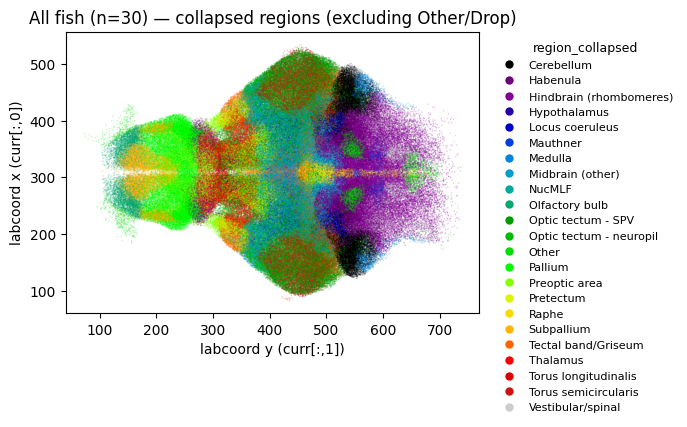

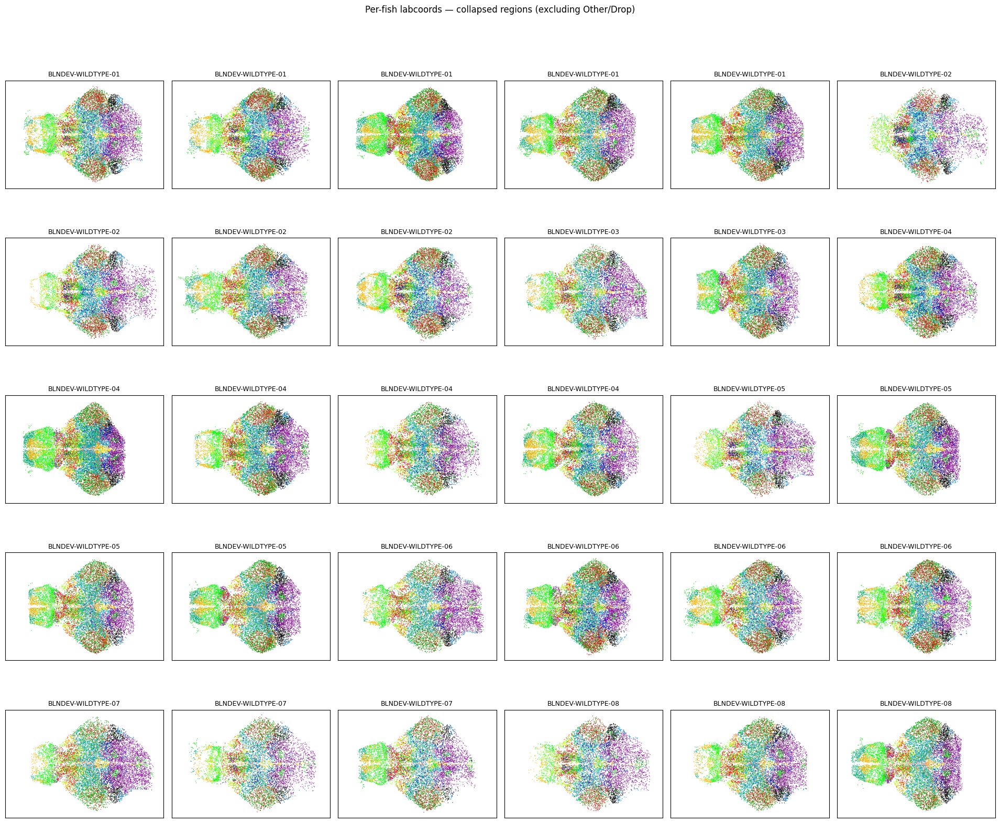

In [124]:
import os, glob, re
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

# coord_l  = np.sort(glob.glob(f"{fdata}/*labcoord_new*"))

# -----------------------------
# Helper: nice fish id from filename (edit if needed)
# -----------------------------
def fish_id_from_path(p):
    b = os.path.basename(p)
    # try common patterns; fallback to basename
    m = re.search(r"(BLNDEV-WILDTYPE-\d+)", b)
    if m:
        return m.group(1)
    return os.path.splitext(b)[0]

# -----------------------------
# Load all fish and build collapsed labels
# -----------------------------
all_data = []  # list of dicts: {id, x, y, lab}
for p in coord_l:
    curr = np.load(p, allow_pickle=True)

    x = curr[:, 1].astype(float)
    y = curr[:, 0].astype(float)
    raw = curr[:, 3].astype(str)

    lab = np.array([collapse_region(r) for r in raw], dtype=str)

    # drop
    keep = (lab != "Other/Drop")  # add (lab != "Other") too if you want
    x, y, lab = x[keep], y[keep], lab[keep]

    all_data.append({"id": fish_id_from_path(p), "x": x, "y": y, "lab": lab})

# -----------------------------
# Global label->color mapping (consistent across fish)
# -----------------------------
all_labels = np.concatenate([d["lab"] for d in all_data])
uniq = np.unique(all_labels)
label_to_i = {lab:i for i, lab in enumerate(uniq)}
K = len(uniq)

# A bigger categorical palette; tab20 is OK but limited—use nipy_spectral for many bins
cmap = plt.cm.get_cmap("tab20", K) if K <= 20 else plt.cm.get_cmap("nipy_spectral", K)

# -----------------------------
# Option A: overlay all fish in one plot
# -----------------------------
fig, ax = plt.subplots(figsize=(7, 7))

for d in all_data:
    c_int = np.array([label_to_i[lab] for lab in d["lab"]], dtype=int)
    ax.scatter(d["x"], d["y"], s=1, c=c_int, cmap=cmap, alpha=0.25, linewidths=0)

ax.set_aspect("equal", adjustable="box")
ax.set_xlabel("labcoord y (curr[:,1])")
ax.set_ylabel("labcoord x (curr[:,0])")
ax.set_title(f"All fish (n={len(all_data)}) — collapsed regions (excluding Other/Drop)")

# legend (one per region)
handles = [
    Line2D([0],[0], marker='o', linestyle='',
           markerfacecolor=cmap(i), markeredgecolor='none',
           markersize=6, label=lab)
    for lab, i in label_to_i.items()
]
ax.legend(handles=handles, title="region_collapsed",
          bbox_to_anchor=(1.02, 1), loc="upper left",
          frameon=False, fontsize=8, title_fontsize=9)

plt.tight_layout()
plt.show()

# -----------------------------
# Option B: small multiples (one subplot per fish) - usually nicer
# -----------------------------
n = len(all_data)
ncols = int(np.ceil(np.sqrt(n)))
nrows = int(np.ceil(n / ncols))

fig, axes = plt.subplots(nrows, ncols, figsize=(3.2*ncols, 3.2*nrows), sharex=True, sharey=True)
axes = np.atleast_1d(axes).ravel()

for ax, d in zip(axes, all_data):
    c_int = np.array([label_to_i[lab] for lab in d["lab"]], dtype=int)
    ax.scatter(d["x"], d["y"], s=1, c=c_int, cmap=cmap, alpha=0.9, linewidths=0)
    ax.set_aspect("equal", adjustable="box")
    ax.set_title(d["id"], fontsize=9)
    ax.set_xticks([])
    ax.set_yticks([])

# hide unused axes
for ax in axes[len(all_data):]:
    ax.axis("off")

fig.suptitle("Per-fish labcoords — collapsed regions (excluding Other/Drop)", y=1.02)
plt.tight_layout()
plt.show()


In [198]:
#================================================
def select_region1(trace, dff, bind, coord, region):
#================================================
    
    """
    This function slices data to include only those within a specific brain region.

    Inputs:
        trace (np array): cells x timepoints, raw fluorescence values
        dff (np array): cells x timepoints, normalised fluorescence
        bind (np array): cells x time, binarised state vector
        coord (np array): cells x XYZ coordinates and labels
        region (str): 'all', 'Diencephalon', 'Midbrain', 'Hindbrain' or 'Telencephalon'
    
    Returns:
        sub_trace (np array): cells x timepoints, raw or normalised fluorescence values for subregion
        sub_bind (np array): cells x time, binarised state vector for subregion
        sub_coord (np array): cells x XYZ coordinates for subregion
    
    
    """
    
    import numpy as np

    if coord.shape[0] != trace.shape[0]:
        print('Trace and coordinate data not same shape')
        return()


    if region == 'all':
        locs = np.where(coord[:,4] != 'nan')

    else: 
        locs = np.where(coord[:,5] == region)

    sub_coord = coord[locs][:,:3].astype(float)
    sub_trace, sub_dff, sub_bind = trace[locs], dff[locs], bind[locs]


    return(sub_dff)


In [140]:
all_labels = np.concatenate([d["lab"] for d in all_data])  # 1D array of all labels
newreg_l = np.unique(all_labels)
newreg_l

array(['Cerebellum', 'Habenula', 'Hindbrain (rhombomeres)',
       'Hypothalamus', 'Locus coeruleus', 'Mauthner', 'Medulla',
       'Midbrain (other)', 'NucMLF', 'Olfactory bulb',
       'Optic tectum - SPV', 'Optic tectum - neuropil', 'Other',
       'Pallium', 'Preoptic area', 'Pretectum', 'Raphe', 'Subpallium',
       'Tectal band/Griseum', 'Thalamus', 'Torus longitudinalis',
       'Torus semicircularis', 'Vestibular/spinal'], dtype='<U23')

In [163]:
fdata = "/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE"
dff_l  = np.sort(glob.glob(f"{fdata}/*regdeltaff*"))
bind_l  = np.sort(glob.glob(f"{fdata}/*regbin*"))
trace_l  = np.sort(glob.glob(f"{fdata}/*regtrace*"))
coord_l  = np.sort(glob.glob(f"{fdata}/*labcoord_new*"))
len(dff_l), len(bind_l), len(trace_l), len(coord_l)

(30, 30, 30, 30)

In [282]:
thr = 20 #less than neurons counted as nan
#estimate correlations 
def mean_pairwise_corr_rows_XY(X, Y, eps=1e-12, absval=True, thresh=None):
    """
    Mean (absolute) Pearson correlation over all row pairs (i in X, j in Y).

    X: (N, T), Y: (M, T) must share the same T (timepoints).
    If thresh is not None and (N < thresh or M < thresh), returns np.nan.
    """
    X = np.asarray(X, dtype=np.float32)
    Y = np.asarray(Y, dtype=np.float32)
    
    if X.ndim != 2 or Y.ndim != 2:
        raise ValueError("X and Y must be 2D arrays of shape (n_rows, n_time).")
    if X.shape[1] != Y.shape[1]:
        raise ValueError(f"Time dimension mismatch: X {X.shape}, Y {Y.shape}")

    if thresh is not None and (X.shape[0] < thresh or Y.shape[0] < thresh):
        return np.nan

    Xc = X - X.mean(axis=1, keepdims=True)
    Yc = Y - Y.mean(axis=1, keepdims=True)

    Xn = Xc / (Xc.std(axis=1, keepdims=True) + eps)
    Yn = Yc / (Yc.std(axis=1, keepdims=True) + eps)

    Cxy = (Xn @ Yn.T) / Xn.shape[1]   # (N, M)

    if absval:
        Cxy = np.abs(Cxy)

    return Cxy.mean()

#within group correlations, across group correlations, deal with low n (nan)
age_l, name_l, comb_l, met_l = [],[],[],[]
for i in tqdm(range(len(dff_l))):
    trace = np.load(trace_l[i])
    dff   = np.load(dff_l[i])
    coord = np.load(coord_l[i])
    bind  = np.load(bind_l[i])

    fish = adfn.save_name(dff_l[i])
    age  = parse_age_dpf(dff_l[i])

    data = {str(r): select_region1(trace, dff, bind, coord, r) for r in newreg_l}
    
    # ---- per region ----
    for r in newreg_l:
        curr_dff = data[r]
        comb_l.extend([ f'{r}_{i}' for i in newreg_l])
        met_l.extend([mean_pairwise_corr_rows_XY(curr_dff, data[i], thresh=thr) for i in newreg_l])
        age_l.extend([age] * len(newreg_l))
        name_l.extend([fish] * len(newreg_l))
comb_df = pd.DataFrame({ 'age':age_l, 'region': comb_l, 'fish': name_l, 'corr': met_l })
comb_df.to_csv("/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/regional_correlation.csv", index=True)

100%|█████████████████████████████████████| 30/30 [03:02<00:00,  6.07s/it]


In [310]:
comb_df = pd.read_csv("/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/regional_correlation.csv", index_col=0)
comb_df=comb_df[~comb_df['region'].str.contains('Other|neuropil')].copy()
parts = comb_df["region"].str.split("_", n=1, expand=True)
a = parts[0].astype(str)
b = parts[1].astype(str)

# canonical unordered pair key
comb_df["pair_key"] = np.where(a <= b, a + "_" + b, b + "_" + a)

# keep one row per (fish, age, unordered pair)  (or drop fish/age if you want global dedup)
comb_df = (comb_df
           .sort_values(["fish", "age", "pair_key"])   # deterministic
           .drop_duplicates(subset=["fish", "age", "pair_key"], keep="first")
           .drop(columns=["pair_key"])
           .copy())


In [160]:
import os
import numpy as np

def fish_id(p): 
    return os.path.basename(p)

n = 50  # threshold
use_collapsed = True      # False -> use raw regions in col 3
drop_labels = {"Other/Drop"}  # add "Other" if you want

for p in coord_l:
    curr = np.load(p, allow_pickle=True)

    col = -1 if use_collapsed else 3
    labs = curr[:, col].astype(str)

    # optionally drop some labels
    keep = ~np.isin(labs, list(drop_labels))
    labs = labs[keep]

    uniq, counts = np.unique(labs, return_counts=True)

    mask = counts < n
    if np.any(mask):
        print(f"\n{fish_id(p)}  (regions with < {n} cells: {mask.sum()})")
        # sort by count ascending
        order = np.argsort(counts[mask])
        for lab, ct in zip(uniq[mask][order], counts[mask][order]):
            print(f"  {ct:5d}  {lab}")
,


BLNDEV-WILDTYPE-01_2photon_sess-01-4dpf_BLNGR_run-01_labcoord_newreg.npy  (regions with < 50 cells: 3)
     27  NucMLF
     46  Habenula
     48  Mauthner

BLNDEV-WILDTYPE-01_2photon_sess-01-5dpf_BLNGR_run-01_labcoord_newreg.npy  (regions with < 50 cells: 3)
     36  Mauthner
     39  Habenula
     47  NucMLF

BLNDEV-WILDTYPE-01_2photon_sess-01-6dpf_BLNGR_run-01_labcoord_newreg.npy  (regions with < 50 cells: 3)
     31  Medulla
     33  Mauthner
     48  Torus longitudinalis

BLNDEV-WILDTYPE-01_2photon_sess-01-7dpf_BLNGR_run-01_labcoord_newreg.npy  (regions with < 50 cells: 3)
     12  Torus longitudinalis
     41  Mauthner
     44  NucMLF

BLNDEV-WILDTYPE-01_2photon_sess-01-8dpf_BLNGR_run-01_labcoord_newreg.npy  (regions with < 50 cells: 2)
     18  Torus longitudinalis
     44  Mauthner

BLNDEV-WILDTYPE-02_2photon_sess-01-3dpf_BLNGR_run-01_labcoord_newreg.npy  (regions with < 50 cells: 4)
      1  Habenula
     19  Subpallium
     32  Mauthner
     37  NucMLF

BLNDEV-WILDTYPE-02_2ph

''

In [314]:

from scipy.stats import spearmanr
from statsmodels.stats.multitest import multipletests

df = comb_df
df["fish"] = df["fish"].apply(lambda p: os.path.basename(str(p)))

# ---- ensure numeric ----
df = df.copy()
df["age"]  = pd.to_numeric(df["age"], errors="coerce")
df["corr"] = pd.to_numeric(df["corr"], errors="coerce")

# ---- Spearman per region-pair across fish ----
rows = []
for region, g in df.dropna(subset=["age", "corr"]).groupby("region"):
    # if you have repeated rows per fish per region, reduce first (mean/median)
    g = g.groupby("fish", as_index=False).agg(age=("age","mean"), corr=("corr","mean"))

    if len(g) < 3 or g["age"].nunique() < 2:
        rows.append({"region": region, "n_fish": len(g), "rho": np.nan, "p": np.nan})
        continue

    rho, p = spearmanr(g["age"].to_numpy(), g["corr"].to_numpy(), nan_policy="omit")
    rows.append({"region": region, "n_fish": len(g), "rho": float(rho), "p": float(p)})

res = pd.DataFrame(rows)

# ---- FDR correction across all region-pairs tested ----
mask = res["p"].notna()
pvals = res.loc[mask, "p"].to_numpy()

rej, qvals, _, _ = multipletests(pvals, alpha=0.1, method="fdr_bh")
res.loc[mask, "q"] = qvals
res.loc[mask, "sig_fdr_0p05"] = rej

# ---- nice sorting / view ----
res = res.sort_values(["sig_fdr_0p05", "q", "p"], ascending=[False, True, True])
res.head(30)

,region,n_fish,rho,p,q,sig_fdr_0p05
210,Subpallium_Subpallium,29,0.441770,0.016428,0.721463,False
170,Optic tectum - SPV_Subpallium,29,0.418282,0.023940,0.721463,False
0,Cerebellum_Cerebellum,30,-0.398686,0.029088,0.721463,False
4,Cerebellum_Locus coeruleus,30,-0.391466,0.032416,0.721463,False
140,NucMLF_NucMLF,30,-0.389661,0.033294,0.721463,False
20,Cerebellum_Vestibular/spinal,30,-0.387856,0.034192,0.721463,False
166,Optic tectum - SPV_Pallium,30,0.377477,0.039739,0.721463,False
180,Pallium_Subpallium,29,0.383550,0.039983,0.721463,False
78,Locus coeruleus_Locus coeruleus,30,-0.374995,0.041167,0.721463,False
29,Habenula_Olfactory bulb,22,0.429055,0.046310,0.721463,False


n sig pairs: 23
['Subpallium_Subpallium', 'Optic tectum - SPV_Subpallium', 'Cerebellum_Cerebellum', 'Cerebellum_Locus coeruleus', 'NucMLF_NucMLF', 'Cerebellum_Vestibular/spinal', 'Optic tectum - SPV_Pallium', 'Pallium_Subpallium', 'Locus coeruleus_Locus coeruleus', 'Habenula_Olfactory bulb', 'Subpallium_Thalamus', 'Subpallium_Torus semicircularis', 'Pretectum_Subpallium', 'Locus coeruleus_Vestibular/spinal', 'Pallium_Pallium', 'Habenula_Subpallium', 'Pallium_Torus semicircularis', 'Hindbrain (rhombomeres)_Subpallium', 'Midbrain (other)_Subpallium', 'Olfactory bulb_Subpallium', 'Habenula_Habenula', 'Raphe_Subpallium', 'Preoptic area_Vestibular/spinal']


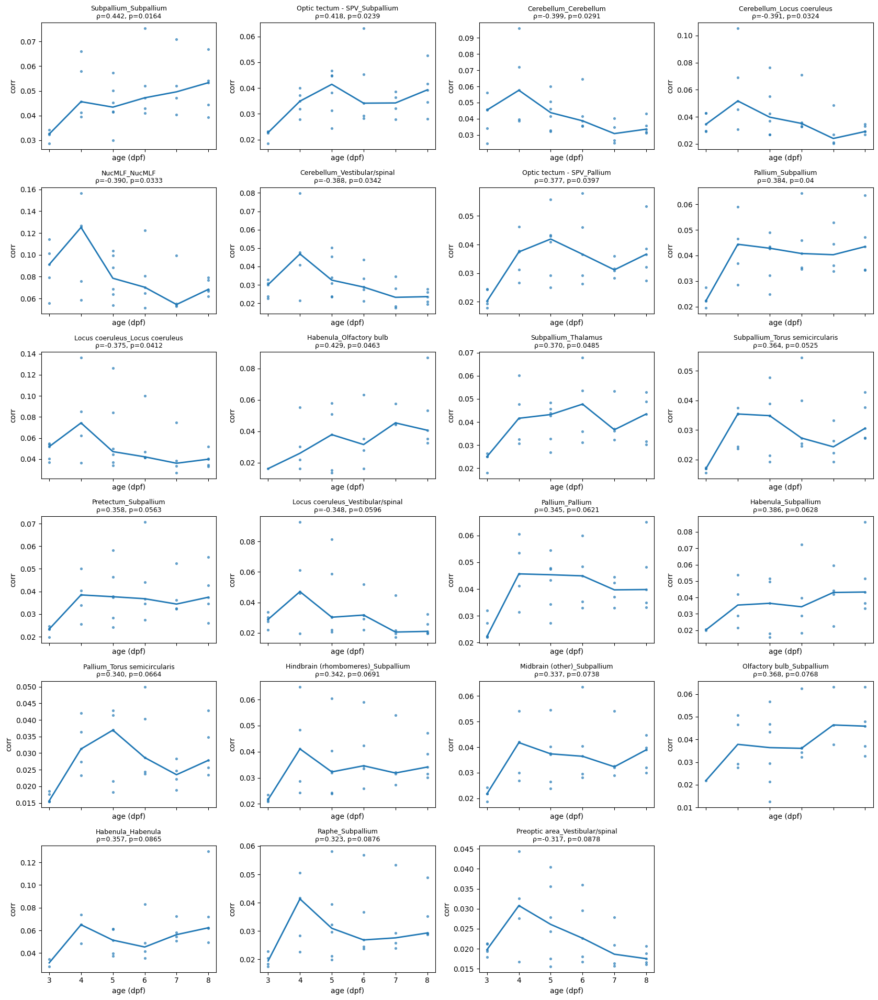

In [316]:


# -----------------------------
# 1) pick significant pairs
# -----------------------------
sig_pairs = (res.loc[res["p"].notna() & (res["p"] < 0.1), "region"]
             .astype(str)
             .tolist())

print("n sig pairs:", len(sig_pairs))
print(sig_pairs)

# -----------------------------
# 2) subset comb_df to those pairs
# -----------------------------
sub = comb_df[comb_df["region"].isin(sig_pairs)].copy()
sub["age"]  = pd.to_numeric(sub["age"], errors="coerce")
sub["corr"] = pd.to_numeric(sub["corr"], errors="coerce")
sub = sub.dropna(subset=["age","corr"])

# If duplicates exist per fish+age+region, collapse them (recommended)
sub["sample_id"] = sub["fish"].astype(str) + "_age" + sub["age"].astype(int).astype(str)
sub = (sub.groupby(["region","sample_id"], as_index=False)
          .agg(age=("age","mean"), corr=("corr","mean")))

# -----------------------------
# 3) plot: one panel per pair
# -----------------------------
pairs = sig_pairs
n = len(pairs)
ncols = 4
nrows = int(np.ceil(n / ncols))

fig, axes = plt.subplots(nrows, ncols, figsize=(4.2*ncols, 3.2*nrows), sharex=True)
axes = np.atleast_1d(axes).ravel()

for ax, pair in zip(axes, pairs):
    g = sub[sub["region"] == pair].copy()

    # scatter all fish
    ax.scatter(g["age"], g["corr"], s=14, alpha=0.7, linewidths=0)

    # median trend per age (nice summary)
    med = g.groupby("age")["corr"].median().sort_index()
    ax.plot(med.index.to_numpy(), med.to_numpy(), linewidth=2)

    # annotate with rho,p from res
    row = res.loc[res["region"] == pair].iloc[0]
    ax.set_title(f"{pair}\nρ={row['rho']:.3f}, p={row['p']:.3g}", fontsize=9)

    ax.set_xlabel("age (dpf)")
    ax.set_ylabel("corr")

# hide unused panels
for ax in axes[len(pairs):]:
    ax.axis("off")

plt.tight_layout()
plt.show()


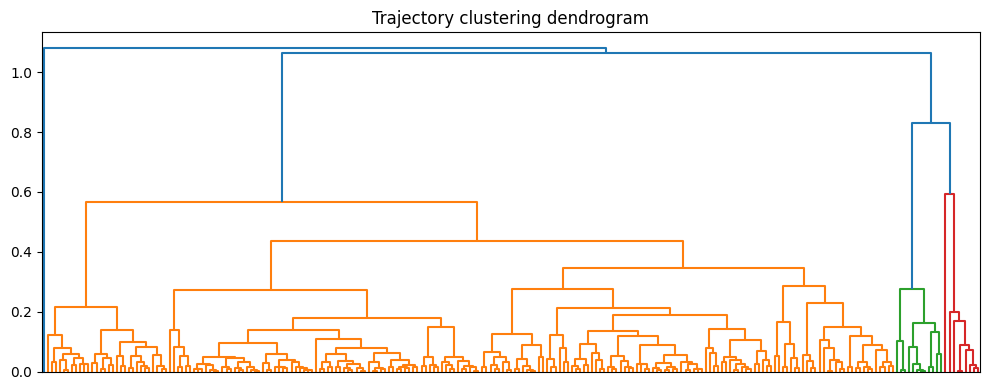

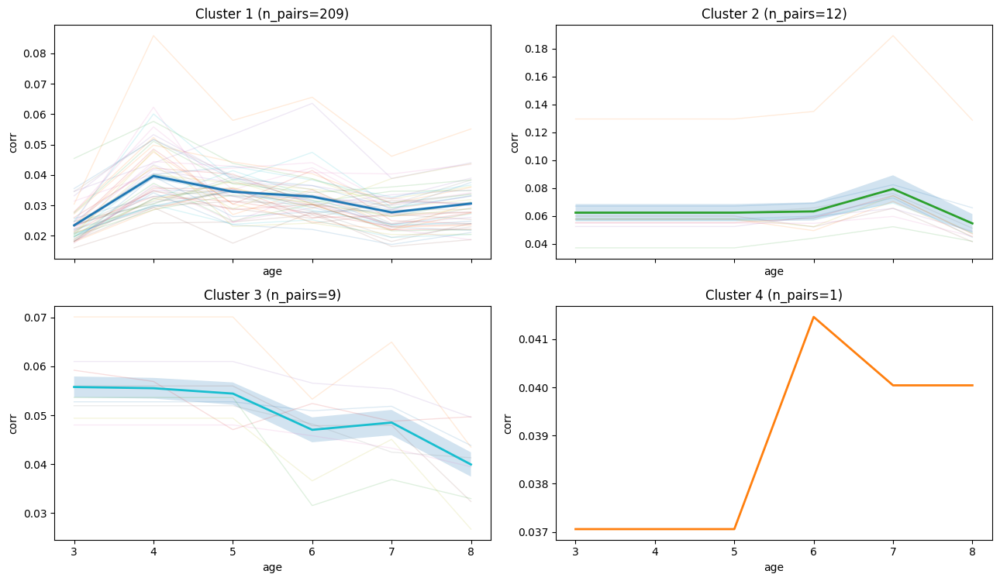

,region,cluster
0,Cerebellum_Cerebellum,1
1,Cerebellum_Habenula,1
2,Cerebellum_Hindbrain (rhombomeres),1
3,Cerebellum_Hypothalamus,1
4,Cerebellum_Locus coeruleus,1
5,Cerebellum_Mauthner,1
6,Cerebellum_Medulla,1
7,Cerebellum_Midbrain (other),1
8,Cerebellum_NucMLF,1
9,Cerebellum_Olfactory bulb,1


In [321]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import linkage, fcluster, dendrogram

# -----------------------------
# 1) Build trajectories: region-pair x age matrix
# -----------------------------
def build_pair_age_matrix(comb_df, pairs=None, agg_fish="mean", agg_age="median"):
    """
    Returns:
      ages: sorted unique ages
      M:    (n_pairs, n_ages) matrix of corr summaries
      pair_names: list length n_pairs
      counts: (n_pairs, n_ages) number of fish contributing
    """
    df = comb_df.copy()
    df["age"]  = pd.to_numeric(df["age"], errors="coerce")
    df["corr"] = pd.to_numeric(df["corr"], errors="coerce")
    df = df.dropna(subset=["age","corr"])

    if pairs is not None:
        df = df[df["region"].isin(pairs)].copy()

    # collapse duplicates per fish x age x region (if any)
    df = (df.groupby(["region","fish","age"], as_index=False)["corr"]
            .agg(agg_fish))

    ages = np.sort(df["age"].unique())

    # pivot to region x age (summary across fish at each age)
    if agg_age == "median":
        piv = df.pivot_table(index="region", columns="age", values="corr", aggfunc="median")
    elif agg_age == "mean":
        piv = df.pivot_table(index="region", columns="age", values="corr", aggfunc="mean")
    else:
        raise ValueError("agg_age must be 'median' or 'mean'")

    # counts per cell
    cnt = df.pivot_table(index="region", columns="age", values="corr", aggfunc="count")

    # ensure all ages present as columns
    piv = piv.reindex(columns=ages)
    cnt = cnt.reindex(columns=ages)

    pair_names = piv.index.to_list()
    M = piv.to_numpy(dtype=float)
    counts = cnt.to_numpy(dtype=float)
    return ages, M, pair_names, counts

# -----------------------------
# 2) Impute missing ages per pair (needed for clustering)
# -----------------------------
def impute_rows_linear(M, ages):
    """
    Linear interpolate along age axis within each row.
    Remaining NaNs (all-missing rows) stay NaN.
    """
    M_imp = M.copy()
    x = ages.astype(float)
    for i in range(M.shape[0]):
        y = M[i]
        m = np.isfinite(y)
        if m.sum() == 0:
            continue
        if m.sum() == 1:
            # with one point, fill all with that value
            M_imp[i, :] = y[m][0]
            continue
        # interpolate within [min_age,max_age] with data; extrapolate by edge values
        y_interp = np.interp(x, x[m], y[m])
        M_imp[i, :] = y_interp
    return M_imp

# -----------------------------
# 3) Cluster trajectories by SHAPE
# -----------------------------
def zscore_rows(M, eps=1e-12):
    mu = np.nanmean(M, axis=1, keepdims=True)
    sd = np.nanstd(M, axis=1, keepdims=True)
    return (M - mu) / (sd + eps)

def cluster_trajectories(M_shape, metric="correlation", method="average", k=4):
    """
    M_shape: (n_pairs, n_ages) trajectories (ideally z-scored)
    metric: 'correlation' is good for "similar manner"
    """
    # pdist needs finite values
    if not np.isfinite(M_shape).all():
        raise ValueError("M_shape contains NaNs/inf. Impute first.")
    D = pdist(M_shape, metric=metric)
    Z = linkage(D, method=method)
    labels = fcluster(Z, t=k, criterion="maxclust")
    return Z, labels

# -----------------------------
# 4) Plot clusters: mean±SEM + individual trajectories
# -----------------------------
def plot_cluster_trajectories(ages, M_raw, pair_names, labels, max_pairs_per_cluster=40):
    """
    Plots raw trajectories (not z-scored) so you can interpret magnitudes.
    """
    ages = np.asarray(ages)
    labs = np.asarray(labels)
    clusters = np.unique(labs)

    ncols = 2
    nrows = int(np.ceil(len(clusters) / ncols))
    fig, axes = plt.subplots(nrows, ncols, figsize=(6.5*ncols, 3.8*nrows), sharex=True)
    axes = np.atleast_1d(axes).ravel()

    for ax, c in zip(axes, clusters):
        idx = np.where(labs == c)[0]
        Y = M_raw[idx, :]  # (n_pairs_in_cluster, n_ages)

        # thin individual trajectories (optionally cap for readability)
        draw_idx = idx
        if len(idx) > max_pairs_per_cluster:
            draw_idx = np.random.default_rng(0).choice(idx, size=max_pairs_per_cluster, replace=False)
            Y_draw = M_raw[draw_idx, :]
        else:
            Y_draw = Y

        for row in Y_draw:
            ax.plot(ages, row, alpha=0.15, linewidth=1)

        # mean ± SEM across pairs (ignoring NaNs)
        mean = np.nanmean(Y, axis=0)
        sem  = np.nanstd(Y, axis=0) / np.sqrt(np.sum(np.isfinite(Y), axis=0).clip(min=1))

        ax.plot(ages, mean, linewidth=2)
        ax.fill_between(ages, mean-sem, mean+sem, alpha=0.2)

        ax.set_title(f"Cluster {c} (n_pairs={len(idx)})")
        ax.set_xlabel("age")
        ax.set_ylabel("corr")

    for ax in axes[len(clusters):]:
        ax.axis("off")

    plt.tight_layout()
    plt.show()
    return fig

# -----------------------------
# Example usage
# -----------------------------

# (A) optional: restrict to pairs you care about, e.g. p<0.05 from res
# sig_pairs = res.loc[res["p"] < 0.05, "region"].astype(str).tolist()
# ages, M, pair_names, counts = build_pair_age_matrix(comb_df, pairs=sig_pairs)

# (B) or cluster all pairs in comb_df
ages, M, pair_names, counts = build_pair_age_matrix(comb_df, pairs=None)

M_imp = impute_rows_linear(M, ages)

# cluster by SHAPE: z-score per pair before clustering
M_shape = zscore_rows(M_imp)

Z, labels = cluster_trajectories(M_shape, metric="correlation", method="average", k=4)

# Optional dendrogram
plt.figure(figsize=(10,4))
dendrogram(Z, no_labels=True, color_threshold=None)
plt.title("Trajectory clustering dendrogram")
plt.tight_layout()
plt.show()

# Plot clusters using the *raw* (imputed) trajectories
plot_cluster_trajectories(ages, M_imp, pair_names, labels, max_pairs_per_cluster=50)

# If you want the cluster assignments as a table:
clusters_df = pd.DataFrame({"region": pair_names, "cluster": labels})
clusters_df.sort_values(["cluster","region"]).head(20)


best_k: 6 silhouette: 0.31455509513497243


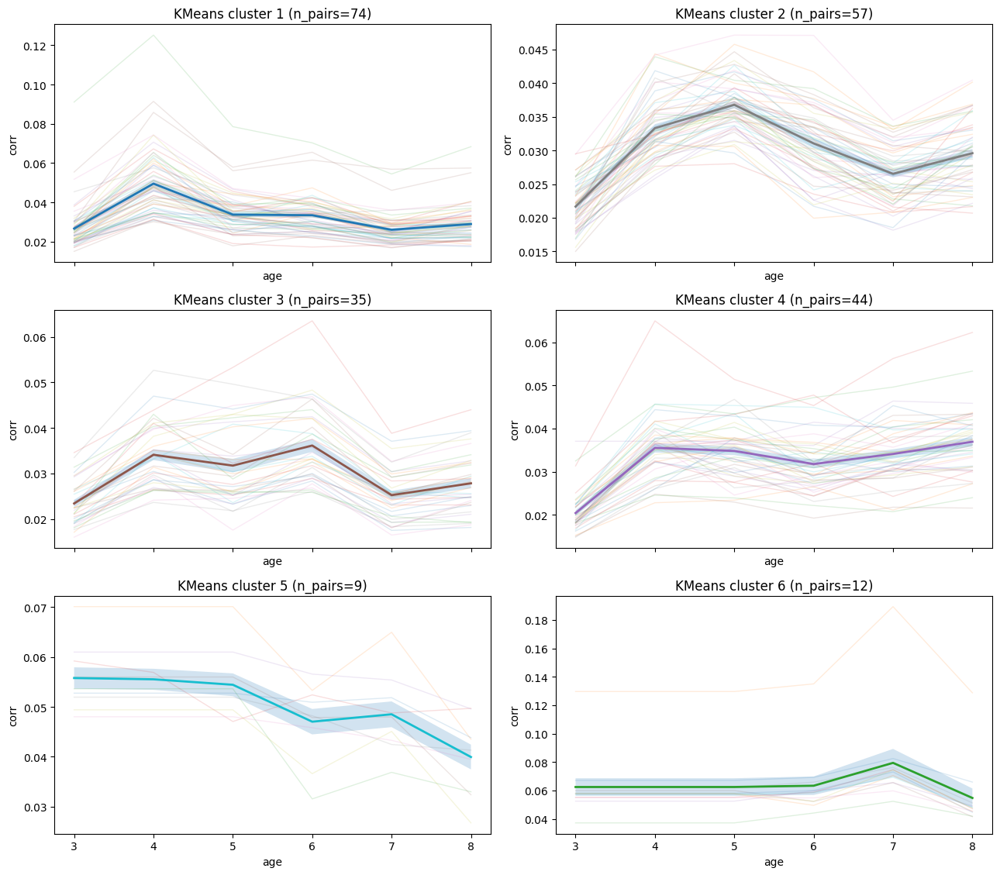

,region,cluster
0,Cerebellum_Cerebellum,1
2,Cerebellum_Hindbrain (rhombomeres),1
4,Cerebellum_Locus coeruleus,1
5,Cerebellum_Mauthner,1
6,Cerebellum_Medulla,1
7,Cerebellum_Midbrain (other),1
8,Cerebellum_NucMLF,1
13,Cerebellum_Pretectum,1
14,Cerebellum_Raphe,1
20,Cerebellum_Vestibular/spinal,1


In [322]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# ---------- 1) pair × age matrix ----------
def build_pair_age_matrix(comb_df, pairs=None, agg_fish="mean", agg_age="median"):
    df = comb_df.copy()
    df["age"]  = pd.to_numeric(df["age"], errors="coerce")
    df["corr"] = pd.to_numeric(df["corr"], errors="coerce")
    df = df.dropna(subset=["age","corr"])

    if pairs is not None:
        df = df[df["region"].isin(pairs)].copy()

    # collapse duplicates per fish×age×region
    df = df.groupby(["region","fish","age"], as_index=False)["corr"].agg(agg_fish)

    ages = np.sort(df["age"].unique())

    piv = df.pivot_table(index="region", columns="age", values="corr", aggfunc=agg_age)
    piv = piv.reindex(columns=ages)

    pair_names = piv.index.to_list()
    M = piv.to_numpy(dtype=float)
    return ages, M, pair_names

# ---------- 2) impute missing ages per pair ----------
def impute_rows_linear(M, ages):
    M_imp = M.copy()
    x = ages.astype(float)
    for i in range(M.shape[0]):
        y = M[i]
        m = np.isfinite(y)
        if m.sum() == 0:
            continue
        if m.sum() == 1:
            M_imp[i, :] = y[m][0]
            continue
        M_imp[i, :] = np.interp(x, x[m], y[m])
    return M_imp

# ---------- 3) z-score per pair (shape) ----------
def zscore_rows(M, eps=1e-12):
    mu = np.mean(M, axis=1, keepdims=True)
    sd = np.std(M, axis=1, keepdims=True)
    return (M - mu) / (sd + eps)

# ---------- 4) plot clusters ----------
def plot_kmeans_clusters(ages, M_raw, pair_names, labels, max_pairs_per_cluster=60):
    ages = np.asarray(ages)
    labels = np.asarray(labels)
    clusters = np.unique(labels)

    ncols = 2
    nrows = int(np.ceil(len(clusters) / ncols))
    fig, axes = plt.subplots(nrows, ncols, figsize=(6.5*ncols, 3.8*nrows), sharex=True)
    axes = np.atleast_1d(axes).ravel()

    rng = np.random.default_rng(0)

    for ax, c in zip(axes, clusters):
        idx = np.where(labels == c)[0]
        Y = M_raw[idx, :]

        # thin individual curves for readability
        draw_idx = idx
        if len(idx) > max_pairs_per_cluster:
            draw_idx = rng.choice(idx, size=max_pairs_per_cluster, replace=False)
            Y_draw = M_raw[draw_idx, :]
        else:
            Y_draw = Y

        for row in Y_draw:
            ax.plot(ages, row, alpha=0.15, linewidth=1)

        mean = np.mean(Y, axis=0)
        sem  = np.std(Y, axis=0) / np.sqrt(len(idx))

        ax.plot(ages, mean, linewidth=2)
        ax.fill_between(ages, mean-sem, mean+sem, alpha=0.2)
        ax.set_title(f"KMeans cluster {c} (n_pairs={len(idx)})")
        ax.set_xlabel("age")
        ax.set_ylabel("corr")

    for ax in axes[len(clusters):]:
        ax.axis("off")

    plt.tight_layout()
    plt.show()
    return fig

# =========================
# RUN IT
# =========================

# Optional: restrict to pairs with p<0.05
# sig_pairs = res.loc[res["p"] < 0.05, "region"].astype(str).tolist()
# ages, M, pair_names = build_pair_age_matrix(comb_df, pairs=sig_pairs)

ages, M, pair_names = build_pair_age_matrix(comb_df, pairs=None)

M_imp   = impute_rows_linear(M, ages)     # fill missing ages
M_shape = zscore_rows(M_imp)              # cluster by shape

# choose k (quick silhouette sweep; Euclidean because kmeans uses Euclidean)
ks = range(6, 21)
scores = []
for k in ks:
    km = KMeans(n_clusters=k, n_init=50, random_state=0)
    lab = km.fit_predict(M_shape)
    scores.append(silhouette_score(M_shape, lab))  # higher is better

best_k = int(ks[int(np.argmax(scores))])
print("best_k:", best_k, "silhouette:", max(scores))

# fit final kmeans
km = KMeans(n_clusters=best_k, n_init=100, random_state=0)
labels = km.fit_predict(M_shape) + 1  # +1 to make clusters 1..K

# plot clusters using raw (imputed) trajectories
plot_kmeans_clusters(ages, M_imp, pair_names, labels)

# cluster assignment table
clusters_df = pd.DataFrame({"region": pair_names, "cluster": labels})
clusters_df.sort_values(["cluster","region"]).head(30)


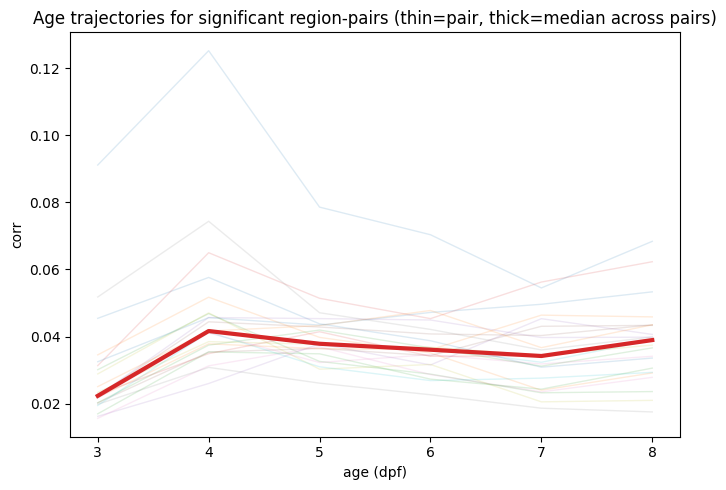

In [324]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# build trajectories: region-pair × age median across fish
traj = (sub.groupby(["region","age"])["corr"]
          .median()
          .unstack("age")
          .sort_index(axis=1))

ages = traj.columns.to_numpy(dtype=float)

fig, ax = plt.subplots(figsize=(7,5))

for pair, y in traj.iterrows():
    ax.plot(ages, y.to_numpy(dtype=float), alpha=0.15, linewidth=1)

# overall median trajectory across pairs
overall = np.nanmedian(traj.to_numpy(dtype=float), axis=0)
ax.plot(ages, overall, linewidth=3)

ax.set_xlabel("age (dpf)")
ax.set_ylabel("corr")
ax.set_title("Age trajectories for significant region-pairs (thin=pair, thick=median across pairs)")
plt.tight_layout()
plt.show()

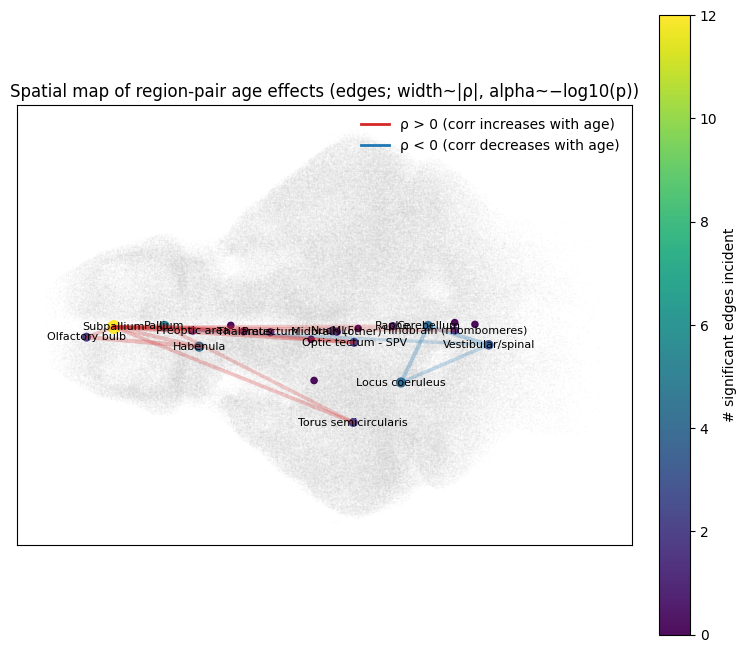

(<Figure size 750x750 with 2 Axes>,
 <Axes: title={'center': 'Spatial map of region-pair age effects (edges; width~|ρ|, alpha~−log10(p))'}>)

In [325]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

# ----------------------------
# 1) Build pooled points + region centroids (from all fish)
# ----------------------------
def compute_region_centroids(coord_l, collapse_region, drop=("Other/Drop", "Other")):
    xs, ys, labs = [], [], []
    for p in coord_l:
        curr = np.load(p, allow_pickle=True)
        x = curr[:, 1].astype(float)
        y = curr[:, 0].astype(float)
        raw = curr[:, 3].astype(str)
        lab = np.array([collapse_region(r) for r in raw], dtype=str)

        keep = ~np.isin(lab, list(drop))
        xs.append(x[keep]); ys.append(y[keep]); labs.append(lab[keep])

    X = np.concatenate(xs)
    Y = np.concatenate(ys)
    L = np.concatenate(labs)

    centroids = {}
    for reg in np.unique(L):
        m = (L == reg)
        centroids[reg] = (float(np.median(X[m])), float(np.median(Y[m])))
    return (X, Y, L), centroids

# ----------------------------
# 2) Turn res into unique unordered edges (A_B == B_A)
# ----------------------------
def edges_from_res(res, p_thresh=0.05, use_q=False):
    r = res.copy()
    r = r.dropna(subset=["rho", "p"])
    if use_q and ("q" in r.columns):
        r = r[r["q"] < p_thresh]
    else:
        r = r[r["p"] < p_thresh]

    # split "A_B" into A,B
    ab = r["region"].astype(str).str.split("_", n=1, expand=True)
    r["A"] = ab[0]
    r["B"] = ab[1]

    # canonical unordered key
    r["A2"] = np.where(r["A"] <= r["B"], r["A"], r["B"])
    r["B2"] = np.where(r["A"] <= r["B"], r["B"], r["A"])
    r["pair_key"] = r["A2"] + "_" + r["B2"]

    # keep best p per unordered pair (in case both directions exist)
    r = r.sort_values("p").drop_duplicates("pair_key", keep="first")

    return r[["A2", "B2", "rho", "p"]].rename(columns={"A2":"A", "B2":"B"})

# ----------------------------
# 3) Plot spatial edge map
# ----------------------------
def plot_spatial_age_effects(points, centroids, edges,
                             title="", max_edges=None,
                             linewidth_scale=6.0, alpha_scale=1.0):
    X, Y, L = points

    # keep only edges where both regions exist in centroids
    keep = edges["A"].isin(centroids) & edges["B"].isin(centroids)
    edges = edges.loc[keep].copy()

    if max_edges is not None and len(edges) > max_edges:
        # keep strongest by |rho| (or could sort by p)
        edges = edges.reindex(edges["rho"].abs().sort_values(ascending=False).index).head(max_edges)

    # region involvement score (# incident significant edges)
    involved = pd.concat([edges["A"], edges["B"]]).value_counts()
    involved = involved.to_dict()

    # base brain scatter (grey)
    fig, ax = plt.subplots(figsize=(7.5, 7.5))
    ax.scatter(X, Y, s=1, c="lightgrey", alpha=0.08, linewidths=0)

    # draw edges between centroids
    # (colour = sign of rho; width ~ |rho|; alpha ~ -log10(p))
    for _, row in edges.iterrows():
        a, b = row["A"], row["B"]
        rho, p = float(row["rho"]), float(row["p"])

        xa, ya = centroids[a]
        xb, yb = centroids[b]

        lw = 0.5 + linewidth_scale * abs(rho)
        aalpha = np.clip(alpha_scale * (-np.log10(p + 1e-300) / 5.0), 0.05, 0.95)

        col = "tab:red" if rho > 0 else "tab:blue"
        ax.plot([xa, xb], [ya, yb], linewidth=lw, alpha=aalpha, solid_capstyle="round", color=col)

    # plot centroid markers sized by involvement
    regs = sorted(centroids.keys())
    cx = np.array([centroids[r][0] for r in regs])
    cy = np.array([centroids[r][1] for r in regs])
    deg = np.array([involved.get(r, 0) for r in regs], dtype=float)

    # make size readable
    sizes = 20 + 60 * (deg / (deg.max() if deg.max() > 0 else 1.0))
    sc = ax.scatter(cx, cy, s=sizes, c=deg, alpha=0.95)

    # label only involved regions (keeps it readable)
    for r, x, y, d in zip(regs, cx, cy, deg):
        if d > 0:
            ax.text(x, y, r, fontsize=8, ha="center", va="center")

    ax.set_aspect("equal", adjustable="box")
    ax.set_xticks([]); ax.set_yticks([])
    ax.set_title(title)

    # legends
    leg = [
        Line2D([0],[0], color="tab:red", lw=2, label="ρ > 0 (corr increases with age)"),
        Line2D([0],[0], color="tab:blue", lw=2, label="ρ < 0 (corr decreases with age)"),
    ]
    ax.legend(handles=leg, loc="upper right", frameon=False)

    cb = plt.colorbar(sc, ax=ax, fraction=0.046, pad=0.04)
    cb.set_label("# significant edges incident")

    plt.tight_layout()
    plt.show()
    return fig, ax

# ============================
# RUN
# ============================

# 1) points + centroids from labcoords
points, centroids = compute_region_centroids(coord_l, collapse_region, drop=("Other/Drop", "Other"))

# 2) edges from res (choose your threshold)
edges = edges_from_res(res, p_thresh=0.1, use_q=False)  # or p_thresh=0.05

# 3) plot
plot_spatial_age_effects(
    points, centroids, edges,
    title="Spatial map of region-pair age effects (edges; width~|ρ|, alpha~−log10(p))",
    max_edges=40  # set None to plot all, or limit for readability
)

In [330]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

def plot_spatial_age_effects_with_regions(points, centroids, edges,
                                         title="", max_edges=None,
                                         linewidth_scale=6.0, alpha_scale=1.0,
                                         region_alpha=0.10, bg_alpha=0.03,
                                         max_pts_per_region=8000, seed=0):
    """
    points: (X,Y,L) where L are collapsed region labels per cell
    centroids: dict region -> (x,y)
    edges: df with columns ['A','B','rho','p']
    Adds light region-colored points for regions involved in plotted edges.
    """
    rng = np.random.default_rng(seed)

    X, Y, L = points

    # keep only edges where both regions exist in centroids
    keep = edges["A"].isin(centroids) & edges["B"].isin(centroids)
    edges = edges.loc[keep].copy()

    if max_edges is not None and len(edges) > max_edges:
        edges = edges.reindex(edges["rho"].abs().sort_values(ascending=False).index).head(max_edges)

    # regions involved in these edges
    involved_regs = sorted(set(edges["A"]).union(set(edges["B"])))

    # region -> color mapping (global, consistent)
    uniq = np.unique(L)
    label_to_i = {lab: i for i, lab in enumerate(uniq)}
    K = len(uniq)
    cmap = plt.cm.get_cmap("tab20", K) if K <= 20 else plt.cm.get_cmap("nipy_spectral", K)

    # region involvement score (# incident significant edges)
    involved_counts = pd.concat([edges["A"], edges["B"]]).value_counts().to_dict()

    fig, ax = plt.subplots(figsize=(7.8, 7.8))

    # ---- background brain ----
    ax.scatter(X, Y, s=1, c="lightgrey", alpha=bg_alpha, linewidths=0)

    # ---- lightly plot points for involved regions (region colours) ----
    for reg in involved_regs:
        if reg not in label_to_i:
            continue
        mask = (L == reg)
        idx = np.where(mask)[0]

        # downsample to keep it readable
        if idx.size > max_pts_per_region:
            idx = rng.choice(idx, size=max_pts_per_region, replace=False)

        ax.scatter(X[idx], Y[idx], s=1, color=cmap(label_to_i[reg]),
                   alpha=region_alpha, linewidths=0)

    # ---- draw edges between centroids ----
    for _, row in edges.iterrows():
        a, b = row["A"], row["B"]
        rho, p = float(row["rho"]), float(row["p"])

        xa, ya = centroids[a]
        xb, yb = centroids[b]

        lw = 0.5 + linewidth_scale * abs(rho)
        aalpha = np.clip(alpha_scale * (-np.log10(p + 1e-300) / 5.0), 0.05, 0.95)

        col = "tab:red" if rho > 0 else "tab:blue"
        ax.plot([xa, xb], [ya, yb], linewidth=lw, alpha=aalpha,
                solid_capstyle="round", color=col)

    # ---- centroid markers sized by involvement ----
    regs = involved_regs  # only show involved ones to reduce clutter
    cx = np.array([centroids[r][0] for r in regs])
    cy = np.array([centroids[r][1] for r in regs])
    deg = np.array([involved_counts.get(r, 0) for r in regs], dtype=float)

    sizes = 30 + 90 * (deg / (deg.max() if deg.max() > 0 else 1.0))
    sc = ax.scatter(cx, cy, s=sizes, c=deg, alpha=0.95, edgecolors="none")

    # label involved regions
    for r, x, y in zip(regs, cx, cy):
        ax.text(x, y, r, fontsize=8, ha="center", va="center")

    ax.set_aspect("equal", adjustable="box")
    ax.set_xticks([]); ax.set_yticks([])
    ax.set_title(title)

    # legends
    leg = [
        Line2D([0],[0], color="tab:red", lw=2, label="ρ > 0 (corr increases with age)"),
        Line2D([0],[0], color="tab:blue", lw=2, label="ρ < 0 (corr decreases with age)"),
        Line2D([0],[0], marker='o', linestyle='', color='lightgrey', markersize=6,
               label="all cells (background)")
    ]
    ax.legend(handles=leg, loc="upper right", frameon=False)

    cb = plt.colorbar(sc, ax=ax, fraction=0.046, pad=0.04)
    cb.set_label("# plotted edges incident")

    plt.tight_layout()
    plt.show()
    return fig, ax


/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/1735004806.py:35: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap("tab20", K) if K <= 20 else plt.cm.get_cmap("nipy_spectral", K)


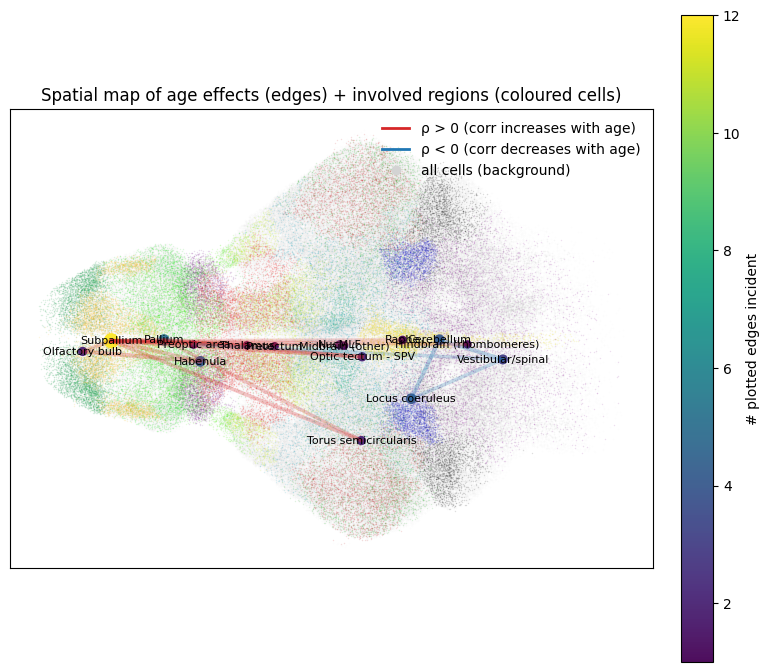

(<Figure size 780x780 with 2 Axes>,
 <Axes: title={'center': 'Spatial map of age effects (edges) + involved regions (coloured cells)'}>)

In [331]:
plot_spatial_age_effects_with_regions(
    points, centroids, edges,
    title="Spatial map of age effects (edges) + involved regions (coloured cells)",
    max_edges=40,
    region_alpha=0.12,      # increase to see regions more strongly
    bg_alpha=0.03,          # decrease to reduce clutter
    max_pts_per_region=6000 # reduce if dense
)


/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/346751039.py:31: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap("tab20", K) if K <= 20 else plt.cm.get_cmap("nipy_spectral", K)


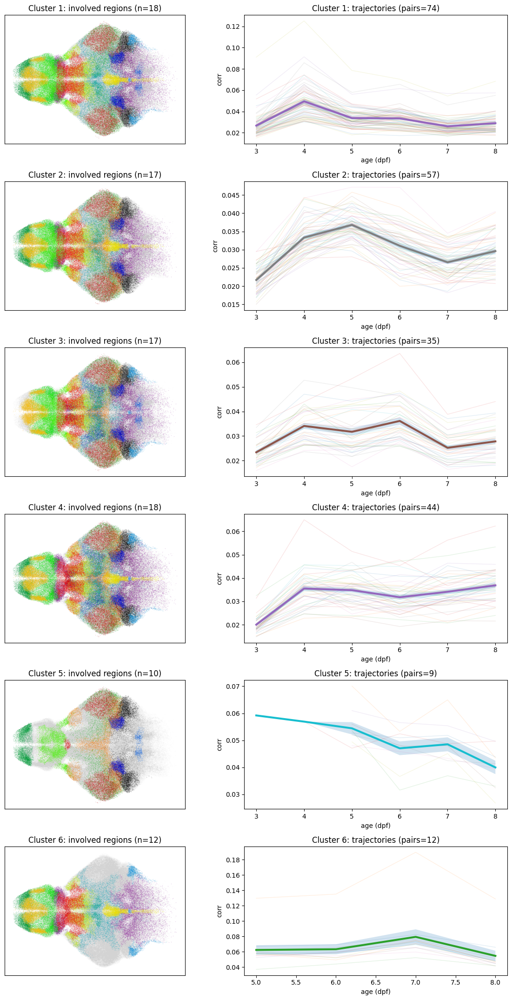

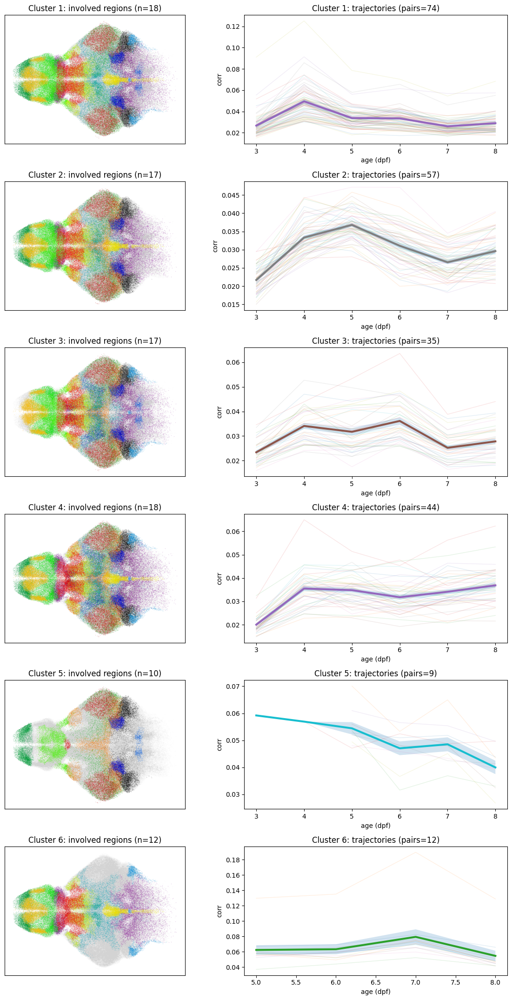

In [329]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# -----------------------------
# Helpers
# -----------------------------
def build_region_points(coord_l, collapse_region, drop=("Other/Drop", "Other")):
    """Pool all fish coords -> arrays X,Y,Lab (collapsed labels)."""
    xs, ys, labs = [], [], []
    for p in coord_l:
        curr = np.load(p, allow_pickle=True)
        x = curr[:, 1].astype(float)
        y = curr[:, 0].astype(float)
        raw = curr[:, 3].astype(str)
        lab = np.array([collapse_region(r) for r in raw], dtype=str)

        keep = ~np.isin(lab, list(drop))
        xs.append(x[keep]); ys.append(y[keep]); labs.append(lab[keep])

    X = np.concatenate(xs)
    Y = np.concatenate(ys)
    L = np.concatenate(labs)
    return X, Y, L

def make_region_colormap(labels):
    """Consistent label->index and a categorical cmap."""
    uniq = np.unique(labels)
    label_to_i = {lab: i for i, lab in enumerate(uniq)}
    K = len(uniq)
    cmap = plt.cm.get_cmap("tab20", K) if K <= 20 else plt.cm.get_cmap("nipy_spectral", K)
    return uniq, label_to_i, cmap

def pair_to_regions(pair_str):
    a, b = pair_str.split("_", 1)
    return a, b

def cluster_trajectories_from_combdf(comb_df, pairs):
    """Return age grid + matrix [n_pairs x n_ages] of median corr across fish."""
    sub = comb_df[comb_df["region"].isin(pairs)].copy()
    sub["age"]  = pd.to_numeric(sub["age"], errors="coerce")
    sub["corr"] = pd.to_numeric(sub["corr"], errors="coerce")
    sub = sub.dropna(subset=["age", "corr"])

    # collapse duplicates per fish×age×pair if any
    sub = (sub.groupby(["region","fish","age"], as_index=False)["corr"].mean())

    ages = np.sort(sub["age"].unique())
    traj = sub.pivot_table(index="region", columns="age", values="corr", aggfunc="median").reindex(columns=ages)
    return ages, traj

def downsample_mask(mask, max_n, rng):
    idx = np.where(mask)[0]
    if idx.size <= max_n:
        return mask
    pick = rng.choice(idx, size=max_n, replace=False)
    out = np.zeros_like(mask, dtype=bool)
    out[pick] = True
    return out

# -----------------------------
# Main plotting function
# -----------------------------
def plot_kmeans_clusters_spatial_and_trajectory(
    comb_df,
    clusters_df,
    coord_l,
    collapse_region,
    max_pts_per_region=8000,      # downsample per region in spatial plot
    max_pairs_per_cluster=80,      # downsample number of trajectories drawn
    bg_alpha=0.04,                # background brain alpha
    region_alpha=0.18,            # highlighted region alpha
    seed=0
):
    rng = np.random.default_rng(seed)

    # pooled spatial points + region colours
    X, Y, L = build_region_points(coord_l, collapse_region, drop=("Other/Drop","Other"))
    uniq_regs, label_to_i, cmap = make_region_colormap(L)

    # cluster list
    clusters = np.sort(clusters_df["cluster"].unique())
    K = len(clusters)

    # layout: one row per cluster, 2 columns (spatial | trajectory)
    fig, axes = plt.subplots(K, 2, figsize=(12, 3.6*K), sharex=False, sharey=False)
    if K == 1:
        axes = np.array([axes])  # ensure 2D

    for r_i, c in enumerate(clusters):
        ax_sp, ax_tr = axes[r_i, 0], axes[r_i, 1]

        pairs = clusters_df.loc[clusters_df["cluster"] == c, "region"].astype(str).tolist()
        if len(pairs) == 0:
            ax_sp.axis("off"); ax_tr.axis("off")
            continue

        # ---- involved regions in this cluster ----
        regs = set()
        for p in pairs:
            a, b = pair_to_regions(p)
            regs.add(a); regs.add(b)
        regs = sorted([rr for rr in regs if rr in label_to_i])  # keep only those present spatially

        # ---- spatial panel ----
        ax_sp.scatter(X, Y, s=1, c="lightgrey", alpha=bg_alpha, linewidths=0)

        for rr in regs:
            mask = (L == rr)
            mask = downsample_mask(mask, max_pts_per_region, rng)
            col = cmap(label_to_i[rr])
            ax_sp.scatter(X[mask], Y[mask], s=1, color=col, alpha=region_alpha, linewidths=0)

        ax_sp.set_aspect("equal", adjustable="box")
        ax_sp.set_xticks([]); ax_sp.set_yticks([])
        ax_sp.set_title(f"Cluster {c}: involved regions (n={len(regs)})")

        # ---- trajectory panel ----
        ages, traj = cluster_trajectories_from_combdf(comb_df, pairs)
        Ymat = traj.to_numpy(dtype=float)  # n_pairs x n_ages

        # downsample number of lines drawn (for visibility)
        pair_names = traj.index.to_list()
        idx = np.arange(len(pair_names))
        if len(idx) > max_pairs_per_cluster:
            idx_draw = rng.choice(idx, size=max_pairs_per_cluster, replace=False)
        else:
            idx_draw = idx

        # faint individual trajectories
        for ii in idx_draw:
            ax_tr.plot(ages, Ymat[ii, :], alpha=0.12, linewidth=1)

        # mean ± SEM across pairs (ignore NaNs)
        mean = np.nanmean(Ymat, axis=0)
        sem  = np.nanstd(Ymat, axis=0) / np.sqrt(np.sum(np.isfinite(Ymat), axis=0).clip(min=1))

        ax_tr.plot(ages, mean, linewidth=3)
        ax_tr.fill_between(ages, mean-sem, mean+sem, alpha=0.2)

        ax_tr.set_xlabel("age (dpf)")
        ax_tr.set_ylabel("corr")
        ax_tr.set_title(f"Cluster {c}: trajectories (pairs={len(pairs)})")

    plt.tight_layout()
    plt.show()
    return fig

# -----------------------------
# Example call
# -----------------------------
#clusters_df must have columns: ["region","cluster"]
plot_kmeans_clusters_spatial_and_trajectory(comb_df, clusters_df, coord_l, collapse_region)

/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/1012099700.py:44: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap("tab20", K) if K <= 20 else plt.cm.get_cmap("nipy_spectral", K)


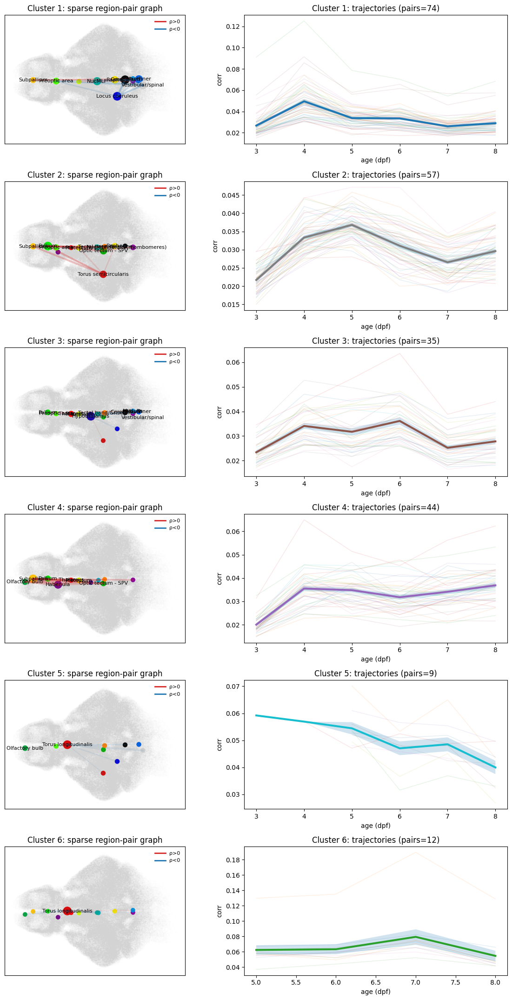

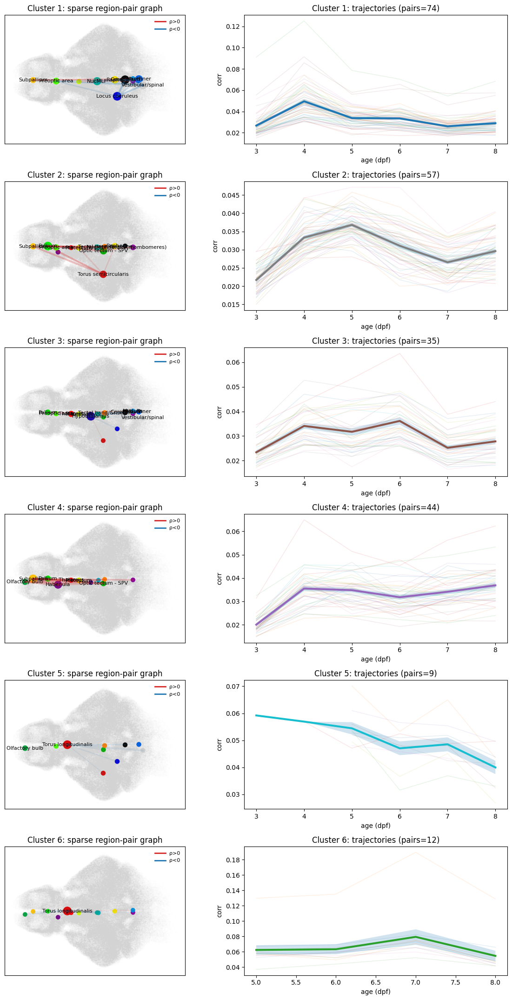

In [337]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

# ============================================================
# Spatially sparse KMeans-cluster summary:
#   For each KMeans cluster of region-pairs:
#     (LEFT)  node-edge graph on top of faint brain outline
#     (RIGHT) trajectories (pair x age) + cluster mean±SEM
#
# Requires:
#   - comb_df with columns: ['age','region','fish','corr']
#   - clusters_df with columns: ['region','cluster']  (region is "A_B")
#   - coord_l list of coord .npy paths
#   - collapse_region(region_str) function
#   - res with columns: ['region','rho','p'] (optional but used for edge weights/sign)
# ============================================================

# -----------------------------
# 1) pooled points + region centroids + stable region colours
# -----------------------------
def compute_centroids_and_colors(coord_l, collapse_region, drop=("Other/Drop","Other")):
    xs, ys, labs = [], [], []
    for p in coord_l:
        curr = np.load(p, allow_pickle=True)
        x = curr[:, 1].astype(float)
        y = curr[:, 0].astype(float)
        raw = curr[:, 3].astype(str)
        lab = np.array([collapse_region(r) for r in raw], dtype=str)
        keep = ~np.isin(lab, list(drop))
        xs.append(x[keep]); ys.append(y[keep]); labs.append(lab[keep])

    X = np.concatenate(xs); Y = np.concatenate(ys); L = np.concatenate(labs)

    centroids = {}
    for r in np.unique(L):
        m = (L == r)
        centroids[r] = (float(np.median(X[m])), float(np.median(Y[m])))

    uniq = np.unique(L)
    label_to_i = {lab:i for i, lab in enumerate(uniq)}
    K = len(uniq)
    cmap = plt.cm.get_cmap("tab20", K) if K <= 20 else plt.cm.get_cmap("nipy_spectral", K)

    return (X, Y, L), centroids, label_to_i, cmap

# -----------------------------
# 2) edge-lookup from res (unordered A_B == B_A)
# -----------------------------
def make_edge_lookup_from_res(res):
    r = res.dropna(subset=["region","rho","p"]).copy()
    ab = r["region"].astype(str).str.split("_", n=1, expand=True)
    r["A"], r["B"] = ab[0], ab[1]
    r["A2"] = np.where(r["A"] <= r["B"], r["A"], r["B"])
    r["B2"] = np.where(r["A"] <= r["B"], r["B"], r["A"])
    r["key"] = r["A2"] + "_" + r["B2"]
    r = r.sort_values("p").drop_duplicates("key", keep="first")
    rho = dict(zip(r["key"], r["rho"].astype(float)))
    p   = dict(zip(r["key"], r["p"].astype(float)))
    return rho, p

# -----------------------------
# 3) trajectories per cluster from comb_df
# -----------------------------
def cluster_trajectories_from_combdf(comb_df, pairs):
    sub = comb_df[comb_df["region"].isin(pairs)].copy()
    sub["age"]  = pd.to_numeric(sub["age"], errors="coerce")
    sub["corr"] = pd.to_numeric(sub["corr"], errors="coerce")
    sub = sub.dropna(subset=["age","corr"])

    # collapse duplicates per fish×age×pair (if any)
    sub = sub.groupby(["region","fish","age"], as_index=False)["corr"].mean()

    ages = np.sort(sub["age"].unique())
    traj = (sub.pivot_table(index="region", columns="age", values="corr", aggfunc="median")
              .reindex(columns=ages))
    return ages, traj

# -----------------------------
# 4) sparse graph plot for one cluster
# -----------------------------
def plot_cluster_graph(ax, pairs, centroids, label_to_i, cmap,
                       rho_lookup=None, p_lookup=None,
                       bg_points=None, bg_alpha=0.02,
                       max_edges=30, label_deg_min=2,
                       lw_scale=6.0):
    # canonicalize + unique edges
    edges = []
    for s in pairs:
        a, b = str(s).split("_", 1)
        A, B = (a, b) if a <= b else (b, a)
        key = f"{A}_{B}"
        if (A in centroids) and (B in centroids):
            edges.append((A, B, key))

    seen = set()
    edges_u = []
    for A, B, key in edges:
        if key not in seen:
            edges_u.append((A, B, key))
            seen.add(key)

    # keep strongest edges by |rho| if provided
    if rho_lookup is not None and len(edges_u) > max_edges:
        edges_u = sorted(edges_u, key=lambda t: abs(rho_lookup.get(t[2], 0.0)), reverse=True)[:max_edges]

    # background brain scatter
    if bg_points is not None:
        X, Y, _ = bg_points
        ax.scatter(X, Y, s=1, c="lightgrey", alpha=bg_alpha, linewidths=0)

    # degrees within cluster
    deg = {}
    for A, B, _ in edges_u:
        deg[A] = deg.get(A, 0) + 1
        deg[B] = deg.get(B, 0) + 1

    # edges
    for A, B, key in edges_u:
        xa, ya = centroids[A]
        xb, yb = centroids[B]

        rho = rho_lookup.get(key, 0.0) if rho_lookup is not None else 0.0
        p   = p_lookup.get(key, 1.0)   if p_lookup is not None else 1.0

        w = abs(rho)
        lw = 0.6 + lw_scale * w
        col = "tab:red" if rho > 0 else "tab:blue"
        aalpha = np.clip((-np.log10(p + 1e-300))/5.0, 0.08, 0.9) if p_lookup is not None else 0.4

        ax.plot([xa, xb], [ya, yb], color=col, linewidth=lw, alpha=aalpha, solid_capstyle="round")

    # nodes (only involved)
    regs = sorted(deg.keys())
    cx = np.array([centroids[r][0] for r in regs])
    cy = np.array([centroids[r][1] for r in regs])
    d  = np.array([deg[r] for r in regs], dtype=float)

    sizes = 40 + 140 * (d / (d.max() if d.max() > 0 else 1.0))
    cols  = [cmap(label_to_i[r]) for r in regs]
    ax.scatter(cx, cy, s=sizes, c=cols, alpha=0.95, edgecolors="none")

    # label only higher-degree nodes
    for r, x, y, dd in zip(regs, cx, cy, d):
        if dd >= label_deg_min:
            ax.text(x, y, r, fontsize=8, ha="center", va="center")

    ax.set_aspect("equal", adjustable="box")
    ax.set_xticks([]); ax.set_yticks([])

    ax.legend(handles=[
        Line2D([0],[0], color="tab:red", lw=2, label="ρ>0"),
        Line2D([0],[0], color="tab:blue", lw=2, label="ρ<0"),
    ], loc="upper right", frameon=False, fontsize=8)

# -----------------------------
# 5) full cluster figure: graph + trajectories
# -----------------------------
def plot_kmeans_clusters_sparse_graph_and_trajectories(
    comb_df, clusters_df, coord_l, collapse_region, res=None,
    max_edges=30, max_pairs_draw=80, bg_alpha=0.02,
    label_deg_min=2, seed=0
):
    rng = np.random.default_rng(seed)

    bg_points, centroids, label_to_i, cmap = compute_centroids_and_colors(coord_l, collapse_region)

    rho_lookup, p_lookup = (None, None)
    if res is not None:
        rho_lookup, p_lookup = make_edge_lookup_from_res(res)

    clusters = np.sort(clusters_df["cluster"].unique())
    K = len(clusters)

    fig, axes = plt.subplots(K, 2, figsize=(12, 3.6*K))
    if K == 1:
        axes = np.array([axes])

    for r_i, c in enumerate(clusters):
        ax_sp, ax_tr = axes[r_i, 0], axes[r_i, 1]
        pairs = clusters_df.loc[clusters_df["cluster"] == c, "region"].astype(str).tolist()

        # LEFT: sparse node-edge graph
        plot_cluster_graph(
            ax_sp, pairs, centroids, label_to_i, cmap,
            rho_lookup=rho_lookup, p_lookup=p_lookup,
            bg_points=bg_points, bg_alpha=bg_alpha,
            max_edges=max_edges, label_deg_min=label_deg_min
        )
        ax_sp.set_title(f"Cluster {c}: sparse region-pair graph")

        # RIGHT: trajectories + mean±SEM
        ages, traj = cluster_trajectories_from_combdf(comb_df, pairs)
        Ymat = traj.to_numpy(dtype=float)

        idx = np.arange(Ymat.shape[0])
        if idx.size > max_pairs_draw:
            idx = rng.choice(idx, size=max_pairs_draw, replace=False)

        for ii in idx:
            ax_tr.plot(ages, Ymat[ii, :], alpha=0.12, linewidth=1)

        mean = np.nanmean(Ymat, axis=0)
        sem  = np.nanstd(Ymat, axis=0) / np.sqrt(np.sum(np.isfinite(Ymat), axis=0).clip(min=1))

        ax_tr.plot(ages, mean, linewidth=3)
        ax_tr.fill_between(ages, mean-sem, mean+sem, alpha=0.2)

        ax_tr.set_xlabel("age (dpf)")
        ax_tr.set_ylabel("corr")
        ax_tr.set_title(f"Cluster {c}: trajectories (pairs={len(pairs)})")

    plt.tight_layout()
    plt.show()
    return fig

# ============================================================
# RUN (uses your existing variables)
# ============================================================
# plot_kmeans_clusters_sparse_graph_and_trajectories(
#     comb_df, clusters_df, coord_l, collapse_region, res=res,
#     max_edges=20,          # sparser connectivity per cluster
#     max_pairs_draw=60,     # fewer trajectories per cluster for visibility
#     bg_alpha=0.02,
#     label_deg_min=2,
#     seed=0
# )

plot_kmeans_clusters_sparse_graph_and_trajectories(
    comb_df, clusters_df, coord_l, collapse_region, res=res,
    max_edges=20,
    max_pairs_draw=60,
    bg_alpha=0.02,
    label_deg_min=2,
    seed=0
)


/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/2701505670.py:47: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap("tab20", K) if K <= 20 else plt.cm.get_cmap("nipy_spectral", K)


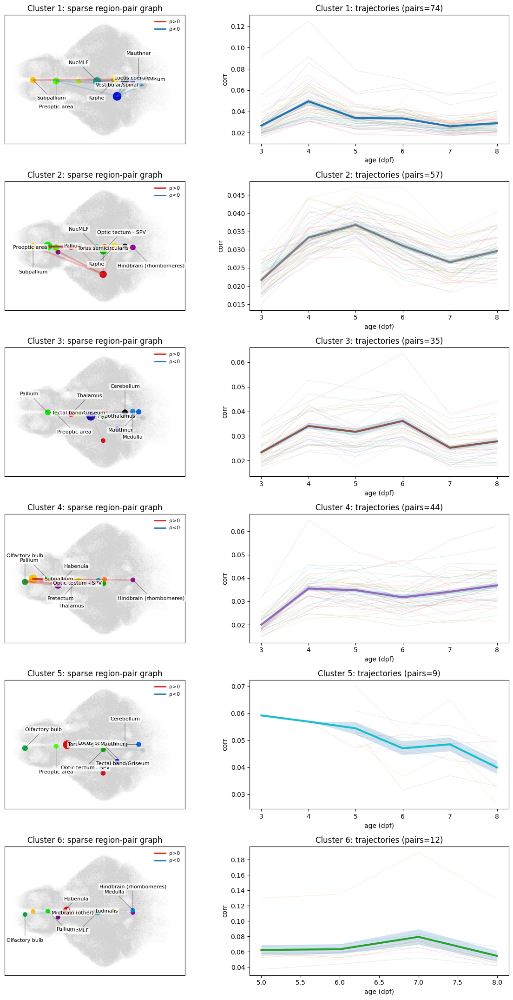

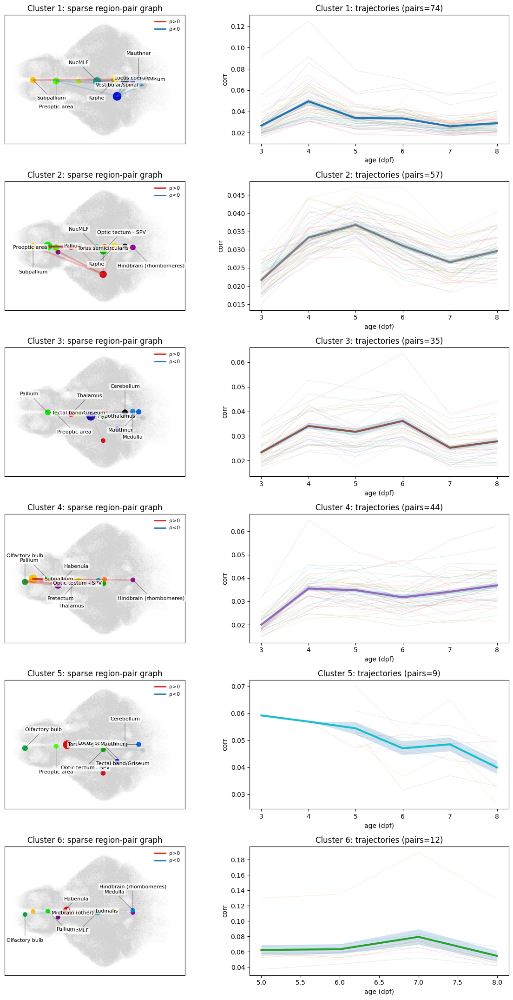

In [339]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

# ============================================================
# Spatially sparse KMeans-cluster summary (readable labels):
#   For each KMeans cluster of region-pairs:
#     (LEFT)  node-edge graph on top of faint brain outline
#            - nodes are region centroids, coloured by region
#            - edges are region-pairs in cluster (width~|rho|, colour=sign)
#            - labels only for top hub nodes, offset with arrows (no overlap)
#     (RIGHT) trajectories (pair x age) + cluster mean±SEM
#
# Requires:
#   - comb_df with columns: ['age','region','fish','corr']
#   - clusters_df with columns: ['region','cluster']  (region is "A_B")
#   - coord_l list of coord .npy paths
#   - collapse_region(region_str) function
#   - res with columns: ['region','rho','p'] (optional but used for edge weights/sign)
# ============================================================

# -----------------------------
# 1) pooled points + region centroids + stable region colours
# -----------------------------
def compute_centroids_and_colors(coord_l, collapse_region, drop=("Other/Drop","Other")):
    xs, ys, labs = [], [], []
    for p in coord_l:
        curr = np.load(p, allow_pickle=True)
        x = curr[:, 1].astype(float)
        y = curr[:, 0].astype(float)
        raw = curr[:, 3].astype(str)
        lab = np.array([collapse_region(r) for r in raw], dtype=str)
        keep = ~np.isin(lab, list(drop))
        xs.append(x[keep]); ys.append(y[keep]); labs.append(lab[keep])

    X = np.concatenate(xs); Y = np.concatenate(ys); L = np.concatenate(labs)

    centroids = {}
    for r in np.unique(L):
        m = (L == r)
        centroids[r] = (float(np.median(X[m])), float(np.median(Y[m])))

    uniq = np.unique(L)
    label_to_i = {lab:i for i, lab in enumerate(uniq)}
    K = len(uniq)
    cmap = plt.cm.get_cmap("tab20", K) if K <= 20 else plt.cm.get_cmap("nipy_spectral", K)

    return (X, Y, L), centroids, label_to_i, cmap

# -----------------------------
# 2) edge-lookup from res (unordered A_B == B_A)
# -----------------------------
def make_edge_lookup_from_res(res):
    r = res.dropna(subset=["region","rho","p"]).copy()
    ab = r["region"].astype(str).str.split("_", n=1, expand=True)
    r["A"], r["B"] = ab[0], ab[1]
    r["A2"] = np.where(r["A"] <= r["B"], r["A"], r["B"])
    r["B2"] = np.where(r["A"] <= r["B"], r["B"], r["A"])
    r["key"] = r["A2"] + "_" + r["B2"]
    r = r.sort_values("p").drop_duplicates("key", keep="first")
    rho = dict(zip(r["key"], r["rho"].astype(float)))
    p   = dict(zip(r["key"], r["p"].astype(float)))
    return rho, p

# -----------------------------
# 3) trajectories per cluster from comb_df
# -----------------------------
def cluster_trajectories_from_combdf(comb_df, pairs):
    sub = comb_df[comb_df["region"].isin(pairs)].copy()
    sub["age"]  = pd.to_numeric(sub["age"], errors="coerce")
    sub["corr"] = pd.to_numeric(sub["corr"], errors="coerce")
    sub = sub.dropna(subset=["age","corr"])

    # collapse duplicates per fish×age×pair (if any)
    sub = sub.groupby(["region","fish","age"], as_index=False)["corr"].mean()

    ages = np.sort(sub["age"].unique())
    traj = (sub.pivot_table(index="region", columns="age", values="corr", aggfunc="median")
              .reindex(columns=ages))
    return ages, traj

# -----------------------------
# 4) sparse graph plot for one cluster (readable hub labels)
# -----------------------------
def plot_cluster_graph(ax, pairs, centroids, label_to_i, cmap,
                       rho_lookup=None, p_lookup=None,
                       bg_points=None, bg_alpha=0.02,
                       max_edges=20, lw_scale=6.0,
                       label_top_n=8, label_radius_pts=18):
    # canonicalize + unique edges
    edges = []
    for s in pairs:
        a, b = str(s).split("_", 1)
        A, B = (a, b) if a <= b else (b, a)
        key = f"{A}_{B}"
        if (A in centroids) and (B in centroids):
            edges.append((A, B, key))

    seen = set()
    edges_u = []
    for A, B, key in edges:
        if key not in seen:
            edges_u.append((A, B, key))
            seen.add(key)

    # keep strongest edges by |rho| if provided
    if rho_lookup is not None and len(edges_u) > max_edges:
        edges_u = sorted(edges_u, key=lambda t: abs(rho_lookup.get(t[2], 0.0)), reverse=True)[:max_edges]

    # background brain scatter
    if bg_points is not None:
        X, Y, _ = bg_points
        ax.scatter(X, Y, s=1, c="lightgrey", alpha=bg_alpha, linewidths=0)

    # degrees within cluster
    deg = {}
    for A, B, _ in edges_u:
        deg[A] = deg.get(A, 0) + 1
        deg[B] = deg.get(B, 0) + 1

    # edges
    for A, B, key in edges_u:
        xa, ya = centroids[A]
        xb, yb = centroids[B]

        rho = rho_lookup.get(key, 0.0) if rho_lookup is not None else 0.0
        p   = p_lookup.get(key, 1.0)   if p_lookup is not None else 1.0

        w = abs(rho)
        lw = 0.6 + lw_scale * w
        col = "tab:red" if rho > 0 else "tab:blue"
        aalpha = np.clip((-np.log10(p + 1e-300))/5.0, 0.08, 0.9) if p_lookup is not None else 0.4

        ax.plot([xa, xb], [ya, yb], color=col, linewidth=lw, alpha=aalpha, solid_capstyle="round")

    # nodes (only involved)
    regs = sorted(deg.keys())
    cx = np.array([centroids[r][0] for r in regs])
    cy = np.array([centroids[r][1] for r in regs])
    d  = np.array([deg[r] for r in regs], dtype=float)

    sizes = 40 + 140 * (d / (d.max() if d.max() > 0 else 1.0))
    cols  = [cmap(label_to_i[r]) for r in regs]
    ax.scatter(cx, cy, s=sizes, c=cols, alpha=0.95, edgecolors="none")

    # label only top hubs, offset around a circle with arrows + white bbox
    if len(regs) > 0:
        order = np.argsort(-d)  # descending degree
        nlab = min(label_top_n, len(order))
        lab_idx = order[:nlab]
        angles = np.linspace(0, 2*np.pi, nlab, endpoint=False)

        for k, ii in enumerate(lab_idx):
            rname = regs[ii]
            x, y = cx[ii], cy[ii]
            dx = label_radius_pts * np.cos(angles[k])
            dy = label_radius_pts * np.sin(angles[k])

            ax.annotate(
                rname,
                xy=(x, y),
                xytext=(dx, dy),
                textcoords="offset points",
                ha="center", va="center",
                fontsize=8,
                bbox=dict(boxstyle="round,pad=0.2", fc="white", ec="none", alpha=0.75),
                arrowprops=dict(arrowstyle="-", lw=0.7, color="black", alpha=0.5)
            )

    ax.set_aspect("equal", adjustable="box")
    ax.set_xticks([]); ax.set_yticks([])

    ax.legend(handles=[
        Line2D([0],[0], color="tab:red", lw=2, label="ρ>0"),
        Line2D([0],[0], color="tab:blue", lw=2, label="ρ<0"),
    ], loc="upper right", frameon=False, fontsize=8)

# -----------------------------
# 5) full cluster figure: graph + trajectories
# -----------------------------
def plot_kmeans_clusters_sparse_graph_and_trajectories(
    comb_df, clusters_df, coord_l, collapse_region, res=None,
    max_edges=20, max_pairs_draw=60, bg_alpha=0.02,
    label_top_n=8, label_radius_pts=18, seed=0
):
    rng = np.random.default_rng(seed)

    bg_points, centroids, label_to_i, cmap = compute_centroids_and_colors(coord_l, collapse_region)

    rho_lookup, p_lookup = (None, None)
    if res is not None:
        rho_lookup, p_lookup = make_edge_lookup_from_res(res)

    clusters = np.sort(clusters_df["cluster"].unique())
    K = len(clusters)

    fig, axes = plt.subplots(K, 2, figsize=(12, 3.6*K))
    if K == 1:
        axes = np.array([axes])

    for r_i, c in enumerate(clusters):
        ax_sp, ax_tr = axes[r_i, 0], axes[r_i, 1]
        pairs = clusters_df.loc[clusters_df["cluster"] == c, "region"].astype(str).tolist()

        # LEFT: sparse node-edge graph
        plot_cluster_graph(
            ax_sp, pairs, centroids, label_to_i, cmap,
            rho_lookup=rho_lookup, p_lookup=p_lookup,
            bg_points=bg_points, bg_alpha=bg_alpha,
            max_edges=max_edges, lw_scale=6.0,
            label_top_n=label_top_n, label_radius_pts=label_radius_pts
        )
        ax_sp.set_title(f"Cluster {c}: sparse region-pair graph")

        # RIGHT: trajectories + mean±SEM
        ages, traj = cluster_trajectories_from_combdf(comb_df, pairs)
        Ymat = traj.to_numpy(dtype=float)

        idx = np.arange(Ymat.shape[0])
        if idx.size > max_pairs_draw:
            idx = rng.choice(idx, size=max_pairs_draw, replace=False)

        for ii in idx:
            ax_tr.plot(ages, Ymat[ii, :], alpha=0.12, linewidth=1)

        mean = np.nanmean(Ymat, axis=0)
        sem  = np.nanstd(Ymat, axis=0) / np.sqrt(np.sum(np.isfinite(Ymat), axis=0).clip(min=1))

        ax_tr.plot(ages, mean, linewidth=3)
        ax_tr.fill_between(ages, mean-sem, mean+sem, alpha=0.2)

        ax_tr.set_xlabel("age (dpf)")
        ax_tr.set_ylabel("corr")
        ax_tr.set_title(f"Cluster {c}: trajectories (pairs={len(pairs)})")

    plt.tight_layout()
    plt.show()
    return fig

# ============================================================
# RUN
# ============================================================
# Tuning tips:
#   - If still cluttered: max_edges=12, label_top_n=5
#   - If labels too close/far: label_radius_pts=12..28
plot_kmeans_clusters_sparse_graph_and_trajectories(
    comb_df, clusters_df, coord_l, collapse_region, res=res,
    max_edges=20,
    max_pairs_draw=60,
    bg_alpha=0.02,
    label_top_n=8,
    label_radius_pts=40,
    seed=0
)


In [341]:
import numpy as np
import pandas as pd
from tqdm import tqdm

thr = 20  # less than neurons counted as nan

def mean_pairwise_corr_rows_XY(X, Y, eps=1e-12, absval=True, thresh=None):
    """
    Mean (absolute) Pearson correlation over all row pairs (i in X, j in Y).
    X: (N, T), Y: (M, T) must share the same T (timepoints).
    If thresh is not None and (N < thresh or M < thresh), returns np.nan.
    """
    X = np.asarray(X, dtype=np.float32)
    Y = np.asarray(Y, dtype=np.float32)

    if X.ndim != 2 or Y.ndim != 2:
        raise ValueError("X and Y must be 2D arrays of shape (n_rows, n_time).")
    if X.shape[1] != Y.shape[1]:
        raise ValueError(f"Time dimension mismatch: X {X.shape}, Y {Y.shape}")

    if thresh is not None and (X.shape[0] < thresh or Y.shape[0] < thresh):
        return np.nan

    Xc = X - X.mean(axis=1, keepdims=True)
    Yc = Y - Y.mean(axis=1, keepdims=True)

    Xn = Xc / (Xc.std(axis=1, keepdims=True) + eps)
    Yn = Yc / (Yc.std(axis=1, keepdims=True) + eps)

    Cxy = (Xn @ Yn.T) / Xn.shape[1]   # (N, M)
    if absval:
        Cxy = np.abs(Cxy)

    return float(Cxy.mean())


# ---------------------------------------
# Compute all correlations (no threshold yet)
# ---------------------------------------
age_l, name_l, comb_l, met_l = [], [], [], []

for fi in tqdm(range(len(dff_l))):
    trace = np.load(trace_l[fi])
    dff   = np.load(dff_l[fi])
    coord = np.load(coord_l[fi])
    bind  = np.load(bind_l[fi])

    fish = adfn.save_name(dff_l[fi])
    age  = parse_age_dpf(dff_l[fi])

    # IMPORTANT: if select_region1 returns a tuple, extract the dff matrix (commonly index 1)
    data = {}
    for r in newreg_l:
        out = select_region1(trace, dff, bind, coord, r)
        sub_dff = out
        data[str(r)] = sub_dff

    for r in newreg_l:
        X = data[str(r)]
        for j in newreg_l:
            Y = data[str(j)]
            v = mean_pairwise_corr_rows_XY(X, Y, thresh=thr)

            comb_l.append(f"{r}_{j}")
            met_l.append(v)
            age_l.append(age)
            name_l.append(fish)

comb_df = pd.DataFrame({"age": age_l, "region": comb_l, "fish": name_l, "corr": met_l})


# ---------------------------------------
# Keep only the top 5% (>= 95th percentile) of absolute correlations
# (Since corr is already abs if absval=True, this is simply top 5% of corr.)
# ---------------------------------------
vals = comb_df["corr"].to_numpy(dtype=float)
vals = vals[np.isfinite(vals)]

if vals.size == 0:
    raise ValueError("No finite correlations to threshold (all NaN?).")

q95 = np.quantile(vals, 0.95)
print(f"Global 95th percentile corr threshold: {q95:.6f}")

comb_df = comb_df[(comb_df["corr"].notna()) & (comb_df["corr"] >= q95)].copy()

# Save
out_csv = "/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/regional_correlation_top95pct.csv"
comb_df.to_csv(out_csv, index=False)
print("Saved:", out_csv, "rows:", len(comb_df))


100%|█████████████████████████████████████| 30/30 [03:02<00:00,  6.10s/it]

Global 95th percentile corr threshold: 0.059312
Saved: /Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/regional_correlation_top95pct.csv rows: 702


In [344]:
comb_df = pd.read_csv("/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/regional_correlation_top95pct.csv", index_col=0)
comb_df

,region,fish,corr
age,,,
4,Cerebellum_Cerebellum,/Users/k2585057/Library/CloudStorage/Dropbox/P...,0.071921
4,Cerebellum_Hindbrain (rhombomeres),/Users/k2585057/Library/CloudStorage/Dropbox/P...,0.060149
4,Cerebellum_Locus coeruleus,/Users/k2585057/Library/CloudStorage/Dropbox/P...,0.069102
4,Cerebellum_Medulla,/Users/k2585057/Library/CloudStorage/Dropbox/P...,0.073676
4,Cerebellum_NucMLF,/Users/k2585057/Library/CloudStorage/Dropbox/P...,0.077763
...,...,...,...
8,Subpallium_Habenula,/Users/k2585057/Library/CloudStorage/Dropbox/P...,0.085924
8,Subpallium_Olfactory bulb,/Users/k2585057/Library/CloudStorage/Dropbox/P...,0.063208
8,Subpallium_Pallium,/Users/k2585057/Library/CloudStorage/Dropbox/P...,0.063422


In [358]:
comb_df = pd.read_csv("/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/regional_correlation.csv", index_col=0)
comb_df=comb_df[~comb_df['region'].str.contains('Other|neuropil')].copy()
parts = comb_df["region"].str.split("_", n=1, expand=True)
a = parts[0].astype(str)
b = parts[1].astype(str)

# canonical unordered pair key
comb_df["pair_key"] = np.where(a <= b, a + "_" + b, b + "_" + a)

# keep one row per (fish, age, unordered pair)  (or drop fish/age if you want global dedup)
comb_df = (comb_df
           .sort_values(["fish", "age", "pair_key"])   # deterministic
           .drop_duplicates(subset=["fish", "age", "pair_key"], keep="first")
           .drop(columns=["pair_key"])
           .copy())
comb_df
vals = comb_df["corr"].to_numpy(dtype=float)
vals = vals[np.isfinite(vals)]
if vals.size == 0:
    raise ValueError("No finite corr values to compute percentile.")

p80 = np.quantile(vals, 0.80)

In [362]:
comb_df = pd.read_csv("/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/regional_correlation_ge0p05.csv")
comb_df=comb_df[~comb_df['region'].str.contains('Other|neuropil')].copy()
comb_df = comb_df[comb_df['corr'] > p80]
parts = comb_df["region"].str.split("_", n=1, expand=True)
a = parts[0].astype(str)
b = parts[1].astype(str)

# canonical unordered pair key
comb_df["pair_key"] = np.where(a <= b, a + "_" + b, b + "_" + a)

# keep one row per (fish, age, unordered pair)  (or drop fish/age if you want global dedup)
comb_df = (comb_df
           .sort_values(["fish", "age", "pair_key"])   # deterministic
           .drop_duplicates(subset=["fish", "age", "pair_key"], keep="first")
           .drop(columns=["pair_key"])
           .copy())

from scipy.stats import spearmanr
from statsmodels.stats.multitest import multipletests

df = comb_df
df["fish"] = df["fish"].apply(lambda p: os.path.basename(str(p)))

# ---- ensure numeric ----
df = df.copy()
df["age"]  = pd.to_numeric(df["age"], errors="coerce")
df["corr"] = pd.to_numeric(df["corr"], errors="coerce")

# ---- Spearman per region-pair across fish ----
rows = []
for region, g in df.dropna(subset=["age", "corr"]).groupby("region"):
    # if you have repeated rows per fish per region, reduce first (mean/median)
    g = g.groupby("fish", as_index=False).agg(age=("age","mean"), corr=("corr","mean"))

    if len(g) < 8 or g["age"].nunique() < 3:
        rows.append({"region": region, "n_fish": len(g), "rho": np.nan, "p": np.nan})
        continue

    rho, p = spearmanr(g["age"].to_numpy(), g["corr"].to_numpy(), nan_policy="omit")
    rows.append({"region": region, "n_fish": len(g), "rho": float(rho), "p": float(p)})

res = pd.DataFrame(rows)

# ---- FDR correction across all region-pairs tested ----
mask = res["p"].notna()
pvals = res.loc[mask, "p"].to_numpy()

rej, qvals, _, _ = multipletests(pvals, alpha=0.1, method="fdr_bh")
res.loc[mask, "q"] = qvals
res.loc[mask, "sig_fdr_0p05"] = rej

# ---- nice sorting / view ----
res = res.sort_values(["sig_fdr_0p05", "q", "p"], ascending=[False, True, True])
res.head(30)

,region,n_fish,rho,p,q,sig_fdr_0p05
119,NucMLF_NucMLF,30,-0.389661,0.033294,0.532704,False
92,Medulla_Medulla,20,-0.397798,0.082391,0.659130,False
81,Mauthner_Mauthner,23,-0.292966,0.174892,0.768152,False
192,Thalamus_Thalamus,12,-0.349065,0.266094,0.768152,False
64,Locus coeruleus_Locus coeruleus,12,0.341237,0.277693,0.768152,False
106,Midbrain (other)_NucMLF,8,-0.429650,0.288057,0.768152,False
128,NucMLF_Thalamus,10,-0.292950,0.411393,0.934211,False
176,Raphe_Raphe,8,0.270066,0.517710,0.934211,False
94,Medulla_NucMLF,9,-0.244824,0.525493,0.934211,False
132,Olfactory bulb_Olfactory bulb,12,-0.135253,0.675138,0.956895,False


n sig pairs: 2
['NucMLF_NucMLF', 'Medulla_Medulla']


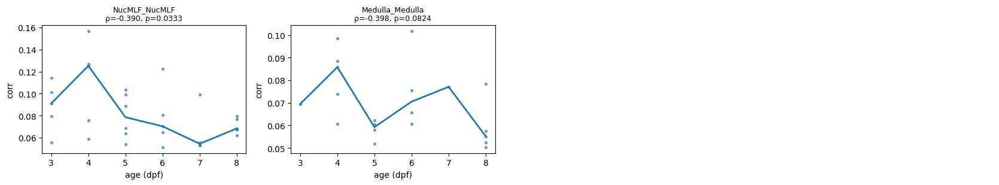

In [363]:


# -----------------------------
# 1) pick significant pairs
# -----------------------------
sig_pairs = (res.loc[res["p"].notna() & (res["p"] < 0.1), "region"]
             .astype(str)
             .tolist())

print("n sig pairs:", len(sig_pairs))
print(sig_pairs)

# -----------------------------
# 2) subset comb_df to those pairs
# -----------------------------
sub = comb_df[comb_df["region"].isin(sig_pairs)].copy()
sub["age"]  = pd.to_numeric(sub["age"], errors="coerce")
sub["corr"] = pd.to_numeric(sub["corr"], errors="coerce")
sub = sub.dropna(subset=["age","corr"])

# If duplicates exist per fish+age+region, collapse them (recommended)
sub["sample_id"] = sub["fish"].astype(str) + "_age" + sub["age"].astype(int).astype(str)
sub = (sub.groupby(["region","sample_id"], as_index=False)
          .agg(age=("age","mean"), corr=("corr","mean")))

# -----------------------------
# 3) plot: one panel per pair
# -----------------------------
pairs = sig_pairs
n = len(pairs)
ncols = 4
nrows = int(np.ceil(n / ncols))

fig, axes = plt.subplots(nrows, ncols, figsize=(4.2*ncols, 3.2*nrows), sharex=True)
axes = np.atleast_1d(axes).ravel()

for ax, pair in zip(axes, pairs):
    g = sub[sub["region"] == pair].copy()

    # scatter all fish
    ax.scatter(g["age"], g["corr"], s=14, alpha=0.7, linewidths=0)

    # median trend per age (nice summary)
    med = g.groupby("age")["corr"].median().sort_index()
    ax.plot(med.index.to_numpy(), med.to_numpy(), linewidth=2)

    # annotate with rho,p from res
    row = res.loc[res["region"] == pair].iloc[0]
    ax.set_title(f"{pair}\nρ={row['rho']:.3f}, p={row['p']:.3g}", fontsize=9)

    ax.set_xlabel("age (dpf)")
    ax.set_ylabel("corr")

# hide unused panels
for ax in axes[len(pairs):]:
    ax.axis("off")

plt.tight_layout()
plt.show()


# ICG scaling

In [369]:
import numpy as np

# ============================================================
# Fast greedy ICG (Iterative Coarse-Graining) for X: (N, T)
# - Greedy pairing by Pearson correlation at each generation
# - Returns:
#   generations: list[int]
#   labels_by_gen: list[np.ndarray]  (each: (N_original,) cluster id at that generation)
#   mean_traces_by_gen: list[np.ndarray] (each: (n_clusters_gen, T) mean trace per cluster)
#   sizes_by_gen: list[np.ndarray]  (each: (n_clusters_gen,) #cells per cluster)
#
# Notes:
# - This is "fast" in the sense that each generation uses a single BLAS matmul to
#   form the correlation matrix, and greedy pairing runs without sorting edges.
# - Memory: correlation matrix at gen0 is ~N^2 float32 (N=10k -> ~400MB).
# ============================================================

def _zscore_rows(X, eps=1e-6):
    """Row-wise z-score in float32."""
    X = np.asarray(X, dtype=np.float32, order="C")
    mu = X.mean(axis=1, keepdims=True)
    Xc = X - mu
    sd = Xc.std(axis=1, keepdims=True)
    return Xc / (sd + eps)

def _greedy_pairs_from_corr_inplace(C):
    """
    Greedy pairing from correlation matrix C (modified in-place):
      - pick i in order; pair with argmax(C[i]) among remaining.
      - when i,j paired: set rows/cols i,j to -inf so they cannot be reused.
    Returns:
      pairs: (P, 2) int32 with i<j
      singles: (S,) int32 remaining (if odd n)
    """
    n = C.shape[0]
    pairs = []
    alive = np.ones(n, dtype=bool)

    # diagonal cannot pair with itself
    np.fill_diagonal(C, -np.inf)

    for i in range(n):
        if not alive[i]:
            continue

        j = int(np.argmax(C[i]))  # columns of dead nodes have been set to -inf
        if (j == i) or (not alive[j]) or (not np.isfinite(C[i, j])):
            # couldn't find a partner (should only happen if n==1)
            continue

        a, b = (i, j) if i < j else (j, i)
        pairs.append((a, b))

        # kill both nodes
        alive[i] = False
        alive[j] = False

        # remove them from further consideration: set rows+cols to -inf
        C[i, :] = -np.inf
        C[:, i] = -np.inf
        C[j, :] = -np.inf
        C[:, j] = -np.inf

    pairs = np.asarray(pairs, dtype=np.int32)
    singles = np.where(alive)[0].astype(np.int32)
    return pairs, singles

def icg_greedy_fast(
    X,
    n_gen=None,
    eps=1e-6,
    keep_singletons=True,
    return_gen0=True,
    verbose=False,
):
    """
    Parameters
    ----------
    X : array (N, T)
        Per-cell traces (can be dff, deconvolved, etc).
    n_gen : int or None
        Number of coarse-graining generations to compute (None -> until 1 cluster).
    eps : float
        Stabilizer for z-scoring.
    keep_singletons : bool
        If odd number of units at some generation, keep last as a singleton.
    return_gen0 : bool
        Include generation 0 outputs (labels=0..N-1, mean_traces=X, sizes=1).
    verbose : bool
        Print progress.

    Returns
    -------
    generations : list[int]
    labels_by_gen : list[np.ndarray]      # each (N_original,)
    mean_traces_by_gen : list[np.ndarray] # each (n_clusters_gen, T)
    sizes_by_gen : list[np.ndarray]       # each (n_clusters_gen,)
    """
    X0 = np.asarray(X, dtype=np.float32, order="C")
    N0, T = X0.shape

    # current level representation: units x T are MEAN traces of underlying cells
    X_curr = X0
    sizes_curr = np.ones(X_curr.shape[0], dtype=np.int32)

    # map original cells -> current unit id (starts as identity)
    labels_curr = np.arange(N0, dtype=np.int32)

    generations = []
    labels_by_gen = []
    mean_traces_by_gen = []
    sizes_by_gen = []

    def _append(gen, labels, traces, sizes):
        generations.append(gen)
        labels_by_gen.append(labels.copy())
        mean_traces_by_gen.append(np.asarray(traces, dtype=np.float32))
        sizes_by_gen.append(sizes.copy())

    gen = 0
    if return_gen0:
        _append(gen, labels_curr, X_curr, sizes_curr)

    # how many gens?
    if n_gen is None:
        # until we reach 1 cluster
        max_gen = 10_000  # hard cap safety
    else:
        max_gen = int(n_gen)

    while gen < max_gen:
        n_units = X_curr.shape[0]
        if n_units <= 1:
            break

        gen += 1
        if verbose:
            print(f"[ICG] gen={gen}  n_units={n_units}")

        # 1) correlation matrix for current units (float32)
        Z = _zscore_rows(X_curr, eps=eps)  # (n_units, T)
        C = (Z @ Z.T) / float(T)          # (n_units, n_units) float32

        # 2) greedy pairing on C in-place
        pairs, singles = _greedy_pairs_from_corr_inplace(C)

        # 3) build children lists for new clusters
        if pairs.size == 0 and singles.size == n_units:
            # nothing could be paired (shouldn't happen, but guard)
            if verbose:
                print("[ICG] no pairs formed; stopping.")
            break

        # Decide how to handle singles
        if (not keep_singletons) and (singles.size > 0):
            # drop the singles
            singles = np.empty((0,), dtype=np.int32)

        P = pairs.shape[0]
        S = singles.shape[0]
        n_new = P + S

        # children indices
        a = np.empty(n_new, dtype=np.int32)
        b = np.empty(n_new, dtype=np.int32)

        # pairs first
        if P > 0:
            a[:P] = pairs[:, 0]
            b[:P] = pairs[:, 1]

        # singletons: represent as (s, s) but with weight_b=0
        if S > 0:
            a[P:] = singles
            b[P:] = singles

        # 4) update cluster sizes
        sa = sizes_curr[a].astype(np.float32)
        sb = sizes_curr[b].astype(np.float32)
        if S > 0:
            # zero out sb for singleton rows (so mean stays unchanged)
            sb[P:] = 0.0

        sizes_new = (sa + sb).astype(np.int32)  # (#cells in each new cluster)
        denom = (sa + sb).reshape(-1, 1)        # float32

        # 5) update mean traces (weighted mean of children clusters)
        Xa = X_curr[a]  # (n_new, T)
        Xb = X_curr[b]  # (n_new, T)
        X_new = (sa.reshape(-1, 1) * Xa + sb.reshape(-1, 1) * Xb) / denom

        # 6) mapping old units -> new units (for propagating original-cell labels)
        unit_to_new = np.full(n_units, -1, dtype=np.int32)
        unit_to_new[a] = np.arange(n_new, dtype=np.int32)
        if P > 0:
            unit_to_new[b[:P]] = np.arange(P, dtype=np.int32)  # second child of pairs

        # propagate labels for original cells
        labels_curr = unit_to_new[labels_curr]
        if np.any(labels_curr < 0):
            raise RuntimeError("Label propagation failed (found -1). Check singleton handling.")

        # save outputs at this generation
        _append(gen, labels_curr, X_new, sizes_new)

        # advance
        X_curr = X_new
        sizes_curr = sizes_new

    return generations, labels_by_gen, mean_traces_by_gen, sizes_by_gen


# ============================
# Example usage
# ============================
# X: (N,T) e.g. dff or deconvolved events
gen, label_l, icgtr_l, size_l = icg_greedy_fast(
    dff, n_gen=14, eps=1e-6, keep_singletons=True, return_gen0=True, verbose=True
)
#
# labels_by_gen[g] gives you an (N,) vector mapping each original cell -> cluster id at gen g
# mean_traces_by_gen[g] is (n_clusters_at_g, T) mean trace for each cluster at gen g
# sizes_by_gen[g] is (#cells in each cluster at gen g)


[ICG] gen=1  n_units=15105
[ICG] gen=2  n_units=7553
[ICG] gen=3  n_units=3777
[ICG] gen=4  n_units=1889
[ICG] gen=5  n_units=945
[ICG] gen=6  n_units=473
[ICG] gen=7  n_units=237
[ICG] gen=8  n_units=119
[ICG] gen=9  n_units=60
[ICG] gen=10  n_units=30
[ICG] gen=11  n_units=15
[ICG] gen=12  n_units=8
[ICG] gen=13  n_units=4
[ICG] gen=14  n_units=2


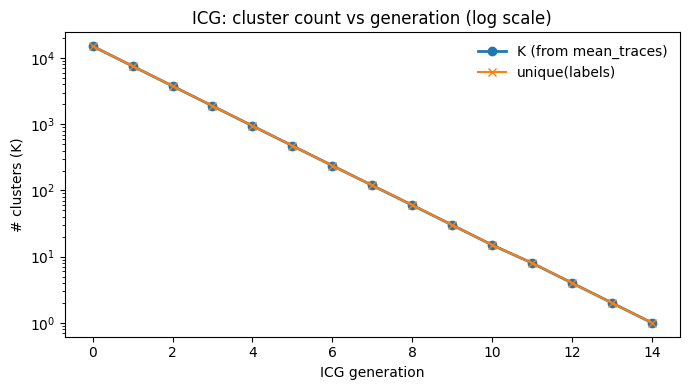

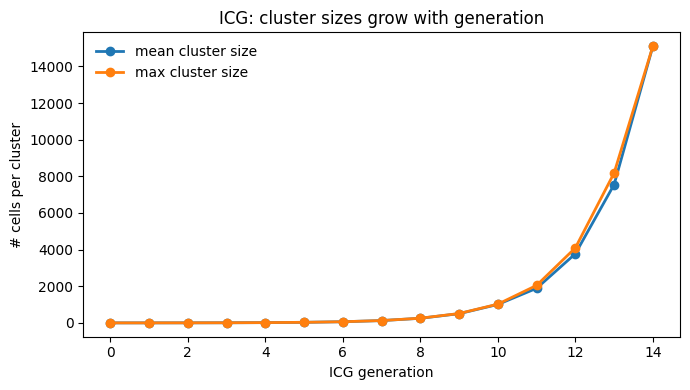

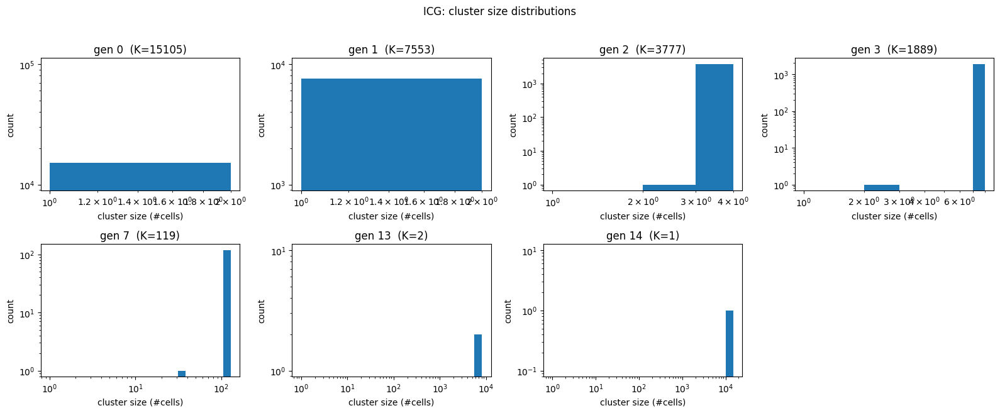

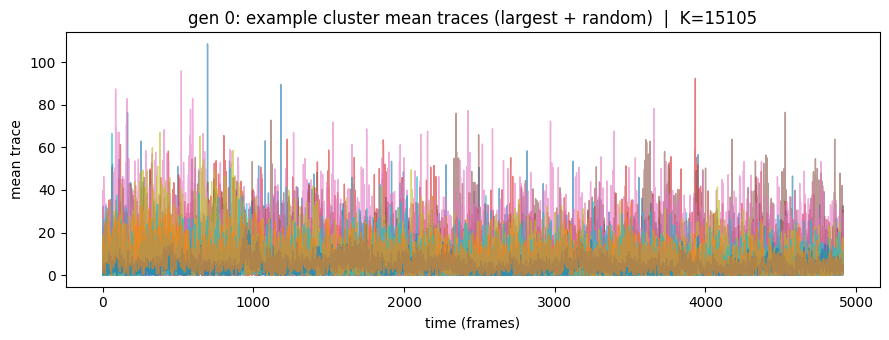

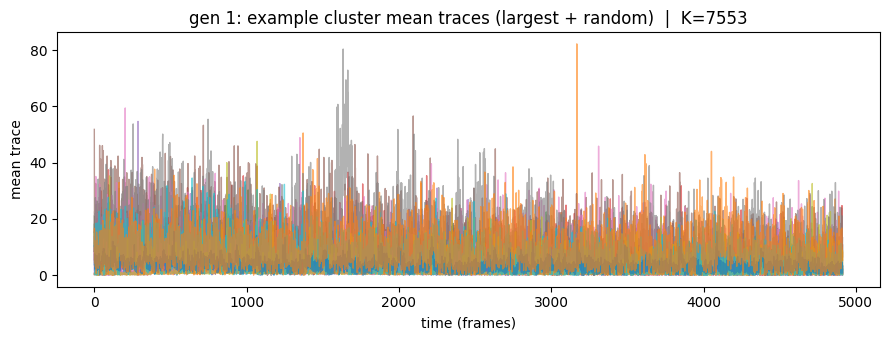

...

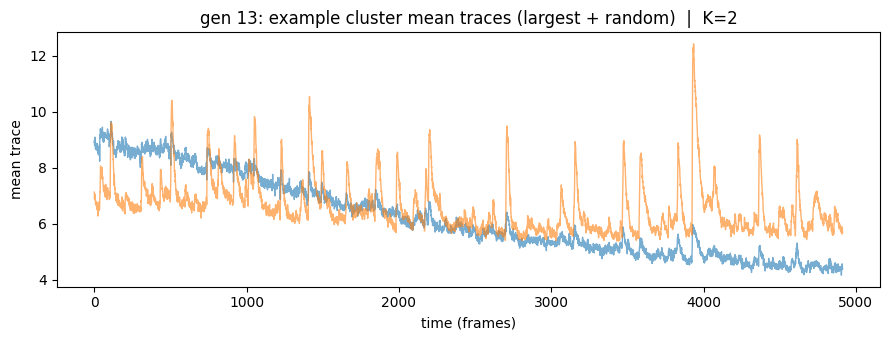

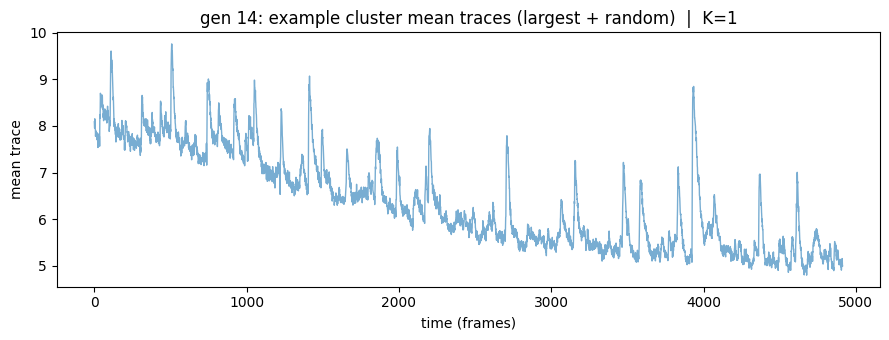

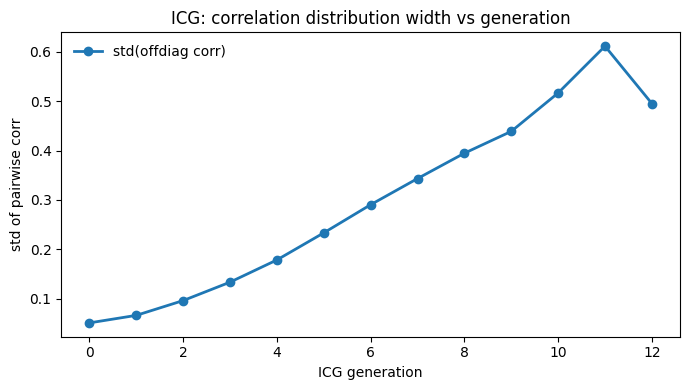

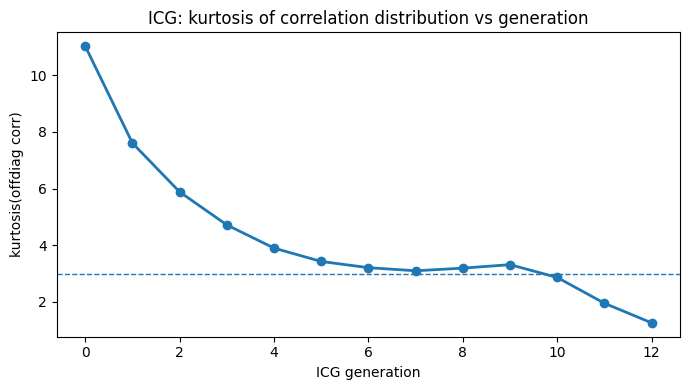

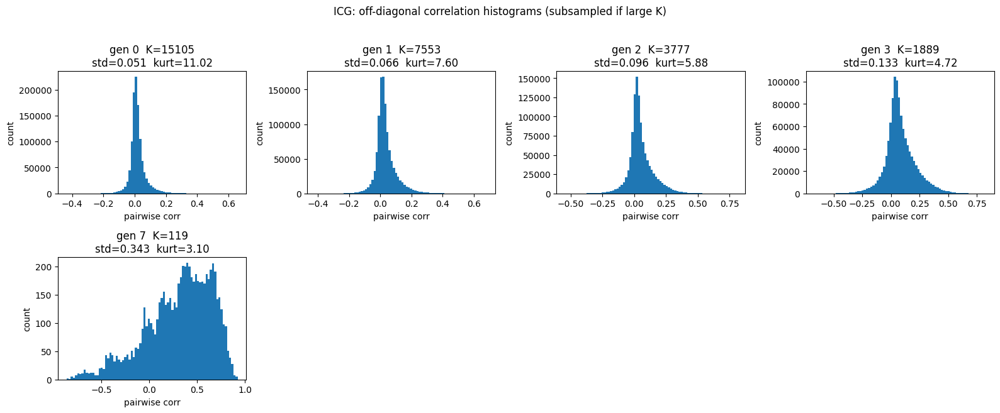

In [370]:
import numpy as np
import matplotlib.pyplot as plt

# ============================================================
# Sanity-check plotting for greedy ICG outputs
# Inputs:
#   generations, labels_by_gen, mean_traces_by_gen, sizes_by_gen
# ============================================================

def _kurtosis(x):
    """Plain kurtosis (not excess): E[(x-m)^4]/std^4. Returns nan if degenerate."""
    x = np.asarray(x, dtype=np.float64)
    x = x[np.isfinite(x)]
    if x.size < 4:
        return np.nan
    m = x.mean()
    v = x.var()
    if v <= 0:
        return np.nan
    return np.mean((x - m) ** 4) / (v ** 2)

def _offdiag_vals(C):
    iu = np.triu_indices(C.shape[0], k=1)
    return C[iu]

def _corr_hist_and_kurtosis(X, max_units=1500, seed=0):
    """
    Compute off-diagonal correlation values and kurtosis for a (K,T) matrix.
    Subsamples rows if K is large (to keep memory/compute manageable).
    """
    rng = np.random.default_rng(seed)
    X = np.asarray(X, dtype=np.float32)
    K, T = X.shape

    if K > max_units:
        idx = rng.choice(K, size=max_units, replace=False)
        X = X[idx]
        K = max_units

    # z-score rows
    Xc = X - X.mean(axis=1, keepdims=True)
    Xn = Xc / (Xc.std(axis=1, keepdims=True) + 1e-6)

    C = (Xn @ Xn.T) / float(T)
    np.fill_diagonal(C, np.nan)
    vals = _offdiag_vals(C)
    vals = vals[np.isfinite(vals)]
    return vals, _kurtosis(vals)

def icg_sanity_plots(
    generations,
    labels_by_gen,
    mean_traces_by_gen,
    sizes_by_gen,
    max_corr_units=1500,
    max_trace_clusters=12,
    trace_gens=None,
    seed=0,
):
    rng = np.random.default_rng(seed)

    G = len(generations)
    N0 = labels_by_gen[0].shape[0]
    T  = mean_traces_by_gen[0].shape[1]

    # ---- basic summaries per generation ----
    K = np.array([mt.shape[0] for mt in mean_traces_by_gen], dtype=int)
    mean_size = np.array([np.mean(sz) for sz in sizes_by_gen], dtype=float)
    max_size  = np.array([np.max(sz) for sz in sizes_by_gen], dtype=float)

    # label sanity: number of unique labels should equal K at that gen
    uniqK = np.array([np.unique(lab).size for lab in labels_by_gen], dtype=int)

    # ---- Plot 1: cluster count vs generation + label sanity ----
    fig, ax = plt.subplots(figsize=(7,4))
    ax.plot(generations, K, marker='o', linewidth=2, label="K (from mean_traces)")
    ax.plot(generations, uniqK, marker='x', linewidth=1.5, label="unique(labels)")
    ax.set_xlabel("ICG generation")
    ax.set_ylabel("# clusters (K)")
    ax.set_yscale("log")
    ax.set_title("ICG: cluster count vs generation (log scale)")
    ax.legend(frameon=False)
    plt.tight_layout()
    plt.show()

    # ---- Plot 2: mean/max cluster size vs generation ----
    fig, ax = plt.subplots(figsize=(7,4))
    ax.plot(generations, mean_size, marker='o', linewidth=2, label="mean cluster size")
    ax.plot(generations, max_size,  marker='o', linewidth=2, label="max cluster size")
    ax.set_xlabel("ICG generation")
    ax.set_ylabel("# cells per cluster")
    ax.set_title("ICG: cluster sizes grow with generation")
    ax.legend(frameon=False)
    plt.tight_layout()
    plt.show()

    # ---- Plot 3: size distributions at selected generations ----
    if trace_gens is None:
        # pick a few informative gens (early, mid, late)
        pick = sorted(set([0, 1, 2, 3, G//2, G-2, G-1]))
        trace_gens = [g for g in pick if 0 <= g < G]

    n = len(trace_gens)
    ncols = min(4, n)
    nrows = int(np.ceil(n / ncols))
    fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 3.2*nrows))
    axes = np.atleast_1d(axes).ravel()

    for ax, gi in zip(axes, trace_gens):
        sz = np.asarray(sizes_by_gen[gi], dtype=int)
        # log bins help when sizes span orders of magnitude
        bins = np.unique(np.round(np.logspace(0, np.log10(max(sz.max(), 2)), 25)).astype(int))
        bins = bins[(bins >= 1)]
        ax.hist(sz, bins=bins)
        ax.set_xscale("log")
        ax.set_yscale("log")
        ax.set_title(f"gen {generations[gi]}  (K={sz.size})")
        ax.set_xlabel("cluster size (#cells)")
        ax.set_ylabel("count")
    for ax in axes[n:]:
        ax.axis("off")

    fig.suptitle("ICG: cluster size distributions", y=1.02)
    plt.tight_layout()
    plt.show()

    # ---- Plot 4: example mean traces (largest + random) at selected generations ----
    for gi in trace_gens:
        mt = np.asarray(mean_traces_by_gen[gi], dtype=np.float32)
        sz = np.asarray(sizes_by_gen[gi], dtype=int)

        Kgi = mt.shape[0]
        n_show = min(max_trace_clusters, Kgi)

        # show half largest clusters + half random (excluding the largest ones)
        n_big = max(1, n_show // 2)
        big_idx = np.argsort(sz)[::-1][:n_big]

        rest = np.setdiff1d(np.arange(Kgi), big_idx)
        n_rand = n_show - n_big
        if rest.size > 0 and n_rand > 0:
            rand_idx = rng.choice(rest, size=min(n_rand, rest.size), replace=False)
            idx = np.concatenate([big_idx, rand_idx])
        else:
            idx = big_idx

        fig, ax = plt.subplots(figsize=(9,3.5))
        # light traces
        for k in idx:
            ax.plot(mt[k], alpha=0.6, linewidth=1)

        ax.set_title(f"gen {generations[gi]}: example cluster mean traces (largest + random)  |  K={Kgi}")
        ax.set_xlabel("time (frames)")
        ax.set_ylabel("mean trace")
        plt.tight_layout()
        plt.show()

    # ---- Plot 5: correlation distribution broadening + kurtosis vs generation ----
    kurt = np.full(G, np.nan, dtype=float)
    stdv = np.full(G, np.nan, dtype=float)

    # compute kurtosis on a subsampled correlation matrix per gen
    for gi in range(G):
        mt = np.asarray(mean_traces_by_gen[gi], dtype=np.float32)
        if mt.shape[0] < 4:
            continue
        vals, krt = _corr_hist_and_kurtosis(mt, max_units=max_corr_units, seed=seed+gi)
        kurt[gi] = krt
        stdv[gi] = np.nanstd(vals)

    fig, ax = plt.subplots(figsize=(7,4))
    ax.plot(generations, stdv, marker='o', linewidth=2, label="std(offdiag corr)")
    ax.set_xlabel("ICG generation")
    ax.set_ylabel("std of pairwise corr")
    ax.set_title("ICG: correlation distribution width vs generation")
    ax.legend(frameon=False)
    plt.tight_layout()
    plt.show()

    fig, ax = plt.subplots(figsize=(7,4))
    ax.plot(generations, kurt, marker='o', linewidth=2)
    ax.axhline(3.0, linestyle="--", linewidth=1)  # Gaussian kurtosis reference
    ax.set_xlabel("ICG generation")
    ax.set_ylabel("kurtosis(offdiag corr)")
    ax.set_title("ICG: kurtosis of correlation distribution vs generation")
    plt.tight_layout()
    plt.show()

    # ---- Plot 6: correlation histograms at selected generations ----
    n = len(trace_gens)
    ncols = min(4, n)
    nrows = int(np.ceil(n / ncols))
    fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 3.2*nrows))
    axes = np.atleast_1d(axes).ravel()

    for ax, gi in zip(axes, trace_gens):
        mt = np.asarray(mean_traces_by_gen[gi], dtype=np.float32)
        if mt.shape[0] < 4:
            ax.axis("off")
            continue
        vals, krt = _corr_hist_and_kurtosis(mt, max_units=max_corr_units, seed=seed+gi)
        ax.hist(vals, bins=80)
        ax.set_title(f"gen {generations[gi]}  K={mt.shape[0]}\nstd={np.std(vals):.3f}  kurt={krt:.2f}")
        ax.set_xlabel("pairwise corr")
        ax.set_ylabel("count")
    for ax in axes[n:]:
        ax.axis("off")

    fig.suptitle("ICG: off-diagonal correlation histograms (subsampled if large K)", y=1.02)
    plt.tight_layout()
    plt.show()


# ============================
# Run it
# ============================
icg_sanity_plots(gen, label_l, icgtr_l, size_l)


In [373]:
import os, glob
import numpy as np
from tqdm import tqdm

# ============================================================
# Greedy ICG (same as before)
# ============================================================

def _zscore_rows(X, eps=1e-6):
    X = np.asarray(X, dtype=np.float32, order="C")
    mu = X.mean(axis=1, keepdims=True)
    Xc = X - mu
    sd = Xc.std(axis=1, keepdims=True)
    return Xc / (sd + eps)

def _greedy_pairs_from_corr_inplace(C):
    n = C.shape[0]
    pairs = []
    alive = np.ones(n, dtype=bool)
    np.fill_diagonal(C, -np.inf)

    for i in range(n):
        if not alive[i]:
            continue
        j = int(np.argmax(C[i]))
        if (j == i) or (not alive[j]) or (not np.isfinite(C[i, j])):
            continue

        a, b = (i, j) if i < j else (j, i)
        pairs.append((a, b))

        alive[i] = False
        alive[j] = False
        C[i, :] = -np.inf
        C[:, i] = -np.inf
        C[j, :] = -np.inf
        C[:, j] = -np.inf

    pairs = np.asarray(pairs, dtype=np.int32)
    singles = np.where(alive)[0].astype(np.int32)
    return pairs, singles

def icg_greedy_fast(X, n_gen=14, eps=1e-6, keep_singletons=True, return_gen0=True, verbose=False):
    X0 = np.asarray(X, dtype=np.float32, order="C")
    N0, T = X0.shape

    X_curr = X0
    sizes_curr = np.ones(X_curr.shape[0], dtype=np.int32)
    labels_curr = np.arange(N0, dtype=np.int32)

    generations = []
    labels_by_gen = []
    mean_traces_by_gen = []
    sizes_by_gen = []

    def _append(gen, labels, traces, sizes):
        generations.append(gen)
        labels_by_gen.append(labels.copy())
        mean_traces_by_gen.append(np.asarray(traces, dtype=np.float32))
        sizes_by_gen.append(sizes.copy())

    gen = 0
    if return_gen0:
        _append(gen, labels_curr, X_curr, sizes_curr)

    max_gen = int(n_gen) if n_gen is not None else 10_000

    while gen < max_gen:
        n_units = X_curr.shape[0]
        if n_units <= 1:
            break

        gen += 1
        if verbose:
            print(f"[ICG] gen={gen}  n_units={n_units}")

        Z = _zscore_rows(X_curr, eps=eps)
        C = (Z @ Z.T) / float(T)

        pairs, singles = _greedy_pairs_from_corr_inplace(C)

        if pairs.size == 0 and singles.size == n_units:
            if verbose:
                print("[ICG] no pairs formed; stopping.")
            break

        if (not keep_singletons) and (singles.size > 0):
            singles = np.empty((0,), dtype=np.int32)

        P = pairs.shape[0]
        S = singles.shape[0]
        n_new = P + S

        a = np.empty(n_new, dtype=np.int32)
        b = np.empty(n_new, dtype=np.int32)

        if P > 0:
            a[:P] = pairs[:, 0]
            b[:P] = pairs[:, 1]
        if S > 0:
            a[P:] = singles
            b[P:] = singles

        sa = sizes_curr[a].astype(np.float32)
        sb = sizes_curr[b].astype(np.float32)
        if S > 0:
            sb[P:] = 0.0

        sizes_new = (sa + sb).astype(np.int32)
        denom = (sa + sb).reshape(-1, 1)

        Xa = X_curr[a]
        Xb = X_curr[b]
        X_new = (sa.reshape(-1, 1) * Xa + sb.reshape(-1, 1) * Xb) / denom

        unit_to_new = np.full(n_units, -1, dtype=np.int32)
        unit_to_new[a] = np.arange(n_new, dtype=np.int32)
        if P > 0:
            unit_to_new[b[:P]] = np.arange(P, dtype=np.int32)

        labels_curr = unit_to_new[labels_curr]
        if np.any(labels_curr < 0):
            raise RuntimeError("Label propagation failed (found -1). Check singleton handling.")

        _append(gen, labels_curr, X_new, sizes_new)

        X_curr = X_new
        sizes_curr = sizes_new

    return np.asarray(generations, dtype=np.int32), labels_by_gen, mean_traces_by_gen, sizes_by_gen


# ============================================================
# Batch run + save as .npy (single dict payload per file)
# ============================================================

# fdata = "/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE"
# dff_l  = np.sort(glob.glob(f"{fdata}/*regdeltaff*.npy"))

out_dir = os.path.join(fdata, "icg_npy")
os.makedirs(out_dir, exist_ok=True)

for p in tqdm(dff_l):
    dff = np.load(p)  # (N,T)

    generations, labels_by_gen, mean_traces_by_gen, sizes_by_gen = icg_greedy_fast(
        dff, n_gen=14, eps=1e-6, keep_singletons=True, return_gen0=True, verbose=False
    )

    payload = {
        "generations": generations,                      # (G,)
        "labels_by_gen": np.array(labels_by_gen, object),# object array, len=G, each (N,)
        "mean_traces_by_gen": np.array(mean_traces_by_gen, object),  # len=G, each (K_g,T)
        "sizes_by_gen": np.array(sizes_by_gen, object),  # len=G, each (K_g,)
        "source_path": p,
    }

    base = os.path.basename(p).replace(".npy", "")
    out_path = os.path.join(out_dir, base + "_icg_greedy.npy")

    # IMPORTANT: allow_pickle=True needed to load these later because object arrays
    np.save(out_path, payload, allow_pickle=True)

    del dff

print("Saved ICG .npy payloads to:", out_dir)

100%|█████████████████████████████████████| 30/30 [02:00<00:00,  4.01s/it]

Saved ICG .npy payloads to: /Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/icg_npy


In [660]:
fdata

'/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE'


=== Pairwise correlation summary (per age, per generation) ===

Age: 3 dpf
  gen  0: mean(corr) = +0.0044 (SD across animals 0.0006)  std(corr) = 0.0351 (SD across animals 0.0046)
  gen  1: mean(corr) = +0.0068 (SD across animals 0.0006)  std(corr) = 0.0450 (SD across animals 0.0057)
  gen  2: mean(corr) = +0.0108 (SD across animals 0.0009)  std(corr) = 0.0606 (SD across animals 0.0066)
  gen  3: mean(corr) = +0.0172 (SD across animals 0.0015)  std(corr) = 0.0823 (SD across animals 0.0072)
  gen  4: mean(corr) = +0.0270 (SD across animals 0.0026)  std(corr) = 0.1108 (SD across animals 0.0079)
  gen  5: mean(corr) = +0.0393 (SD across animals 0.0040)  std(corr) = 0.1443 (SD across animals 0.0088)
  gen  6: mean(corr) = +0.0538 (SD across animals 0.0057)  std(corr) = 0.1814 (SD across animals 0.0098)
  gen  7: mean(corr) = +0.0693 (SD across animals 0.0076)  std(corr) = 0.2202 (SD across animals 0.0124)
  gen  8: mean(corr) = +0.0831 (SD across animals 0.0096)  std(corr) = 0.2578 (SD ac

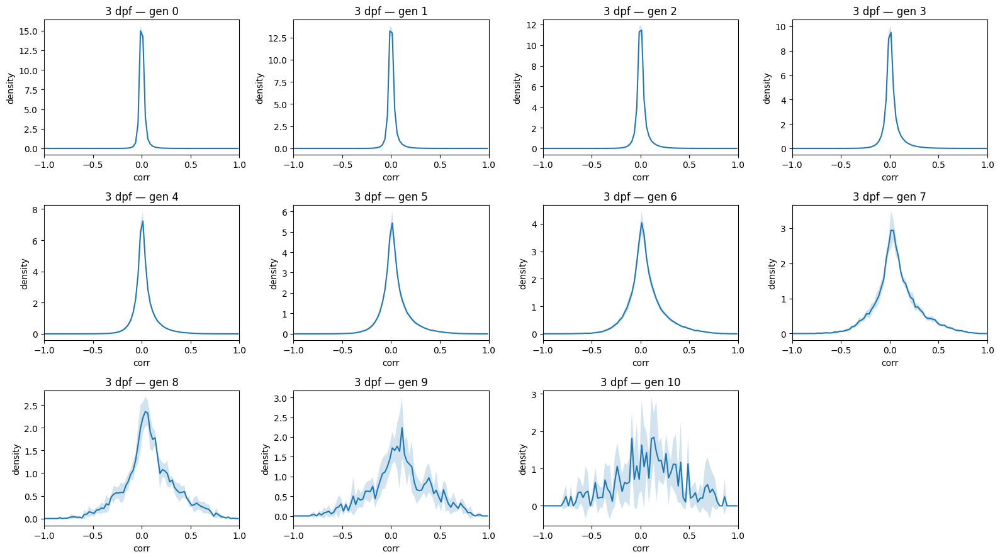

/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/2382014752.py:213: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = mpl.cm.get_cmap("Spectral_r")


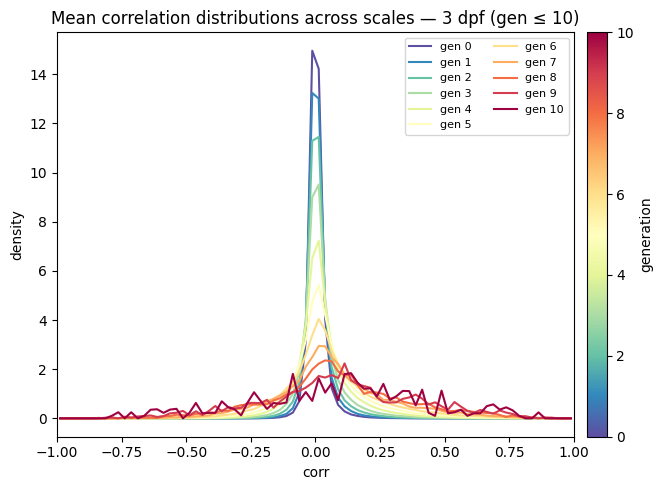

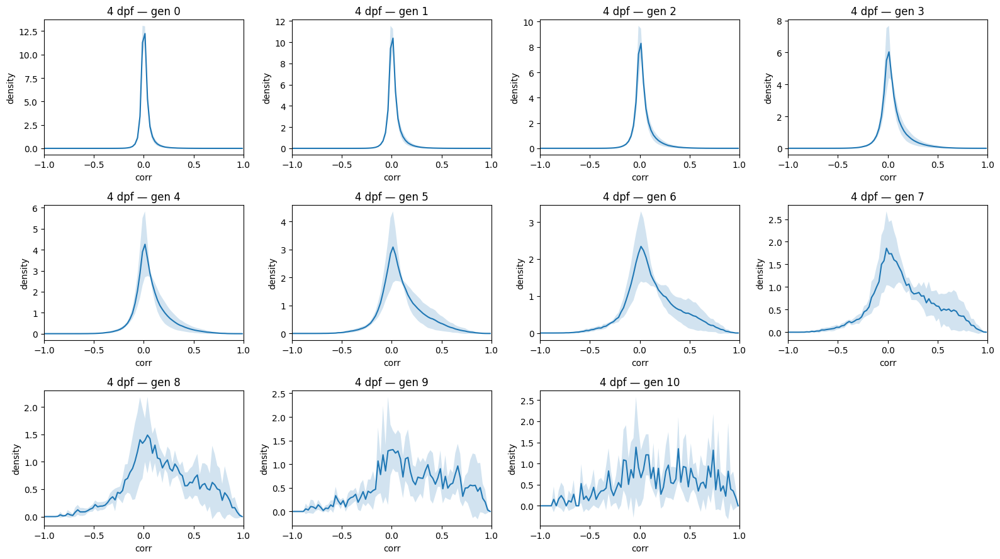

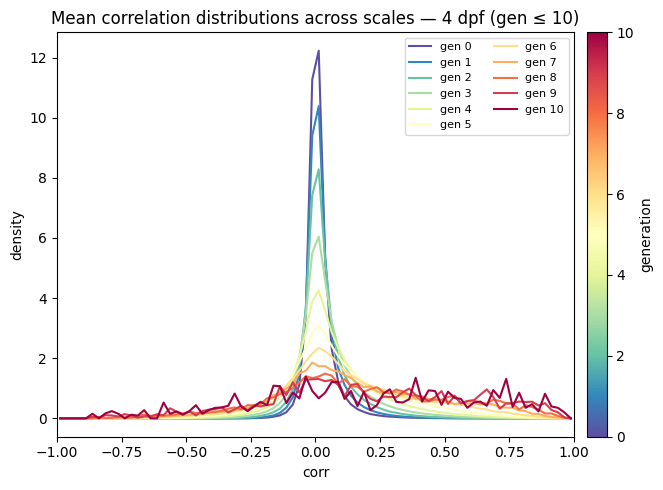

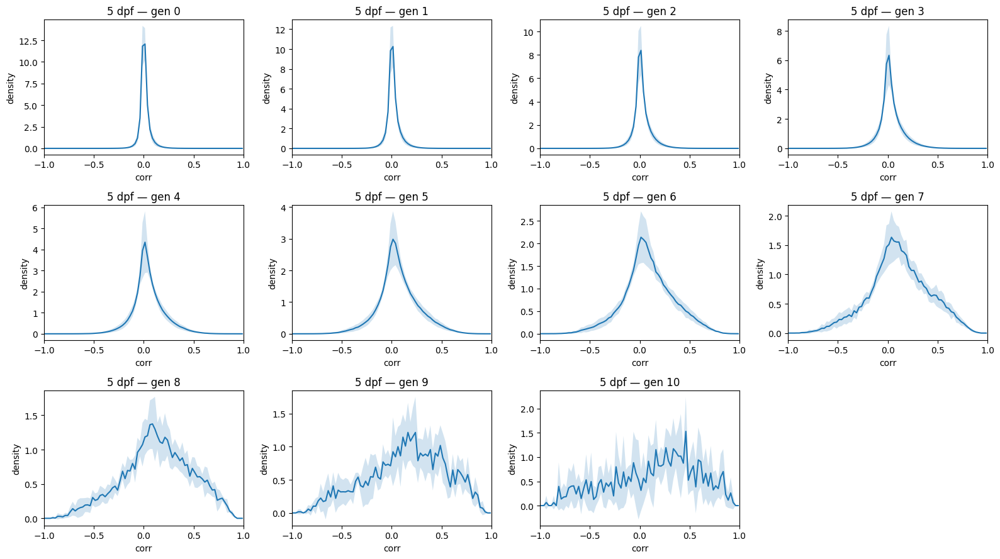

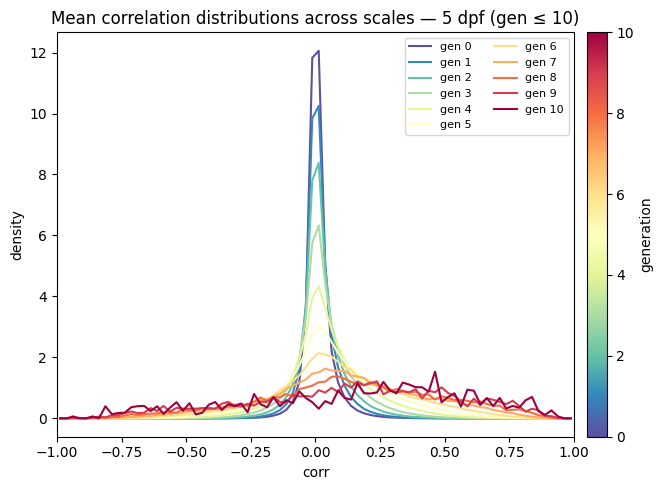

...

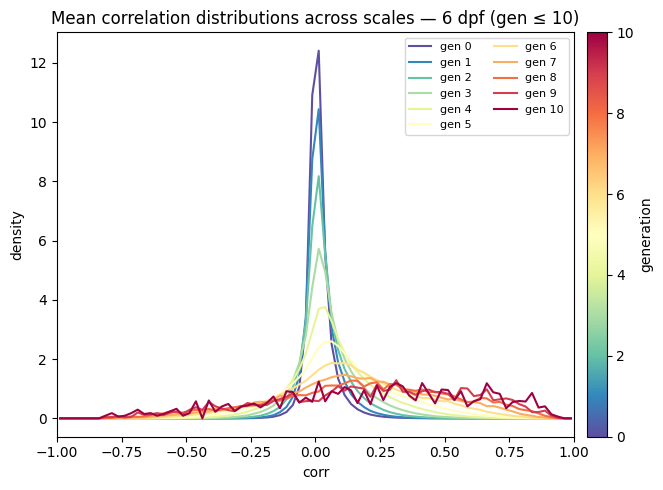

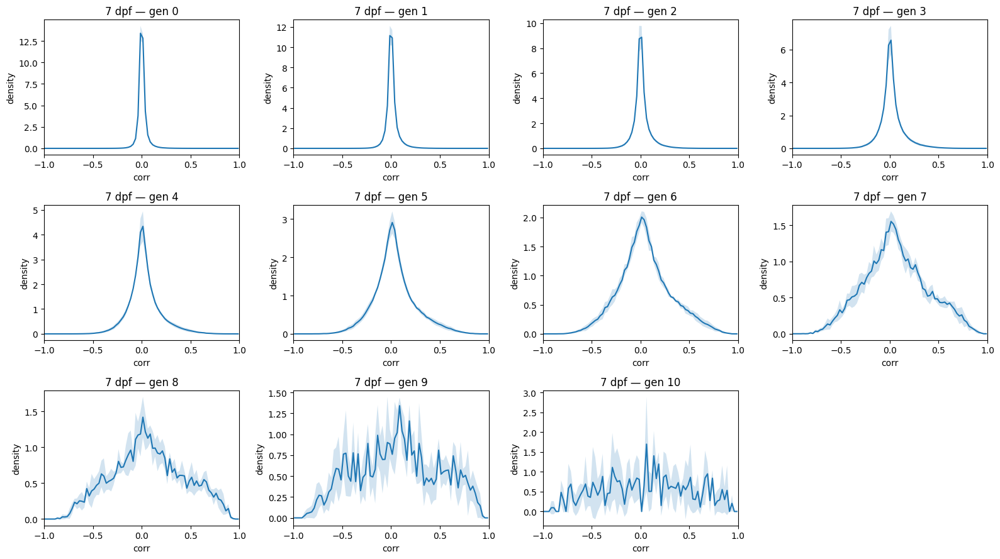

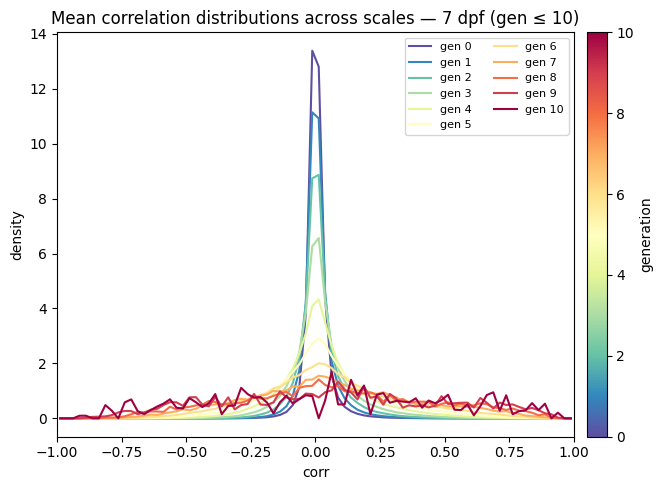

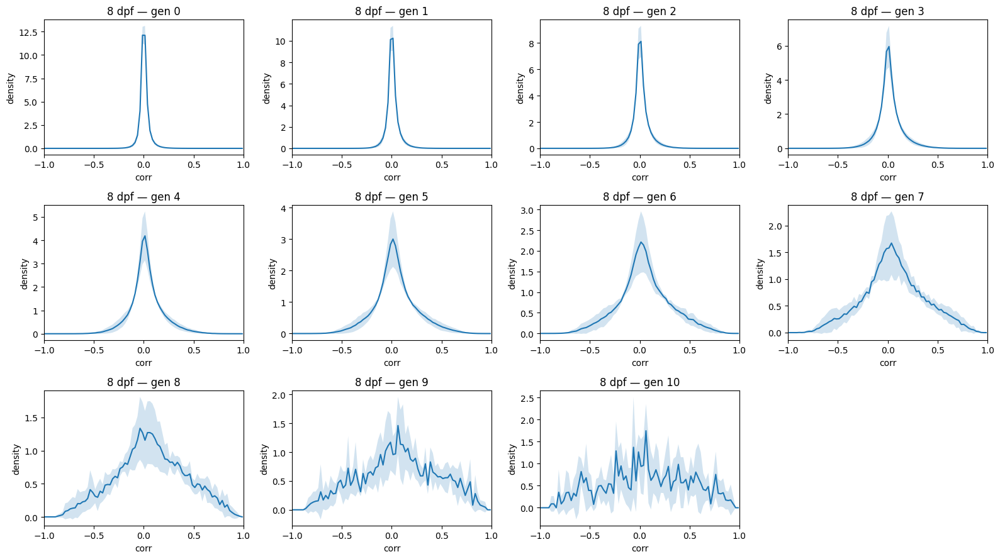

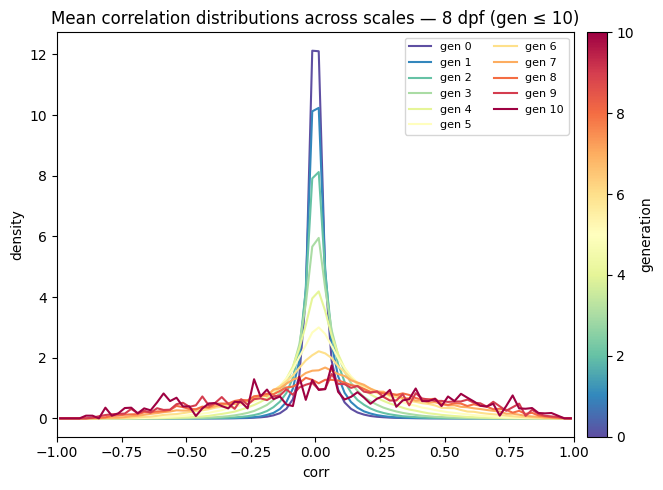


Saved plots to: /Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/icg_npy/icg_corr_distributions


In [665]:
import os, re, glob
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl

ICG_DIR      = '/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/icg_npy/'   # <-- change me
PATTERN = "*.npy"
OUT_DIR = os.path.join(ICG_DIR, "icg_corr_distributions")

# Pairwise corr estimation:
MAX_PAIRS = 200_000
BINS = np.linspace(-1, 1, 81)
EPS = 1e-6
SEED = 0

# Plotting
N_COLS = 4
PLOT_STD_BAND = True
SHOW_PLOTS = True

# Limit generations
MAX_GEN = 10  # <--- only include generations <= 10

# =========================
# Helpers
# =========================
def ensure_dir(p):
    os.makedirs(p, exist_ok=True)

def parse_age_dpf(path: str):
    base = os.path.basename(path)
    m = re.search(r"(\d+)\s*dpf", base, flags=re.IGNORECASE) or re.search(r"(\d+)dpf", base, flags=re.IGNORECASE)
    return int(m.group(1)) if m else None

def zscore_rows(X, eps=1e-6):
    X = np.asarray(X, dtype=np.float32)
    mu = X.mean(axis=1, keepdims=True)
    sd = X.std(axis=1, keepdims=True)
    sd = np.maximum(sd, eps)
    return (X - mu) / sd

def hist_density(x, bins):
    if x.size == 0:
        return np.full(len(bins) - 1, np.nan, dtype=np.float32)
    h, _ = np.histogram(x, bins=bins, density=True)
    return h.astype(np.float32)

def sample_pairwise_corrs(X, max_pairs=200_000, eps=1e-6, seed=0):
    X = np.asarray(X, dtype=np.float32)
    n, T = X.shape
    if n < 2:
        return np.array([], dtype=np.float32)

    Z = zscore_rows(X, eps=eps)
    total_pairs = n * (n - 1) // 2

    if (max_pairs is None) or (total_pairs <= max_pairs):
        C = (Z @ Z.T) / float(T)
        iu = np.triu_indices(n, k=1)
        return C[iu].astype(np.float32)

    rng = np.random.default_rng(seed)
    i = rng.integers(0, n, size=max_pairs, dtype=np.int32)
    j = rng.integers(0, n, size=max_pairs, dtype=np.int32)
    mask = i != j
    i, j = i[mask], j[mask]

    while i.size < max_pairs:
        need = max_pairs - i.size
        ii = rng.integers(0, n, size=need, dtype=np.int32)
        jj = rng.integers(0, n, size=need, dtype=np.int32)
        m = ii != jj
        i = np.concatenate([i, ii[m]])
        j = np.concatenate([j, jj[m]])

    i = i[:max_pairs]
    j = j[:max_pairs]
    lo = np.minimum(i, j)
    hi = np.maximum(i, j)

    corrs = (Z[lo] * Z[hi]).sum(axis=1) / float(T)
    return corrs.astype(np.float32)

def load_icg_npy(path: str):
    obj = np.load(path, allow_pickle=True)

    if isinstance(obj, np.ndarray) and obj.dtype == object:
        if obj.shape == ():
            obj = obj.item()
        elif obj.size == 1:
            obj = obj.reshape(()).item()

    if isinstance(obj, tuple):
        if len(obj) >= 3:
            generations = np.asarray(obj[0]).astype(int)
            mean_traces_by_gen = obj[2]
            if isinstance(mean_traces_by_gen, np.ndarray) and mean_traces_by_gen.dtype == object:
                mean_traces_by_gen = list(mean_traces_by_gen)
            elif not isinstance(mean_traces_by_gen, list):
                mean_traces_by_gen = list(mean_traces_by_gen)
            return generations, mean_traces_by_gen
        raise ValueError(f"{path}: tuple too short (len={len(obj)})")

    if isinstance(obj, dict):
        gen_key = next((k for k in ["generations", "gens", "gen"] if k in obj), None)
        mt_key  = next((k for k in ["mean_traces_by_gen", "mean_traces", "traces_by_gen", "X_by_gen"] if k in obj), None)
        if gen_key is None or mt_key is None:
            raise KeyError(f"{path}: dict keys present={sorted(obj.keys())}, couldn't find generations/mean_traces_by_gen")
        generations = np.asarray(obj[gen_key]).astype(int)
        mean_traces_by_gen = obj[mt_key]
        if isinstance(mean_traces_by_gen, np.ndarray) and mean_traces_by_gen.dtype == object:
            mean_traces_by_gen = list(mean_traces_by_gen)
        elif not isinstance(mean_traces_by_gen, list):
            mean_traces_by_gen = list(mean_traces_by_gen)
        return generations, mean_traces_by_gen

    raise TypeError(f"{path}: unsupported payload type {type(obj)}.")

# =========================
# Main
# =========================
ensure_dir(OUT_DIR)
paths = sorted(glob.glob(os.path.join(ICG_DIR, PATTERN)))
if not paths:
    raise FileNotFoundError(f"No .npy files matched: {os.path.join(ICG_DIR, PATTERN)}")

data_hist = {}
data_stats = {}

for p in paths:
    age = parse_age_dpf(p)
    if age is None:
        print(f"[WARN] Could not parse age from filename, skipping: {os.path.basename(p)}")
        continue

    generations, mean_traces_by_gen = load_icg_npy(p)

    # only keep generations <= MAX_GEN
    keep = [(g_idx, int(g)) for g_idx, g in enumerate(generations) if int(g) <= MAX_GEN]
    if not keep:
        continue

    for g_idx, g in keep:
        Xg = np.asarray(mean_traces_by_gen[g_idx], dtype=np.float32)
        corrs = sample_pairwise_corrs(Xg, max_pairs=MAX_PAIRS, eps=EPS, seed=SEED + 1000*g_idx)

        h = hist_density(corrs, BINS)
        data_hist.setdefault(age, {}).setdefault(g, []).append(h)

        if corrs.size > 0:
            data_stats.setdefault(age, {}).setdefault(g, []).append(
                (float(corrs.mean()), float(corrs.std(ddof=0)))
            )
        else:
            data_stats.setdefault(age, {}).setdefault(g, []).append((np.nan, np.nan))

ages = sorted(data_hist.keys())
if not ages:
    raise RuntimeError("No usable ages found (check filenames contain 'Xdpf') and that some gens <= MAX_GEN.")

bin_centers = 0.5 * (BINS[:-1] + BINS[1:])

print("\n=== Pairwise correlation summary (per age, per generation) ===")
for age in ages:
    gens = sorted(data_hist[age].keys())
    print(f"\nAge: {age} dpf")
    for g in gens:
        ms = np.array([m for (m, s) in data_stats[age][g]], dtype=float)
        ss = np.array([s for (m, s) in data_stats[age][g]], dtype=float)

        m_mean = np.nanmean(ms)
        m_sd_across_animals = np.nanstd(ms, ddof=0)
        s_mean = np.nanmean(ss)
        s_sd_across_animals = np.nanstd(ss, ddof=0)

        print(f"  gen {g:>2d}: mean(corr) = {m_mean:+.4f} (SD across animals {m_sd_across_animals:.4f})  "
              f"std(corr) = {s_mean:.4f} (SD across animals {s_sd_across_animals:.4f})")

for age in ages:
    gens = sorted(data_hist[age].keys())
    n_panels = len(gens)
    nrows = int(np.ceil(n_panels / N_COLS))

    # (1) grid
    fig = plt.figure(figsize=(4*N_COLS, 3*nrows))
    for idx, g in enumerate(gens):
        ax = fig.add_subplot(nrows, N_COLS, idx + 1)
        H = np.stack(data_hist[age][g], axis=0)

        m = np.nanmean(H, axis=0)
        s = np.nanstd(H, axis=0, ddof=0)

        ax.plot(bin_centers, m)
        if PLOT_STD_BAND and np.all(np.isfinite(s)):
            ax.fill_between(bin_centers, m - s, m + s, alpha=0.2)

        ax.set_title(f"{age} dpf — gen {g}")
        ax.set_xlabel("corr")
        ax.set_ylabel("density")
        ax.set_xlim(-1, 1)

    fig.tight_layout()
    fig.savefig(os.path.join(OUT_DIR, f"corr_dist_grid_{age}dpf_genLE{MAX_GEN}.png"), dpi=200)
    if SHOW_PLOTS:
        plt.show()
    else:
        plt.close(fig)

    # (2) overlay with Spectral_r, sequential by gen value
    fig = plt.figure(figsize=(7, 5))
    ax = fig.add_subplot(1, 1, 1)

    cmap = mpl.cm.get_cmap("Spectral_r")
    norm = mpl.colors.Normalize(vmin=min(gens), vmax=max(gens) if max(gens) > min(gens) else min(gens) + 1e-9)

    for g in gens:
        H = np.stack(data_hist[age][g], axis=0)
        m = np.nanmean(H, axis=0)
        ax.plot(bin_centers, m, color=cmap(norm(g)), label=f"gen {g}")

    ax.set_title(f"Mean correlation distributions across scales — {age} dpf (gen ≤ {MAX_GEN})")
    ax.set_xlabel("corr")
    ax.set_ylabel("density")
    ax.set_xlim(-1, 1)

    sm = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
    sm.set_array([])
    cbar = fig.colorbar(sm, ax=ax, pad=0.02)
    cbar.set_label("generation")

    ax.legend(fontsize=8, ncol=2)

    fig.tight_layout()
    fig.savefig(os.path.join(OUT_DIR, f"corr_dist_overlay_{age}dpf_genLE{MAX_GEN}.png"), dpi=200)
    if SHOW_PLOTS:
        plt.show()
    else:
        plt.close(fig)

print(f"\nSaved plots to: {OUT_DIR}")


In [666]:
import os, re, glob
import numpy as np
import pandas as pd
from tqdm import tqdm

# ============================================================
# Load per-fish ICG outputs (.npy payload dict) and compute:
#   - kurtosis of off-diagonal correlation distribution (per generation)
#   - mean variance of cluster mean-traces (per generation)
#   - mean timescale (mean autocorr integral up to max_lag) (per generation)
# Then save a long dataframe: one row per fish × age × generation
# ============================================================

# ----------------------------
# Helpers you likely already have
# ----------------------------
def parse_age_dpf(path):
    # expects "...-4dpf..." or "... 4dpf ..." etc; adjust to your filename convention
    m = re.search(r"(\d+)\s*dpf", path)
    if m:
        return int(m.group(1))
    m = re.search(r"(\d+)dpf", path)
    return int(m.group(1)) if m else np.nan

def fish_id_from_path(p):
    b = os.path.basename(p)
    m = re.search(r"(BLNDEV-WILDTYPE-\d+)", b)
    return m.group(1) if m else os.path.splitext(b)[0]

# ----------------------------
# Stats helpers
# ----------------------------
def kurtosis_plain(x):
    """Kurtosis (not excess): E[(x-m)^4]/std^4. Returns nan if degenerate."""
    x = np.asarray(x, dtype=np.float64)
    x = x[np.isfinite(x)]
    if x.size < 10:
        return np.nan
    m = x.mean()
    v = x.var()
    if v <= 0:
        return np.nan
    return np.mean((x - m) ** 4) / (v ** 2)

def zscore_rows(X, eps=1e-6):
    X = np.asarray(X, dtype=np.float32)
    Xc = X - X.mean(axis=1, keepdims=True)
    Xn = Xc / (Xc.std(axis=1, keepdims=True) + eps)
    return Xn

def corr_offdiag_vals(X, max_units=2000, seed=0):
    """
    Off-diagonal Pearson correlations for row-traces in X (K,T).
    Subsamples rows if K large to keep K^2 manageable.
    """
    rng = np.random.default_rng(seed)
    X = np.asarray(X, dtype=np.float32)
    K, T = X.shape

    if K < 3:
        return np.array([], dtype=np.float32)

    if K > max_units:
        idx = rng.choice(K, size=max_units, replace=False)
        X = X[idx]
        K = max_units

    Xn = zscore_rows(X)
    C = (Xn @ Xn.T) / float(T)
    iu = np.triu_indices(K, k=1)
    vals = C[iu]
    vals = vals[np.isfinite(vals)]
    return vals

def mean_variance_across_clusters(X):
    """Mean variance across cluster mean-traces (variance over time per row)."""
    X = np.asarray(X, dtype=np.float32)
    if X.size == 0:
        return np.nan
    v = X.var(axis=1)  # per cluster
    return float(np.nanmean(v))

def mean_autocorr_curve(X, max_lag_frames=200, eps=1e-8):
    """
    X: (N_l, T) cluster traces at scale l
    Returns:
      ac_mean: (L+1,) mean autocorr across clusters, ac_mean[0]=1
    """
    X = np.asarray(X, dtype=np.float64)
    N, T = X.shape
    L = min(max_lag_frames, T - 2)
    if N < 1 or L < 1:
        return None

    ac_sum = np.zeros(L + 1, dtype=np.float64)
    n_used = 0

    for i in range(N):
        x = X[i]
        if not np.all(np.isfinite(x)):
            x = x[np.isfinite(x)]
        if x.size < L + 2:
            continue

        x = x - x.mean()
        v = x.var(ddof=0)
        if v < eps:
            continue
        x = x / np.sqrt(v)  # now var=1, so dot gives correlation

        # ac[lag] = mean_t x[t] x[t+lag]
        ac = np.empty(L + 1, dtype=np.float64)
        ac[0] = 1.0
        for lag in range(1, L + 1):
            ac[lag] = np.dot(x[:-lag], x[lag:]) / (x.size - lag)
        ac_sum += ac
        n_used += 1

    if n_used == 0:
        return None
    return ac_sum / n_used


def timescale_from_mean_autocorr(X, max_lag=3.0, dt=1.0):
    """
    Matches paper: compute mean autocorr across clusters, then AUC (trapezoid).
    max_lag in seconds; dt in seconds.
    """
    max_lag_frames = int(np.floor(max_lag / dt))
    ac_mean = mean_autocorr_curve(X, max_lag_frames=max_lag_frames)
    if ac_mean is None:
        return np.nan


    ac_use = ac_mean

    t = np.arange(ac_use.size) * dt
    tau = np.trapz(ac_use, t)  # area under curve in seconds
    return float(tau)
     

# ============================================================
# Main: loop over ICG .npy payloads and compute metrics per gen
# ============================================================

# --- paths ---
# fdata = "/Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE"
icg_dir = os.path.join(fdata, "icg_npy")
icg_files = np.sort(glob.glob(os.path.join(icg_dir, "*_icg_greedy.npy")))

# sampling rate (your data: 2.73 Hz)
fs = 2.73
dt = 1.0 / fs

# correlation subsampling + timescale params
max_corr_units = 2000   # reduce if RAM is tight
max_lag_sec = 3.0       # match their "integral up to ~3s" idea
max_lag = int(round(max_lag_sec * fs))

rows = []
for p in tqdm(icg_files):
    payload = np.load(p, allow_pickle=True).item()

    gens = np.asarray(payload["generations"], dtype=int)
    traces_by_gen = payload["mean_traces_by_gen"]  # object array, len=G

    fish = fish_id_from_path(payload.get("source_path", p))
    age  = parse_age_dpf(payload.get("source_path", p))

    for gi, g in enumerate(gens):
        Xg = np.asarray(traces_by_gen[gi], dtype=np.float32)  # (K,T)

        # kurtosis of correlation distribution (offdiag)
        vals = corr_offdiag_vals(Xg, max_units=max_corr_units, seed=gi)
        krt  = kurtosis_plain(vals)

        # mean variance across clusters
        mv = mean_variance_across_clusters(Xg)

        # mean timescale across clusters (seconds)
        mtau = mean_timescale_across_clusters(Xg, max_lag=max_lag, dt=dt)

        rows.append({
            "fish": fish,
            "age": age,
            "gen": int(g),
            "n_clusters": int(Xg.shape[0]),
            "kurtosis_corr": krt,
            "mean_var": mv,
            "mean_tau_s": mtau,
        })

df_icg = pd.DataFrame(rows)
df_icg = df_icg.dropna(subset=["age"]).copy()
df_icg["age"] = df_icg["age"].astype(int)

out_csv = os.path.join(fdata, "icg_metrics_by_fish_gen.csv")
df_icg.to_csv(out_csv, index=False)
print("Saved:", out_csv)
print(df_icg.head())

# ============================================================
# Example: aggregate across fish per age × gen for quick look
# ============================================================
# agg = (df_icg.groupby(["age","gen"], as_index=False)
#            .agg(kurtosis_corr=("kurtosis_corr","median"),
#                 mean_var=("mean_var","median"),
#                 mean_tau_s=("mean_tau_s","median"),
#                 n_fish=("fish","nunique"),
#                 n_clusters=("n_clusters","median")))
# display(agg.head())

100%|█████████████████████████████████████| 30/30 [00:39<00:00,  1.33s/it]

Saved: /Users/k2585057/Library/CloudStorage/Dropbox/PhD/Analysis/Project/BLNDEV-WILDTYPE/icg_metrics_by_fish_gen.csv
                 fish  age  gen  n_clusters  kurtosis_corr   mean_var  \
0  BLNDEV-WILDTYPE-01    4    0       15105      11.620851  62.916393   
1  BLNDEV-WILDTYPE-01    4    1        7553       7.667500  35.082909   
2  BLNDEV-WILDTYPE-01    4    2        3777       6.235360  20.812687   
3  BLNDEV-WILDTYPE-01    4    3        1889       4.751653  13.188326   
4  BLNDEV-WILDTYPE-01    4    4         945       3.899253   8.982273   

   mean_tau_s  
0    0.909525  
1    1.033412  
2    1.215254  
3    1.455988  
4    1.741665  


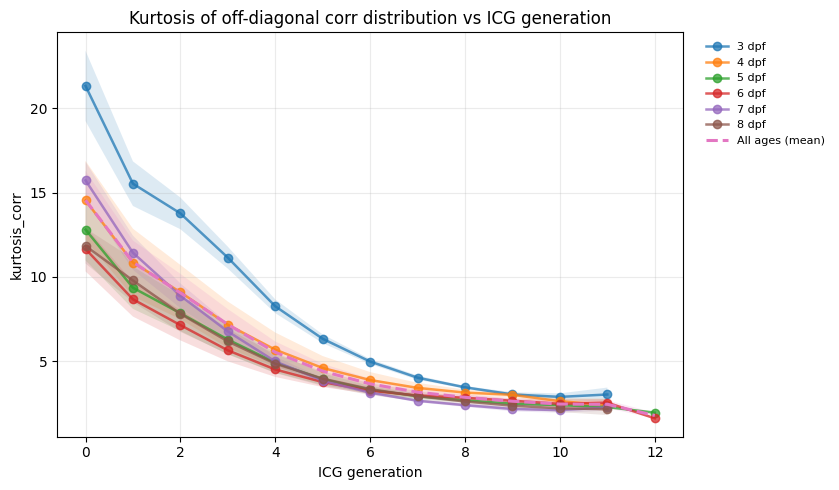

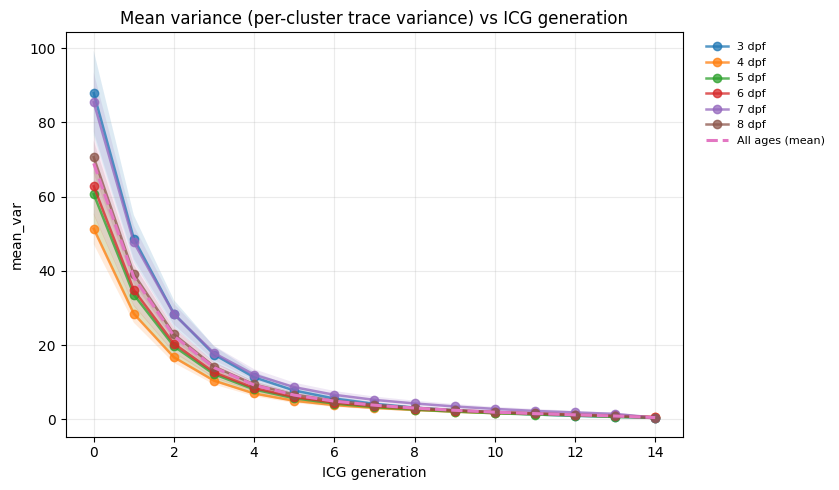

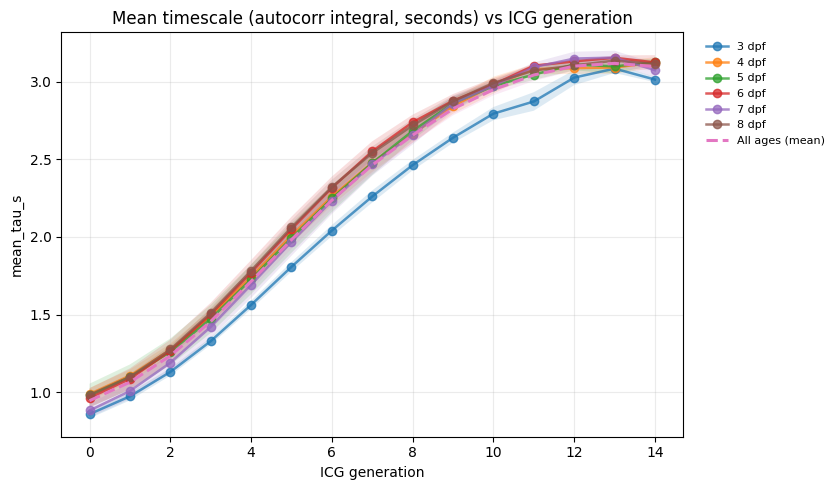

In [667]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# Plot ICG metrics vs generation, stratified by age
# - x-axis: gen
# - y-axis: metric
# - each age: mean across fish at that age (optionally with SEM band)
# - also show grand mean across all fish (dashed black)
# ============================================================

def plot_metric_vs_gen_by_age(
    df_icg,
    metric,
    title=None,
    ages_to_plot=None,        # None -> all ages
    min_fish_per_age=1,       # filter ages with too few fish
    show_sem=True,
    sem_alpha=0.15,
    line_alpha=0.75,
    linewidth=1.8,
    marker="o",
):
    df = df_icg.copy()
    df["age"] = pd.to_numeric(df["age"], errors="coerce")
    df["gen"] = pd.to_numeric(df["gen"], errors="coerce")
    df[metric] = pd.to_numeric(df[metric], errors="coerce")
    df = df.dropna(subset=["age", "gen", metric])

    # how many fish per age overall?
    nfish_age = df.groupby("age")["fish"].nunique()
    keep_ages = nfish_age[nfish_age >= min_fish_per_age].index.to_numpy()

    if ages_to_plot is None:
        ages = np.sort(keep_ages)
    else:
        ages = np.array([a for a in ages_to_plot if a in set(keep_ages)], dtype=int)
        ages = np.sort(ages)

    if ages.size == 0:
        raise ValueError("No ages left to plot after filtering. Lower min_fish_per_age or check df.")

    # aggregate per age×gen
    g = (df.groupby(["age", "gen"], as_index=False)
           .agg(mean=(metric, "mean"),
                std=(metric, "std"),
                n=("fish", "nunique")))
    g["sem"] = g["std"] / np.sqrt(g["n"].clip(lower=1))

    # grand mean across all fish (ignoring age)
    gg = (df.groupby("gen", as_index=False)
            .agg(mean=(metric, "mean"),
                 std=(metric, "std"),
                 n=("fish", "nunique")))
    gg["sem"] = gg["std"] / np.sqrt(gg["n"].clip(lower=1))

    fig, ax = plt.subplots(figsize=(8.5, 5.0))

    # Choose a colormap only if many ages; otherwise matplotlib defaults are fine
    # (no explicit colors requested, so we rely on default cycle)
    for age in ages:
        sub = g[g["age"] == age].sort_values("gen")
        ax.plot(sub["gen"], sub["mean"], marker=marker, linewidth=linewidth, alpha=line_alpha, label=f"{int(age)} dpf")
        if show_sem:
            ax.fill_between(sub["gen"],
                            sub["mean"] - sub["sem"],
                            sub["mean"] + sub["sem"],
                            alpha=sem_alpha)

    # grand mean line
    gg = gg.sort_values("gen")
    ax.plot(gg["gen"], gg["mean"], linestyle="--", linewidth=2.2, label="All ages (mean)")
    if show_sem:
        ax.fill_between(gg["gen"], gg["mean"] - gg["sem"], gg["mean"] + gg["sem"], alpha=sem_alpha)

    ax.set_xlabel("ICG generation")
    ax.set_ylabel(metric)
    ax.set_title(title if title is not None else f"{metric} vs generation (mean across fish per age)")
    ax.grid(True, alpha=0.25)

    # legend outside if many ages
    ax.legend(bbox_to_anchor=(1.02, 1), loc="upper left", frameon=False, fontsize=8)
    plt.tight_layout()
    plt.show()
    return fig, ax


def plot_all_metrics_vs_gen_by_age(
    df_icg,
    ages_to_plot=None,
    min_fish_per_age=1,
    show_sem=True,
):
    plot_metric_vs_gen_by_age(
        df_icg, "kurtosis_corr",
        title="Kurtosis of off-diagonal corr distribution vs ICG generation",
        ages_to_plot=ages_to_plot, min_fish_per_age=min_fish_per_age, show_sem=show_sem
    )
    plot_metric_vs_gen_by_age(
        df_icg, "mean_var",
        title="Mean variance (per-cluster trace variance) vs ICG generation",
        ages_to_plot=ages_to_plot, min_fish_per_age=min_fish_per_age, show_sem=show_sem
    )
    plot_metric_vs_gen_by_age(
        df_icg, "mean_tau_s",
        title="Mean timescale (autocorr integral, seconds) vs ICG generation",
        ages_to_plot=ages_to_plot, min_fish_per_age=min_fish_per_age, show_sem=show_sem
    )


# ============================================================
# Usage
# ============================================================

# If you saved df earlier:
# df_icg = pd.read_csv(os.path.join(fdata, "icg_metrics_by_fish_gen.csv"))

# Plot all metrics (all ages)
plot_all_metrics_vs_gen_by_age(df_icg, ages_to_plot=None, min_fish_per_age=2, show_sem=True)

# If it’s too cluttered, pick a subset of ages, e.g.:
# plot_all_metrics_vs_gen_by_age(df_icg, ages_to_plot=[4,5,6,7,8], min_fish_per_age=2, show_sem=True)

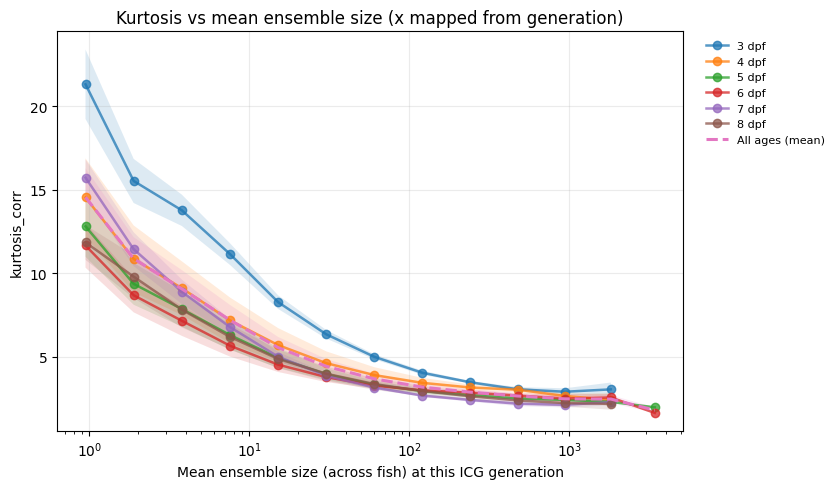

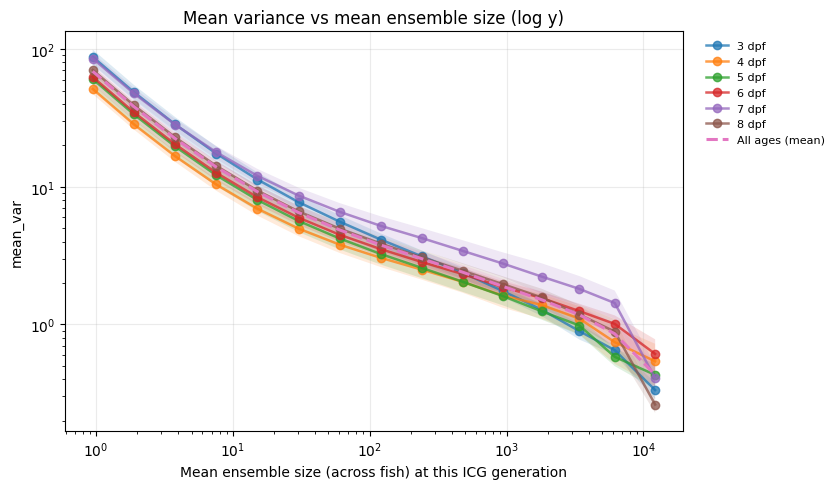

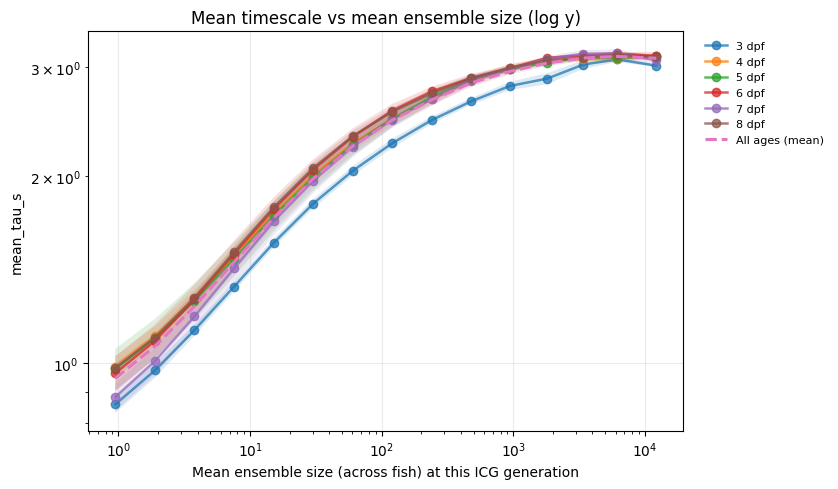

In [682]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# X-axis = global mean ensemble size per ICG gen (shared across fish)
# Also: optionally log-scale Y (for mean_var and mean_tau_s)
# ============================================================

def add_ncells_and_ensemble_size(df_icg, out_ncells="n_cells", out_size="mean_ensemble_size"):
    df = df_icg.copy()
    df["gen"] = pd.to_numeric(df["gen"], errors="coerce")
    df["n_clusters"] = pd.to_numeric(df["n_clusters"], errors="coerce")
    df = df.dropna(subset=["fish", "gen", "n_clusters"])

    n_cells = (df[df["gen"] == 0]
               .groupby("fish")["n_clusters"]
               .first()
               .rename(out_ncells))
    df = df.merge(n_cells, on="fish", how="left")

    df[out_size] = df[out_ncells] / df["n_clusters"].replace(0, np.nan)
    return df


def add_global_mean_size_per_gen(df, size_col="mean_ensemble_size", out_x="x_mean_size_gen"):
    d = df.copy()
    d["gen"] = pd.to_numeric(d["gen"], errors="coerce")
    d[size_col] = pd.to_numeric(d[size_col], errors="coerce")
    d = d.dropna(subset=["gen", size_col])

    mean_size_by_gen = (d.groupby("gen")[size_col].mean()
                          .rename(out_x)
                          .reset_index())
    d = d.merge(mean_size_by_gen, on="gen", how="left")
    return d


def plot_metric_vs_x_by_age(
    df_icg,
    metric,
    xcol,
    xlabel,
    title=None,
    ages_to_plot=None,
    min_fish_per_age=1,
    show_sem=True,
    sem_alpha=0.15,
    line_alpha=0.75,
    linewidth=1.8,
    marker="o",
    xlog=True,
    ylog=False,              # NEW
    y_min_pos=None,          # NEW: if ylog True, optionally clamp lower bound
):
    df = df_icg.copy()
    df["age"] = pd.to_numeric(df["age"], errors="coerce")
    df[xcol]  = pd.to_numeric(df[xcol], errors="coerce")
    df[metric]= pd.to_numeric(df[metric], errors="coerce")
    df = df.dropna(subset=["fish", "age", xcol, metric])

    # if logging y, drop non-positive (or clamp if requested)
    if ylog:
        if y_min_pos is None:
            df = df[df[metric] > 0].copy()
        else:
            df[metric] = df[metric].clip(lower=y_min_pos)

    # keep ages with enough fish
    nfish_age = df.groupby("age")["fish"].nunique()
    keep_ages = nfish_age[nfish_age >= min_fish_per_age].index.to_numpy()

    if ages_to_plot is None:
        ages = np.sort(keep_ages)
    else:
        ages = np.array([a for a in ages_to_plot if a in set(keep_ages)], dtype=int)
        ages = np.sort(ages)

    if ages.size == 0:
        raise ValueError("No ages left to plot after filtering. Lower min_fish_per_age or check df.")

    # aggregate per age×x
    g = (df.groupby(["age", xcol], as_index=False)
           .agg(mean=(metric, "mean"),
                std=(metric, "std"),
                n=("fish", "nunique")))
    g["sem"] = g["std"] / np.sqrt(g["n"].clip(lower=1))

    # grand mean
    gg = (df.groupby(xcol, as_index=False)
            .agg(mean=(metric, "mean"),
                 std=(metric, "std"),
                 n=("fish", "nunique")))
    gg["sem"] = gg["std"] / np.sqrt(gg["n"].clip(lower=1))

    fig, ax = plt.subplots(figsize=(8.5, 5.0))

    for age in ages:
        sub = g[g["age"] == age].sort_values(xcol)
        ax.plot(sub[xcol], sub["mean"], marker=marker, linewidth=linewidth, alpha=line_alpha, label=f"{int(age)} dpf")
        if show_sem:
            ax.fill_between(sub[xcol], sub["mean"] - sub["sem"], sub["mean"] + sub["sem"], alpha=sem_alpha)

    gg = gg.sort_values(xcol)
    ax.plot(gg[xcol], gg["mean"], linestyle="--", linewidth=2.2, label="All ages (mean)")
    if show_sem:
        ax.fill_between(gg[xcol], gg["mean"] - gg["sem"], gg["mean"] + gg["sem"], alpha=sem_alpha)

    ax.set_xlabel(xlabel)
    ax.set_ylabel(metric)
    ax.set_title(title if title is not None else f"{metric} vs {xlabel}")
    ax.grid(True, alpha=0.25)

    if xlog:
        ax.set_xscale("log")
    if ylog:
        ax.set_yscale("log")

    ax.legend(bbox_to_anchor=(1.02, 1), loc="upper left", frameon=False, fontsize=8)
    plt.tight_layout()
    plt.show()
    return fig, ax


def plot_all_metrics_vs_global_mean_ensemble_size_by_age(
    df_icg,
    ages_to_plot=None,
    min_fish_per_age=1,
    show_sem=True,
    xlog=True
):
    # kurtosis: keep linear y by default (can be negative/NaN in some definitions)
    plot_metric_vs_x_by_age(
        df_icg, metric="kurtosis_corr", xcol="x_mean_size_gen",
        xlabel="Mean ensemble size (across fish) at this ICG generation",
        title="Kurtosis vs mean ensemble size (x mapped from generation)",
        ages_to_plot=ages_to_plot, min_fish_per_age=min_fish_per_age,
        show_sem=show_sem, xlog=xlog, ylog=False
    )
    # mean_var: log y
    plot_metric_vs_x_by_age(
        df_icg, metric="mean_var", xcol="x_mean_size_gen",
        xlabel="Mean ensemble size (across fish) at this ICG generation",
        title="Mean variance vs mean ensemble size (log y)",
        ages_to_plot=ages_to_plot, min_fish_per_age=min_fish_per_age,
        show_sem=show_sem, xlog=xlog, ylog=True
    )
    # mean_tau_s: log y
    plot_metric_vs_x_by_age(
        df_icg, metric="mean_tau_s", xcol="x_mean_size_gen",
        xlabel="Mean ensemble size (across fish) at this ICG generation",
        title="Mean timescale vs mean ensemble size (log y)",
        ages_to_plot=ages_to_plot, min_fish_per_age=min_fish_per_age,
        show_sem=show_sem, xlog=xlog, ylog=True
    )


# ============================================================
# Usage
# ============================================================

df2 = add_ncells_and_ensemble_size(df_icg, out_ncells="n_cells", out_size="mean_ensemble_size")
df3 = add_global_mean_size_per_gen(df2, size_col="mean_ensemble_size", out_x="x_mean_size_gen")

plot_all_metrics_vs_global_mean_ensemble_size_by_age(
    df3, ages_to_plot=None, min_fish_per_age=2, show_sem=True, xlog=True
)


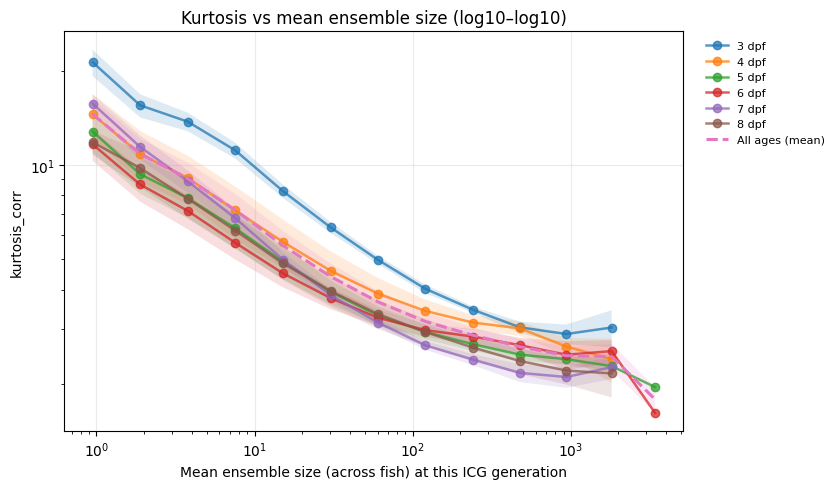

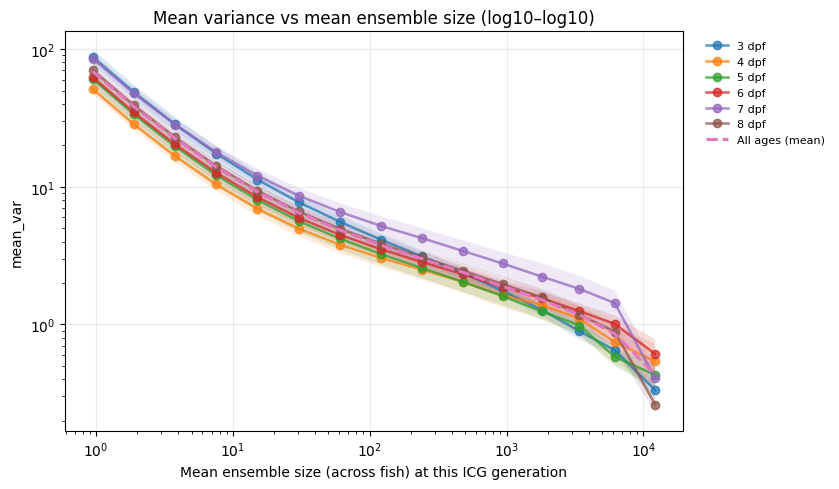

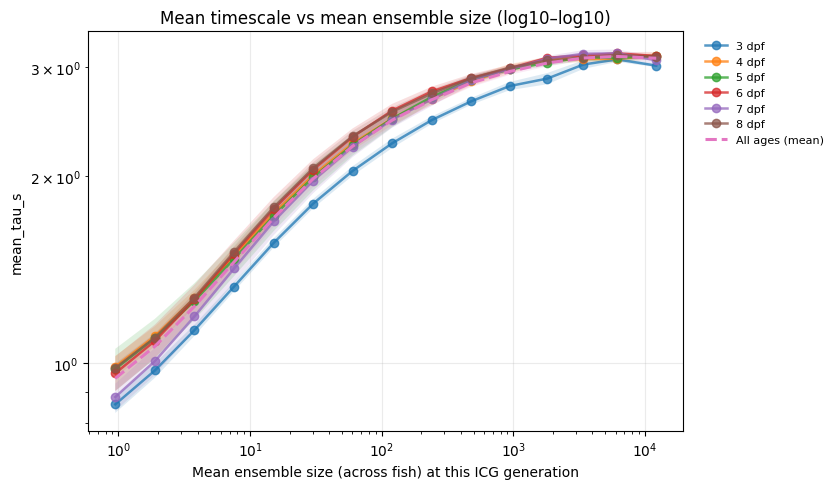

In [684]:
# ------------------------------------------------------------
# Make ALL plots log10–log10 (both axes)
# (Matplotlib's "log" scale is base-10 by default; to force base=10 explicitly,
#  set the LogLocator base to 10.)
# ------------------------------------------------------------
from matplotlib.ticker import LogLocator

def plot_metric_vs_x_by_age(
    df_icg,
    metric,
    xcol,
    xlabel,
    title=None,
    ages_to_plot=None,
    min_fish_per_age=1,
    show_sem=True,
    sem_alpha=0.15,
    line_alpha=0.75,
    linewidth=1.8,
    marker="o",
    xlog=True,
    ylog=False,
    x_min_pos=None,          # NEW: if xlog True, optionally clamp lower bound
    y_min_pos=None,
    log_base=10,             # NEW
):
    df = df_icg.copy()
    df["age"] = pd.to_numeric(df["age"], errors="coerce")
    df[xcol]  = pd.to_numeric(df[xcol], errors="coerce")
    df[metric]= pd.to_numeric(df[metric], errors="coerce")
    df = df.dropna(subset=["fish", "age", xcol, metric])

    # if logging x/y, drop non-positive (or clamp if requested)
    if xlog:
        if x_min_pos is None:
            df = df[df[xcol] > 0].copy()
        else:
            df[xcol] = df[xcol].clip(lower=x_min_pos)
    if ylog:
        if y_min_pos is None:
            df = df[df[metric] > 0].copy()
        else:
            df[metric] = df[metric].clip(lower=y_min_pos)

    # keep ages with enough fish
    nfish_age = df.groupby("age")["fish"].nunique()
    keep_ages = nfish_age[nfish_age >= min_fish_per_age].index.to_numpy()

    if ages_to_plot is None:
        ages = np.sort(keep_ages)
    else:
        ages = np.array([a for a in ages_to_plot if a in set(keep_ages)], dtype=int)
        ages = np.sort(ages)

    if ages.size == 0:
        raise ValueError("No ages left to plot after filtering. Lower min_fish_per_age or check df.")

    # aggregate per age×x
    g = (df.groupby(["age", xcol], as_index=False)
           .agg(mean=(metric, "mean"),
                std=(metric, "std"),
                n=("fish", "nunique")))
    g["sem"] = g["std"] / np.sqrt(g["n"].clip(lower=1))

    # grand mean
    gg = (df.groupby(xcol, as_index=False)
            .agg(mean=(metric, "mean"),
                 std=(metric, "std"),
                 n=("fish", "nunique")))
    gg["sem"] = gg["std"] / np.sqrt(gg["n"].clip(lower=1))

    fig, ax = plt.subplots(figsize=(8.5, 5.0))

    for age in ages:
        sub = g[g["age"] == age].sort_values(xcol)
        ax.plot(sub[xcol], sub["mean"], marker=marker, linewidth=linewidth, alpha=line_alpha, label=f"{int(age)} dpf")
        if show_sem:
            ax.fill_between(sub[xcol], sub["mean"] - sub["sem"], sub["mean"] + sub["sem"], alpha=sem_alpha)

    gg = gg.sort_values(xcol)
    ax.plot(gg[xcol], gg["mean"], linestyle="--", linewidth=2.2, label="All ages (mean)")
    if show_sem:
        ax.fill_between(gg[xcol], gg["mean"] - gg["sem"], gg["mean"] + gg["sem"], alpha=sem_alpha)

    ax.set_xlabel(xlabel)
    ax.set_ylabel(metric)
    ax.set_title(title if title is not None else f"{metric} vs {xlabel}")
    ax.grid(True, alpha=0.25)

    if xlog:
        ax.set_xscale("log", base=log_base)
        ax.xaxis.set_major_locator(LogLocator(base=log_base))
    if ylog:
        ax.set_yscale("log", base=log_base)
        ax.yaxis.set_major_locator(LogLocator(base=log_base))

    ax.legend(bbox_to_anchor=(1.02, 1), loc="upper left", frameon=False, fontsize=8)
    plt.tight_layout()
    plt.show()
    return fig, ax


def plot_all_metrics_vs_global_mean_ensemble_size_by_age_log10(df_icg, ages_to_plot=None, min_fish_per_age=1, show_sem=True):
    # log10-log10 for all three
    plot_metric_vs_x_by_age(
        df_icg, metric="kurtosis_corr", xcol="x_mean_size_gen",
        xlabel="Mean ensemble size (across fish) at this ICG generation",
        title="Kurtosis vs mean ensemble size (log10–log10)",
        ages_to_plot=ages_to_plot, min_fish_per_age=min_fish_per_age,
        show_sem=show_sem, xlog=True, ylog=True, log_base=10
    )
    plot_metric_vs_x_by_age(
        df_icg, metric="mean_var", xcol="x_mean_size_gen",
        xlabel="Mean ensemble size (across fish) at this ICG generation",
        title="Mean variance vs mean ensemble size (log10–log10)",
        ages_to_plot=ages_to_plot, min_fish_per_age=min_fish_per_age,
        show_sem=show_sem, xlog=True, ylog=True, log_base=10
    )
    plot_metric_vs_x_by_age(
        df_icg, metric="mean_tau_s", xcol="x_mean_size_gen",
        xlabel="Mean ensemble size (across fish) at this ICG generation",
        title="Mean timescale vs mean ensemble size (log10–log10)",
        ages_to_plot=ages_to_plot, min_fish_per_age=min_fish_per_age,
        show_sem=show_sem, xlog=True, ylog=True, log_base=10
    )


# ---- usage (assuming df3 already exists) ----
plot_all_metrics_vs_global_mean_ensemble_size_by_age_log10(
    df3, ages_to_plot=None, min_fish_per_age=2, show_sem=True
)

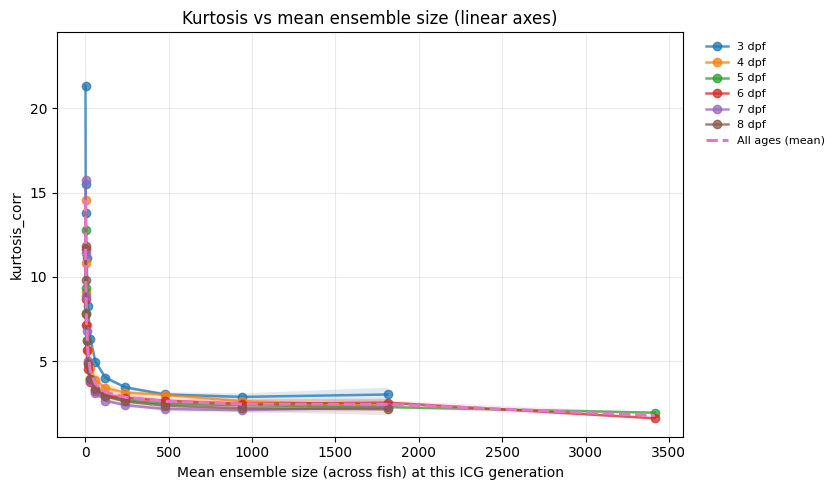

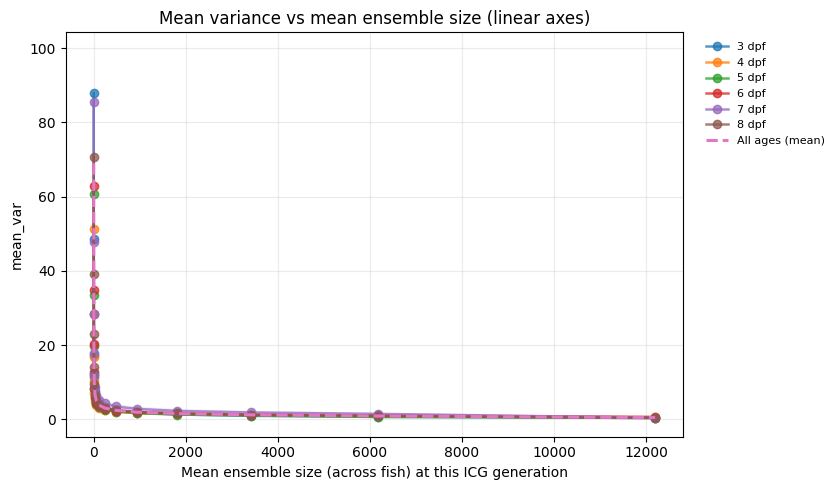

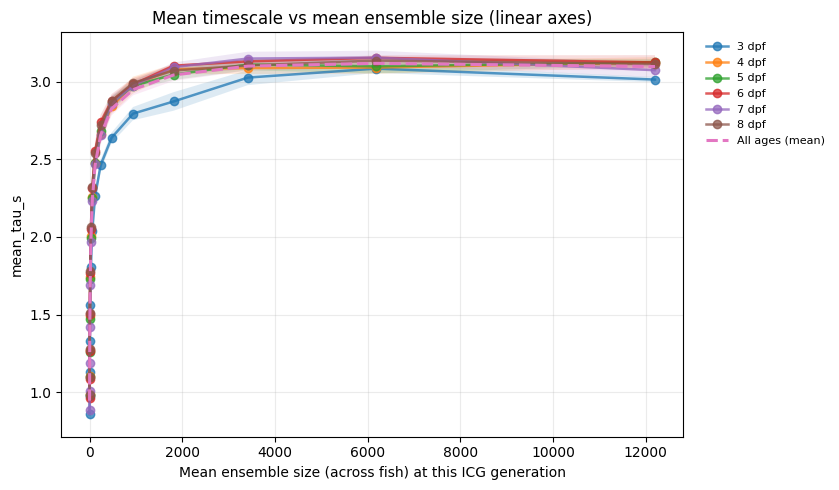

In [683]:
# ============================================================
# Linear axes version (no log on x or y) for all 3 plots
# Uses your existing df3 with x_mean_size_gen already attached.
# ============================================================

def plot_all_metrics_vs_global_mean_ensemble_size_by_age_linear(
    df_icg,
    ages_to_plot=None,
    min_fish_per_age=1,
    show_sem=True,
):
    plot_metric_vs_x_by_age(
        df_icg, metric="kurtosis_corr", xcol="x_mean_size_gen",
        xlabel="Mean ensemble size (across fish) at this ICG generation",
        title="Kurtosis vs mean ensemble size (linear axes)",
        ages_to_plot=ages_to_plot, min_fish_per_age=min_fish_per_age,
        show_sem=show_sem, xlog=False, ylog=False
    )

    plot_metric_vs_x_by_age(
        df_icg, metric="mean_var", xcol="x_mean_size_gen",
        xlabel="Mean ensemble size (across fish) at this ICG generation",
        title="Mean variance vs mean ensemble size (linear axes)",
        ages_to_plot=ages_to_plot, min_fish_per_age=min_fish_per_age,
        show_sem=show_sem, xlog=False, ylog=False
    )

    plot_metric_vs_x_by_age(
        df_icg, metric="mean_tau_s", xcol="x_mean_size_gen",
        xlabel="Mean ensemble size (across fish) at this ICG generation",
        title="Mean timescale vs mean ensemble size (linear axes)",
        ages_to_plot=ages_to_plot, min_fish_per_age=min_fish_per_age,
        show_sem=show_sem, xlog=False, ylog=False
    )


# ---- usage ----
plot_all_metrics_vs_global_mean_ensemble_size_by_age_linear(
    df3, ages_to_plot=None, min_fish_per_age=2, show_sem=True
)


In [726]:
df3['id'] = [df3.iloc[i]['fish'] + '_' + str(df3.iloc[i]['age']) for i in range(df3.shape[0])]
df3

,fish,age,gen,n_clusters,kurtosis_corr,mean_var,mean_tau_s,n_cells,mean_ensemble_size,x_mean_size_gen,id
0,BLNDEV-WILDTYPE-01,4,0,15105,11.620851,62.916393,0.909525,15105,1.000000,0.945812,BLNDEV-WILDTYPE-01_4
1,BLNDEV-WILDTYPE-01,4,1,7553,7.667500,35.082909,1.033412,15105,1.999868,1.891542,BLNDEV-WILDTYPE-01_4
2,BLNDEV-WILDTYPE-01,4,2,3777,6.235360,20.812687,1.215254,15105,3.999206,3.782823,BLNDEV-WILDTYPE-01_4
3,BLNDEV-WILDTYPE-01,4,3,1889,4.751653,13.188326,1.455988,15105,7.996294,7.564395,BLNDEV-WILDTYPE-01_4
4,BLNDEV-WILDTYPE-01,4,4,945,3.899253,8.982273,1.741665,15105,15.984127,15.124315,BLNDEV-WILDTYPE-01_4
...,...,...,...,...,...,...,...,...,...,...,...
445,BLNDEV-WILDTYPE-08,8,10,14,1.686267,2.422829,2.938444,10115,722.500000,938.268228,BLNDEV-WILDTYPE-08_8
446,BLNDEV-WILDTYPE-08,8,11,7,1.381119,2.097867,3.149599,10115,1445.000000,1813.532328,BLNDEV-WILDTYPE-08_8
447,BLNDEV-WILDTYPE-08,8,12,4,NaN,1.699323,3.151043,10115,2528.750000,3415.450556,BLNDEV-WILDTYPE-08_8
448,BLNDEV-WILDTYPE-08,8,13,2,NaN,1.596939,3.221946,10115,5057.500000,6182.038889,BLNDEV-WILDTYPE-08_8


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# Log–log age decomposition with "quadratic-fit style" plotting:
#   Panel A: raw (fish-aggregated) points + fitted curves + CI ribbons
#   Panel B: slope (alpha) vs age with CI
#   Panel C: amplitude (logA) vs age with CI
#   Panel D: contrast curve (oldest - youngest) on log x
#
# Uses WINTER colormap for age.
# Assumes you already defined:
#   prep_metric_xy, common_x_range,
#   bootstrap_alpha_logA_and_curves,
#   shape_only_curve, amplitude_only_curve
# ============================================================

def plot_loglog_decompose_age_quadratic_style(
    df,
    metric,
    xcol="x_mean_size_gen",
    Kmin=50,
    min_obs_per_fish=3,
    min_fish_per_age=2,
    n_boot=500,
    seed=0,
    q_lo=0.05,
    q_hi=0.95,
    s_scatter=10,
    scatter_alpha=0.35,
    line_lw=2.0,
    band_alpha=0.18,
):
    # ---- prep ----
    d = prep_metric_xy(df, metric, xcol=xcol, min_obs_per_fish=min_obs_per_fish, Kmin=Kmin)
    ages = np.sort(d["age"].unique())
    ages = [a for a in ages if d[d["age"] == a]["fish"].nunique() >= min_fish_per_age]
    ages = np.array(ages, dtype=float)

    if len(ages) == 0:
        raise ValueError("No ages left after filtering (min_fish_per_age / Kmin too strict?)")

    # shared x-range
    xr = common_x_range(d, xcol=xcol, ages=ages, q_lo=q_lo, q_hi=q_hi)
    if xr is None:
        raise ValueError("Could not determine a common x-range.")
    x_lo, x_hi = xr
    xgrid = np.logspace(np.log10(x_lo), np.log10(x_hi), 200)

    # ---- fit per age (bootstrapped) ----
    rows = []
    curves = {}
    raw_by_age = {}

    for age in ages:
        dd = d[(d["age"] == age) & (d[xcol] >= x_lo) & (d[xcol] <= x_hi)].copy()
        if dd["fish"].nunique() < min_fish_per_age:
            continue

        # raw points are already fish-aggregated per x in prep_metric_xy output:
        # columns: fish, age, xcol, y
        raw_by_age[age] = dd[[xcol, "y", "fish"]].copy()

        out = bootstrap_alpha_logA_and_curves(
            dd, xcol=xcol, n_boot=n_boot, seed=seed + int(age)*17, xgrid=xgrid
        )
        if out is None:
            continue

        rows.append({
            "age": age,
            "alpha_med": out["alpha_med"], "alpha_lo": out["alpha_lo"], "alpha_hi": out["alpha_hi"],
            "logA_med":  out["logA_med"],  "logA_lo":  out["logA_lo"],  "logA_hi":  out["logA_hi"],
            "n_fish": out["n_fish"], "n_boot_ok": out["n_boot_ok"],
        })
        curves[age] = out

    coeffs = pd.DataFrame(rows).sort_values("age")
    if coeffs.empty:
        raise ValueError("No ages produced bootstrap fits (try lowering Kmin or min_obs_per_fish).")

    # reference parameters for decomposition (use medians across ages)
    alpha_ref = float(np.median(coeffs["alpha_med"]))
    logA_ref  = float(np.median(coeffs["logA_med"]))

    # ---- plotting ----
    fig, axes = plt.subplots(1, 4, figsize=(18.5, 4.9))
    ax_curve, ax_alpha, ax_logA, ax_contrast = axes

    # winter colormap for age
    cmap = plt.get_cmap("winter", len(coeffs))

    # (A) scatter + fitted curves per age (CI ribbons)
    for k, age in enumerate(coeffs["age"].to_numpy()):
        col = cmap(k)

        # raw scatter (fish-aggregated)
        raw = raw_by_age.get(age, None)
        if raw is not None and not raw.empty:
            ax_curve.scatter(raw[xcol], raw["y"], s=s_scatter, alpha=scatter_alpha, color=col)

        # fitted curve + CI
        out = curves[age]
        ax_curve.plot(out["xgrid"], out["pred_med"], linewidth=line_lw, color=col, label=f"{int(age)} dpf")
        ax_curve.fill_between(out["xgrid"], out["pred_lo"], out["pred_hi"], alpha=band_alpha, color=col)

    ax_curve.set_xscale("log", base=10)
    ax_curve.set_yscale("log", base=10)
    ax_curve.set_xlabel("Mean ensemble size (shared range)")
    ax_curve.set_ylabel(metric)
    ax_curve.set_title(f"{metric}: per-age log–log fits (bootstrapped CI)")
    ax_curve.grid(True, alpha=0.25)
    ax_curve.legend(frameon=False, fontsize=8, bbox_to_anchor=(1.02, 1), loc="upper left")

    # (B) slope (shape) vs age with CI (like quadratic curvature panel)
    ax_alpha.errorbar(
        coeffs["age"],
        coeffs["alpha_med"],
        yerr=[coeffs["alpha_med"] - coeffs["alpha_lo"],
              coeffs["alpha_hi"] - coeffs["alpha_med"]],
        fmt="o",
        capsize=3
    )
    ax_alpha.axhline(alpha_ref, linewidth=1, alpha=0.5)
    ax_alpha.set_title("Shape (alpha) vs age\n(bootstrap 95% CI across fish)")
    ax_alpha.set_xlabel("age (dpf)")
    ax_alpha.set_ylabel("alpha (log–log slope)")
    ax_alpha.grid(True, alpha=0.25)

    # (C) amplitude (logA) vs age with CI
    ax_logA.errorbar(
        coeffs["age"],
        coeffs["logA_med"],
        yerr=[coeffs["logA_med"] - coeffs["logA_lo"],
              coeffs["logA_hi"] - coeffs["logA_med"]],
        fmt="o",
        capsize=3
    )
    ax_logA.axhline(logA_ref, linewidth=1, alpha=0.5)
    ax_logA.set_title("Amplitude (log10 A) vs age\n(bootstrap 95% CI across fish)")
    ax_logA.set_xlabel("age (dpf)")
    ax_logA.set_ylabel("log10(A) (intercept)")
    ax_logA.grid(True, alpha=0.25)

    # (D) contrast: oldest minus youngest fitted curve (similar to quadratic contrast panel)
    avail = [a for a in coeffs["age"].to_numpy() if a in curves]
    if len(avail) >= 2:
        a0, a1 = float(avail[0]), float(avail[-1])
        c0, c1 = curves[a0], curves[a1]
        diff = c1["pred_med"] - c0["pred_med"]

        ax_contrast.plot(xgrid, diff, linewidth=2.2)
        ax_contrast.axhline(0, linewidth=1, alpha=0.5)
        ax_contrast.set_xscale("log", base=10)
        ax_contrast.set_xlabel("Mean ensemble size (shared range)")
        ax_contrast.set_ylabel(f"Δ {metric}")
        ax_contrast.set_title(f"Contrast: {int(a1)} dpf − {int(a0)} dpf (fitted)")
        ax_contrast.grid(True, alpha=0.25)
    else:
        ax_contrast.axis("off")

    plt.tight_layout()
    plt.show()

    return coeffs


# -----------------------------
# Example calls
# -----------------------------
# coeffs_kurt = plot_loglog_decompose_age_quadratic_style(df3, "kurtosis_corr", Kmin=50, n_boot=500, seed=0)
# coeffs_var  = plot_loglog_decompose_age_quadratic_style(df3, "mean_var",      Kmin=50, n_boot=500, seed=0)


In [731]:
import numpy as np
import pandas as pd

def prep_metric_xy(
    df,
    metric,
    xcol="x_mean_size_gen",
    min_obs_per_fish=3,
    Kmin=50,
    fish_id_col="id",
    age_col="age",
    fish_name_col="fish",
    agg="mean",
):
    """
    Prepare fish-aggregated (fish_id, age, x) points for log–log fitting.

    Returns a dataframe with (at least) columns:
      [fish_id_col, "fish", age_col, xcol, "y"]

    Key behavior:
      - Uses fish_id_col as the unique fish key (NOT "fish" string).
      - Aggregates duplicates within (fish_id, age, x) -> y (mean/median).
      - Drops fish with < min_obs_per_fish points within each age.
      - Filters to finite, positive x/y and x>=Kmin.
    """
    req = [metric, xcol, age_col]
    missing = [c for c in req if c not in df.columns]
    if missing:
        raise ValueError(f"prep_metric_xy: df missing required columns: {missing}")

    if fish_id_col not in df.columns:
        raise ValueError(f"prep_metric_xy: df missing fish_id_col='{fish_id_col}'")

    d = df.copy()

    # ensure there is a human-readable "fish" column for plotting/debug
    if fish_name_col in d.columns:
        d["fish"] = d[fish_name_col].astype(str)
    else:
        d["fish"] = d[fish_id_col].astype(str)

    # select + rename
    d = d[[fish_id_col, "fish", age_col, xcol, metric]].copy()
    d = d.rename(columns={metric: "y"})

    # numeric coercion
    d[age_col] = pd.to_numeric(d[age_col], errors="coerce")
    d[xcol]    = pd.to_numeric(d[xcol], errors="coerce")
    d["y"]     = pd.to_numeric(d["y"], errors="coerce")

    # finite
    d = d.replace([np.inf, -np.inf], np.nan).dropna(subset=[fish_id_col, age_col, xcol, "y"])

    # log–log requires positive
    d = d[(d[xcol] > 0) & (d["y"] > 0)]
    d = d[d[xcol] >= Kmin]

    if d.empty:
        return d

    # aggregate duplicates within (fish_id, age, x)
    if agg not in ("mean", "median"):
        raise ValueError("prep_metric_xy: agg must be 'mean' or 'median'")

    agg_fn = "mean" if agg == "mean" else "median"
    d = (
        d.groupby([fish_id_col, "fish", age_col, xcol], as_index=False)
         .agg(y=("y", agg_fn))
    )

    # enforce min_obs_per_fish within each age
    kept = []
    for age, dd in d.groupby(age_col):
        counts = dd.groupby(fish_id_col).size()
        good_ids = counts[counts >= min_obs_per_fish].index
        kept.append(dd[dd[fish_id_col].isin(good_ids)])
    d = pd.concat(kept, axis=0, ignore_index=True) if kept else d.iloc[0:0]

    return d


def bootstrap_alpha_logA_and_curves(
    dd,
    xcol="x_mean_size_gen",
    n_boot=500,
    seed=0,
    xgrid=None,
    fish_id_col="id",
    q_lo=0.05,
    q_hi=0.95,
):
    """
    Fish-aware bootstrap for log–log line fits:
      log10(y) = logA + alpha * log10(x)

    Bootstraps across fish (fish_id_col):
      - resample fish IDs with replacement
      - pool their (fish-aggregated) points
      - fit alpha/logA by linear regression in log10 space
      - evaluate predicted curve on xgrid

    Expects dd contains columns:
      fish_id_col, xcol, "y"

    Returns dict with:
      alpha_med/lo/hi, logA_med/lo/hi,
      pred_med/lo/hi over xgrid,
      n_fish, n_boot_ok, xgrid
    """
    if fish_id_col not in dd.columns:
        raise ValueError(f"bootstrap_alpha_logA_and_curves: dd missing fish_id_col='{fish_id_col}'")
    if "y" not in dd.columns:
        raise ValueError("bootstrap_alpha_logA_and_curves: dd missing column 'y'")
    if xcol not in dd.columns:
        raise ValueError(f"bootstrap_alpha_logA_and_curves: dd missing xcol='{xcol}'")

    d = dd.copy()
    d = d.replace([np.inf, -np.inf], np.nan).dropna(subset=[fish_id_col, xcol, "y"])
    d = d[(d[xcol] > 0) & (d["y"] > 0)]

    fish_ids = d[fish_id_col].astype(str).unique()
    n_fish = len(fish_ids)
    if n_fish < 2:
        return None

    if xgrid is None:
        x_lo, x_hi = float(d[xcol].min()), float(d[xcol].max())
        if not np.isfinite(x_lo) or not np.isfinite(x_hi) or x_hi <= x_lo:
            return None
        xgrid = np.logspace(np.log10(x_lo), np.log10(x_hi), 200)

    # pre-split by fish for efficiency
    by_fish = {fid: d[d[fish_id_col].astype(str) == fid] for fid in fish_ids}

    rng = np.random.default_rng(seed)

    alpha_s = []
    logA_s = []
    pred_s = []

    def _fit_loglog(x, y):
        lx = np.log10(x)
        ly = np.log10(y)
        if len(lx) < 2 or np.allclose(lx, lx[0]):
            return None
        alpha, logA = np.polyfit(lx, ly, deg=1)
        return float(alpha), float(logA)

    for _ in range(n_boot):
        samp = rng.choice(fish_ids, size=n_fish, replace=True)

        pooled = pd.concat([by_fish[fid] for fid in samp], axis=0, ignore_index=True)

        x = pooled[xcol].to_numpy(dtype=float)
        y = pooled["y"].to_numpy(dtype=float)
        ok = np.isfinite(x) & np.isfinite(y) & (x > 0) & (y > 0)
        x, y = x[ok], y[ok]

        fit = _fit_loglog(x, y)
        if fit is None:
            continue

        alpha, logA = fit
        alpha_s.append(alpha)
        logA_s.append(logA)

        pred = (10.0 ** logA) * (xgrid ** alpha)
        pred_s.append(pred)

    if len(alpha_s) < max(20, int(0.2 * n_boot)):
        return None

    alpha_s = np.asarray(alpha_s, dtype=float)
    logA_s  = np.asarray(logA_s, dtype=float)
    pred_s  = np.asarray(pred_s, dtype=float)

    return {
        "n_fish": n_fish,
        "n_boot_ok": int(len(alpha_s)),
        "xgrid": xgrid,
        "alpha_med": float(np.median(alpha_s)),
        "alpha_lo":  float(np.quantile(alpha_s, q_lo)),
        "alpha_hi":  float(np.quantile(alpha_s, q_hi)),
        "logA_med":  float(np.median(logA_s)),
        "logA_lo":   float(np.quantile(logA_s, q_lo)),
        "logA_hi":   float(np.quantile(logA_s, q_hi)),
        "pred_med":  np.median(pred_s, axis=0),
        "pred_lo":   np.quantile(pred_s, q_lo, axis=0),
        "pred_hi":   np.quantile(pred_s, q_hi, axis=0),
    }


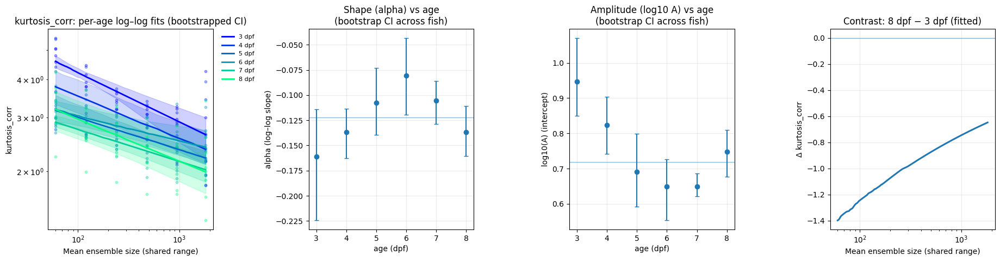

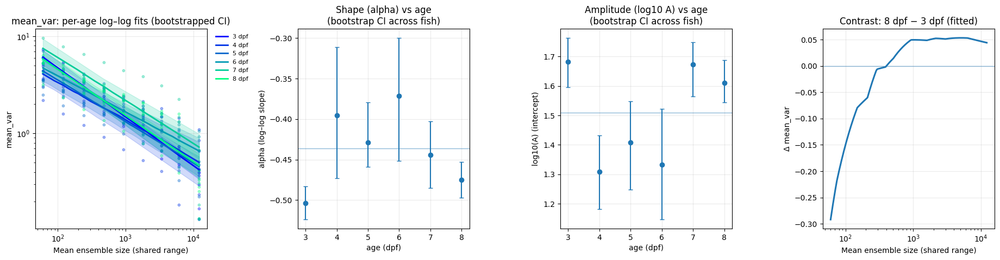

In [733]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# Log–log age decomposition with "quadratic-fit style" plotting:
#   Panel A: raw (fish-aggregated) points + fitted curves + CI ribbons
#   Panel B: slope (alpha) vs age with CI
#   Panel C: amplitude (logA) vs age with CI
#   Panel D: contrast curve (oldest - youngest) on log x
#
# Uses WINTER colormap for age.
# Assumes you already defined:
#   prep_metric_xy, common_x_range,
#   bootstrap_alpha_logA_and_curves,
#   shape_only_curve, amplitude_only_curve
#
# Key change:
#   - uses fish_id_col (default "id") as the unique fish identifier
#   - all "how many fish per age" and bootstrapping is based on fish_id_col
# ============================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_loglog_decompose_age_quadratic_style(
    df,
    metric,
    xcol="x_mean_size_gen",
    fish_id_col="id",
    age_col="age",
    Kmin=50,
    min_obs_per_fish=3,
    min_fish_per_age=2,
    n_boot=500,
    seed=0,
    q_lo=0.05,
    q_hi=0.95,
    s_scatter=10,
    scatter_alpha=0.35,
    line_lw=2.0,
    band_alpha=0.18,
):
    # ---- prep ----
    # Your prep_metric_xy may or may not accept fish_id_col/age_col; try both.
    try:
        d = prep_metric_xy(df, metric, xcol=xcol, min_obs_per_fish=min_obs_per_fish, Kmin=Kmin,
                           fish_id_col=fish_id_col, age_col=age_col)
    except TypeError:
        d = prep_metric_xy(df, metric, xcol=xcol, min_obs_per_fish=min_obs_per_fish, Kmin=Kmin)

    # Ensure required columns exist
    if fish_id_col not in d.columns:
        raise ValueError(
            f"`prep_metric_xy` output must include '{fish_id_col}' now. "
            "Update prep_metric_xy to carry it through."
        )
    if age_col not in d.columns and "age" not in d.columns:
        raise ValueError(f"`prep_metric_xy` output must include '{age_col}' (or 'age').")

    # Make a working copy with canonical column names for legacy helpers
    d = d.copy()
    if age_col in d.columns and age_col != "age":
        d = d.rename(columns={age_col: "age"})
    # (keep fish_id_col as-is; we will use it directly)

    # ages filtered by *unique fish id*
    ages = np.sort(d["age"].unique())
    ages = [a for a in ages if d[d["age"] == a][fish_id_col].nunique() >= min_fish_per_age]
    ages = np.array(ages, dtype=float)

    if len(ages) == 0:
        raise ValueError("No ages left after filtering (min_fish_per_age / Kmin too strict?)")

    # shared x-range (call legacy signature: no age_col kwarg)
    xr = common_x_range(d, xcol=xcol, ages=ages, q_lo=q_lo, q_hi=q_hi)
    if xr is None:
        raise ValueError("Could not determine a common x-range.")
    x_lo, x_hi = xr
    xgrid = np.logspace(np.log10(x_lo), np.log10(x_hi), 200)

    # ---- fit per age (bootstrapped) ----
    rows = []
    curves = {}
    raw_by_age = {}

    for age in ages:
        dd = d[(d["age"] == age) & (d[xcol] >= x_lo) & (d[xcol] <= x_hi)].copy()
        if dd[fish_id_col].nunique() < min_fish_per_age:
            continue

        keep_cols = [xcol, "y", fish_id_col]
        if "fish" in dd.columns:
            keep_cols.append("fish")
        raw_by_age[age] = dd[keep_cols].copy()

        # Call bootstrap helper in a compatibility-friendly way
        try:
            out = bootstrap_alpha_logA_and_curves(
                dd, xcol=xcol, n_boot=n_boot, seed=seed + int(age)*17, xgrid=xgrid,
                fish_id_col=fish_id_col
            )
        except TypeError:
            # older version doesn't accept fish_id_col; it probably uses dd["fish"]
            # In that case, temporarily map fish_id -> fish so it bootstraps correctly.
            dd2 = dd.copy()
            dd2["fish"] = dd2[fish_id_col].astype(str)
            out = bootstrap_alpha_logA_and_curves(
                dd2, xcol=xcol, n_boot=n_boot, seed=seed + int(age)*17, xgrid=xgrid
            )

        if out is None:
            continue

        rows.append({
            "age": age,
            "alpha_med": out["alpha_med"], "alpha_lo": out["alpha_lo"], "alpha_hi": out["alpha_hi"],
            "logA_med":  out["logA_med"],  "logA_lo":  out["logA_lo"],  "logA_hi":  out["logA_hi"],
            "n_fish": out.get("n_fish", dd[fish_id_col].nunique()),
            "n_boot_ok": out["n_boot_ok"],
        })
        curves[age] = out

    coeffs = pd.DataFrame(rows).sort_values("age")
    if coeffs.empty:
        raise ValueError("No ages produced bootstrap fits (try lowering Kmin or min_obs_per_fish).")

    alpha_ref = float(np.median(coeffs["alpha_med"]))
    logA_ref  = float(np.median(coeffs["logA_med"]))

    # ---- plotting ----
    fig, axes = plt.subplots(1, 4, figsize=(18.5, 4.9))
    ax_curve, ax_alpha, ax_logA, ax_contrast = axes

    cmap = plt.get_cmap("winter", len(coeffs))

    # (A) scatter + fitted curves per age (CI ribbons)
    for k, age in enumerate(coeffs["age"].to_numpy()):
        col = cmap(k)

        raw = raw_by_age.get(age, None)
        if raw is not None and not raw.empty:
            ax_curve.scatter(raw[xcol], raw["y"], s=s_scatter, alpha=scatter_alpha, color=col)

        out = curves[age]
        ax_curve.plot(out["xgrid"], out["pred_med"], linewidth=line_lw, color=col, label=f"{int(age)} dpf")
        ax_curve.fill_between(out["xgrid"], out["pred_lo"], out["pred_hi"], alpha=band_alpha, color=col)

    ax_curve.set_xscale("log", base=10)
    ax_curve.set_yscale("log", base=10)
    ax_curve.set_xlabel("Mean ensemble size (shared range)")
    ax_curve.set_ylabel(metric)
    ax_curve.set_title(f"{metric}: per-age log–log fits (bootstrapped CI)")
    ax_curve.grid(True, alpha=0.25)
    ax_curve.legend(frameon=False, fontsize=8, bbox_to_anchor=(1.02, 1), loc="upper left")

    # (B) alpha vs age
    ax_alpha.errorbar(
        coeffs["age"],
        coeffs["alpha_med"],
        yerr=[coeffs["alpha_med"] - coeffs["alpha_lo"],
              coeffs["alpha_hi"] - coeffs["alpha_med"]],
        fmt="o",
        capsize=3
    )
    ax_alpha.axhline(alpha_ref, linewidth=1, alpha=0.5)
    ax_alpha.set_title("Shape (alpha) vs age\n(bootstrap CI across fish)")
    ax_alpha.set_xlabel("age (dpf)")
    ax_alpha.set_ylabel("alpha (log–log slope)")
    ax_alpha.grid(True, alpha=0.25)

    # (C) logA vs age
    ax_logA.errorbar(
        coeffs["age"],
        coeffs["logA_med"],
        yerr=[coeffs["logA_med"] - coeffs["logA_lo"],
              coeffs["logA_hi"] - coeffs["logA_med"]],
        fmt="o",
        capsize=3
    )
    ax_logA.axhline(logA_ref, linewidth=1, alpha=0.5)
    ax_logA.set_title("Amplitude (log10 A) vs age\n(bootstrap CI across fish)")
    ax_logA.set_xlabel("age (dpf)")
    ax_logA.set_ylabel("log10(A) (intercept)")
    ax_logA.grid(True, alpha=0.25)

    # (D) contrast oldest-youngest
    avail = [a for a in coeffs["age"].to_numpy() if a in curves]
    if len(avail) >= 2:
        a0, a1 = float(avail[0]), float(avail[-1])
        c0, c1 = curves[a0], curves[a1]
        diff = c1["pred_med"] - c0["pred_med"]

        ax_contrast.plot(xgrid, diff, linewidth=2.2)
        ax_contrast.axhline(0, linewidth=1, alpha=0.5)
        ax_contrast.set_xscale("log", base=10)
        ax_contrast.set_xlabel("Mean ensemble size (shared range)")
        ax_contrast.set_ylabel(f"Δ {metric}")
        ax_contrast.set_title(f"Contrast: {int(a1)} dpf − {int(a0)} dpf (fitted)")
        ax_contrast.grid(True, alpha=0.25)
    else:
        ax_contrast.axis("off")

    plt.tight_layout()
    plt.show()

    return coeffs


# -----------------------------
# Example calls
# -----------------------------
coeffs_kurt = plot_loglog_decompose_age_quadratic_style(df3, "kurtosis_corr", Kmin=50, n_boot=500, seed=0)
coeffs_var  = plot_loglog_decompose_age_quadratic_style(df3, "mean_var",      Kmin=50, n_boot=500, seed=0)


In [734]:
import numpy as np
import pandas as pd
import statsmodels.formula.api as smf

def prep_for_interaction_model(
    df,
    metric,
    xcol="x_mean_size_gen",
    fish_id_col="id",          # <-- TRUE unique fish id
    age_col="age",
    Kmin=50,
    min_obs_per_fish=3,
    q_lo=0.05,
    q_hi=0.95
):
    # ---- prep (must carry fish_id_col through) ----
    try:
        d = prep_metric_xy(
            df, metric, xcol=xcol,
            min_obs_per_fish=min_obs_per_fish, Kmin=Kmin,
            fish_id_col=fish_id_col, age_col=age_col
        )
    except TypeError:
        # legacy prep_metric_xy signature
        d = prep_metric_xy(df, metric, xcol=xcol,
                           min_obs_per_fish=min_obs_per_fish, Kmin=Kmin)

    # enforce presence of unique id + age + y
    if fish_id_col not in d.columns:
        raise ValueError(
            f"prep_metric_xy output must include '{fish_id_col}' (unique fish id). "
            "Update prep_metric_xy to carry it through."
        )

    # standardize age column name for legacy helpers
    d = d.copy()
    if age_col in d.columns and age_col != "age":
        d = d.rename(columns={age_col: "age"})
    if "age" not in d.columns:
        raise ValueError("prep_metric_xy output must include an age column ('age' or age_col).")
    if "y" not in d.columns:
        raise ValueError("prep_metric_xy output must include column 'y'.")
    if xcol not in d.columns:
        raise ValueError(f"prep_metric_xy output must include xcol='{xcol}'.")

    # ---- restrict to shared x-range across ages ----
    ages = np.sort(d["age"].unique())
    xr = common_x_range(d, xcol=xcol, ages=ages, q_lo=q_lo, q_hi=q_hi)
    if xr is not None:
        x_lo, x_hi = xr
        d = d[(d[xcol] >= x_lo) & (d[xcol] <= x_hi)].copy()

    # ---- build log variables ----
    d["lx"] = np.log10(d[xcol].to_numpy(float))
    d["ly"] = np.log10(d["y"].to_numpy(float))

    # ---- center age ----
    d["age_c"] = d["age"] - d["age"].mean()

    # keep a canonical cluster column for statsmodels
    d["_cluster_fish"] = d[fish_id_col].astype(str)

    return d


def test_age_effects_interaction(
    df,
    metric,
    xcol="x_mean_size_gen",
    fish_id_col="id",          # <-- TRUE unique fish id
    age_col="age",
    Kmin=50,
    min_obs_per_fish=3,
    q_lo=0.05,
    q_hi=0.95
):
    d = prep_for_interaction_model(
        df, metric, xcol=xcol,
        fish_id_col=fish_id_col, age_col=age_col,
        Kmin=Kmin, min_obs_per_fish=min_obs_per_fish,
        q_lo=q_lo, q_hi=q_hi
    )

    # Interaction model:
    #   ly = b0 + b1*lx + b2*age_c + b3*(lx*age_c)
    #   b2 tests amplitude change with age; b3 tests slope change with age
    m = smf.ols("ly ~ lx + age_c + lx:age_c", data=d).fit(
        cov_type="cluster", cov_kwds={"groups": d["_cluster_fish"]}
    )

    out = {
        "metric": metric,
        "n_fish": int(d["_cluster_fish"].nunique()),
        "n_points": int(len(d)),
        "beta_age_amp": float(m.params.get("age_c", np.nan)),
        "p_age_amp": float(m.pvalues.get("age_c", np.nan)),
        "beta_age_slope": float(m.params.get("lx:age_c", np.nan)),
        "p_age_slope": float(m.pvalues.get("lx:age_c", np.nan)),
        "model": m,
        "df_used": d,
    }
    return out


# --- run ---
res_kurt = test_age_effects_interaction(df3, "kurtosis_corr", Kmin=50, fish_id_col="id")
res_var  = test_age_effects_interaction(df3, "mean_var",      Kmin=50, fish_id_col="id")

print("Kurtosis: amp beta, p =", res_kurt["beta_age_amp"], res_kurt["p_age_amp"],
      "| slope beta, p =", res_kurt["beta_age_slope"], res_kurt["p_age_slope"])
print("Mean_var: amp beta, p =", res_var["beta_age_amp"], res_var["p_age_amp"],
      "| slope beta, p =", res_var["beta_age_slope"], res_var["p_age_slope"])

# If you want the full robust summary:
# print(res_kurt["model"].summary())


Kurtosis: amp beta, p = -0.044150710865627316 0.007788489765405735 | slope beta, p = 0.0068108623753445575 0.2957569906358749
Mean_var: amp beta, p = 0.016645593746619974 0.46399408851593227 | slope beta, p = 0.0016429118780822392 0.8338178595529852


In [705]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.formula.api as smf

# ------------------------------------------------------------
# Prep: fish-aggregate tau at each x, filter to shared x-range
# ------------------------------------------------------------
def prep_tau_vs_size(df, metric="mean_tau_s", xcol="x_mean_size_gen",
                     min_obs_per_fish=3, min_fish_per_age=2, Kmin=50,
                     q_lo=0.05, q_hi=0.95):
    cols = ["fish", "age", xcol, metric]
    if Kmin is not None and "n_clusters" in df.columns:
        cols += ["n_clusters"]

    d = df[cols].copy()
    d["age"] = pd.to_numeric(d["age"], errors="coerce")
    d[xcol] = pd.to_numeric(d[xcol], errors="coerce")
    d[metric] = pd.to_numeric(d[metric], errors="coerce")
    d = d.dropna(subset=["fish","age",xcol,metric])

    if Kmin is not None and "n_clusters" in d.columns:
        d["n_clusters"] = pd.to_numeric(d["n_clusters"], errors="coerce")
        d = d.dropna(subset=["n_clusters"])
        d = d[d["n_clusters"] >= Kmin].copy()

    # positive for log plotting; also sensible biologically for tau
    d = d[(d[xcol] > 0) & (d[metric] > 0)].copy()

    # fish-aggregate at each x
    d2 = d.groupby(["fish","age",xcol], as_index=False).agg(y=(metric, "mean"))

    # require enough points per fish
    keep = d2.groupby("fish").size()
    keep = keep[keep >= min_obs_per_fish].index
    d2 = d2[d2["fish"].isin(keep)].copy()

    # keep ages with enough fish
    ages = np.sort(d2["age"].unique())
    ages = [a for a in ages if d2[d2["age"]==a]["fish"].nunique() >= min_fish_per_age]
    ages = np.array(ages, float)
    if len(ages) == 0:
        raise ValueError("No ages left after filtering. Loosen min_fish_per_age/Kmin/min_obs_per_fish.")

    # shared x-range via quantile intersection (robust)
    lo_list, hi_list = [], []
    for a in ages:
        sub = d2[d2["age"]==a][xcol].to_numpy(float)
        lo_list.append(np.quantile(sub, q_lo))
        hi_list.append(np.quantile(sub, q_hi))
    x_lo = max(lo_list)
    x_hi = min(hi_list)
    if not (x_lo < x_hi):
        # fallback: global quantiles
        x_lo = np.quantile(d2[xcol], q_lo)
        x_hi = np.quantile(d2[xcol], q_hi)

    d2 = d2[(d2[xcol] >= x_lo) & (d2[xcol] <= x_hi)].copy()

    # global reference size for coefficient comparability
    x0 = float(np.median(d2[xcol].to_numpy(float)))

    return d2, ages, (x_lo, x_hi), x0


# ------------------------------------------------------------
# Linear-space quadratic in normalized coordinate z=(x-x0)/x0
# y = a + b z + c z^2
# ------------------------------------------------------------
def fit_linquad(dd, xcol, x0):
    d = dd.copy()
    x = d[xcol].to_numpy(float)
    d["z"]  = (x - x0) / x0
    d["z2"] = d["z"]**2
    m = smf.ols("y ~ z + z2", d).fit()

    # prediction grid in x (linear grid, but you can change if you want)
    xgrid = np.linspace(d[xcol].min(), d[xcol].max(), 250)
    zg = (xgrid - x0)/x0
    pred = m.predict(pd.DataFrame({"z": zg, "z2": zg**2}))
    curve = pd.DataFrame({xcol: xgrid, "pred": pred})
    return m, curve


def bootstrap_linquad(dd, xcol, x0, n_boot=400, seed=0):
    rng = np.random.default_rng(seed)
    fish_ids = dd["fish"].unique()
    if len(fish_ids) < 2:
        return None, None

    m0, curve0 = fit_linquad(dd, xcol=xcol, x0=x0)
    xgrid = curve0[xcol].to_numpy(float)
    zg = (xgrid - x0)/x0

    preds = []
    b_list, c_list = [], []

    for _ in range(n_boot):
        pick = rng.choice(fish_ids, size=len(fish_ids), replace=True)
        boot = pd.concat([dd[dd["fish"]==f] for f in pick], ignore_index=True)
        try:
            b2 = boot.copy()
            x = b2[xcol].to_numpy(float)
            b2["z"]  = (x - x0)/x0
            b2["z2"] = b2["z"]**2
            m = smf.ols("y ~ z + z2", b2).fit()
            pred = m.predict(pd.DataFrame({"z": zg, "z2": zg**2}))
            preds.append(pred)
            b_list.append(m.params.get("z", np.nan))
            c_list.append(m.params.get("z2", np.nan))
        except Exception:
            continue

    preds = np.asarray(preds, float)
    b_arr = np.asarray(b_list, float)
    c_arr = np.asarray(c_list, float)

    if preds.ndim != 2 or preds.shape[0] < 30:
        return None, None

    def q(a, p): return np.nanpercentile(a, p, axis=0)

    curve_ci = pd.DataFrame({
        xcol: xgrid,
        "pred_med": q(preds, 50),
        "pred_lo":  q(preds, 2.5),
        "pred_hi":  q(preds, 97.5),
    })

    coeff_ci = {
        "b_lin_med": float(np.nanpercentile(b_arr, 50)),
        "b_lin_lo":  float(np.nanpercentile(b_arr, 2.5)),
        "b_lin_hi":  float(np.nanpercentile(b_arr, 97.5)),
        "c_quad_med": float(np.nanpercentile(c_arr, 50)),
        "c_quad_lo":  float(np.nanpercentile(c_arr, 2.5)),
        "c_quad_hi":  float(np.nanpercentile(c_arr, 97.5)),
        "n_fish": int(len(fish_ids)),
        "n_boot_ok": int(preds.shape[0]),
    }
    return curve_ci, coeff_ci




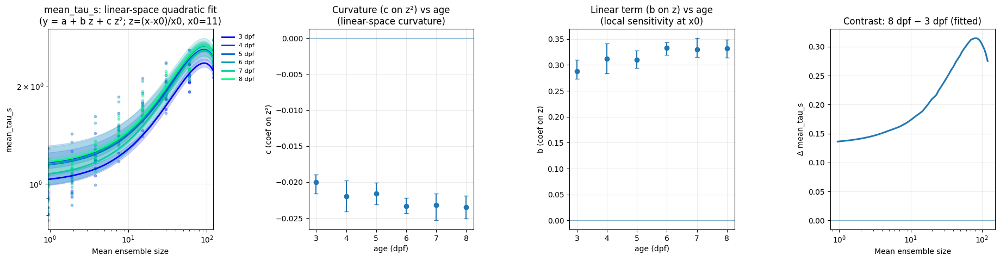

In [716]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.formula.api as smf

# ------------------------------------------------------------
# Prep: fish-aggregate tau at each x, filter to shared x-range
# ------------------------------------------------------------
def prep_tau_vs_size(df, metric="mean_tau_s", xcol="x_mean_size_gen",
                     min_obs_per_fish=3, min_fish_per_age=2, Kmin=50,
                     q_lo=0.05, q_hi=0.95):
    cols = ["fish", "age", xcol, metric]
    if Kmin is not None and "n_clusters" in df.columns:
        cols += ["n_clusters"]

    d = df[cols].copy()
    d["age"] = pd.to_numeric(d["age"], errors="coerce")
    d[xcol] = pd.to_numeric(d[xcol], errors="coerce")
    d[metric] = pd.to_numeric(d[metric], errors="coerce")
    d = d.dropna(subset=["fish","age",xcol,metric])

    if Kmin is not None and "n_clusters" in d.columns:
        d["n_clusters"] = pd.to_numeric(d["n_clusters"], errors="coerce")
        d = d.dropna(subset=["n_clusters"])
        d = d[d["n_clusters"] >= Kmin].copy()

    # positive for log plotting; also sensible biologically for tau
    d = d[(d[xcol] > 0) & (d[metric] > 0)].copy()

    # fish-aggregate at each x
    d2 = d.groupby(["fish","age",xcol], as_index=False).agg(y=(metric, "mean"))

    # require enough points per fish
    keep = d2.groupby("fish").size()
    keep = keep[keep >= min_obs_per_fish].index
    d2 = d2[d2["fish"].isin(keep)].copy()

    # keep ages with enough fish
    ages = np.sort(d2["age"].unique())
    ages = [a for a in ages if d2[d2["age"]==a]["fish"].nunique() >= min_fish_per_age]
    ages = np.array(ages, float)
    if len(ages) == 0:
        raise ValueError("No ages left after filtering. Loosen min_fish_per_age/Kmin/min_obs_per_fish.")

    # shared x-range via quantile intersection (robust)
    lo_list, hi_list = [], []
    for a in ages:
        sub = d2[d2["age"]==a][xcol].to_numpy(float)
        lo_list.append(np.quantile(sub, q_lo))
        hi_list.append(np.quantile(sub, q_hi))
    x_lo = max(lo_list)
    x_hi = min(hi_list)
    if not (x_lo < x_hi):
        # fallback: global quantiles
        x_lo = np.quantile(d2[xcol], q_lo)
        x_hi = np.quantile(d2[xcol], q_hi)

    d2 = d2[(d2[xcol] >= x_lo) & (d2[xcol] <= x_hi)].copy()

    # global reference size for coefficient comparability
    x0 = float(np.median(d2[xcol].to_numpy(float)))

    return d2, ages, (x_lo, x_hi), x0


# ------------------------------------------------------------
# Linear-space quadratic in normalized coordinate z=(x-x0)/x0
# y = a + b z + c z^2
# ------------------------------------------------------------
def fit_linquad(dd, xcol, x0):
    d = dd.copy()
    x = d[xcol].to_numpy(float)
    d["z"]  = (x - x0) / x0
    d["z2"] = d["z"]**2
    m = smf.ols("y ~ z + z2", d).fit()

    # prediction grid in x (linear grid, but you can change if you want)
    xgrid = np.linspace(d[xcol].min(), d[xcol].max(), 250)
    zg = (xgrid - x0)/x0
    pred = m.predict(pd.DataFrame({"z": zg, "z2": zg**2}))
    curve = pd.DataFrame({xcol: xgrid, "pred": pred})
    return m, curve


def bootstrap_linquad(dd, xcol, x0, n_boot=400, seed=0):
    rng = np.random.default_rng(seed)
    fish_ids = dd["fish"].unique()
    if len(fish_ids) < 2:
        return None, None

    m0, curve0 = fit_linquad(dd, xcol=xcol, x0=x0)
    xgrid = curve0[xcol].to_numpy(float)
    zg = (xgrid - x0)/x0

    preds = []
    b_list, c_list = [], []

    for _ in range(n_boot):
        pick = rng.choice(fish_ids, size=len(fish_ids), replace=True)
        boot = pd.concat([dd[dd["fish"]==f] for f in pick], ignore_index=True)
        try:
            b2 = boot.copy()
            x = b2[xcol].to_numpy(float)
            b2["z"]  = (x - x0)/x0
            b2["z2"] = b2["z"]**2
            m = smf.ols("y ~ z + z2", b2).fit()
            pred = m.predict(pd.DataFrame({"z": zg, "z2": zg**2}))
            preds.append(pred)
            b_list.append(m.params.get("z", np.nan))
            c_list.append(m.params.get("z2", np.nan))
        except Exception:
            continue

    preds = np.asarray(preds, float)
    b_arr = np.asarray(b_list, float)
    c_arr = np.asarray(c_list, float)

    if preds.ndim != 2 or preds.shape[0] < 30:
        return None, None

    def q(a, p): return np.nanpercentile(a, p, axis=0)

    curve_ci = pd.DataFrame({
        xcol: xgrid,
        "pred_med": q(preds, 50),
        "pred_lo":  q(preds, 2.5),
        "pred_hi":  q(preds, 97.5),
    })

    coeff_ci = {
        "b_lin_med": float(np.nanpercentile(b_arr, 50)),
        "b_lin_lo":  float(np.nanpercentile(b_arr, 2.5)),
        "b_lin_hi":  float(np.nanpercentile(b_arr, 97.5)),
        "c_quad_med": float(np.nanpercentile(c_arr, 50)),
        "c_quad_lo":  float(np.nanpercentile(c_arr, 2.5)),
        "c_quad_hi":  float(np.nanpercentile(c_arr, 97.5)),
        "n_fish": int(len(fish_ids)),
        "n_boot_ok": int(preds.shape[0]),
    }
    return curve_ci, coeff_ci


# ------------------------------------------------------------
# Plot: quadratic-fit style, but axes log–log (display only)
# ------------------------------------------------------------
def plot_age_linquad_tau_loglog(
    df,
    metric="mean_tau_s",
    xcol="x_mean_size_gen",
    n_boot=400,
    seed=0,
    min_obs_per_fish=3,
    min_fish_per_age=2,
    Kmin=50,
    q_lo=0.05,
    q_hi=0.95,
    winter=True,
    scatter_alpha=0.35,
    s_scatter=10,
    band_alpha=0.18
):
    d, ages, (x_lo, x_hi), x0 = prep_tau_vs_size(
        df, metric=metric, xcol=xcol,
        min_obs_per_fish=min_obs_per_fish, min_fish_per_age=min_fish_per_age,
        Kmin=Kmin, q_lo=q_lo, q_hi=q_hi
    )

    fig, axes = plt.subplots(1, 4, figsize=(18.5, 4.9))
    ax_curve, ax_curv, ax_lin, ax_contrast = axes

    cmap = plt.get_cmap("winter" if winter else "viridis", len(ages))

    coeff_rows = []
    curves = {}

    # Panel A: scatter + fitted curves
    for k, age in enumerate(ages):
        dd = d[d["age"] == age].copy()
        col = cmap(k)

        ax_curve.scatter(dd[xcol], dd["y"], s=s_scatter, alpha=scatter_alpha, color=col)

        curve_ci, coeff_ci = bootstrap_linquad(dd, xcol=xcol, x0=x0, n_boot=n_boot, seed=seed + int(age)*17)
        if curve_ci is None:
            m, curve = fit_linquad(dd, xcol=xcol, x0=x0)
            ax_curve.plot(curve[xcol], curve["pred"], lw=2, color=col, label=f"{int(age)} dpf")
            coeff_rows.append({
                "age": age,
                "b_lin_med": m.params.get("z", np.nan), "b_lin_lo": np.nan, "b_lin_hi": np.nan,
                "c_quad_med": m.params.get("z2", np.nan), "c_quad_lo": np.nan, "c_quad_hi": np.nan,
                "n_fish": dd["fish"].nunique(), "n_boot_ok": 0
            })
            curves[age] = curve.rename(columns={"pred":"pred_med"})[[xcol,"pred_med"]]
        else:
            ax_curve.plot(curve_ci[xcol], curve_ci["pred_med"], lw=2, color=col, label=f"{int(age)} dpf")
            ax_curve.fill_between(curve_ci[xcol], curve_ci["pred_lo"], curve_ci["pred_hi"], alpha=band_alpha, color=col)
            coeff_rows.append({"age": age, **coeff_ci})
            curves[age] = curve_ci[[xcol,"pred_med"]].copy()

    ax_curve.set_xscale("log", base=10)
    ax_curve.set_yscale("log", base=10)
    ax_curve.set_xlim(x_lo, x_hi)
    ax_curve.set_xlabel("Mean ensemble size")
    ax_curve.set_ylabel(metric)
    ax_curve.set_title(f"{metric}: linear-space quadratic fit\n(y = a + b z + c z²; z=(x-x0)/x0, x0={x0:.2g})")
    ax_curve.grid(True, alpha=0.25)
    ax_curve.legend(frameon=False, fontsize=8, bbox_to_anchor=(1.02, 1), loc="upper left")

    # Panel B: curvature vs age
    coeffs = pd.DataFrame(coeff_rows).sort_values("age")
    ax_curv.errorbar(
        coeffs["age"], coeffs["c_quad_med"],
        yerr=[coeffs["c_quad_med"]-coeffs["c_quad_lo"], coeffs["c_quad_hi"]-coeffs["c_quad_med"]],
        fmt="o", capsize=3
    )
    ax_curv.axhline(0, lw=1, alpha=0.5)
    ax_curv.set_title("Curvature (c on z²) vs age\n(linear-space curvature)")
    ax_curv.set_xlabel("age (dpf)")
    ax_curv.set_ylabel("c (coef on z²)")
    ax_curv.grid(True, alpha=0.25)

    # Panel C: linear term vs age
    ax_lin.errorbar(
        coeffs["age"], coeffs["b_lin_med"],
        yerr=[coeffs["b_lin_med"]-coeffs["b_lin_lo"], coeffs["b_lin_hi"]-coeffs["b_lin_med"]],
        fmt="o", capsize=3
    )
    ax_lin.axhline(0, lw=1, alpha=0.5)
    ax_lin.set_title("Linear term (b on z) vs age\n(local sensitivity at x0)")
    ax_lin.set_xlabel("age (dpf)")
    ax_lin.set_ylabel("b (coef on z)")
    ax_lin.grid(True, alpha=0.25)

    # Panel D: contrast oldest - youngest fitted curve (in original y units)
    avail = sorted(curves.keys())
    if len(avail) >= 2:
        a0, a1 = avail[0], avail[-1]
        c0, c1 = curves[a0], curves[a1]
        mrg = pd.merge(c1, c0, on=xcol, suffixes=("_old","_young"))
        diff = mrg["pred_med_old"] - mrg["pred_med_young"]
        ax_contrast.plot(mrg[xcol], diff, lw=2.2)
        ax_contrast.axhline(0, lw=1, alpha=0.5)
        ax_contrast.set_xscale("log", base=10)
        ax_contrast.set_xlabel("Mean ensemble size")
        ax_contrast.set_ylabel(f"Δ {metric}")
        ax_contrast.set_title(f"Contrast: {int(a1)} dpf − {int(a0)} dpf (fitted)")
        ax_contrast.grid(True, alpha=0.25)
    else:
        ax_contrast.axis("off")

    plt.tight_layout()
    plt.show()
    return coeffs


# ---- call (df3 must have x_mean_size_gen) ----
coeffs_tau_lin = plot_age_linquad_tau_loglog(df3, metric="mean_tau_s", xcol="x_mean_size_gen",
                                              n_boot=400, seed=0, Kmin=50, winter=True)

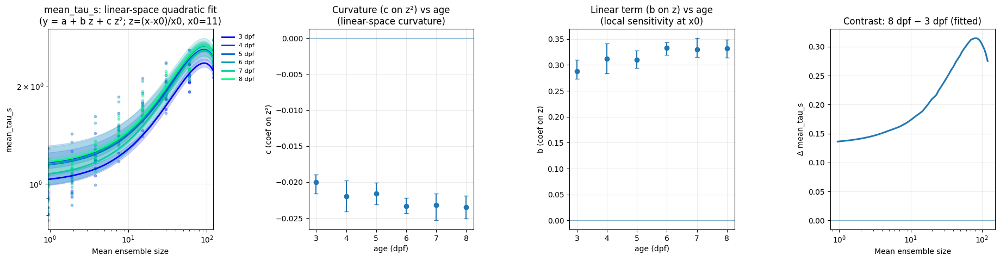

In [735]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.formula.api as smf

# ------------------------------------------------------------
# Prep: fish-aggregate tau at each x, filter to shared x-range
#   UPDATED: uses fish_id_col="id" as the true unique fish key
# ------------------------------------------------------------
def prep_tau_vs_size(
    df,
    metric="mean_tau_s",
    xcol="x_mean_size_gen",
    fish_id_col="id",          # <-- unique fish id
    age_col="age",
    min_obs_per_fish=3,
    min_fish_per_age=2,
    Kmin=50,
    q_lo=0.05,
    q_hi=0.95
):
    cols = [fish_id_col, age_col, xcol, metric]
    if "fish" in df.columns:
        cols.append("fish")  # optional display label
    if Kmin is not None and "n_clusters" in df.columns:
        cols.append("n_clusters")

    d = df[cols].copy()

    d[age_col] = pd.to_numeric(d[age_col], errors="coerce")
    d[xcol] = pd.to_numeric(d[xcol], errors="coerce")
    d[metric] = pd.to_numeric(d[metric], errors="coerce")

    # Ensure fish display label exists
    if "fish" not in d.columns:
        d["fish"] = d[fish_id_col].astype(str)

    d = d.dropna(subset=[fish_id_col, age_col, xcol, metric])

    if Kmin is not None and "n_clusters" in d.columns:
        d["n_clusters"] = pd.to_numeric(d["n_clusters"], errors="coerce")
        d = d.dropna(subset=["n_clusters"])
        d = d[d["n_clusters"] >= Kmin].copy()

    # positive for log plotting; also sensible biologically for tau
    d = d[(d[xcol] > 0) & (d[metric] > 0)].copy()

    # fish-aggregate at each x (unique fish id!)
    d2 = (
        d.groupby([fish_id_col, "fish", age_col, xcol], as_index=False)
         .agg(y=(metric, "mean"))
    )

    # require enough points per fish (by unique id)
    keep = d2.groupby(fish_id_col).size()
    keep = keep[keep >= min_obs_per_fish].index
    d2 = d2[d2[fish_id_col].isin(keep)].copy()

    # keep ages with enough fish (by unique id)
    ages = np.sort(d2[age_col].unique())
    ages = [a for a in ages if d2[d2[age_col] == a][fish_id_col].nunique() >= min_fish_per_age]
    ages = np.array(ages, float)
    if len(ages) == 0:
        raise ValueError("No ages left after filtering. Loosen min_fish_per_age/Kmin/min_obs_per_fish.")

    # shared x-range via quantile intersection (robust)
    lo_list, hi_list = [], []
    for a in ages:
        sub = d2[d2[age_col] == a][xcol].to_numpy(float)
        lo_list.append(np.quantile(sub, q_lo))
        hi_list.append(np.quantile(sub, q_hi))
    x_lo = max(lo_list)
    x_hi = min(hi_list)
    if not (x_lo < x_hi):
        # fallback: global quantiles
        x_lo = np.quantile(d2[xcol], q_lo)
        x_hi = np.quantile(d2[xcol], q_hi)

    d2 = d2[(d2[xcol] >= x_lo) & (d2[xcol] <= x_hi)].copy()

    # global reference size for coefficient comparability
    x0 = float(np.median(d2[xcol].to_numpy(float)))

    return d2, ages, (x_lo, x_hi), x0


# ------------------------------------------------------------
# Linear-space quadratic in normalized coordinate z=(x-x0)/x0
# y = a + b z + c z^2
# ------------------------------------------------------------
def fit_linquad(dd, xcol, x0):
    d = dd.copy()
    x = d[xcol].to_numpy(float)
    d["z"]  = (x - x0) / x0
    d["z2"] = d["z"]**2
    m = smf.ols("y ~ z + z2", d).fit()

    xgrid = np.linspace(d[xcol].min(), d[xcol].max(), 250)
    zg = (xgrid - x0) / x0
    pred = m.predict(pd.DataFrame({"z": zg, "z2": zg**2}))
    curve = pd.DataFrame({xcol: xgrid, "pred": pred})
    return m, curve


def bootstrap_linquad(dd, xcol, x0, fish_id_col="id", n_boot=400, seed=0):
    rng = np.random.default_rng(seed)
    fish_ids = dd[fish_id_col].astype(str).unique()
    if len(fish_ids) < 2:
        return None, None

    m0, curve0 = fit_linquad(dd, xcol=xcol, x0=x0)
    xgrid = curve0[xcol].to_numpy(float)
    zg = (xgrid - x0) / x0

    preds = []
    b_list, c_list = [], []

    # pre-split for speed
    by_fish = {fid: dd[dd[fish_id_col].astype(str) == fid] for fid in fish_ids}

    for _ in range(n_boot):
        pick = rng.choice(fish_ids, size=len(fish_ids), replace=True)
        boot = pd.concat([by_fish[f] for f in pick], ignore_index=True)

        try:
            b2 = boot.copy()
            x = b2[xcol].to_numpy(float)
            b2["z"]  = (x - x0) / x0
            b2["z2"] = b2["z"]**2
            m = smf.ols("y ~ z + z2", b2).fit()

            pred = m.predict(pd.DataFrame({"z": zg, "z2": zg**2}))
            preds.append(pred)
            b_list.append(m.params.get("z", np.nan))
            c_list.append(m.params.get("z2", np.nan))
        except Exception:
            continue

    preds = np.asarray(preds, float)
    b_arr = np.asarray(b_list, float)
    c_arr = np.asarray(c_list, float)

    if preds.ndim != 2 or preds.shape[0] < 30:
        return None, None

    def q(a, p): return np.nanpercentile(a, p, axis=0)

    curve_ci = pd.DataFrame({
        xcol: xgrid,
        "pred_med": q(preds, 50),
        "pred_lo":  q(preds, 2.5),
        "pred_hi":  q(preds, 97.5),
    })

    coeff_ci = {
        "b_lin_med": float(np.nanpercentile(b_arr, 50)),
        "b_lin_lo":  float(np.nanpercentile(b_arr, 2.5)),
        "b_lin_hi":  float(np.nanpercentile(b_arr, 97.5)),
        "c_quad_med": float(np.nanpercentile(c_arr, 50)),
        "c_quad_lo":  float(np.nanpercentile(c_arr, 2.5)),
        "c_quad_hi":  float(np.nanpercentile(c_arr, 97.5)),
        "n_fish": int(len(fish_ids)),
        "n_boot_ok": int(preds.shape[0]),
    }
    return curve_ci, coeff_ci


# ------------------------------------------------------------
# Plot: quadratic-fit style, but axes log–log (display only)
#   UPDATED: fish identity everywhere uses fish_id_col
# ------------------------------------------------------------
def plot_age_linquad_tau_loglog(
    df,
    metric="mean_tau_s",
    xcol="x_mean_size_gen",
    fish_id_col="id",
    age_col="age",
    n_boot=400,
    seed=0,
    min_obs_per_fish=3,
    min_fish_per_age=2,
    Kmin=50,
    q_lo=0.05,
    q_hi=0.95,
    winter=True,
    scatter_alpha=0.35,
    s_scatter=10,
    band_alpha=0.18
):
    d, ages, (x_lo, x_hi), x0 = prep_tau_vs_size(
        df, metric=metric, xcol=xcol,
        fish_id_col=fish_id_col, age_col=age_col,
        min_obs_per_fish=min_obs_per_fish, min_fish_per_age=min_fish_per_age,
        Kmin=Kmin, q_lo=q_lo, q_hi=q_hi
    )

    fig, axes = plt.subplots(1, 4, figsize=(18.5, 4.9))
    ax_curve, ax_curv, ax_lin, ax_contrast = axes

    cmap = plt.get_cmap("winter" if winter else "viridis", len(ages))

    coeff_rows = []
    curves = {}

    # Panel A: scatter + fitted curves
    for k, age in enumerate(ages):
        dd = d[d[age_col] == age].copy()
        col = cmap(k)

        ax_curve.scatter(dd[xcol], dd["y"], s=s_scatter, alpha=scatter_alpha, color=col)

        curve_ci, coeff_ci = bootstrap_linquad(
            dd, xcol=xcol, x0=x0,
            fish_id_col=fish_id_col,
            n_boot=n_boot, seed=seed + int(age)*17
        )

        if curve_ci is None:
            m, curve = fit_linquad(dd, xcol=xcol, x0=x0)
            ax_curve.plot(curve[xcol], curve["pred"], lw=2, color=col, label=f"{int(age)} dpf")
            coeff_rows.append({
                "age": age,
                "b_lin_med": m.params.get("z", np.nan), "b_lin_lo": np.nan, "b_lin_hi": np.nan,
                "c_quad_med": m.params.get("z2", np.nan), "c_quad_lo": np.nan, "c_quad_hi": np.nan,
                "n_fish": int(dd[fish_id_col].nunique()), "n_boot_ok": 0
            })
            curves[age] = curve.rename(columns={"pred": "pred_med"})[[xcol, "pred_med"]]
        else:
            ax_curve.plot(curve_ci[xcol], curve_ci["pred_med"], lw=2, color=col, label=f"{int(age)} dpf")
            ax_curve.fill_between(curve_ci[xcol], curve_ci["pred_lo"], curve_ci["pred_hi"],
                                  alpha=band_alpha, color=col)
            coeff_rows.append({"age": age, **coeff_ci})
            curves[age] = curve_ci[[xcol, "pred_med"]].copy()

    ax_curve.set_xscale("log", base=10)
    ax_curve.set_yscale("log", base=10)
    ax_curve.set_xlim(x_lo, x_hi)
    ax_curve.set_xlabel("Mean ensemble size")
    ax_curve.set_ylabel(metric)
    ax_curve.set_title(
        f"{metric}: linear-space quadratic fit\n"
        f"(y = a + b z + c z²; z=(x-x0)/x0, x0={x0:.2g})"
    )
    ax_curve.grid(True, alpha=0.25)
    ax_curve.legend(frameon=False, fontsize=8, bbox_to_anchor=(1.02, 1), loc="upper left")

    # Panel B: curvature vs age
    coeffs = pd.DataFrame(coeff_rows).sort_values("age")
    ax_curv.errorbar(
        coeffs["age"], coeffs["c_quad_med"],
        yerr=[coeffs["c_quad_med"] - coeffs["c_quad_lo"], coeffs["c_quad_hi"] - coeffs["c_quad_med"]],
        fmt="o", capsize=3
    )
    ax_curv.axhline(0, lw=1, alpha=0.5)
    ax_curv.set_title("Curvature (c on z²) vs age\n(linear-space curvature)")
    ax_curv.set_xlabel("age (dpf)")
    ax_curv.set_ylabel("c (coef on z²)")
    ax_curv.grid(True, alpha=0.25)

    # Panel C: linear term vs age
    ax_lin.errorbar(
        coeffs["age"], coeffs["b_lin_med"],
        yerr=[coeffs["b_lin_med"] - coeffs["b_lin_lo"], coeffs["b_lin_hi"] - coeffs["b_lin_med"]],
        fmt="o", capsize=3
    )
    ax_lin.axhline(0, lw=1, alpha=0.5)
    ax_lin.set_title("Linear term (b on z) vs age\n(local sensitivity at x0)")
    ax_lin.set_xlabel("age (dpf)")
    ax_lin.set_ylabel("b (coef on z)")
    ax_lin.grid(True, alpha=0.25)

    # Panel D: contrast oldest - youngest fitted curve (original y units)
    avail = sorted(curves.keys())
    if len(avail) >= 2:
        a0, a1 = avail[0], avail[-1]
        c0, c1 = curves[a0], curves[a1]
        mrg = pd.merge(c1, c0, on=xcol, suffixes=("_old", "_young"))
        diff = mrg["pred_med_old"] - mrg["pred_med_young"]

        ax_contrast.plot(mrg[xcol], diff, lw=2.2)
        ax_contrast.axhline(0, lw=1, alpha=0.5)
        ax_contrast.set_xscale("log", base=10)
        ax_contrast.set_xlabel("Mean ensemble size")
        ax_contrast.set_ylabel(f"Δ {metric}")
        ax_contrast.set_title(f"Contrast: {int(a1)} dpf − {int(a0)} dpf (fitted)")
        ax_contrast.grid(True, alpha=0.25)
    else:
        ax_contrast.axis("off")

    plt.tight_layout()
    plt.show()
    return coeffs


# ---- call ----
coeffs_tau_lin = plot_age_linquad_tau_loglog(
    df3, metric="mean_tau_s", xcol="x_mean_size_gen",
    fish_id_col="id", age_col="age",
    n_boot=400, seed=0, Kmin=50, winter=True
)


In [736]:
import numpy as np
import pandas as pd
import statsmodels.formula.api as smf

def prep_tau_allfish(
    df,
    metric="mean_tau_s",
    xcol="x_mean_size_gen",
    fish_id_col="id",      # <-- TRUE unique fish id
    age_col="age",
    Kmin=50,
    min_obs_per_fish=3,
):
    cols = [fish_id_col, age_col, xcol, metric]
    if "fish" in df.columns:
        cols.append("fish")  # optional display label
    if Kmin is not None and "n_clusters" in df.columns:
        cols.append("n_clusters")

    d = df[cols].copy()
    d[age_col] = pd.to_numeric(d[age_col], errors="coerce")
    d[xcol] = pd.to_numeric(d[xcol], errors="coerce")
    d[metric] = pd.to_numeric(d[metric], errors="coerce")
    d = d.dropna(subset=[fish_id_col, age_col, xcol, metric])

    # ensure display label exists
    if "fish" not in d.columns:
        d["fish"] = d[fish_id_col].astype(str)

    if Kmin is not None and "n_clusters" in d.columns:
        d["n_clusters"] = pd.to_numeric(d["n_clusters"], errors="coerce")
        d = d.dropna(subset=["n_clusters"])
        d = d[d["n_clusters"] >= Kmin].copy()

    # positive constraints (tau>0, size>0)
    d = d[(d[xcol] > 0) & (d[metric] > 0)].copy()

    # fish-aggregate at each x (prevents duplicates; keeps your earlier convention)
    d2 = (
        d.groupby([fish_id_col, "fish", age_col, xcol], as_index=False)
         .agg(y=(metric, "mean"))
    )

    # require enough points per fish (by unique id)
    keep = d2.groupby(fish_id_col).size()
    keep = keep[keep >= min_obs_per_fish].index
    d2 = d2[d2[fish_id_col].isin(keep)].copy()

    if d2.empty:
        raise ValueError("No data left after filtering (min_obs_per_fish/Kmin too strict?).")

    # global reference x0
    x0 = float(np.median(d2[xcol].to_numpy(float)))
    d2["z"]  = (d2[xcol].to_numpy(float) - x0) / x0
    d2["z2"] = d2["z"]**2

    # center age for numerical stability
    d2["age_c"] = d2[age_col] - d2[age_col].mean()

    # cluster key for robust SEs
    d2["_cluster_fish"] = d2[fish_id_col].astype(str)

    return d2, x0


def pooled_age_effect_allfish(
    df,
    metric="mean_tau_s",
    xcol="x_mean_size_gen",
    fish_id_col="id",      # <-- TRUE unique fish id
    age_col="age",
    Kmin=50,
    min_obs_per_fish=3,
):
    d_used, x0 = prep_tau_allfish(
        df, metric=metric, xcol=xcol,
        fish_id_col=fish_id_col, age_col=age_col,
        Kmin=Kmin, min_obs_per_fish=min_obs_per_fish
    )

    # Shape+amplitude age effect model:
    # - age_c     : amplitude shift (at z=0)
    # - age_c:z   : slope change with age
    # - age_c:z2  : curvature change with age
    m = smf.ols("y ~ z + z2 + age_c + age_c:z + age_c:z2", data=d_used).fit(
        cov_type="cluster",
        cov_kwds={"groups": d_used["_cluster_fish"]},
    )

    info = {
        "n_rows": int(d_used.shape[0]),
        "n_fish": int(d_used["_cluster_fish"].nunique()),
        "ages": sorted(pd.Series(d_used[age_col]).dropna().astype(int).unique().tolist()),
        "x0": float(x0),
        "p_age": float(m.pvalues.get("age_c", np.nan)),
        "p_age_z": float(m.pvalues.get("age_c:z", np.nan)),
        "p_age_z2": float(m.pvalues.get("age_c:z2", np.nan)),
    }
    return m, info, d_used


# -------------------------
# RUN
# -------------------------
m_all, info_all, d_used_all = pooled_age_effect_allfish(
    df3,
    metric="mean_tau_s",
    xcol="x_mean_size_gen",
    fish_id_col="id",
    age_col="age",
    Kmin=None,            # set None if you truly want everything
    min_obs_per_fish=1    # set 1 if you really want to keep almost all fish
)

print("---- info ----")
print(info_all)
print("\n---- key p-values ----")
print("p(age)     =", info_all["p_age"])
print("p(age:z)   =", info_all["p_age_z"])
print("p(age:z2)  =", info_all["p_age_z2"])
print("\n---- summary ----")
print(m_all.summary())

print("\nFish used:", info_all["n_fish"])


---- info ----
{'n_rows': 450, 'n_fish': 30, 'ages': [3, 4, 5, 6, 7, 8], 'x0': 120.46741371702404, 'p_age': 0.006202114500864863, 'p_age_z': 0.4637592219786255, 'p_age_z2': 0.822479486606067}

---- key p-values ----
p(age)     = 0.006202114500864863
p(age:z)   = 0.4637592219786255
p(age:z2)  = 0.822479486606067

---- summary ----
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.502
Model:                            OLS   Adj. R-squared:                  0.497
Method:                 Least Squares   F-statistic:                     1106.
Date:                Wed, 24 Dec 2025   Prob (F-statistic):           3.75e-32
Time:                        17:40:38   Log-Likelihood:                -371.86
No. Observations:                 450   AIC:                             755.7
Df Residuals:                     444   BIC:                             780.4
Df Model:                           

In [712]:
import numpy as np
import pandas as pd
import statsmodels.formula.api as smf

def prep_tau_allfish(
    df,
    metric="mean_tau_s",
    xcol="x_mean_size_gen",
    Kmin=50,
    min_obs_per_fish=3,
):
    cols = ["fish", "age", xcol, metric]
    if Kmin is not None and "n_clusters" in df.columns:
        cols += ["n_clusters"]

    d = df[cols].copy()
    d["age"] = pd.to_numeric(d["age"], errors="coerce")
    d[xcol] = pd.to_numeric(d[xcol], errors="coerce")
    d[metric] = pd.to_numeric(d[metric], errors="coerce")
    d = d.dropna(subset=["fish","age",xcol,metric])

    if Kmin is not None and "n_clusters" in d.columns:
        d["n_clusters"] = pd.to_numeric(d["n_clusters"], errors="coerce")
        d = d.dropna(subset=["n_clusters"])
        d = d[d["n_clusters"] >= Kmin].copy()

    # positive constraints (tau>0, size>0)
    d = d[(d[xcol] > 0) & (d[metric] > 0)].copy()

    # fish-aggregate at each x (prevents duplicates; keeps your earlier convention)
    d2 = d.groupby(["fish","age",xcol], as_index=False).agg(y=(metric, "mean"))

    # require enough points per fish (optional but usually sensible)
    keep = d2.groupby("fish").size()
    keep = keep[keep >= min_obs_per_fish].index
    d2 = d2[d2["fish"].isin(keep)].copy()

    # global reference x0
    x0 = float(np.median(d2[xcol].to_numpy(float)))
    d2["z"]  = (d2[xcol].to_numpy(float) - x0) / x0
    d2["z2"] = d2["z"]**2

    # center age for numerical stability
    d2["age_c"] = d2["age"] - d2["age"].mean()

    return d2, x0

def pooled_age_effect_allfish(
    df,
    metric="mean_tau_s",
    xcol="x_mean_size_gen",
    Kmin=50,
    min_obs_per_fish=3,
):
    d_used, x0 = prep_tau_allfish(df, metric=metric, xcol=xcol, Kmin=Kmin, min_obs_per_fish=min_obs_per_fish)

    # This is the shape+amplitude age effect model:
    # - age_c is amplitude shift (at z=0)
    # - age_c:z is slope change with age
    # - age_c:z2 is curvature change with age
    m = smf.ols("y ~ z + z2 + age_c + age_c:z + age_c:z2", data=d_used).fit(
        cov_type="cluster",
        cov_kwds={"groups": d_used["fish"]},
    )

    info = {
        "n_rows": int(d_used.shape[0]),
        "n_fish": int(d_used["fish"].nunique()),
        "ages": sorted(d_used["age"].astype(int).unique().tolist()),
        "x0": x0,
        "p_age": float(m.pvalues.get("age_c", np.nan)),
        "p_age_z": float(m.pvalues.get("age_c:z", np.nan)),
        "p_age_z2": float(m.pvalues.get("age_c:z2", np.nan)),
    }
    return m, info, d_used


# -------------------------
# RUN
# -------------------------
m_all, info_all, d_used_all = pooled_age_effect_allfish(
    df3,
    metric="mean_tau_s",
    xcol="x_mean_size_gen",
    Kmin=None,            # set None if you truly want everything
    min_obs_per_fish=1  # set 1 if you really want to keep almost all fish
)

print("---- info ----")
print(info_all)
print("\n---- key p-values ----")
print("p(age)     =", info_all["p_age"])
print("p(age:z)   =", info_all["p_age_z"])
print("p(age:z2)  =", info_all["p_age_z2"])
print("\n---- summary ----")
print(m_all.summary())

# sanity: list fish kept
print("\nFish used:", info_all["n_fish"])

---- info ----
{'n_rows': 450, 'n_fish': 8, 'ages': [3, 4, 5, 6, 7, 8], 'x0': 120.46741371702404, 'p_age': 0.010485702583005038, 'p_age_z': 0.4040561435732747, 'p_age_z2': 0.8031455448228992}

---- key p-values ----
p(age)     = 0.010485702583005038
p(age:z)   = 0.4040561435732747
p(age:z2)  = 0.8031455448228992

---- summary ----
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.502
Model:                            OLS   Adj. R-squared:                  0.497
Method:                 Least Squares   F-statistic:                     9282.
Date:                Wed, 24 Dec 2025   Prob (F-statistic):           3.27e-13
Time:                        03:16:18   Log-Likelihood:                -371.86
No. Observations:                 450   AIC:                             755.7
Df Residuals:                     444   BIC:                             780.4
Df Model:                          

In [717]:
df3

,fish,age,gen,n_clusters,kurtosis_corr,mean_var,mean_tau_s,n_cells,mean_ensemble_size,x_mean_size_gen
0,BLNDEV-WILDTYPE-01,4,0,15105,11.620851,62.916393,0.909525,15105,1.000000,0.945812
1,BLNDEV-WILDTYPE-01,4,1,7553,7.667500,35.082909,1.033412,15105,1.999868,1.891542
2,BLNDEV-WILDTYPE-01,4,2,3777,6.235360,20.812687,1.215254,15105,3.999206,3.782823
3,BLNDEV-WILDTYPE-01,4,3,1889,4.751653,13.188326,1.455988,15105,7.996294,7.564395
4,BLNDEV-WILDTYPE-01,4,4,945,3.899253,8.982273,1.741665,15105,15.984127,15.124315
...,...,...,...,...,...,...,...,...,...,...
445,BLNDEV-WILDTYPE-08,8,10,14,1.686267,2.422829,2.938444,10115,722.500000,938.268228
446,BLNDEV-WILDTYPE-08,8,11,7,1.381119,2.097867,3.149599,10115,1445.000000,1813.532328
447,BLNDEV-WILDTYPE-08,8,12,4,NaN,1.699323,3.151043,10115,2528.750000,3415.450556
448,BLNDEV-WILDTYPE-08,8,13,2,NaN,1.596939,3.221946,10115,5057.500000,6182.038889


In [729]:
def _prep_metric_xy(
    df,
    metric,
    xcol="x_mean_size_gen",
    fish_id_col="id",
    age_col="age",
    Kmin=50,
    min_obs_per_fish=3,
):
    """
    Returns long-form dataframe with columns:
      [fish_id_col, age_col, xcol, "y", "fish"] (fish optional if present in df)

    Steps:
      1) filter finite, positive x/y, x>=Kmin
      2) aggregate within (fish_id, age, x) by mean (robust to duplicates)
      3) drop fish with < min_obs_per_fish points (within each age)
    """
    need = [fish_id_col, age_col, xcol, metric]
    missing = [c for c in need if c not in df.columns]
    if missing:
        raise ValueError(f"df is missing required columns: {missing}")

    d = df.copy()

    # keep a "fish" display column if present; otherwise just reuse id
    if "fish" not in d.columns:
        d["fish"] = d[fish_id_col].astype(str)

    # numeric + finite
    d = d[[fish_id_col, "fish", age_col, xcol, metric]].copy()
    d = d.rename(columns={metric: "y"})
    d[xcol] = pd.to_numeric(d[xcol], errors="coerce")
    d["y"]  = pd.to_numeric(d["y"],  errors="coerce")
    d[age_col] = pd.to_numeric(d[age_col], errors="coerce")

    d = d.replace([np.inf, -np.inf], np.nan).dropna(subset=[fish_id_col, age_col, xcol, "y"])

    # log-log requires strictly positive
    d = d[(d[xcol] > 0) & (d["y"] > 0)]
    d = d[d[xcol] >= Kmin]

    if d.empty:
        return d

    # aggregate if duplicates exist
    d = (
        d.groupby([fish_id_col, "fish", age_col, xcol], as_index=False)
         .agg(y=("y", "mean"))
    )

    # enforce min_obs_per_fish within each age
    kept = []
    for age, dd in d.groupby(age_col):
        counts = dd.groupby(fish_id_col).size()
        good_fish = counts[counts >= min_obs_per_fish].index
        kept.append(dd[dd[fish_id_col].isin(good_fish)])
    d = pd.concat(kept, axis=0, ignore_index=True) if kept else d.iloc[0:0]

    return d


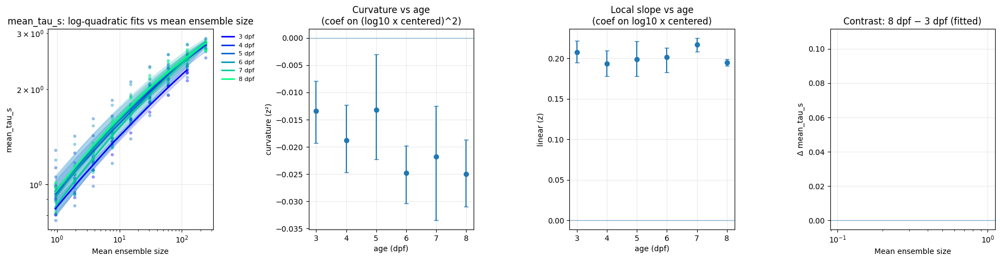

In [738]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.formula.api as smf

# ============================================================
# Quadratic fits for mean_tau_s vs MEAN ENSEMBLE SIZE (x_mean_size_gen)
# and plot on LOG–LOG axes (base 10).
#
# UPDATED: uses fish_id_col="id" as the TRUE unique fish identifier.
#   - fish-aggregation is by (id, age, x)
#   - bootstrap resamples fish IDs (id), not the "fish" string
# ============================================================

def prep_metric_for_logquad(
    df,
    metric="mean_tau_s",
    xcol="x_mean_size_gen",
    fish_id_col="id",      # <-- unique fish id
    age_col="age",
    min_obs_per_fish=3,
    Kmin=None
):
    cols = [fish_id_col, age_col, xcol, metric]
    if "fish" in df.columns:
        cols.append("fish")  # optional label
    if Kmin is not None and "n_clusters" in df.columns:
        cols.append("n_clusters")

    d = df[cols].copy()
    d[age_col] = pd.to_numeric(d[age_col], errors="coerce")
    d[xcol] = pd.to_numeric(d[xcol], errors="coerce")
    d[metric] = pd.to_numeric(d[metric], errors="coerce")
    d = d.dropna(subset=[fish_id_col, age_col, xcol, metric])

    if "fish" not in d.columns:
        d["fish"] = d[fish_id_col].astype(str)

    if Kmin is not None and "n_clusters" in d.columns:
        d["n_clusters"] = pd.to_numeric(d["n_clusters"], errors="coerce")
        d = d.dropna(subset=["n_clusters"])
        d = d[d["n_clusters"] >= Kmin].copy()

    # log–log requires positive
    d = d[(d[xcol] > 0) & (d[metric] > 0)].copy()

    # fish-aggregate at each x (by UNIQUE ID)
    d2 = (
        d.groupby([fish_id_col, "fish", age_col, xcol], as_index=False)
         .agg(y=(metric, "mean"))
    )

    # require enough points per fish (by UNIQUE ID)
    keep = d2.groupby(fish_id_col).size()
    keep = keep[keep >= min_obs_per_fish].index
    d2 = d2[d2[fish_id_col].isin(keep)].copy()

    return d2


def fit_log_quadratic_per_age(dd, xcol="x_mean_size_gen", fish_id_col="id", age_col="age"):
    """
    Fit: ly ~ z + z2 where z = (lx - lx0), lx=log10(x), ly=log10(y).
    Returns model + predictions on xgrid (original scale) + lx0.
    """
    d2 = dd.copy()
    d2["lx"] = np.log10(d2[xcol].to_numpy(float))
    d2["ly"] = np.log10(d2["y"].to_numpy(float))

    lx0 = float(d2["lx"].mean())  # per-age centering
    d2["z"]  = d2["lx"] - lx0
    d2["z2"] = d2["z"]**2

    m = smf.ols("ly ~ z + z2", d2).fit()

    xgrid = np.logspace(np.log10(d2[xcol].min()), np.log10(d2[xcol].max()), 200)
    lxg = np.log10(xgrid)
    zg = lxg - lx0
    lyp = m.predict(pd.DataFrame({"z": zg, "z2": zg**2}))
    ypred = 10**lyp

    curve = pd.DataFrame({xcol: xgrid, "pred": ypred})
    return m, curve, lx0


def bootstrap_logquad_curves_and_coeffs(
    dd,
    xcol="x_mean_size_gen",
    fish_id_col="id",     # <-- unique fish id
    n_boot=400,
    seed=0
):
    """
    Bootstrap across UNIQUE fish IDs within an age:
      - resample fish IDs with replacement
      - refit log-quadratic each time (with fixed centering lx0 from base fit)
    """
    rng = np.random.default_rng(seed)
    fish_ids = dd[fish_id_col].astype(str).unique()
    if len(fish_ids) < 2:
        return None, None

    m0, curve0, lx0 = fit_log_quadratic_per_age(dd, xcol=xcol, fish_id_col=fish_id_col)
    xgrid = curve0[xcol].to_numpy(float)
    lxg = np.log10(xgrid)
    zg = lxg - lx0

    preds = []
    b_list, c_list = [], []

    # pre-split for speed
    by_fish = {fid: dd[dd[fish_id_col].astype(str) == fid] for fid in fish_ids}

    for _ in range(n_boot):
        pick = rng.choice(fish_ids, size=len(fish_ids), replace=True)
        boot = pd.concat([by_fish[f] for f in pick], ignore_index=True)

        try:
            b2 = boot.copy()
            b2["lx"] = np.log10(b2[xcol].to_numpy(float))
            b2["ly"] = np.log10(b2["y"].to_numpy(float))
            b2["z"]  = b2["lx"] - lx0
            b2["z2"] = b2["z"]**2

            m = smf.ols("ly ~ z + z2", b2).fit()

            lyp = m.predict(pd.DataFrame({"z": zg, "z2": zg**2}))
            preds.append(10**lyp)

            b_list.append(m.params.get("z", np.nan))
            c_list.append(m.params.get("z2", np.nan))
        except Exception:
            continue

    preds = np.asarray(preds, float)
    b_arr = np.asarray(b_list, float)
    c_arr = np.asarray(c_list, float)

    if preds.ndim != 2 or preds.shape[0] < 30:
        return None, None

    def q(a, p): return np.nanpercentile(a, p, axis=0)

    curve_ci = pd.DataFrame({
        xcol: xgrid,
        "pred_med": q(preds, 50),
        "pred_lo":  q(preds, 2.5),
        "pred_hi":  q(preds, 97.5),
    })

    coeff_ci = {
        "b_lin_med": float(np.nanpercentile(b_arr, 50)),
        "b_lin_lo":  float(np.nanpercentile(b_arr, 2.5)),
        "b_lin_hi":  float(np.nanpercentile(b_arr, 97.5)),
        "c_quad_med": float(np.nanpercentile(c_arr, 50)),
        "c_quad_lo":  float(np.nanpercentile(c_arr, 2.5)),
        "c_quad_hi":  float(np.nanpercentile(c_arr, 97.5)),
        "n_fish": int(len(fish_ids)),
        "n_boot_ok": int(preds.shape[0]),
    }
    return curve_ci, coeff_ci


def plot_age_logquad_tau(
    df,
    metric="mean_tau_s",
    xcol="x_mean_size_gen",
    fish_id_col="id",   # <-- unique fish id
    age_col="age",
    n_boot=400,
    seed=0,
    min_fish=2,
    min_obs_per_fish=3,
    Kmin=50,
    winter=True,
    scatter_alpha=0.35,
    s_scatter=10,
    band_alpha=0.18,
):
    d = prep_metric_for_logquad(
        df, metric=metric, xcol=xcol,
        fish_id_col=fish_id_col, age_col=age_col,
        min_obs_per_fish=min_obs_per_fish, Kmin=Kmin
    )
    ages = np.sort(d[age_col].unique())

    fig, axes = plt.subplots(1, 4, figsize=(18.5, 4.9))
    ax_curve, ax_curv, ax_lin, ax_contrast = axes

    coeff_rows = []
    curves = {}

    cmap = plt.get_cmap("winter" if winter else "viridis", len(ages))

    # Panel A: raw scatter + fitted curves (log–log axes)
    for k, age in enumerate(ages):
        dd = d[d[age_col] == age].copy()
        if dd[fish_id_col].nunique() < min_fish:
            continue

        col = cmap(k)
        ax_curve.scatter(dd[xcol], dd["y"], s=s_scatter, alpha=scatter_alpha, color=col)

        curve_ci, coeff_ci = bootstrap_logquad_curves_and_coeffs(
            dd, xcol=xcol, fish_id_col=fish_id_col, n_boot=n_boot, seed=seed + int(age)*17
        )

        if curve_ci is None:
            m, curve, _ = fit_log_quadratic_per_age(dd, xcol=xcol, fish_id_col=fish_id_col)
            ax_curve.plot(curve[xcol], curve["pred"], linewidth=2, color=col, label=f"{int(age)} dpf")
            coeff_rows.append({
                "age": age,
                "b_lin_med": m.params.get("z", np.nan), "b_lin_lo": np.nan, "b_lin_hi": np.nan,
                "c_quad_med": m.params.get("z2", np.nan), "c_quad_lo": np.nan, "c_quad_hi": np.nan,
                "n_fish": int(dd[fish_id_col].nunique()), "n_boot_ok": 0
            })
            curves[age] = curve.rename(columns={"pred": "pred_med"})[[xcol, "pred_med"]]
        else:
            ax_curve.plot(curve_ci[xcol], curve_ci["pred_med"], linewidth=2, color=col, label=f"{int(age)} dpf")
            ax_curve.fill_between(curve_ci[xcol], curve_ci["pred_lo"], curve_ci["pred_hi"],
                                  alpha=band_alpha, color=col)
            coeff_rows.append({"age": age, **coeff_ci})
            curves[age] = curve_ci[[xcol, "pred_med"]].copy()

    ax_curve.set_xscale("log", base=10)
    ax_curve.set_yscale("log", base=10)
    ax_curve.set_title(f"{metric}: log-quadratic fits vs mean ensemble size")
    ax_curve.set_xlabel("Mean ensemble size")
    ax_curve.set_ylabel(metric)
    ax_curve.grid(True, alpha=0.25)
    ax_curve.legend(frameon=False, fontsize=8, bbox_to_anchor=(1.02, 1), loc="upper left")

    # Panel B: curvature vs age (coef on z^2)
    coeffs = pd.DataFrame(coeff_rows).sort_values("age")
    ax_curv.errorbar(
        coeffs["age"], coeffs["c_quad_med"],
        yerr=[coeffs["c_quad_med"] - coeffs["c_quad_lo"], coeffs["c_quad_hi"] - coeffs["c_quad_med"]],
        fmt="o", capsize=3
    )
    ax_curv.axhline(0, linewidth=1, alpha=0.5)
    ax_curv.set_title("Curvature vs age\n(coef on (log10 x centered)^2)")
    ax_curv.set_xlabel("age (dpf)")
    ax_curv.set_ylabel("curvature (z²)")
    ax_curv.grid(True, alpha=0.25)

    # Panel C: linear term vs age (coef on z)
    ax_lin.errorbar(
        coeffs["age"], coeffs["b_lin_med"],
        yerr=[coeffs["b_lin_med"] - coeffs["b_lin_lo"], coeffs["b_lin_hi"] - coeffs["b_lin_med"]],
        fmt="o", capsize=3
    )
    ax_lin.axhline(0, linewidth=1, alpha=0.5)
    ax_lin.set_title("Local slope vs age\n(coef on log10 x centered)")
    ax_lin.set_xlabel("age (dpf)")
    ax_lin.set_ylabel("linear (z)")
    ax_lin.grid(True, alpha=0.25)

    # Panel D: contrast oldest - youngest (fitted)
    avail = sorted(curves.keys())
    if len(avail) >= 2:
        a0, a1 = avail[0], avail[-1]
        c0, c1 = curves[a0], curves[a1]
        mrg = pd.merge(c1, c0, on=xcol, suffixes=("_old", "_young"))
        diff = mrg["pred_med_old"] - mrg["pred_med_young"]
        ax_contrast.plot(mrg[xcol], diff, linewidth=2.2)
        ax_contrast.axhline(0, linewidth=1, alpha=0.5)
        ax_contrast.set_xscale("log", base=10)
        ax_contrast.set_title(f"Contrast: {int(a1)} dpf − {int(a0)} dpf (fitted)")
        ax_contrast.set_xlabel("Mean ensemble size")
        ax_contrast.set_ylabel(f"Δ {metric}")
        ax_contrast.grid(True, alpha=0.25)
    else:
        ax_contrast.axis("off")

    plt.tight_layout()
    plt.show()
    return coeffs


# -----------------------------
# Example usage
# -----------------------------
coeffs_tau = plot_age_logquad_tau(
    df3, metric="mean_tau_s", xcol="x_mean_size_gen",
    fish_id_col="id", age_col="age",
    n_boot=400, seed=0, Kmin=50, winter=True
)


In [739]:
import numpy as np
import pandas as pd
import statsmodels.formula.api as smf

# ------------------------------------------------------------
# Helpers: robust shared x-range across ages (optional)
#   UPDATED: uses age_col and works regardless of fish id choice
# ------------------------------------------------------------
def common_x_range_by_age(d, xcol="x_mean_size_gen", age_col="age", q_lo=0.05, q_hi=0.95):
    ages = np.sort(pd.Series(d[age_col]).dropna().unique())
    lo_list, hi_list = [], []
    for a in ages:
        x = d.loc[d[age_col] == a, xcol].to_numpy(float)
        if len(x) == 0:
            continue
        lo_list.append(np.quantile(x, q_lo))
        hi_list.append(np.quantile(x, q_hi))
    if len(lo_list) == 0:
        return None
    x_lo = max(lo_list)
    x_hi = min(hi_list)
    if not (x_lo < x_hi):
        return None
    return float(x_lo), float(x_hi)


# ------------------------------------------------------------
# Prep for pooled interaction model
#   UPDATED: uses fish_id_col="id" as the TRUE unique fish key
# ------------------------------------------------------------
def prep_for_interaction_model(
    df,
    metric,
    xcol="x_mean_size_gen",
    fish_id_col="id",        # <-- unique fish id
    age_col="age",
    Kmin=50,
    min_obs_per_fish=3,
    restrict_shared_x=True,
    q_lo=0.05,
    q_hi=0.95,
    fish_aggregate=True,     # keep convention: (fish_id,age,x)->mean(y)
):
    cols = [fish_id_col, age_col, xcol, metric]
    if "fish" in df.columns:
        cols.append("fish")  # optional display label
    if Kmin is not None and "n_clusters" in df.columns:
        cols.append("n_clusters")

    d = df[cols].copy()
    d[age_col] = pd.to_numeric(d[age_col], errors="coerce")
    d[xcol] = pd.to_numeric(d[xcol], errors="coerce")
    d[metric] = pd.to_numeric(d[metric], errors="coerce")
    d = d.dropna(subset=[fish_id_col, age_col, xcol, metric])

    if "fish" not in d.columns:
        d["fish"] = d[fish_id_col].astype(str)

    if Kmin is not None and "n_clusters" in d.columns:
        d["n_clusters"] = pd.to_numeric(d["n_clusters"], errors="coerce")
        d = d.dropna(subset=["n_clusters"])
        d = d[d["n_clusters"] >= Kmin].copy()

    # log–log requires positive
    d = d[(d[xcol] > 0) & (d[metric] > 0)].copy()

    # fish aggregate to avoid duplicate x values / overweighting
    if fish_aggregate:
        d = (
            d.groupby([fish_id_col, "fish", age_col, xcol], as_index=False)
             .agg(y=(metric, "mean"))
        )
    else:
        d = d.rename(columns={metric: "y"})

    # require enough points per fish (by UNIQUE id)
    keep = d.groupby(fish_id_col).size()
    keep = keep[keep >= min_obs_per_fish].index
    d = d[d[fish_id_col].isin(keep)].copy()

    # optional shared x-range (reduces tail artifacts)
    if restrict_shared_x:
        xr = common_x_range_by_age(d, xcol=xcol, age_col=age_col, q_lo=q_lo, q_hi=q_hi)
        if xr is not None:
            x_lo, x_hi = xr
            d = d[(d[xcol] >= x_lo) & (d[xcol] <= x_hi)].copy()

    # build log variables
    d["lx"] = np.log10(d[xcol].to_numpy(float))
    d["ly"] = np.log10(d["y"].to_numpy(float))

    # center lx to reduce collinearity (recommended if adding curvature)
    d["lx_c"] = d["lx"] - d["lx"].mean()

    # center age
    d["age_c"] = d[age_col] - d[age_col].mean()

    # cluster key
    d["_cluster_fish"] = d[fish_id_col].astype(str)

    return d


# ------------------------------------------------------------
# Main tests
#   UPDATED: cluster-robust SEs grouped by unique fish id
# ------------------------------------------------------------
def test_age_effects_interaction(
    df,
    metric,
    xcol="x_mean_size_gen",
    fish_id_col="id",
    age_col="age",
    Kmin=50,
    min_obs_per_fish=3,
    restrict_shared_x=True,
    q_lo=0.05,
    q_hi=0.95,
    include_curvature=False,   # add lx^2 and age interactions
    fish_aggregate=True,
):
    d = prep_for_interaction_model(
        df, metric, xcol=xcol,
        fish_id_col=fish_id_col, age_col=age_col,
        Kmin=Kmin, min_obs_per_fish=min_obs_per_fish,
        restrict_shared_x=restrict_shared_x, q_lo=q_lo, q_hi=q_hi,
        fish_aggregate=fish_aggregate
    )

    # base: log–log line with age amplitude + age×slope
    if not include_curvature:
        formula = "ly ~ lx_c + age_c + lx_c:age_c"
        m = smf.ols(formula, data=d).fit(
            cov_type="cluster", cov_kwds={"groups": d["_cluster_fish"]}
        )

        return {
            "metric": metric,
            "n_fish": int(d["_cluster_fish"].nunique()),
            "n_points": int(len(d)),
            "beta_age_amp": float(m.params.get("age_c", np.nan)),
            "p_age_amp": float(m.pvalues.get("age_c", np.nan)),
            "beta_age_slope": float(m.params.get("lx_c:age_c", np.nan)),
            "p_age_slope": float(m.pvalues.get("lx_c:age_c", np.nan)),
            "model": m,
            "data_used": d,
        }

    # extended: log-quadratic with age effects on amplitude, slope, curvature
    d["lx2_c"] = d["lx_c"] ** 2
    formula = "ly ~ lx_c + lx2_c + age_c + age_c:lx_c + age_c:lx2_c"
    m = smf.ols(formula, data=d).fit(
        cov_type="cluster", cov_kwds={"groups": d["_cluster_fish"]}
    )

    return {
        "metric": metric,
        "n_fish": int(d["_cluster_fish"].nunique()),
        "n_points": int(len(d)),
        "beta_age_amp": float(m.params.get("age_c", np.nan)),
        "p_age_amp": float(m.pvalues.get("age_c", np.nan)),
        "beta_age_slope": float(m.params.get("age_c:lx_c", np.nan)),
        "p_age_slope": float(m.pvalues.get("age_c:lx_c", np.nan)),
        "beta_age_curv": float(m.params.get("age_c:lx2_c", np.nan)),
        "p_age_curv": float(m.pvalues.get("age_c:lx2_c", np.nan)),
        "model": m,
        "data_used": d,
    }


# ------------------------------------------------------------
# Example runs
# ------------------------------------------------------------
res_kurt = test_age_effects_interaction(df3, "kurtosis_corr", Kmin=50, include_curvature=False, fish_id_col="id")
res_var  = test_age_effects_interaction(df3, "mean_var",      Kmin=50, include_curvature=False, fish_id_col="id")

print("Kurtosis:",
      "amp beta,p =", res_kurt["beta_age_amp"], res_kurt["p_age_amp"],
      "| slope beta,p =", res_kurt["beta_age_slope"], res_kurt["p_age_slope"])

print("Mean_var:",
      "amp beta,p =", res_var["beta_age_amp"], res_var["p_age_amp"],
      "| slope beta,p =", res_var["beta_age_slope"], res_var["p_age_slope"])

# If you want curvature too:
res_tau_curv = test_age_effects_interaction(df3, "mean_tau_s", Kmin=50, include_curvature=True, fish_id_col="id")
print("Tau (log-quadratic):",
      "amp p =", res_tau_curv["p_age_amp"],
      "| slope p =", res_tau_curv["p_age_slope"],
      "| curvature p =", res_tau_curv["p_age_curv"])

# Optional: full summaries
# print(res_kurt["model"].summary())
# print(res_tau_curv["model"].summary())


Kurtosis: amp beta,p = -0.03457858907627929 0.0025917196046999907 | slope beta,p = 0.0009135508226315045 0.8455827919433949
Mean_var: amp beta,p = 0.00992973517009354 0.4899203952694492 | slope beta,p = 0.004181788860182577 0.26871620743831437
Tau (log-quadratic): amp p = 0.0224076642592437 | slope p = 0.23451894040731658 | curvature p = 0.32539887990062133


In [ ]:
out_dir = os.path.join(fdata, "icg_npy")
os.makedirs(out_dir, exist_ok=True)

for p in tqdm(dff_l):
    dff = np.load(p)  # (N,T)

    generations, labels_by_gen, mean_traces_by_gen, sizes_by_gen = icg_greedy_fast(
        dff, n_gen=14, eps=1e-6, keep_singletons=True, return_gen0=True, verbose=False
    )

    payload = {
        "generations": generations,                      # (G,)
        "labels_by_gen": np.array(labels_by_gen, object),# object array, len=G, each (N,)
        "mean_traces_by_gen": np.array(mean_traces_by_gen, object),  # len=G, each (K_g,T)
        "sizes_by_gen": np.array(sizes_by_gen, object),  # len=G, each (K_g,)
        "source_path": p,
    }

    base = os.path.basename(p).replace(".npy", "")
    out_path = os.path.join(out_dir, base + "_icg_greedy.npy")

    # IMPORTANT: allow_pickle=True needed to load these later because object arrays
    np.save(out_path, payload, allow_pickle=True)

    del dff

print("Saved ICG .npy payloads to:", out_dir)

In [741]:
labels_by_gen

[array([    0,     1,     2, ..., 15102, 15103, 15104], dtype=int32),
 array([   0,    1,    2, ..., 7287, 6995, 6468], dtype=int32)]

In [ ]:
#null models - is this an emergent property of cell-cell coordination, or artefacts of data statistics

#independent temporal shuffling - can independent bin firing cause changes

#independent circular permutation - can independent autocorrelation drive changes

#dependent temporal shuffling - can correlations, wo. autocorrelation drive changes

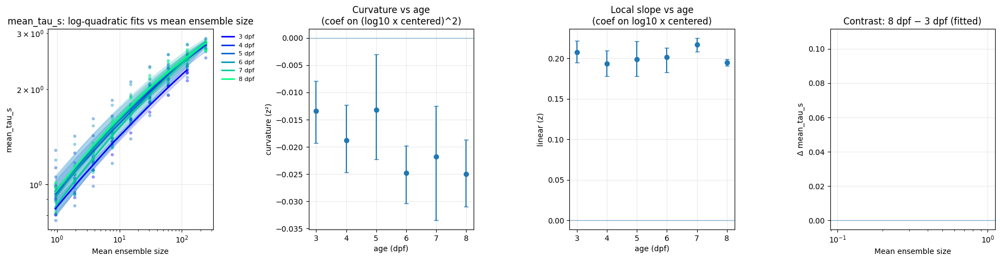

In [708]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.formula.api as smf

# ============================================================
# Quadratic fits for mean_tau_s vs MEAN ENSEMBLE SIZE (x_mean_size_gen)
# and plot on LOG–LOG axes (base 10).
#
# NOTE: This is still a "quadratic" in log-space:
#   ly = a + b*lx + c*lx^2
# which is the sensible analogue when you want log–log plotting.
#
# Panels:
# (A) scatter + per-age quadratic-in-log fit + bootstrap CI ribbon
# (B) curvature c (coef on lx^2) vs age + CI
# (C) slope-at-reference b (coef on lx) vs age + CI
# (D) contrast curve: oldest - youngest (fitted) on original y scale
# ============================================================

def prep_metric_for_logquad(df, metric="mean_tau_s", xcol="x_mean_size_gen",
                            min_obs_per_fish=3, Kmin=None):
    cols = ["fish", "age", xcol, metric]
    if Kmin is not None and "n_clusters" in df.columns:
        cols += ["n_clusters"]

    d = df[cols].copy()
    d["age"] = pd.to_numeric(d["age"], errors="coerce")
    d[xcol] = pd.to_numeric(d[xcol], errors="coerce")
    d[metric] = pd.to_numeric(d[metric], errors="coerce")
    d = d.dropna(subset=["fish", "age", xcol, metric])

    if Kmin is not None and "n_clusters" in d.columns:
        d["n_clusters"] = pd.to_numeric(d["n_clusters"], errors="coerce")
        d = d.dropna(subset=["n_clusters"])
        d = d[d["n_clusters"] >= Kmin].copy()

    # log–log requires positive
    d = d[(d[xcol] > 0) & (d[metric] > 0)].copy()

    # fish-aggregate at each x
    d2 = d.groupby(["fish", "age", xcol], as_index=False).agg(y=(metric, "mean"))

    # require enough points per fish
    keep = d2.groupby("fish").size()
    keep = keep[keep >= min_obs_per_fish].index
    d2 = d2[d2["fish"].isin(keep)].copy()
    return d2


def fit_log_quadratic_per_age(dd, xcol="x_mean_size_gen"):
    """
    Fit: ly ~ z + z2 where z = (lx - lx0), lx=log10(x), ly=log10(y).
    Returns model + predictions on xgrid (in original scale) + lx0.
    """
    d2 = dd.copy()
    d2["lx"] = np.log10(d2[xcol].to_numpy(float))
    d2["ly"] = np.log10(d2["y"].to_numpy(float))

    lx0 = float(d2["lx"].mean())
    d2["z"]  = d2["lx"] - lx0
    d2["z2"] = d2["z"]**2

    m = smf.ols("ly ~ z + z2", d2).fit()

    xgrid = np.logspace(np.log10(d2[xcol].min()), np.log10(d2[xcol].max()), 200)
    lxg = np.log10(xgrid)
    zg = lxg - lx0
    lyp = m.predict(pd.DataFrame({"z": zg, "z2": zg**2}))
    ypred = 10**lyp

    curve = pd.DataFrame({xcol: xgrid, "pred": ypred})
    return m, curve, lx0


def bootstrap_logquad_curves_and_coeffs(dd, xcol="x_mean_size_gen", n_boot=400, seed=0):
    """
    Bootstrap across fish within an age:
      - resample fish IDs with replacement
      - refit log-quadratic each time (with fixed centering lx0 from base fit)
    Returns:
      curve_ci: x, pred_med, pred_lo, pred_hi (original y scale)
      coeff_ci: dict with b_lin (z) and c_quad (z2) in log space + CI
    """
    rng = np.random.default_rng(seed)
    fish_ids = dd["fish"].unique()
    if len(fish_ids) < 2:
        return None, None

    m0, curve0, lx0 = fit_log_quadratic_per_age(dd, xcol=xcol)
    xgrid = curve0[xcol].to_numpy(float)
    lxg = np.log10(xgrid)
    zg = lxg - lx0

    preds = []
    b_list, c_list = [], []

    for _ in range(n_boot):
        pick = rng.choice(fish_ids, size=len(fish_ids), replace=True)
        boot = pd.concat([dd[dd["fish"] == f] for f in pick], ignore_index=True)

        try:
            b2 = boot.copy()
            b2["lx"] = np.log10(b2[xcol].to_numpy(float))
            b2["ly"] = np.log10(b2["y"].to_numpy(float))
            b2["z"]  = b2["lx"] - lx0
            b2["z2"] = b2["z"]**2

            m = smf.ols("ly ~ z + z2", b2).fit()

            lyp = m.predict(pd.DataFrame({"z": zg, "z2": zg**2}))
            preds.append(10**lyp)

            b_list.append(m.params.get("z", np.nan))
            c_list.append(m.params.get("z2", np.nan))
        except Exception:
            continue

    preds = np.asarray(preds, float)
    b_arr = np.asarray(b_list, float)
    c_arr = np.asarray(c_list, float)

    if preds.ndim != 2 or preds.shape[0] < 30:
        return None, None

    def q(a, p): return np.nanpercentile(a, p, axis=0)

    curve_ci = pd.DataFrame({
        xcol: xgrid,
        "pred_med": q(preds, 50),
        "pred_lo":  q(preds, 2.5),
        "pred_hi":  q(preds, 97.5),
    })

    coeff_ci = {
        "b_lin_med": float(np.nanpercentile(b_arr, 50)),
        "b_lin_lo":  float(np.nanpercentile(b_arr, 2.5)),
        "b_lin_hi":  float(np.nanpercentile(b_arr, 97.5)),
        "c_quad_med": float(np.nanpercentile(c_arr, 50)),
        "c_quad_lo":  float(np.nanpercentile(c_arr, 2.5)),
        "c_quad_hi":  float(np.nanpercentile(c_arr, 97.5)),
        "n_fish": int(len(fish_ids)),
        "n_boot_ok": int(preds.shape[0]),
    }
    return curve_ci, coeff_ci


def plot_age_logquad_tau(
    df,
    metric="mean_tau_s",
    xcol="x_mean_size_gen",
    n_boot=400,
    seed=0,
    min_fish=2,
    min_obs_per_fish=3,
    Kmin=50,
    winter=True,
    scatter_alpha=0.35,
    s_scatter=10,
    band_alpha=0.18,
):
    d = prep_metric_for_logquad(df, metric=metric, xcol=xcol,
                                min_obs_per_fish=min_obs_per_fish, Kmin=Kmin)
    ages = np.sort(d["age"].unique())

    fig, axes = plt.subplots(1, 4, figsize=(18.5, 4.9))
    ax_curve, ax_curv, ax_lin, ax_contrast = axes

    coeff_rows = []
    curves = {}

    cmap = plt.get_cmap("winter" if winter else "viridis", len(ages))

    # Panel A: raw scatter + fitted curves (log–log axes)
    for k, age in enumerate(ages):
        dd = d[d["age"] == age].copy()
        if dd["fish"].nunique() < min_fish:
            continue

        col = cmap(k)
        ax_curve.scatter(dd[xcol], dd["y"], s=s_scatter, alpha=scatter_alpha, color=col)

        curve_ci, coeff_ci = bootstrap_logquad_curves_and_coeffs(
            dd, xcol=xcol, n_boot=n_boot, seed=seed + int(age)*17
        )

        if curve_ci is None:
            # fallback: fit without CI
            m, curve, _ = fit_log_quadratic_per_age(dd, xcol=xcol)
            ax_curve.plot(curve[xcol], curve["pred"], linewidth=2, color=col, label=f"{int(age)} dpf")
            coeff_rows.append({
                "age": age,
                "b_lin_med": m.params.get("z", np.nan), "b_lin_lo": np.nan, "b_lin_hi": np.nan,
                "c_quad_med": m.params.get("z2", np.nan), "c_quad_lo": np.nan, "c_quad_hi": np.nan,
                "n_fish": dd["fish"].nunique(), "n_boot_ok": 0
            })
            curves[age] = curve.rename(columns={"pred": "pred_med"})[[xcol, "pred_med"]]
        else:
            ax_curve.plot(curve_ci[xcol], curve_ci["pred_med"], linewidth=2, color=col, label=f"{int(age)} dpf")
            ax_curve.fill_between(curve_ci[xcol], curve_ci["pred_lo"], curve_ci["pred_hi"], alpha=band_alpha, color=col)
            coeff_rows.append({"age": age, **coeff_ci})
            curves[age] = curve_ci[[xcol, "pred_med"]].copy()

    ax_curve.set_xscale("log", base=10)
    ax_curve.set_yscale("log", base=10)
    ax_curve.set_title(f"{metric}: log-quadratic fits vs mean ensemble size")
    ax_curve.set_xlabel("Mean ensemble size")
    ax_curve.set_ylabel(metric)
    ax_curve.grid(True, alpha=0.25)
    ax_curve.legend(frameon=False, fontsize=8, bbox_to_anchor=(1.02, 1), loc="upper left")

    # Panel B: curvature vs age (coef on z^2)
    coeffs = pd.DataFrame(coeff_rows).sort_values("age")
    ax_curv.errorbar(
        coeffs["age"], coeffs["c_quad_med"],
        yerr=[coeffs["c_quad_med"] - coeffs["c_quad_lo"], coeffs["c_quad_hi"] - coeffs["c_quad_med"]],
        fmt="o", capsize=3
    )
    ax_curv.axhline(0, linewidth=1, alpha=0.5)
    ax_curv.set_title("Curvature vs age\n(coef on (log10 x centered)^2)")
    ax_curv.set_xlabel("age (dpf)")
    ax_curv.set_ylabel("curvature (z²)")
    ax_curv.grid(True, alpha=0.25)

    # Panel C: linear term vs age (coef on z)
    ax_lin.errorbar(
        coeffs["age"], coeffs["b_lin_med"],
        yerr=[coeffs["b_lin_med"] - coeffs["b_lin_lo"], coeffs["b_lin_hi"] - coeffs["b_lin_med"]],
        fmt="o", capsize=3
    )
    ax_lin.axhline(0, linewidth=1, alpha=0.5)
    ax_lin.set_title("Local slope vs age\n(coef on log10 x centered)")
    ax_lin.set_xlabel("age (dpf)")
    ax_lin.set_ylabel("linear (z)")
    ax_lin.grid(True, alpha=0.25)

    # Panel D: contrast oldest - youngest (fitted)
    avail = sorted(curves.keys())
    if len(avail) >= 2:
        a0, a1 = avail[0], avail[-1]
        c0, c1 = curves[a0], curves[a1]
        mrg = pd.merge(c1, c0, on=xcol, suffixes=("_old", "_young"))
        diff = mrg["pred_med_old"] - mrg["pred_med_young"]
        ax_contrast.plot(mrg[xcol], diff, linewidth=2.2)
        ax_contrast.axhline(0, linewidth=1, alpha=0.5)
        ax_contrast.set_xscale("log", base=10)
        ax_contrast.set_title(f"Contrast: {int(a1)} dpf − {int(a0)} dpf (fitted)")
        ax_contrast.set_xlabel("Mean ensemble size")
        ax_contrast.set_ylabel(f"Δ {metric}")
        ax_contrast.grid(True, alpha=0.25)
    else:
        ax_contrast.axis("off")

    plt.tight_layout()
    plt.show()
    return coeffs


# -----------------------------
# Example usage (needs df3 with x_mean_size_gen)
# -----------------------------
coeffs_tau = plot_age_logquad_tau(df3, metric="mean_tau_s", xcol="x_mean_size_gen",
                                  n_boot=400, seed=0, Kmin=50, winter=True)

In [744]:
import os, re
import numpy as np
import pandas as pd
from tqdm import tqdm

# ----------------------------
# Your stats helpers (assumed already defined in your notebook)
#   kurtosis_plain
#   corr_offdiag_vals
#   timescale_from_mean_autocorr
# ----------------------------

# -------------------------
# filename parsers (edit if needed)
# -------------------------
def parse_fish_id(path: str) -> str:
    base = os.path.basename(path)
    m = re.search(r"(BLNDEV-WILDTYPE-\d+)", base)
    return m.group(1) if m else base.split("_")[0]

def parse_age_dpf(path: str) -> int:
    base = os.path.basename(path)
    m = re.search(r"(\d+)\s*dpf", base, flags=re.IGNORECASE) or re.search(r"(\d+)dpf", base, flags=re.IGNORECASE)
    return int(m.group(1)) if m else np.nan

# -------------------------
# null models
# -------------------------
def null_independent_temporal_shuffle(dff: np.ndarray, rng: np.random.Generator) -> np.ndarray:
    """Each cell independently permutes time (kills autocorr + cross-corr)."""
    N, T = dff.shape
    out = np.empty_like(dff)
    for i in range(N):
        out[i] = dff[i, rng.permutation(T)]
    return out

def null_independent_circular_permutation(dff: np.ndarray, rng: np.random.Generator) -> np.ndarray:
    """Each cell independently circularly shifts time (preserves autocorr, kills cross-corr)."""
    N, T = dff.shape
    out = np.empty_like(dff)
    shifts = rng.integers(0, T, size=N)
    for i, s in enumerate(shifts):
        out[i] = np.roll(dff[i], int(s))
    return out

def null_dependent_temporal_shuffle(dff: np.ndarray, rng: np.random.Generator) -> np.ndarray:
    """All cells share the same time permutation (preserves cross-corr, kills autocorr)."""
    T = dff.shape[1]
    perm = rng.permutation(T)
    return dff[:, perm].copy()

# -------------------------
# compute per-generation summary metrics using YOUR helpers
# -------------------------
def summarise_generation_metrics(
    mean_traces: np.ndarray,   # (K_g, T)
    dt_s: float,
    tau_max_lag_s: float = 3.0,
    tau_dt_s: None = None,
    corr_max_units: int = 2000,
    seed: int = 0
):
    """
    Returns:
      kurtosis_corr: kurtosis of off-diagonal corr distribution across mean_traces
      mean_tau_s:    AUC of mean autocorr curve (paper-matching) in seconds
    """
    K, T = mean_traces.shape
    if K < 2 or T < 5:
        return np.nan, np.nan

    # correlations among cluster mean traces
    corr_vals = corr_offdiag_vals(mean_traces, max_units=corr_max_units, seed=seed)
    kurt = kurtosis_plain(corr_vals)

    # autocorr timescale (paper style)
    # timescale_from_mean_autocorr expects dt in seconds, max_lag in seconds.
    tau_dt = dt_s if tau_dt_s is None else float(tau_dt_s)
    tau = timescale_from_mean_autocorr(mean_traces, max_lag=float(tau_max_lag_s), dt=tau_dt)

    return kurt, tau

# -------------------------
# main runner
# -------------------------
def run_icg_nulls_to_df(
    dff_paths,
    n_gen=14,
    n_sims=10,
    dt_s=1/2.73,              # sampling interval in seconds
    tau_max_lag_s=3.0,         # match your paper function default
    Kmin_clusters=None,        # optionally drop generations with tiny K_g
    corr_max_units=2000,       # used by corr_offdiag_vals
    seed=0,
    eps=1e-6,
    out_csv=None
):
    """
    Requires icg_greedy_fast(dff, ...) already defined.

    Output rows:
      fish, age, id, null, sim, gen, n_cells, n_clusters, mean_ensemble_size,
      kurtosis_corr, mean_tau_s, source_path
    """
    rng_master = np.random.default_rng(seed)

    null_kinds = [
        ("real", None),
        ("indep_shuffle", null_independent_temporal_shuffle),
        ("indep_circperm", null_independent_circular_permutation),
        ("dep_shuffle", null_dependent_temporal_shuffle),
    ]

    rows = []

    for p in tqdm(dff_paths, desc="Fish"):
        dff0 = np.load(p)  # (N,T)
        N, T = dff0.shape

        fish = parse_fish_id(p)
        age = parse_age_dpf(p)
        fish_uid = f"{fish}_{int(age) if np.isfinite(age) else 'NA'}"

        for null_name, null_fn in null_kinds:
            sims = 1 if null_name == "real" else int(n_sims)

            for sim in range(sims):
                rng = np.random.default_rng(rng_master.integers(0, 2**32 - 1))

                if null_fn is None:
                    dff = dff0
                else:
                    dff = null_fn(dff0, rng)

                generations, labels_by_gen, mean_traces_by_gen, sizes_by_gen = icg_greedy_fast(
                    dff,
                    n_gen=n_gen,
                    eps=eps,
                    keep_singletons=True,
                    return_gen0=True,
                    verbose=False
                )

                # per generation summary
                for gi, g in enumerate(generations):
                    mt = mean_traces_by_gen[gi]  # (K_g, T)
                    Kg = int(mt.shape[0])

                    if Kmin_clusters is not None and Kg < int(Kmin_clusters):
                        continue

                    # use your helper-driven metrics
                    local_seed = int(rng.integers(0, 2**32 - 1))
                    kurt, tau = summarise_generation_metrics(
                        mt,
                        dt_s=dt_s,
                        tau_max_lag_s=tau_max_lag_s,
                        corr_max_units=corr_max_units,
                        seed=local_seed
                    )

                    rows.append({
                        "fish": fish,
                        "age": int(age) if np.isfinite(age) else np.nan,
                        "id": fish_uid,
                        "null": null_name,
                        "sim": int(sim),
                        "gen": int(g),
                        "n_cells": int(N),
                        "n_clusters": Kg,
                        "mean_ensemble_size": float(N / max(Kg, 1)),
                        "x_mean_size_gen": float(N / max(Kg, 1)),  # keep your xcol name consistent
                        "kurtosis_corr": float(kurt) if np.isfinite(kurt) else np.nan,
                        "mean_tau_s": float(tau) if np.isfinite(tau) else np.nan,
                        "source_path": p,
                    })

                if null_fn is not None:
                    del dff

        del dff0

    df_out = pd.DataFrame(rows)

    if out_csv is not None:
        os.makedirs(os.path.dirname(out_csv), exist_ok=True)
        df_out.to_csv(out_csv, index=False)

    return df_out


# -------------------------
# Example usage
# -------------------------
out_csv = os.path.join(fdata, "icg_null_summary_from_helpers.csv")
df_null = run_icg_nulls_to_df(
    dff_l,
    n_gen=14,
    n_sims=10,
    dt_s=1/2.73,
    tau_max_lag_s=3.0,
    Kmin_clusters=None,
    corr_max_units=2000,
    seed=0,
    eps=1e-6,
    out_csv=out_csv
)
# print(df_null.head())
# print("Saved:", out_csv)

Fish:   0%|                                        | 0/30 [00:00<?, ?it/s]/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/2545415865.py:140: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  tau = np.trapz(ac_use, t)  # area under curve in seconds
Fish: 100%|████████████████████████████| 30/30 [1:36:40<00:00, 193.35s/it]


In [745]:
df_null

,fish,age,id,null,sim,gen,n_cells,n_clusters,mean_ensemble_size,x_mean_size_gen,kurtosis_corr,mean_tau_s,source_path
0,BLNDEV-WILDTYPE-01,4,BLNDEV-WILDTYPE-01_4,real,0,0,15105,15105,1.000000,1.000000,10.594600,0.694566,/Users/k2585057/Library/CloudStorage/Dropbox/P...
1,BLNDEV-WILDTYPE-01,4,BLNDEV-WILDTYPE-01_4,real,0,1,15105,7553,1.999868,1.999868,7.332875,0.811703,/Users/k2585057/Library/CloudStorage/Dropbox/P...
2,BLNDEV-WILDTYPE-01,4,BLNDEV-WILDTYPE-01_4,real,0,2,15105,3777,3.999206,3.999206,6.117031,0.983104,/Users/k2585057/Library/CloudStorage/Dropbox/P...
3,BLNDEV-WILDTYPE-01,4,BLNDEV-WILDTYPE-01_4,real,0,3,15105,1889,7.996294,7.996294,4.751653,1.209666,/Users/k2585057/Library/CloudStorage/Dropbox/P...
4,BLNDEV-WILDTYPE-01,4,BLNDEV-WILDTYPE-01_4,real,0,4,15105,945,15.984127,15.984127,3.899253,1.478070,/Users/k2585057/Library/CloudStorage/Dropbox/P...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
13945,BLNDEV-WILDTYPE-08,8,BLNDEV-WILDTYPE-08_8,dep_shuffle,9,10,13323,14,951.642857,951.642857,1.686267,0.186457,/Users/k2585057/Library/CloudStorage/Dropbox/P...
13946,BLNDEV-WILDTYPE-08,8,BLNDEV-WILDTYPE-08_8,dep_shuffle,9,11,13323,7,1903.285714,1903.285714,1.381120,0.185974,/Users/k2585057/Library/CloudStorage/Dropbox/P...
13947,BLNDEV-WILDTYPE-08,8,BLNDEV-WILDTYPE-08_8,dep_shuffle,9,12,13323,4,3330.750000,3330.750000,NaN,0.187567,/Users/k2585057/Library/CloudStorage/Dropbox/P...
13948,BLNDEV-WILDTYPE-08,8,BLNDEV-WILDTYPE-08_8,dep_shuffle,9,13,13323,2,6661.500000,6661.500000,NaN,0.186354,/Users/k2585057/Library/CloudStorage/Dropbox/P...


/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/3228004497.py:17: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  out = g.apply(lambda sub: pd.Series({


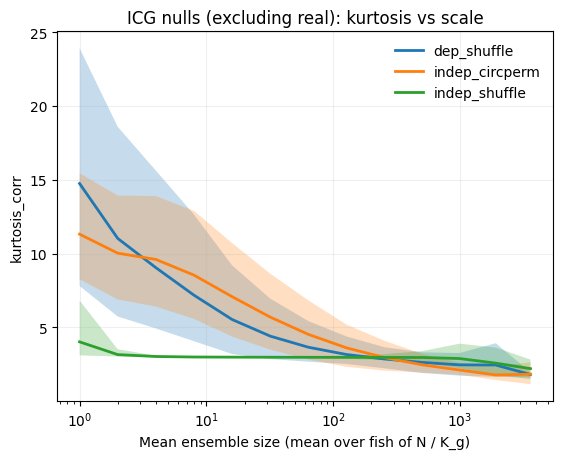

/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/3228004497.py:17: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  out = g.apply(lambda sub: pd.Series({


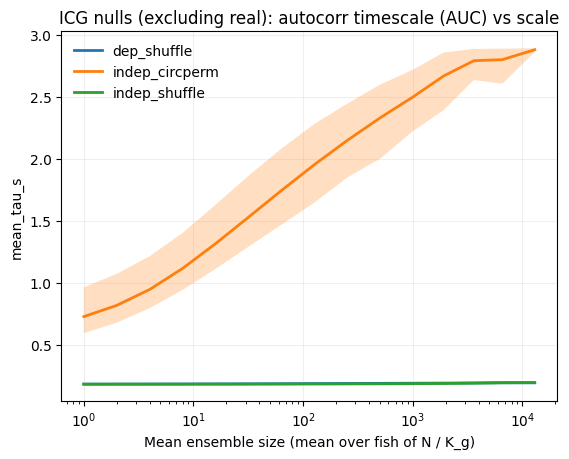

In [748]:
import numpy as np
import matplotlib.pyplot as plt

def _agg_mean_by_gen(
    df, ycol, xcol="x_mean_size_gen", group_cols=("null", "gen"),
    q_lo=0.05, q_hi=0.95, min_n=3
):
    """
    Aggregate within each (null, gen) across fish (and sims):
      x_mean: mean x at that generation
      y_mean: mean y at that generation
      y_lo/y_hi: quantile band of y at that generation
      n: count
    """
    g = df.groupby(list(group_cols), dropna=True)

    out = g.apply(lambda sub: pd.Series({
        "x_mean": np.nanmean(sub[xcol].to_numpy(float)),
        "y_mean": np.nanmean(sub[ycol].to_numpy(float)),
        "y_lo":   np.nanquantile(sub[ycol].to_numpy(float), q_lo),
        "y_hi":   np.nanquantile(sub[ycol].to_numpy(float), q_hi),
        "n":      np.isfinite(sub[ycol].to_numpy(float)).sum(),
    })).reset_index()

    out = out[out["n"] >= min_n].copy()
    return out

def plot_metric_mean_per_gen_with_band(
    df, ycol, xcol="x_mean_size_gen", title=None,
    q_lo=0.05, q_hi=0.95, min_n=3, logx=True, ax=None
):
    if ax is None:
        fig, ax = plt.subplots()

    # drop real
    dfp = df[df["null"] != "real"].copy()

    agg = _agg_mean_by_gen(
        dfp, ycol=ycol, xcol=xcol,
        group_cols=("null", "gen"),
        q_lo=q_lo, q_hi=q_hi, min_n=min_n
    )

    # sort so lines connect in generation order
    agg = agg.sort_values(["null", "gen"])

    for null_name, sub in agg.groupby("null", sort=False):
        x  = sub["x_mean"].to_numpy(float)
        y  = sub["y_mean"].to_numpy(float)
        lo = sub["y_lo"].to_numpy(float)
        hi = sub["y_hi"].to_numpy(float)

        ax.plot(x, y, linewidth=2.0, label=str(null_name))
        ax.fill_between(x, lo, hi, alpha=0.25)

    if logx:
        ax.set_xscale("log")

    ax.set_xlabel("Mean ensemble size (mean over fish of N / K_g)")
    ax.set_ylabel(ycol)
    ax.set_title(title if title else f"{ycol} vs scale (mean per gen ± [{q_lo:.2f},{q_hi:.2f}] band)")
    ax.legend(frameon=False)
    ax.grid(True, alpha=0.2)
    return ax

# 1) Kurtosis vs scale (mean per gen, band; no real)
plot_metric_mean_per_gen_with_band(
    df_null, ycol="kurtosis_corr",
    title="ICG nulls (excluding real): kurtosis vs scale"
)
plt.show()

# 2) Tau vs scale (mean per gen, band; no real)
plot_metric_mean_per_gen_with_band(
    df_null, ycol="mean_tau_s",
    title="ICG nulls (excluding real): autocorr timescale (AUC) vs scale"
)
plt.show()


(array([408., 481., 401., 349., 297., 318., 357., 406., 425., 778.]),
 array([0.56244861, 0.79568525, 1.02892189, 1.26215853, 1.49539517,
        1.72863181, 1.96186845, 2.19510509, 2.42834173, 2.66157837,
        2.89481501]),
 <BarContainer object of 10 artists>)

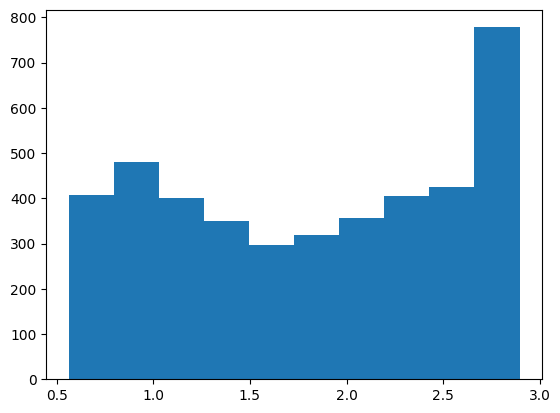

In [758]:
plt.hist(df_null[df_null['null'] == 'indep_circperm']['mean_tau_s'].values)

null
indep_shuffle     750
indep_circperm    750
dep_shuffle       750
Name: count, dtype: int64


/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/3228004497.py:17: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  out = g.apply(lambda sub: pd.Series({


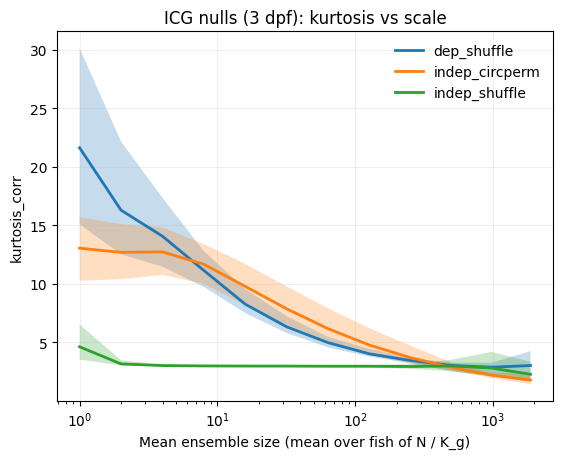

/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/3228004497.py:17: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  out = g.apply(lambda sub: pd.Series({


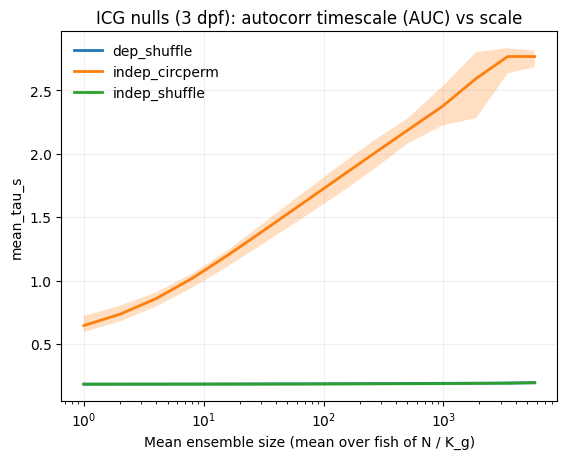

In [759]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# --- filter to 3 dpf + nulls only ---
df3 = df_null[(df_null["age"] == 3) & (df_null["null"] != "real")].copy()

# (optional) sanity print
print(df3["null"].value_counts())

# 1) Kurtosis vs scale (3 dpf nulls)
plot_metric_mean_per_gen_with_band(
    df3, ycol="kurtosis_corr",
    title="ICG nulls (3 dpf): kurtosis vs scale"
)
plt.show()

# 2) Tau vs scale (3 dpf nulls)
plot_metric_mean_per_gen_with_band(
    df3, ycol="mean_tau_s",
    title="ICG nulls (3 dpf): autocorr timescale (AUC) vs scale"
)
plt.show()


null
indep_shuffle     750
indep_circperm    750
dep_shuffle       750
real               75
Name: count, dtype: int64


/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/3228004497.py:17: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  out = g.apply(lambda sub: pd.Series({


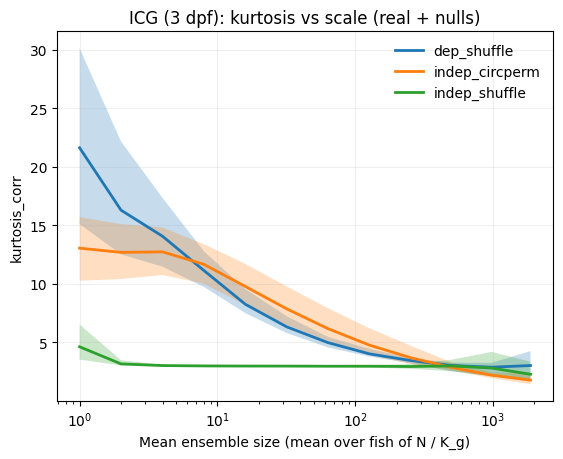

/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/3228004497.py:17: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  out = g.apply(lambda sub: pd.Series({


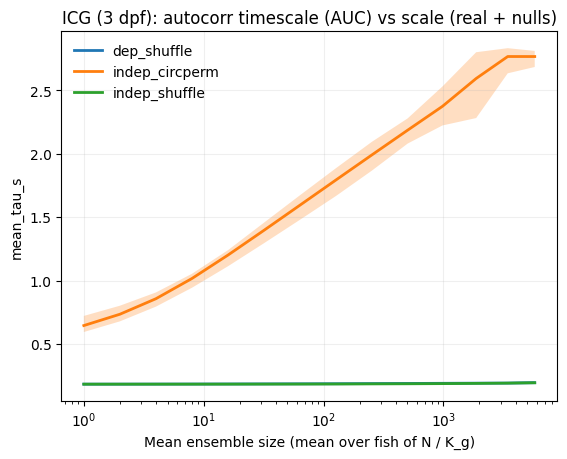

In [760]:
import pandas as pd
import matplotlib.pyplot as plt

# --- filter to 3 dpf (include real + nulls) ---
df3 = df_null[pd.to_numeric(df_null["age"], errors="coerce").eq(3)].copy()

print(df3["null"].value_counts())

# 1) Kurtosis vs scale (3 dpf real + nulls)
plot_metric_mean_per_gen_with_band(
    df3, ycol="kurtosis_corr",
    title="ICG (3 dpf): kurtosis vs scale (real + nulls)"
)
plt.show()

# 2) Tau vs scale (3 dpf real + nulls)
plot_metric_mean_per_gen_with_band(
    df3, ycol="mean_tau_s",
    title="ICG (3 dpf): autocorr timescale (AUC) vs scale (real + nulls)"
)
plt.show()


In [767]:
df_null

,fish,age,id,null,sim,gen,n_cells,n_clusters,mean_ensemble_size,x_mean_size_gen,kurtosis_corr,mean_tau_s,source_path
0,BLNDEV-WILDTYPE-01,4,BLNDEV-WILDTYPE-01_4,real,0,0,15105,15105,1.000000,1.000000,10.594600,0.694566,/Users/k2585057/Library/CloudStorage/Dropbox/P...
1,BLNDEV-WILDTYPE-01,4,BLNDEV-WILDTYPE-01_4,real,0,1,15105,7553,1.999868,1.999868,7.332875,0.811703,/Users/k2585057/Library/CloudStorage/Dropbox/P...
2,BLNDEV-WILDTYPE-01,4,BLNDEV-WILDTYPE-01_4,real,0,2,15105,3777,3.999206,3.999206,6.117031,0.983104,/Users/k2585057/Library/CloudStorage/Dropbox/P...
3,BLNDEV-WILDTYPE-01,4,BLNDEV-WILDTYPE-01_4,real,0,3,15105,1889,7.996294,7.996294,4.751653,1.209666,/Users/k2585057/Library/CloudStorage/Dropbox/P...
4,BLNDEV-WILDTYPE-01,4,BLNDEV-WILDTYPE-01_4,real,0,4,15105,945,15.984127,15.984127,3.899253,1.478070,/Users/k2585057/Library/CloudStorage/Dropbox/P...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
13945,BLNDEV-WILDTYPE-08,8,BLNDEV-WILDTYPE-08_8,dep_shuffle,9,10,13323,14,951.642857,951.642857,1.686267,0.186457,/Users/k2585057/Library/CloudStorage/Dropbox/P...
13946,BLNDEV-WILDTYPE-08,8,BLNDEV-WILDTYPE-08_8,dep_shuffle,9,11,13323,7,1903.285714,1903.285714,1.381120,0.185974,/Users/k2585057/Library/CloudStorage/Dropbox/P...
13947,BLNDEV-WILDTYPE-08,8,BLNDEV-WILDTYPE-08_8,dep_shuffle,9,12,13323,4,3330.750000,3330.750000,NaN,0.187567,/Users/k2585057/Library/CloudStorage/Dropbox/P...
13948,BLNDEV-WILDTYPE-08,8,BLNDEV-WILDTYPE-08_8,dep_shuffle,9,13,13323,2,6661.500000,6661.500000,NaN,0.186354,/Users/k2585057/Library/CloudStorage/Dropbox/P...


In [769]:
import pandas as pd

# what ages exist for REAL?
real = df_null[df_null["null"] == "real"].copy()
print("Real ages:", sorted(real["age"].dropna().unique()))
print(real.groupby("age").size())

# do we have 3 dpf real at all?
real3 = df_null[(df_null["null"] == "real") & (pd.to_numeric(df_null["age"], errors="coerce") == 3)]
print("n rows real3:", len(real3))
print(real3[["fish","age","gen","n_clusters","source_path"]].head())


Real ages: [np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8)]
age
3    75
4    75
5    90
6    75
7    60
8    75
dtype: int64
n rows real3: 75
                    fish  age  gen  n_clusters  \
2325  BLNDEV-WILDTYPE-02    3    0       10725   
2326  BLNDEV-WILDTYPE-02    3    1        5363   
2327  BLNDEV-WILDTYPE-02    3    2        2682   
2328  BLNDEV-WILDTYPE-02    3    3        1341   
2329  BLNDEV-WILDTYPE-02    3    4         671   

                                            source_path  
2325  /Users/k2585057/Library/CloudStorage/Dropbox/P...  
2326  /Users/k2585057/Library/CloudStorage/Dropbox/P...  
2327  /Users/k2585057/Library/CloudStorage/Dropbox/P...  
2328  /Users/k2585057/Library/CloudStorage/Dropbox/P...  
2329  /Users/k2585057/Library/CloudStorage/Dropbox/P...  


/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/2701349864.py:38: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  agg = g.apply(lambda sub: pd.Series({


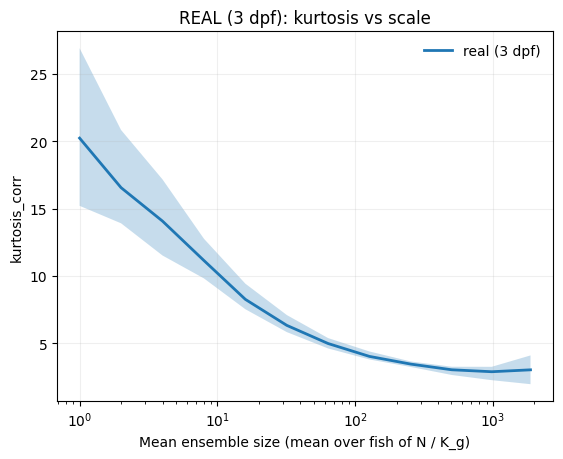

/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/2701349864.py:38: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  agg = g.apply(lambda sub: pd.Series({


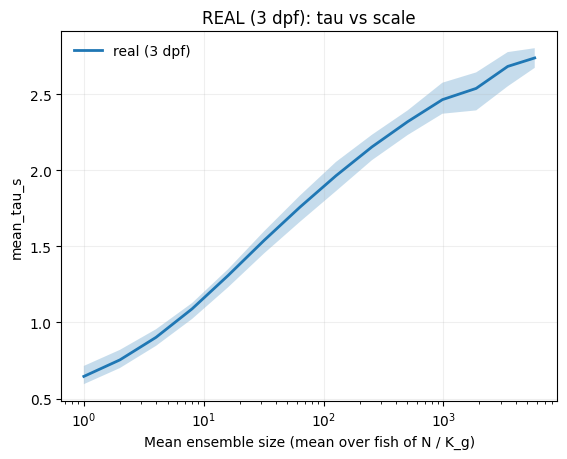

In [771]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_real_3dpf(
    df_null: pd.DataFrame,
    ycol: str,
    xcol: str = "x_mean_size_gen",
    q_lo: float = 0.05,
    q_hi: float = 0.95,
    logx: bool = True,
    ax=None,
    title: None = None,
):
    """
    Plot ONLY the REAL condition for 3 dpf.

    For each generation (gen), aggregate across fish (and any duplicates) to:
      x = mean(xcol)
      y = mean(ycol)
      band = [q_lo, q_hi] quantiles of ycol

    Returns: ax
    """
    if ax is None:
        _, ax = plt.subplots()

    # robust filter (handles age stored as float/int/str)
    d = df_null.copy()
    d["age_num"] = pd.to_numeric(d["age"], errors="coerce")
    d = d[(d["null"] == "real") & (d["age_num"] == 3)].copy()

    if len(d) == 0:
        raise ValueError("No rows found for null=='real' and age==3. Check parsing / filtering.")

    # aggregate per generation
    g = d.groupby("gen", dropna=True)
    agg = g.apply(lambda sub: pd.Series({
        "x_mean": np.nanmean(sub[xcol].to_numpy(float)),
        "y_mean": np.nanmean(sub[ycol].to_numpy(float)),
        "y_lo":   np.nanquantile(sub[ycol].to_numpy(float), q_lo),
        "y_hi":   np.nanquantile(sub[ycol].to_numpy(float), q_hi),
        "n":      np.isfinite(sub[ycol].to_numpy(float)).sum(),
    })).reset_index()

    agg = agg.sort_values("gen")

    x  = agg["x_mean"].to_numpy(float)
    y  = agg["y_mean"].to_numpy(float)
    lo = agg["y_lo"].to_numpy(float)
    hi = agg["y_hi"].to_numpy(float)

    ax.plot(x, y, linewidth=2.0, label="real (3 dpf)")
    ax.fill_between(x, lo, hi, alpha=0.25)

    if logx:
        ax.set_xscale("log")

    ax.set_xlabel("Mean ensemble size (mean over fish of N / K_g)")
    ax.set_ylabel(ycol)
    ax.set_title(title if title else f"REAL only (3 dpf): {ycol} vs scale")
    ax.legend(frameon=False)
    ax.grid(True, alpha=0.2)

    return ax


# ---- usage ----
plot_real_3dpf(df_null, ycol="kurtosis_corr", title="REAL (3 dpf): kurtosis vs scale")
plt.show()

plot_real_3dpf(df_null, ycol="mean_tau_s", title="REAL (3 dpf): tau vs scale")
plt.show()


null
indep_shuffle     750
indep_circperm    750
dep_shuffle       750
Name: count, dtype: int64


/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/3228004497.py:17: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  out = g.apply(lambda sub: pd.Series({
/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/3140864599.py:29: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  agg = g.apply(lambda sub: pd.Series({


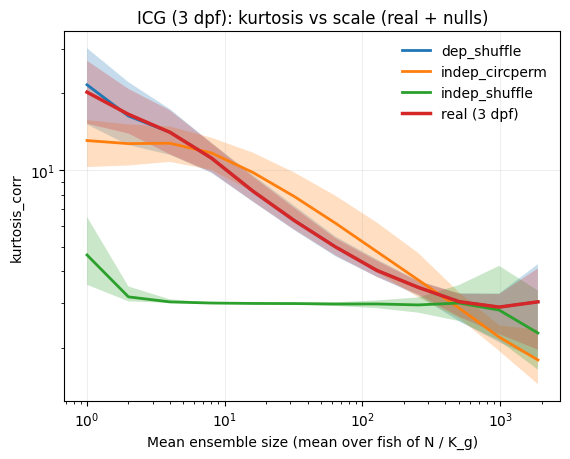

/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/3228004497.py:17: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  out = g.apply(lambda sub: pd.Series({
/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/3140864599.py:29: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  agg = g.apply(lambda sub: pd.Series({


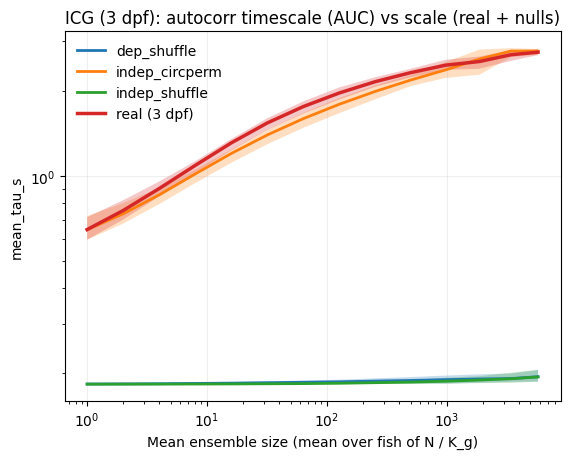

In [777]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# -----------------------------
# Helper: add REAL(3dpf) curve onto an existing axis
# -----------------------------
def add_real_3dpf_to_ax(
    df_null: pd.DataFrame,
    ycol: str,
    xcol: str = "x_mean_size_gen",
    q_lo: float = 0.05,
    q_hi: float = 0.95,
    ax=None,
    label: str = "real (3 dpf)",
    lw: float = 2.5,
    band_alpha: float = 0.25,
):
    if ax is None:
        ax = plt.gca()

    d = df_null.copy()
    d["age_num"] = pd.to_numeric(d["age"], errors="coerce")
    d = d[(d["null"] == "real") & (d["age_num"] == 3)].copy()
    if len(d) == 0:
        raise ValueError("No rows found for null=='real' and age==3.")

    g = d.groupby("gen", dropna=True)
    agg = g.apply(lambda sub: pd.Series({
        "x_mean": np.nanmean(sub[xcol].to_numpy(float)),
        "y_mean": np.nanmean(sub[ycol].to_numpy(float)),
        "y_lo":   np.nanquantile(sub[ycol].to_numpy(float), q_lo),
        "y_hi":   np.nanquantile(sub[ycol].to_numpy(float), q_hi),
    })).reset_index().sort_values("gen")

    x  = agg["x_mean"].to_numpy(float)
    y  = agg["y_mean"].to_numpy(float)
    lo = agg["y_lo"].to_numpy(float)
    hi = agg["y_hi"].to_numpy(float)

    ax.plot(x, y, linewidth=lw, label=label)
    ax.fill_between(x, lo, hi, alpha=band_alpha)

    return ax


# --- filter to 3 dpf + nulls only (robust age parsing) ---
df3 = df_null[
    (pd.to_numeric(df_null["age"], errors="coerce") == 3) &
    (df_null["null"] != "real")
].copy()

print(df3["null"].value_counts())

# -------------------------
# 1) Kurtosis vs scale (3 dpf nulls + real)
# -------------------------
ax = plot_metric_mean_per_gen_with_band(
    df3,
    ycol="kurtosis_corr",
    title="ICG (3 dpf): kurtosis vs scale (real + nulls)"
)
add_real_3dpf_to_ax(df_null, ycol="kurtosis_corr", ax=ax)
ax.set_yscale('log')
ax.legend(frameon=False)
plt.show()

# -------------------------
# 2) Tau vs scale (3 dpf nulls + real)
# -------------------------
ax = plot_metric_mean_per_gen_with_band(
    df3,
    ycol="mean_tau_s",
    title="ICG (3 dpf): autocorr timescale (AUC) vs scale (real + nulls)"
)
add_real_3dpf_to_ax(df_null, ycol="mean_tau_s", ax=ax)
ax.set_yscale('log')
ax.legend(frameon=False)
plt.show()


In [773]:
import numpy as np
import pandas as pd

def collapse_null_sims_within_fish_gen(
    df: pd.DataFrame,
    metric: str,
    xcol: str = "x_mean_size_gen",
    how: str = "median",
) -> pd.DataFrame:
    """
    Collapse sims for nulls within (id, age, gen, null) to avoid pseudo-replication.
    Keeps one row per fish per generation.
    """
    agg_fn = {"median": np.nanmedian, "mean": np.nanmean}[how]

    group_cols = ["id", "fish", "age", "gen", "null"]
    # keep xcol too (it may vary slightly if K_g varies across sims)
    out = (
        df.groupby(group_cols, dropna=False, as_index=False)
          .agg({
              metric: agg_fn,
              xcol:  np.nanmean,   # average x across sims
              "n_cells": "first",
              "source_path": "first",
          })
    )
    return out


def compare_age_amp_real_vs_nulls(
    df_null: pd.DataFrame,
    metric: str = "kurtosis_corr",
    nulls: tuple = ("real", "dep_shuffle", "indep_circperm"),
    xcol: str = "x_mean_size_gen",
    collapse_null_sims: bool = True,
    collapse_how: str = "median",
    Kmin: int = 50,
    min_obs_per_fish: int = 3,
    q_lo: float = 0.05,
    q_hi: float = 0.95,
) -> pd.DataFrame:
    """
    Runs your existing test_age_effects_interaction() separately for each condition,
    and returns a small summary table comparing beta/p for the age amplitude term (age_c)
    (and slope term if you want it).
    """
    rows = []

    for null_name in nulls:
        df_sub = df_null[df_null["null"] == null_name].copy()

        # collapse sims for nulls (not for real)
        if collapse_null_sims and null_name != "real":
            df_sub = collapse_null_sims_within_fish_gen(
                df_sub, metric=metric, xcol=xcol, how=collapse_how
            )

        # run your exact interaction model
        res = test_age_effects_interaction(
            df_sub,
            metric,
            xcol=xcol,
            fish_id_col="id",
            age_col="age",
            Kmin=Kmin,
            min_obs_per_fish=min_obs_per_fish,
            q_lo=q_lo,
            q_hi=q_hi,
        )

        rows.append({
            "null": null_name,
            "n_fish": res["n_fish"],
            "n_points": res["n_points"],
            "beta_age_amp": res["beta_age_amp"],
            "p_age_amp": res["p_age_amp"],
            "beta_age_slope": res["beta_age_slope"],
            "p_age_slope": res["p_age_slope"],
        })

    return pd.DataFrame(rows).sort_values("null").reset_index(drop=True)


# ---- run comparison (kurtosis only) ----
cmp = compare_age_amp_real_vs_nulls(
    df_null,
    metric="kurtosis_corr",
    nulls=("real", "dep_shuffle", "indep_circperm"),
    collapse_null_sims=True,
    collapse_how="median",   # or "mean"
    Kmin=50,
    min_obs_per_fish=3,
)

print(cmp)

# optional: quick side-by-side print focused on amplitude
for _, r in cmp.iterrows():
    print(f"{r['null']:>12s} | beta_amp={r['beta_age_amp']:+.4f}  p_amp={r['p_age_amp']:.3g} "
          f"| beta_slope={r['beta_age_slope']:+.4f}  p_slope={r['p_age_slope']:.3g}")


             null  n_fish  n_points  beta_age_amp  p_age_amp  beta_age_slope  \
0     dep_shuffle      30       332     -0.032714   0.000945        0.001314   
1  indep_circperm      30       332     -0.021447   0.010650        0.003531   
2            real      30       224     -0.036606   0.001813       -0.005585   

   p_age_slope  
0     0.796692  
1     0.139613  
2     0.283925  
 dep_shuffle | beta_amp=-0.0327  p_amp=0.000945 | beta_slope=+0.0013  p_slope=0.797
indep_circperm | beta_amp=-0.0214  p_amp=0.0106 | beta_slope=+0.0035  p_slope=0.14
        real | beta_amp=-0.0366  p_amp=0.00181 | beta_slope=-0.0056  p_slope=0.284


/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/691752282.py:19: FutureWarning: The provided callable <function nanmedian at 0x10754ba60> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.
  df.groupby(group_cols, dropna=False, as_index=False)
/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/691752282.py:19: FutureWarning: The provided callable <function nanmean at 0x10754b790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  df.groupby(group_cols, dropna=False, as_index=False)
/var/folders/_4/0nh1mt153jg71rmwr6m3h_d40000gr/T/ipykernel_63204/691752282.py:19: FutureWarning: The provided callable <function nanmedian at 0x10754ba60> is currently using SeriesGroupBy.median. In a future version of pandas, the pro

In [ ]:
Kurtosis: amp beta,p = -0.03457858907627929 0.0025917196046999907 | slope beta,p = 0.0009135508226315045 0.8455827919433949
Mean_var: amp beta,p = 0.00992973517009354 0.4899203952694492 | slope beta,p = 0.004181788860182577 0.26871620743831437
Tau (log-quadratic): amp p = 0.0224076642592437 | slope p = 0.23451894040731658 | curvature p = 0.32539887990062133